# Mechanistic Interpretability

In [1]:
import os
from dotenv import load_dotenv

load_dotenv();

In [2]:
import torch
from torch import nn
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import tqdm
import seaborn as sns
from sklearn.decomposition import PCA
import plotly.graph_objects as go
from plotly.subplots import make_subplots 
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import matplotlib.patches as mpatches

from icl.analysis.utils import get_unique_run
from devinterp.mechinterp.hooks import hook

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.decomposition import PCA

from mpl_toolkits.mplot3d import Axes3D
from matplotlib.patches import FancyArrowPatch
from mpl_toolkits.mplot3d import proj3d

PRIMARY, SECONDARY, TERTIARY = sns.color_palette()[:3]
BBLUE, BORANGE, BGREEN, BRED = sns.color_palette('bright')[:4]


sns.set_style('whitegrid')

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/pydantic/_internal/_fields.py:127: UserWarning: Field "model_seed" has conflict with protected namespace "model_".

You may be able to resolve this warning by setting `model_config['protected_namespaces'] = ()`.
  warnings.warn(


In [16]:
run = get_unique_run(
    "../sweeps/small-sweep-2.yaml", 
    task_config={"num_tasks": 2, "num_layers": 2},
    optimizer_config={"lr": 0.01}
)

/Users/Jesse/Projects/devinfra/devinfra/utils/iterables.py:29: UserWarning: Number of steps in int_logspace is not 100, got 91.
  warnings.warn(
/Users/Jesse/Projects/devinfra/devinfra/utils/iterables.py:29: UserWarning: Number of steps in int_logspace is not 50, got 47.
  warnings.warn(


In [4]:
steps = run.checkpointer.file_ids

In [5]:
from copy import deepcopy 
# Let's generate these same plots and also look at their evolution. 
models = []
optimizer_state_dicts = []

for checkpoint in run.checkpointer:
    m = deepcopy(run.model)
    m.load_state_dict(checkpoint["model"])
    models.append(m)
    optimizer_state_dicts.append(checkpoint["optimizer"])

models

[InContextRegressionTransformer(
   (token_sequence_transformer): DTransformer(
     (token_embedding): Linear(in_features=5, out_features=64, bias=False)
     (postn_embedding): Linear(in_features=16, out_features=64, bias=False)
     (blocks): ModuleList(
       (0-1): 2 x MultiHeadedCausalSelfAttentionTransformerBlock(
         (attention): MultiHeadedCausalSelfAttention(
           (attention): Linear(in_features=64, out_features=192, bias=False)
           (attention_softmax): Softmax(dim=-1)
         )
         (compute): Sequential(
           (0): Linear(in_features=64, out_features=64, bias=True)
           (1): ReLU()
           (2): Linear(in_features=64, out_features=64, bias=True)
         )
         (layer_norms): ModuleList(
           (0-1): 2 x LayerNorm((64,), eps=1e-05, elementwise_affine=True)
         )
         (resid_after_attn): Identity()
       )
     )
     (unembedding): Sequential(
       (0): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
       (1):

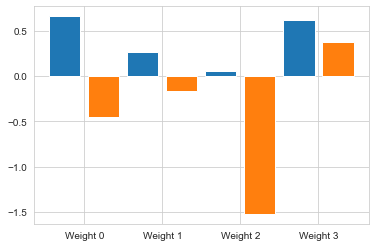

In [6]:
# The weights of the two tasks for reference.
tasks = run.pretrain_dist.task_distribution.tasks

# Plot the two rows
plt.bar(range(0, 2 * len(tasks[0]), 2), tasks[0].detach().cpu().numpy(), label='Task 0')
plt.bar(range(1, 2 * len(tasks[1]), 2), tasks[1].detach().cpu().numpy(), label='Task 1')

plt.xticks(np.array(range(0, 2 * len(tasks[0]), 2))+ 0.5, [f'Weight {i}' for i in range(len(tasks[0]))])
plt.legend

plt.show()


task_sum = (tasks[0] + tasks[1]) * 0.5
task_diff = (tasks[0] - tasks[1]) * 0.5

task_basis_1 = task_sum / torch.norm(task_sum)
task_basis_2 = task_diff / torch.norm(task_diff)
task_basis_2 = task_basis_2 - torch.dot(task_basis_2, task_basis_1) * task_basis_1

task_basis = torch.stack([task_basis_1, task_basis_2], dim=1)

In [7]:
# Let's look at how the curvature of the llc changes over time. 

import wandb

api = wandb.Api()
llc_run = api.run("devinterp/icl/zq2pe3e4")
history_df = llc_run.history()

steps = history_df["_step"]
llcs = history_df["llc/mean"]
llcs_std = history_df["llc/std"]


In [8]:
from icl.figures.derivatives import d_dt, d_dlogt, dlog_dlogt

weight_norms = [(sum(torch.norm(p) ** 2 for p in model.parameters()) ** 0.5).item() for model in models]

d_llc_dt = d_dt(steps, llcs)
d_llc_dlogt = d_dlogt(steps, llcs)

d_weight_norm_dt = d_dt(run.checkpointer.file_ids, weight_norms)
d_weight_norm_dlogt = d_dlogt(run.checkpointer.file_ids, weight_norms)

In [9]:
from icl.analysis.evals import ICLEvaluator

evaluator = ICLEvaluator(
    pretrain_dist=run.pretrain_dist,
    true_dist=run.true_dist,
    max_examples=run.config.task_config.max_examples,
    eval_batch_size=10_000,
    seed=run.config.task_config.true_seed,
)

evals_over_time = [evaluator(model) for model in models]
evals_over_time_df = pd.DataFrame(evals_over_time)
evals_over_time_df

,pretrain/mse,pretrain/delta_dmmse,pretrain/delta_ridge,pretrain/token/0,pretrain/token/1,pretrain/token/2,pretrain/token/3,pretrain/token/4,pretrain/token/5,pretrain/token/6,...,true/delta_dmmse,true/delta_ridge,true/token/0,true/token/1,true/token/2,true/token/3,true/token/4,true/token/5,true/token/6,true/token/7
0,2.396483,"tensor(2.1025, device='mps:0')","tensor(1.7058, device='mps:0')",2.467715,2.340513,2.413367,2.361404,2.327633,2.438835,2.449703,...,"tensor(2.0625, device='mps:0')","tensor(3.0475, device='mps:0')",4.836451,4.773670,4.676457,4.563489,4.653705,4.773317,4.729662,4.697276
1,2.396453,"tensor(2.1025, device='mps:0')","tensor(1.7058, device='mps:0')",2.467679,2.340485,2.413335,2.361379,2.327608,2.438804,2.449674,...,"tensor(2.0624, device='mps:0')","tensor(3.0475, device='mps:0')",4.836428,4.773654,4.676436,4.563478,4.653695,4.773298,4.729647,4.697259
2,2.396410,"tensor(2.1024, device='mps:0')","tensor(1.7057, device='mps:0')",2.467627,2.340441,2.413287,2.361342,2.327572,2.438759,2.449632,...,"tensor(2.0624, device='mps:0')","tensor(3.0475, device='mps:0')",4.836396,4.773629,4.676406,4.563460,4.653677,4.773270,4.729624,4.697236
3,2.396353,"tensor(2.1024, device='mps:0')","tensor(1.7057, device='mps:0')",2.467557,2.340384,2.413224,2.361294,2.327523,2.438698,2.449576,...,"tensor(2.0623, device='mps:0')","tensor(3.0474, device='mps:0')",4.836352,4.773596,4.676366,4.563436,4.653655,4.773232,4.729593,4.697203
4,2.396280,"tensor(2.1023, device='mps:0')","tensor(1.7056, device='mps:0')",2.467469,2.340312,2.413144,2.361233,2.327461,2.438621,2.449505,...,"tensor(2.0623, device='mps:0')","tensor(3.0474, device='mps:0')",4.836298,4.773554,4.676315,4.563406,4.653626,4.773184,4.729554,4.697162
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91,0.295933,"tensor(0.0003, device='mps:0')","tensor(0.6073, device='mps:0')",1.113775,0.389515,0.204256,0.152387,0.129010,0.127851,0.126345,...,"tensor(0.2923, device='mps:0')","tensor(3.1238, device='mps:0')",4.890819,5.189402,4.825684,4.786953,4.797669,4.569198,4.607853,4.512682
92,0.295990,"tensor(0.0003, device='mps:0')","tensor(0.6060, device='mps:0')",1.114132,0.389603,0.204387,0.152509,0.129091,0.127839,0.126243,...,"tensor(0.2681, device='mps:0')","tensor(3.1048, device='mps:0')",4.894817,5.157404,4.794812,4.772883,4.780801,4.549880,4.587225,4.494456
93,0.296007,"tensor(0.0002, device='mps:0')","tensor(0.6081, device='mps:0')",1.114169,0.388343,0.204716,0.152913,0.129254,0.128241,0.126289,...,"tensor(0.2912, device='mps:0')","tensor(3.1324, device='mps:0')",4.905045,5.173697,4.825067,4.796047,4.811699,4.586295,4.633926,4.522209
94,0.295804,"tensor(0.0002, device='mps:0')","tensor(0.6131, device='mps:0')",1.114259,0.388239,0.204166,0.152821,0.128881,0.127797,0.126183,...,"tensor(0.2750, device='mps:0')","tensor(3.1186, device='mps:0')",4.911366,5.170630,4.807312,4.783554,4.794449,4.563654,4.600991,4.506465


# Progress measures

In [86]:
TRANSITIONS = [
    (300, 800, 'Midpoint acquisition'),
    (800, 5000, 'Task acquisition'),
    # (15000, 40000, 'Collapse onto task subspace'),
    (5000, 60000, 'Collapse onto task subspace'),
    # (60000, 80000, 'Collapse onto task difference'),
    (60000, 100000, 'Collapse onto task basis'),
    (100000, 220000, 'Activation divergence'),
    (220000, 320000, "Learning rate maximum"),
    (320000, 500000, "Stabilization")
]

MILESTONE_COLORS = [sns.color_palette("coolwarm_r", len(TRANSITIONS) + 2)[i] for i in [1, 2, *range(4, len(TRANSITIONS) + 2)]]


def add_milestones(axes, milestones=TRANSITIONS, milestone_colors=MILESTONE_COLORS, max_step=np.inf):
    for ax in axes.flatten():
        for color, (start, end, label) in zip(milestone_colors, milestones):

            if start > max_step:
                continue

            ax.axvspan(start, min(end, max_step), alpha=0.5, label=label, color=color)

    # Add milestone legend
    patch_list = []

    for color, (start, end, label) in zip(milestone_colors, milestones):
        data_key = mpatches.Patch(color=color, alpha=0.2, label=label)
        patch_list.append(data_key)

    return patch_list

## Unsupervised Observables

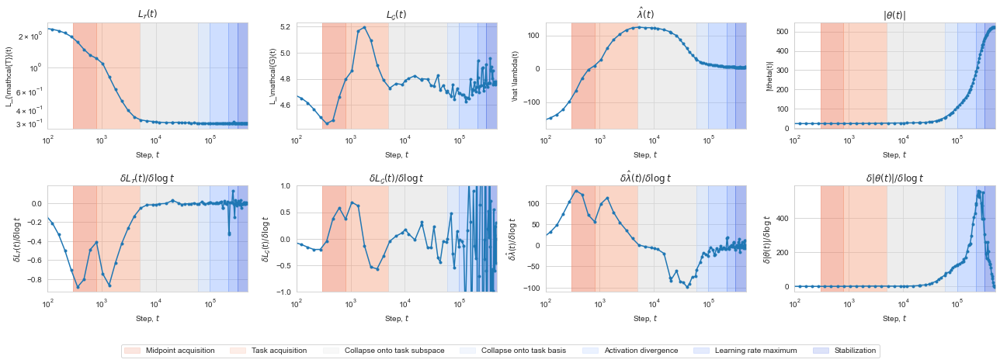

In [87]:
import seaborn as sns

def wrap_latex(s):
    return "$" + s + "$"

def str_d_dlogt(s):
    return wrap_latex(r"\delta " + s + r"/\delta\log t")

metrics_to_plot = [
    (r"L_{\mathcal{T}}(t)", evals_over_time_df["pretrain/mse"], {"logy": True}),
    (r"L_\mathcal{G}(t)", evals_over_time_df["true/mse"], {"logy": False}),
    (r"\hat \lambda(t)", llcs, {}),
    (r"|\theta(t)|", weight_norms, {}),
] 

metric_slopes = [
    # d_dt(run.checkpointer.file_ids, v) for _, v, __ in metrics_to_plot
    d_dlogt(run.checkpointer.file_ids, v) for _, v, __ in metrics_to_plot
]

fig, axes = plt.subplots(2, len(metrics_to_plot), figsize=(18, 6))

for i, (metric_name, metric_values, kwargs) in enumerate(metrics_to_plot):
    axes[0, i].plot(run.checkpointer.file_ids, metric_values, label=metric_name, marker='.')
    axes[0, i].set_title(wrap_latex(metric_name))
    axes[0, i].set_xlabel('Step, $t$')
    axes[0, i].set_ylabel(metric_name)

    if kwargs.get("logy", False):
        axes[0, i].set_yscale('log')

    axes[1, i].plot(run.checkpointer.file_ids, metric_slopes[i], label=metric_name + " Slope", marker='.')
    axes[1, i].set_title(str_d_dlogt(metric_name))
    axes[1, i].set_xlabel('Step, $t$')
    axes[1, i].set_ylabel(str_d_dlogt(metric_name))

for ax in axes.flatten():
    ax.set_xscale('log')
    ax.set_xlim(100, 500_000)

axes[1,1].set_ylim(-1, 1)

patch_list = add_milestones(axes)

milestone_labels = [label for _, _, label in TRANSITIONS]
fig.legend(patch_list, milestone_labels, loc='upper center', bbox_to_anchor=(0.5, -0.025), ncol=len(TRANSITIONS))

fig.set_facecolor("white")
fig.tight_layout()

## Functional (Loss, Midpoint-Distance, OOD loss)

In [74]:
# Wait if my layer norm theory is right. Then we should see a sudden improvement in the ability of the model to make predictions for out-of-distribution xs/ys (not ws). 
from devinfra.utils.seed import set_seed
from icl.tasks import apply_transformations
from devinfra.utils.iterables import flatten_dict

DEVICE = "mps"

pretrain_dist_noiseless = run.config.task_config.pretrain_dist_factory().to(
    DEVICE
)
pretrain_dist_noiseless.std = 0.

set_seed(run.config.task_config.pretrain_seed)

# shorthands
B = 1024
K = 8
D = 4

# sample a batch of random tasks
ws = pretrain_dist_noiseless.task_distribution.sample_tasks(B) # -> B D
task_avg = (tasks[0] + tasks[1]) / 2.
task_avg_repeated = task_avg.unsqueeze(0).repeat(B, 1, 1)

# sample i.i.d. inputs and outputs for each task according to the
# regression model
xs = torch.normal(
    mean=0.,
    std=1.,
    size=(B, K, D,),
    device=DEVICE
)

xs100 = 3 * xs
ys = apply_transformations(ws, xs, 0., DEVICE)
ys100 = apply_transformations(ws, xs100, 0., DEVICE)

ys_midpoint = apply_transformations(task_avg_repeated, xs, 0., DEVICE)
ys100_midpoint = apply_transformations(task_avg_repeated, xs100, 0., DEVICE)

def eval_loss(yhats, ys):
    losses = ((yhats - ys) ** 2).mean(dim=0)[:, 0]
    return [loss.item() for loss in losses] + [losses.mean().item()]

losses_over_time = []

for step, model in zip(run.checkpointer.file_ids, models):
    losses = eval_loss(model(xs, ys), ys)
    loss_midpoints = eval_loss(model(xs, ys), ys_midpoint)
    loss100s = eval_loss(model(xs100, ys100), ys100)
    loss100_midpoints = eval_loss(model(xs100, ys100_midpoint), ys100_midpoint)

    for i in range(9):
        losses_over_time.append({
            "step": step,
            "loss": losses[i],
            "loss100": loss100s[i],
            "loss_midpoint": loss_midpoints[i],
            "loss100_midpoint": loss100_midpoints[i],
            # "token": f"$\hat y_{i+1}$" if i < 8 else "$\overline{\hat y}$"
            "token": i + 1 if i < 8 else "$\overline{\hat y}$"
        })

losses_over_time = pd.DataFrame(losses_over_time)
losses_over_time

,step,loss,loss100,loss_midpoint,loss100_midpoint,token
0,0,2.335959,15.236212,1.419724,7.385622,1
1,0,2.221032,16.651016,1.210413,7.261220,2
2,0,2.186647,15.071074,1.302006,6.818490,3
3,0,2.296091,16.450407,1.267146,7.536236,4
4,0,2.127661,15.472417,1.215450,7.124840,5
...,...,...,...,...,...,...
859,499999,0.000096,1.500967,0.946222,3.785936,5
860,499999,0.000021,1.376345,0.953649,3.621487,6
861,499999,0.000022,1.266200,1.019756,3.540838,7
862,499999,0.000021,2.423448,1.020587,3.426206,8


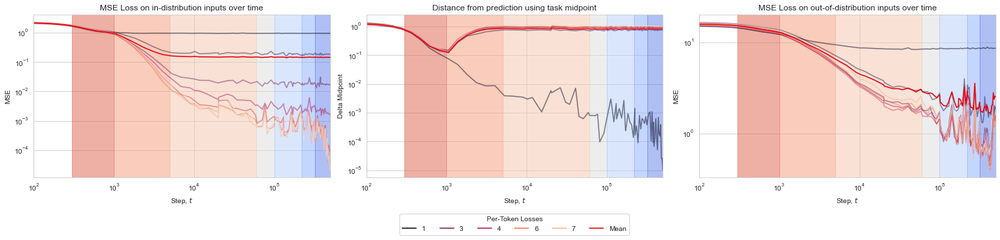

In [77]:
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize

fig, axes = plt.subplots(1, 3, figsize=(20, 5))

token_losses_over_time = losses_over_time.loc[losses_over_time.token != "$\overline{\hat y}$"]
mean_losses_over_time = losses_over_time.loc[losses_over_time.token == "$\overline{\hat y}$"]

sns.lineplot(data=token_losses_over_time, x="step", y=f"loss", hue="token", palette="rocket", ax=axes[0], alpha=0.5)
sns.lineplot(data=token_losses_over_time, x="step", y=f"loss_midpoint", hue="token", palette="rocket", ax=axes[1], alpha=0.5)
sns.lineplot(data=token_losses_over_time, x="step", y=f"loss100", hue="token", palette="rocket", ax=axes[2], alpha=0.5)

sns.lineplot(data=mean_losses_over_time, x="step", y="loss", label="Mean", ax=axes[0], color=BRED)
sns.lineplot(data=mean_losses_over_time, x="step", y="loss_midpoint", label="Mean", ax=axes[1], color=BRED)
sns.lineplot(data=mean_losses_over_time, x="step", y="loss100", label="Mean", ax=axes[2], color=BRED)

for ax in axes:
    ax.set_xscale("log")
    ax.set_xlabel("Step, $t$")
    ax.set_yscale('log')
    legend = ax.legend()
    legend.remove()
    ax.set_xlim(100, 500_000)

legend = axes[1].legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=6)
legend.set_title("Per-Token Losses")

# Move legend to be likee fig.legend(patch_list, milestone_labels, loc='upper center', bbox_to_anchor=(0.5, -0.025), ncol=len(TRANSITIONS))

axes[0].set_title("MSE Loss on in-distribution inputs over time")
axes[0].set_ylabel("MSE")
axes[1].set_title("Distance from prediction using task midpoint")
axes[1].set_ylabel("Delta Midpoint")
axes[2].set_title("MSE Loss on out-of-distribution inputs over time")
axes[2].set_ylabel("MSE")

add_milestones(axes)

for ax in axes:
    ax.set_xscale('log')

plt.tight_layout()
# Add color bar on the far right

fig.set_facecolor('white')

In [14]:
from icl.tasks import apply_transformations

# I'd like to see how close the model gets to predicting the centroid of the two tasks as a function of steps and tokens. 
B = 8192
K = 8
D = 4
DEVICE = "mps"
datasets = []

task_avg = (tasks[0] + tasks[1]) / 2

for i, task in enumerate(tasks):
    ws = task.unsqueeze(0).repeat(B, 1, 1)
    wothers = tasks[1 - i].unsqueeze(0).repeat(B, 1, 1)
    wmids = task_avg.unsqueeze(0).repeat(B, 1, 1)

    # sample i.i.d. inputs and outputs for each task according to the
    # regression model
    xs = torch.normal(
        mean=0.,
        std=1.,
        size=(B, K, D,),
        device=DEVICE,
    )

    ys = apply_transformations(ws, xs, 0., DEVICE)
    yothers = apply_transformations(wothers, xs, 0., DEVICE)
    ymids = apply_transformations(wmids, xs, 0., DEVICE)

    datasets.append((xs, ys, yothers, ymids))

In [21]:
pred_distances = pd.DataFrame(columns=["step", "mse", "delta_mid"] + [f"token_{i}/mse" for i in range(8)] + [f"token_{i}/delta_mid" for i in range(8)])

for step, model in zip(run.checkpointer.file_ids, models):
    for i, (xs, ys, yothers, ymids) in enumerate(datasets):
        yhats = model(xs, ys)
        mse_per_token = ((yhats - ys) ** 2).mean(dim=0).mean(dim=-1)
        mse = mse_per_token.mean()

        delta_mid_per_token = ((yhats - ymids) ** 2).mean(dim=0).mean(dim=-1)
        delta_mid = delta_mid_per_token.mean()

        delta_other_per_token = ((yhats - yothers) ** 2).mean(dim=0).mean(dim=-1)
        delta_other = delta_other_per_token.mean()

        pred_distances = pred_distances.append({
            "step": step + 1,
            "mse": mse.item(),
            "delta_other": delta_other.item(),
            "delta_mid": delta_mid.item(),
            **{f"token_{i}/mse": mse_per_token[i].item() for i in range(8)},
            **{f"token_{i}/delta_mid": delta_mid_per_token[i].item() for i in range(8)},
            **{f"token_{i}/delta_other": delta_other_per_token[i].item() for i in range(8)},
            "task": i
        }, ignore_index=True)
                

<ipython-input-21-9373a4bce23f>:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred_distances = pred_distances.append({
<ipython-input-21-9373a4bce23f>:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred_distances = pred_distances.append({
<ipython-input-21-9373a4bce23f>:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred_distances = pred_distances.append({
<ipython-input-21-9373a4bce23f>:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred_distances = pred_distances.append({
<ipython-input-21-9373a4bce23f>:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas

## Embedding vectors

In [22]:
steps = run.checkpointer.file_ids
embedding_matrices = []  # Shape: (64, 5): 64 vectors x (1 y dim + 4 x dims)

for model in models:
    embedding_matrices.append(model.state_dict()['token_sequence_transformer.token_embedding.weight'])


embedding_vec_x_norms = [vec.norm(dim=1) for vec in embedding_matrices]  # (64,)

### Project onto Task Subspace

In [88]:
def cossim_task0(vec):
    return torch.cosine_similarity(vec, tasks[0].unsqueeze(0), dim=1)

def cossim_task1(vec):
    return torch.cosine_similarity(vec, tasks[1].unsqueeze(0), dim=1)

def cossim_tasksum(vec):
    return torch.cosine_similarity(vec, task_sum.unsqueeze(0), dim=1)

def cossim_taskdiff(vec):
    return torch.cosine_similarity(vec, task_diff.unsqueeze(0), dim=1)

def proj_tasksum(vec):
    return torch.matmul(vec, task_sum.unsqueeze(-1)).squeeze(-1) / task_sum.norm()

def proj_taskdiff(vec):
    return torch.matmul(vec, task_diff.unsqueeze(-1)).squeeze(-1) / task_diff.norm()

def proj_tasksum_reconstruction_loss(vec):
    return torch.norm((vec - proj_tasksum(vec) * task_sum / task_sum.norm()), dim=-1)

def proj_taskdiff_reconstruction_loss(vec):
    return torch.norm((vec - proj_taskdiff(vec) * task_diff / task_diff.norm()), dim=-1)

In [24]:
# Track how far the x-subspace is from the task subspace

embedding_task_subspace_projs = []

for embedding_matrix in embedding_matrices:
    task0_proj = embedding_matrix[:, 1:] @ tasks[0]  # (64,)
    task1_proj = embedding_matrix[:, 1:] @ tasks[1]  # (64,)

    task_proj = task0_proj.unsqueeze(-1) * tasks[0] + task1_proj.unsqueeze(-1) * tasks[1]  # (64, 4)
    dist_proj_from_og = ((embedding_matrix[:, 1:] - task_proj) ** 2).mean(dim=-1)  # (64, )

    embedding_task_subspace_projs.append((task0_proj, task1_proj, task_proj, dist_proj_from_og))

embed_vec_rankings_by_final_task_proj_dist = list(np.argsort(embedding_task_subspace_projs[-1][-1].detach().cpu().numpy()))

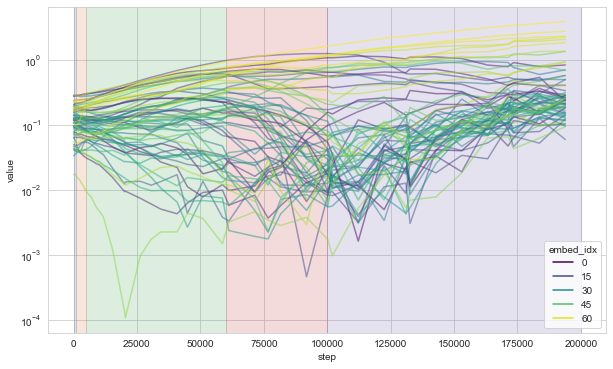

In [25]:
dist_embedding_subspace_from_task_subspace = [
    {"value": value.item() / norm[i].item(), "embed_idx": embed_vec_rankings_by_final_task_proj_dist.index(i), "step": step} 
    for step, item, norm in zip(steps, embedding_task_subspace_projs, embedding_vec_x_norms) 
    for i, value in enumerate(item[-1])
    if step < 200_000
]
dist_embedding_subspace_from_task_subspace = pd.DataFrame(dist_embedding_subspace_from_task_subspace)

fig, ax = plt.subplots(figsize=(10, 6))

sns.lineplot(data=dist_embedding_subspace_from_task_subspace, x="step", y="value", hue="embed_idx", palette="viridis", ax=ax, alpha=0.5)
ax.set_yscale('log')
# ax.set_xscale('log')

add_milestones(np.array([ax]), max_step=200_000)

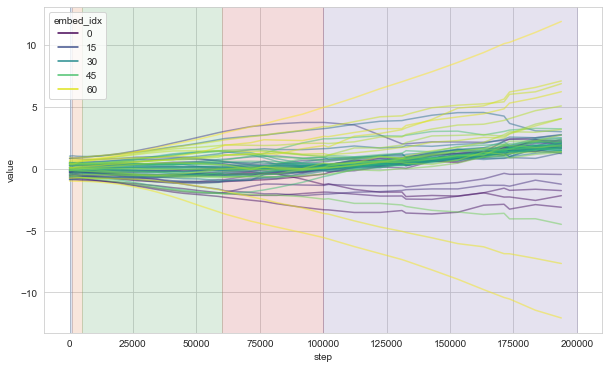

In [26]:
MAX_STEP = 200_000

dist_embedding_subspace_from_task_subspace = [
    {"value": proj_tasksum(task_proj).item(), "embed_idx": embed_vec_rankings_by_final_task_proj_dist.index(i), "step": step} 
    for step, item, norm in zip(steps, embedding_task_subspace_projs, embedding_vec_x_norms) 
    for i, task_proj in enumerate(item[2])
    if step < MAX_STEP
]
dist_embedding_subspace_from_task_subspace = pd.DataFrame(dist_embedding_subspace_from_task_subspace)

fig, ax = plt.subplots(figsize=(10, 6))

sns.lineplot(data=dist_embedding_subspace_from_task_subspace, x="step", y="value", hue="embed_idx", palette="viridis", ax=ax, alpha=0.5)
# ax.set_yscale('log')
# ax.set_xscale('log')

add_milestones(np.array([ax]), max_step=MAX_STEP)

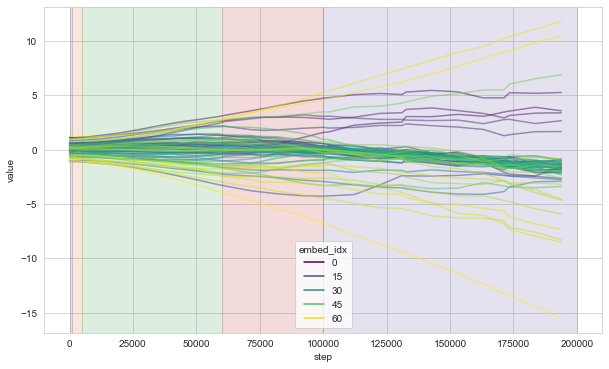

In [27]:
dist_embedding_subspace_from_task_subspace = [
    {"value": proj_taskdiff(task_proj).item(), "embed_idx": embed_vec_rankings_by_final_task_proj_dist.index(i), "step": step} 
    for step, item, norm in zip(steps, embedding_task_subspace_projs, embedding_vec_x_norms) 
    for i, task_proj in enumerate(item[2])
    if step < MAX_STEP
]
dist_embedding_subspace_from_task_subspace = pd.DataFrame(dist_embedding_subspace_from_task_subspace)

fig, ax = plt.subplots(figsize=(10, 6))

sns.lineplot(data=dist_embedding_subspace_from_task_subspace, x="step", y="value", hue="embed_idx", palette="viridis", ax=ax, alpha=0.5)
# ax.set_yscale('log')
# ax.set_xscale('log')

add_milestones(np.array([ax]), max_step=MAX_STEP)

In [89]:
sum([p.numel() for p in run.model.parameters()])

43525

### Project onto Task Subspace after Manually Normalizing

The bulk of the eigenvalues are not centered at the origin. Let's fix this and see if we resolve the unclear projections

In [29]:
task_addition_vec_idx = 35
 
def normalized_embed_vecs(embed_vecs):
    bulk_center = (embed_vecs[:35].sum(dim=0) + embed_vecs[36:].sum(dim=0)) / (len(embed_vecs) - 1)
    return embed_vecs - bulk_center


normalized_embedding_matrices = [normalized_embed_vecs(embedding_matrix) for embedding_matrix in embedding_matrices]
normalized_embedding_vec_x_norms = [vec.norm(dim=1) for vec in normalized_embedding_matrices]  # (64,)
# Track how far the x-subspace is from the task subspace

normalized_embedding_task_subspace_projs = []
metrics = []
summary_stats = []

task0_normed = tasks[0] / tasks[0].norm()
task1_normed = tasks[1] / tasks[1].norm()

centers = []
bulk_centers = []

def bulk_average(values):
    return (values[:35].sum() + values[36:].sum()) / (len(values) - 1)

for step, embedding_matrix in zip(steps, embedding_matrices):
    x_slice = embedding_matrix[:, 1:]
    center = x_slice.mean(dim=0)
    bulk_center = (x_slice[:35].sum(dim=0) + x_slice[36:].sum(dim=0)) / (len(x_slice) - 1)
    # x_slice -= center # bulk_center
    x_slice -= bulk_center

    task0_proj_comp = x_slice @ task0_normed
    task1_proj_comp = x_slice @ task1_normed

    task0_proj = task0_proj_comp.unsqueeze(-1) * task0_normed
    task1_proj = task1_proj_comp.unsqueeze(-1) * task1_normed
    tasksum_proj = task0_proj + task1_proj
    taskdiff_proj = task0_proj - task1_proj

    tasks_proj = (x_slice @ task_basis) @ task_basis.transpose(0, 1)

    dist_proj_from_og = ((x_slice - tasks_proj) ** 2).mean(dim=-1)  # (64, )
    dist_0_proj_from_og = ((x_slice - task0_proj) ** 2).mean(dim=-1)  # (64, )
    dist_1_proj_from_og = ((x_slice - task1_proj) ** 2).mean(dim=-1)  # (64, )
    dist_sum_proj_from_og = ((x_slice - tasksum_proj) ** 2).mean(dim=-1)  # (64, )
    dist_diff_proj_from_og = ((x_slice - taskdiff_proj) ** 2).mean(dim=-1)  # (64, )

    norms = embedding_matrix.norm(dim=-1)
    max_norm = norms.max().item()
    avg_norm = norms.mean().item()

    for i in range(64):
        dist_from_tasksubspace = dist_proj_from_og[i].item()
        dist_from_tasksum = dist_sum_proj_from_og[i].item()
        dist_from_taskdiff = dist_diff_proj_from_og[i].item()
        norm = norms[i].item()
        frac_norm = norm / max_norm
        
        metrics.append({
            "dist_from_tasksubspace": dist_from_tasksubspace,
            "dist_from_tasksum": dist_from_tasksum,
            "dist_from_taskdiff": dist_from_taskdiff,
            "normalized_dist_from_tasksubspace": dist_from_tasksubspace / norm,
            "normalized_dist_from_tasksum": dist_from_tasksum / norm,
            "normalized_dist_from_taskdiff": dist_from_taskdiff / norm,
            "rel_dist_from_tasksubspace": dist_from_tasksubspace / max_norm,
            "rel_dist_from_tasksum": dist_from_tasksum / max_norm,
            "rel_dist_from_taskdiff": dist_from_taskdiff / max_norm,
            "adj_dist_from_tasksubspace": dist_from_tasksubspace / avg_norm,
            "adj_dist_from_tasksum": dist_from_tasksum / avg_norm,
            "adj_dist_from_taskdiff": dist_from_taskdiff / avg_norm,
            "embed_idx": i,
            "step": step,
            "norm": norm,
            "frac_norm": frac_norm,
            "task0_comp": task0_proj_comp[i].item(),
            "task1_comp": task1_proj_comp[i].item(),
        })


    avg_norm_of_bulk = bulk_average(norms).item()

    bulk_center_norms = np.array([bulk_center.norm().item() for bulk_center in bulk_centers])
    center_norms = np.array([center.norm().item() for center in centers])

    frac_bulk_center_norms = bulk_center_norms / avg_norm
    frac_center_norms = center_norms / avg_norm

    avg_dist_from_subspace = dist_proj_from_og.mean().item()
    avg_dist_from_tasksum = dist_sum_proj_from_og.mean().item()
    avg_dist_from_taskdiff = dist_diff_proj_from_og.mean().item()

    avg_rel_dist_from_subspace = bulk_average(dist_proj_from_og).item() / max_norm
    avg_rel_dist_from_tasksum = bulk_average(dist_sum_proj_from_og).item() / max_norm
    avg_rel_dist_from_taskdiff = bulk_average(dist_diff_proj_from_og).item() / max_norm

    avg_adj_dist_from_subspace = bulk_average(dist_proj_from_og).item() / avg_norm
    avg_adj_dist_from_tasksum = bulk_average(dist_sum_proj_from_og).item() / avg_norm
    avg_adj_dist_from_taskdiff = bulk_average(dist_diff_proj_from_og).item() / avg_norm

    bulk_dist_from_subspace = bulk_average(dist_proj_from_og).item()
    bulk_dist_from_tasksum = bulk_average(dist_sum_proj_from_og).item()
    bulk_dist_from_taskdiff = bulk_average(dist_diff_proj_from_og).item()

    bulk_rel_dist_from_subspace = bulk_dist_from_subspace / max_norm
    bulk_rel_dist_from_tasksum = bulk_dist_from_tasksum / max_norm
    bulk_rel_dist_from_taskdiff = bulk_dist_from_taskdiff / max_norm

    bulk_adj_dist_from_subspace = bulk_dist_from_subspace / avg_norm_of_bulk
    bulk_adj_dist_from_tasksum = bulk_dist_from_tasksum / avg_norm_of_bulk
    bulk_adj_dist_from_taskdiff = bulk_dist_from_taskdiff / avg_norm_of_bulk
    
    centers.append(center)
    bulk_centers.append(bulk_center)
    summary_stats.append({
        "max_norm": max_norm,
        "avg_norm": avg_norm,
        "center_norm": center.norm().item(),
        "avg_dist_from_tasksubspace": avg_dist_from_subspace,
        "avg_dist_from_tasksum": avg_dist_from_tasksum,
        "avg_dist_from_taskdiff": avg_dist_from_taskdiff,
        "avg_rel_dist_from_tasksubspace": avg_rel_dist_from_subspace,
        "avg_rel_dist_from_tasksum": avg_rel_dist_from_tasksum,
        "avg_rel_dist_from_taskdiff": avg_rel_dist_from_taskdiff,
        "avg_adj_dist_from_tasksubspace": avg_adj_dist_from_subspace,
        "avg_adj_dist_from_tasksum": avg_adj_dist_from_tasksum,
        "avg_adj_dist_from_taskdiff": avg_adj_dist_from_taskdiff,
        "bulk_center_norm": bulk_center.norm().item(),
        "avg_norm_of_bulk": avg_norm_of_bulk,
        "bulk_dist_from_subspace": bulk_dist_from_subspace,
        "bulk_dist_from_tasksum": bulk_dist_from_tasksum,
        "bulk_dist_from_taskdiff": bulk_dist_from_taskdiff,
        "bulk_rel_dist_from_tasksubspace": bulk_rel_dist_from_subspace,
        "bulk_rel_dist_from_tasksum": bulk_rel_dist_from_tasksum,
        "bulk_rel_dist_from_taskdiff": bulk_rel_dist_from_taskdiff,
        "bulk_adj_dist_from_subspace": bulk_adj_dist_from_subspace,
        "bulk_adj_dist_from_tasksum": bulk_adj_dist_from_tasksum,
        "bulk_adj_dist_from_taskdiff": bulk_adj_dist_from_taskdiff,
        "step": step,
    })

#normalized_embed_vec_rankings_by_final_task_proj_dist = list(np.argsort(normalized_embedding_task_subspace_projs[-1][-1].detach().cpu().numpy()))
metrics_df = pd.DataFrame(metrics)
metrics_df = metrics_df.loc[metrics_df.step > 100]
readout_df = metrics_df[metrics_df['embed_idx'] == 35]
summary_stats_df = pd.DataFrame(summary_stats)
summary_stats_df = summary_stats_df.loc[summary_stats_df.step > 100]

metrics_df

,dist_from_tasksubspace,dist_from_tasksum,dist_from_taskdiff,normalized_dist_from_tasksubspace,normalized_dist_from_tasksum,normalized_dist_from_taskdiff,rel_dist_from_tasksubspace,rel_dist_from_tasksum,rel_dist_from_taskdiff,adj_dist_from_tasksubspace,adj_dist_from_tasksum,adj_dist_from_taskdiff,embed_idx,step,norm,frac_norm,task0_comp,task1_comp
1024,0.048914,0.048765,0.107432,0.096679,0.096384,0.212342,0.061109,0.060923,0.134218,0.090064,0.089790,0.197814,0,124,0.505941,0.632085,-0.065747,0.246475
1025,0.038946,0.038808,0.041455,0.086295,0.085989,0.091854,0.048657,0.048484,0.051791,0.071712,0.071457,0.076331,1,124,0.451316,0.563841,0.174474,0.041448
1026,0.026292,0.024445,0.107848,0.049096,0.045648,0.201392,0.032847,0.030540,0.134738,0.048410,0.045011,0.198579,2,124,0.535513,0.669031,-0.315937,0.309805
1027,0.044859,0.044996,0.075188,0.096778,0.097074,0.162209,0.056044,0.056215,0.093934,0.082599,0.082851,0.138443,3,124,0.463524,0.579093,0.056387,0.170173
1028,0.009447,0.008253,0.165080,0.018889,0.016501,0.330059,0.011803,0.010311,0.206239,0.017395,0.015197,0.303960,4,124,0.500153,0.624855,0.212556,-0.409904
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6139,0.116038,0.099627,2.125400,0.036275,0.031145,0.664426,0.007883,0.006768,0.144387,0.026445,0.022705,0.484384,59,499999,3.198852,0.217311,0.796139,-1.475362
6140,0.001733,0.001733,0.005681,0.000714,0.000714,0.002341,0.000118,0.000118,0.000386,0.000395,0.000395,0.001295,60,499999,2.426426,0.164837,-0.100023,-0.056736
6141,0.019186,0.019371,0.053220,0.008617,0.008700,0.023903,0.001303,0.001316,0.003615,0.004372,0.004415,0.012129,61,499999,2.226501,0.151255,-0.179602,-0.172803
6142,0.007596,0.007546,0.042382,0.002759,0.002741,0.015393,0.000516,0.000513,0.002879,0.001731,0.001720,0.009659,62,499999,2.753414,0.187050,-0.037981,0.189100


ValueError: operands could not be broadcast together with shapes (96,) (80,) 

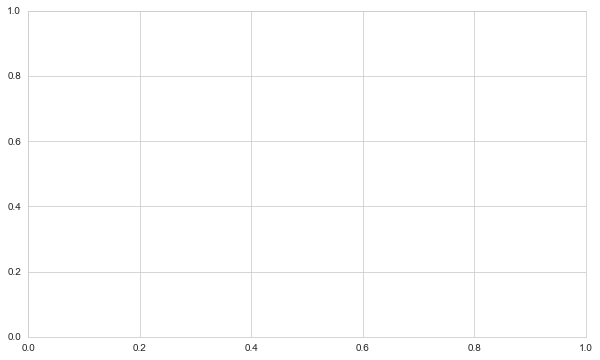

In [32]:
fig, ax = plt.subplots(figsize=(10, 6))

avg_norm = metrics_df.groupby("step").mean()["norm"]
avg_norm_of_bulk = metrics_df.loc[metrics_df["embed_idx"] != task_addition_vec_idx].groupby("step").mean()["norm"]
norm_of_readout = metrics_df.loc[metrics_df["embed_idx"] == task_addition_vec_idx].groupby("step").mean()["norm"]

bulk_center_norms = np.array([bulk_center.norm().item() for bulk_center in bulk_centers])
center_norms = np.array([center.norm().item() for center in centers])

frac_bulk_center_norms = bulk_center_norms / avg_norm
frac_center_norms = center_norms / avg_norm

sns.lineplot(x=steps, y=frac_bulk_center_norms, ax=ax, color=PRIMARY, label="Bulk center norms", linewidth=2)
sns.lineplot(x=steps, y=frac_center_norms, ax=ax, color=SECONDARY, label="Center norms", linewidth=2)

ax.set_yscale('log')
ax.set_xscale('log')

add_milestones(np.array([ax]), max_step=MAX_STEP)

ax.set_title("Embedding vector norm")
# ax.legend().remove()


Text(0.5, 1.0, 'Embedding vector norm')

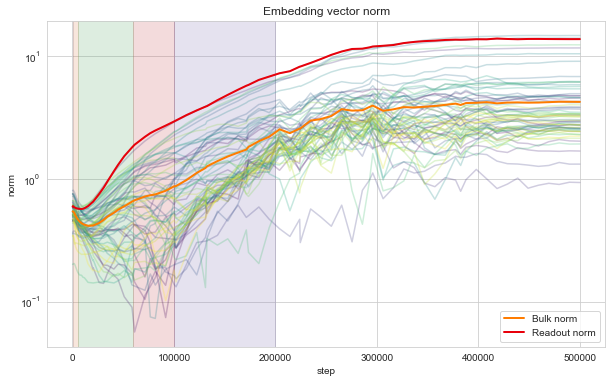

In [33]:
fig, ax = plt.subplots(figsize=(10, 6))

# avg_norm = metrics_df.groupby("step").mean()["norm"]

sns.lineplot(data=metrics_df, x="step", y="norm", hue="embed_idx", palette="viridis", ax=ax, alpha=0.25, legend=False)
# sns.lineplot(data=avg_norm, x=avg_norm.index, y=avg_norm, ax=ax, color="red", label="Average norm")

avg_norm = metrics_df.groupby("step").mean()["norm"]
bulk_norm = metrics_df.loc[metrics_df["embed_idx"] != task_addition_vec_idx].groupby("step").mean()["norm"]
readout_norm = metrics_df.loc[metrics_df["embed_idx"] == task_addition_vec_idx].groupby("step").mean()["norm"]

sns.lineplot(data=bulk_norm, x=bulk_norm.index, y=bulk_norm, ax=ax, color=BORANGE, label="Bulk norm", linewidth=2)
sns.lineplot(data=readout_norm, x=readout_norm.index, y=readout_norm, ax=ax, color=BRED, label="Readout norm", linewidth=2)

ax.set_yscale('log')
# ax.set_xscale('log')

add_milestones(np.array([ax]), max_step=MAX_STEP)

ax.set_title("Embedding vector norm")
# ax.legend().remove()

Text(0.5, 1.0, 'Embedding vector norm')

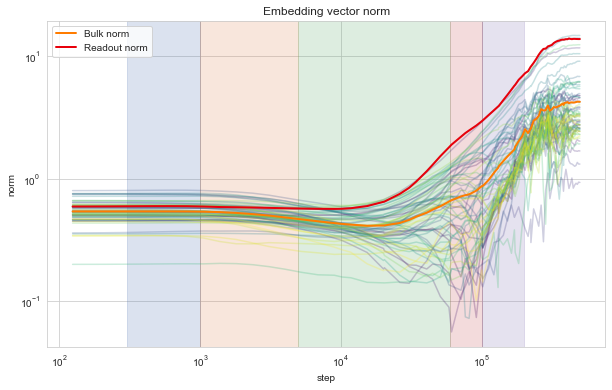

In [34]:
BBLUE, BORANGE, BGREEN, BRED = sns.color_palette('bright')[:4]

fig, ax = plt.subplots(figsize=(10, 6))

# avg_norm = metrics_df.groupby("step").mean()["norm"]

sns.lineplot(data=metrics_df, x="step", y="norm", hue="embed_idx", palette="viridis", ax=ax, alpha=0.25, legend=False)
# sns.lineplot(data=avg_norm, x=avg_norm.index, y=avg_norm, ax=ax, color="red", label="Average norm")

bulk_norm = metrics_df.loc[metrics_df["embed_idx"] != task_addition_vec_idx].groupby("step").mean()["norm"]
readout_norm = metrics_df.loc[metrics_df["embed_idx"] == task_addition_vec_idx].groupby("step").mean()["norm"]

sns.lineplot(data=bulk_norm, x=bulk_norm.index, y=bulk_norm, ax=ax, color=BORANGE, label="Bulk norm", linewidth=2)
sns.lineplot(data=readout_norm, x=readout_norm.index, y=readout_norm, ax=ax, color=BRED, label="Readout norm", linewidth=2)

ax.set_yscale('log')
ax.set_xscale('log')

add_milestones(np.array([ax]), max_step=MAX_STEP)

ax.set_title("Embedding vector norm")
# ax.legend().remove()

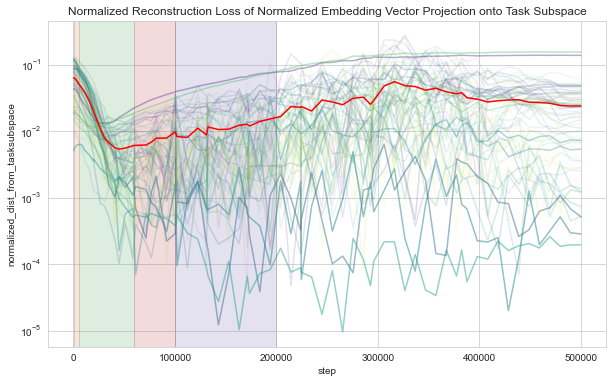

In [35]:
fig, ax = plt.subplots(figsize=(10, 6))

avg_dist_from_subspace = metrics_df.groupby("step").mean()["normalized_dist_from_tasksubspace"]

viridis = sns.color_palette("viridis", 64)

for i in range(64):
    subset = metrics_df.loc[metrics_df.embed_idx==i]
    alpha = subset.frac_norm.values[-1].item()
    color = viridis[i]
    sns.lineplot(data=subset, x="step", y="normalized_dist_from_tasksubspace", ax=ax, alpha=0.5 * alpha, color=color)

# sns.lineplot(data=metrics_df, x="step", y="normalized_dist_from_tasksubspace", hue="embed_idx", palette="viridis", ax=ax, alpha=0.25)
sns.lineplot(data=avg_dist_from_subspace, x=avg_dist_from_subspace.index, y=avg_dist_from_subspace, ax=ax, color="red", label="Average distance from task subspace")
ax.set_yscale('log')
# ax.set_xscale('log')

add_milestones(np.array([ax]), max_step=MAX_STEP)

ax.set_title("Normalized Reconstruction Loss of Normalized Embedding Vector Projection onto Task Subspace")
ax.legend().remove()

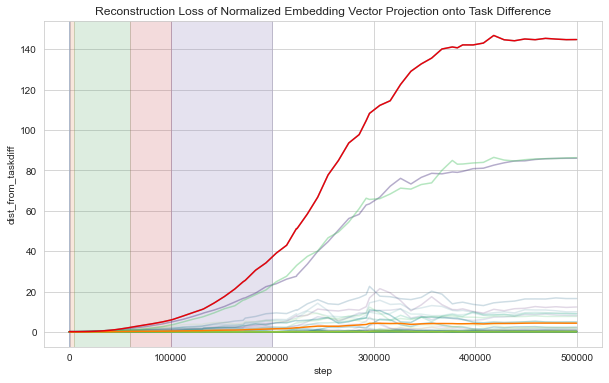

In [36]:
fig, ax = plt.subplots(figsize=(10, 6))

bulk_dist_from_taskdiff = metrics_df.loc[metrics_df.embed_idx!=35].groupby("step").mean()["dist_from_taskdiff"]
readout_dist_from_taskdiff = metrics_df.loc[metrics_df.embed_idx==35]

# sns.lineplot(data=metrics_df, x="step", y="dist_from_taskdiff", hue="embed_idx", palette="viridis", ax=ax, alpha=0.25)

viridis = sns.color_palette("viridis", 64)

for i in range(64):
    subset = metrics_df.loc[metrics_df.embed_idx==i]
    alpha = subset.frac_norm.values[-1].item()
    color = viridis[i]
    sns.lineplot(data=subset, x="step", y="dist_from_taskdiff", ax=ax, alpha=0.5 * alpha, color=color)

sns.lineplot(data=bulk_dist_from_taskdiff, x=bulk_dist_from_taskdiff.index, y=bulk_dist_from_taskdiff, ax=ax, color=BORANGE, label="Average bulk distance from task diff")
sns.lineplot(data=readout_dist_from_taskdiff, x=readout_dist_from_taskdiff.step, y=readout_dist_from_taskdiff.dist_from_taskdiff, ax=ax, color=BRED, label="Readout distance from task diff")
# ax.set_yscale('log')
# ax.set_xscale('log')

add_milestones(np.array([ax]), max_step=MAX_STEP)

ax.set_title("Reconstruction Loss of Normalized Embedding Vector Projection onto Task Difference")
ax.legend().remove()

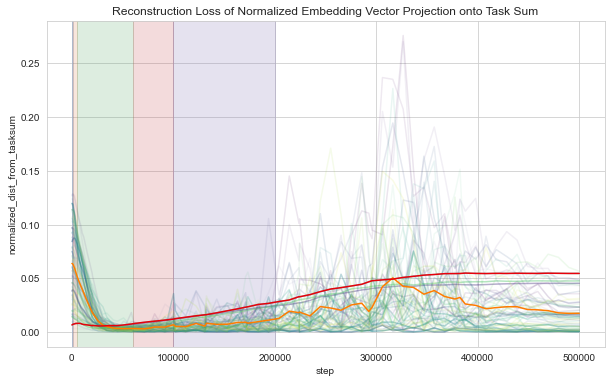

In [37]:
fig, ax = plt.subplots(figsize=(10, 6))

bulk_normalized_dist_from_tasksum = metrics_df.loc[metrics_df.embed_idx!=35].groupby("step").mean()["normalized_dist_from_tasksum"]
readout_normalized_dist_from_tasksum = metrics_df.loc[metrics_df.embed_idx==35]

# sns.lineplot(data=metrics_df, x="step", y="normalized_dist_from_tasksum", hue="embed_idx", palette="viridis", ax=ax, alpha=0.25)

viridis = sns.color_palette("viridis", 64)

for i in range(64):
    subset = metrics_df.loc[metrics_df.embed_idx==i]
    alpha = subset.frac_norm.values[-1].item()
    color = viridis[i]
    sns.lineplot(data=subset, x="step", y="normalized_dist_from_tasksum", ax=ax, alpha=0.5 * alpha, color=color)

sns.lineplot(data=bulk_normalized_dist_from_tasksum, x=bulk_normalized_dist_from_tasksum.index, y=bulk_normalized_dist_from_tasksum, ax=ax, color=BORANGE, label="Average bulk distance from task diff")
sns.lineplot(data=readout_normalized_dist_from_tasksum, x=readout_normalized_dist_from_tasksum.step, y=readout_normalized_dist_from_tasksum.normalized_dist_from_tasksum, ax=ax, color=BRED, label="Readout distance from task diff")
# ax.set_yscale('log')
# ax.set_xscale('log')

add_milestones(np.array([ax]), max_step=MAX_STEP)

ax.set_title("Reconstruction Loss of Normalized Embedding Vector Projection onto Task Sum")
ax.legend().remove()

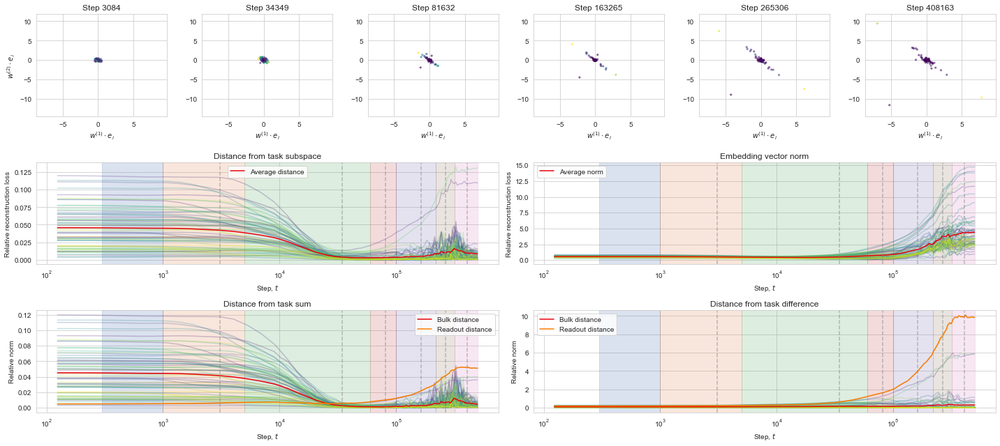

In [38]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.gridspec as gridspec

# Your existing setup code
# highlight_steps = [1000, 10000, 25000, 80000, 150000, 250000, 400000]
highlight_steps = [0.5 * (m1 + m2) for m1, m2, _ in TRANSITIONS][1:]

def get_nearest_step(step):
    idx = np.argmin(np.abs(np.array(steps) - step))
    return steps[idx]

highlight_steps = list(map(get_nearest_step, highlight_steps))
metrics_restriction = metrics_df.loc[metrics_df.step.isin(highlight_steps)]

xmin, xmax = metrics_restriction.task0_comp.min() * 1.25, metrics_restriction.task0_comp.max() * 1.25 
ymin, ymax = metrics_restriction.task1_comp.min() * 1.25, metrics_restriction.task1_comp.max() * 1.25

# Create a GridSpec layout
fig = plt.figure(figsize=(20, 9))  # Adjust the size as needed
gs = gridspec.GridSpec(3, len(highlight_steps))  # 3 rows, one for each set of highlight_steps

# Place your original plots in the first row
for i, step in enumerate(highlight_steps):
    ax = plt.subplot(gs[0, i])  # First row, ith column
    subset = metrics_df.loc[metrics_df.step==step]
    task0_comp, task1_comp = subset.task0_comp.values, subset.task1_comp.values

    ax.scatter(task0_comp, task1_comp, c=subset.dist_from_tasksubspace, cmap="viridis", alpha=0.5, s=5)    
    ax.set_title(f"Step {step}")
    ax.set_xlabel(r"$w^{(1)}\cdot e_i$")

    if i == 0:
        ax.set_ylabel(r"$w^{(2)}\cdot e_i$")

    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)

num_total_cols = len(highlight_steps)
num_cols = 2
extra_axes = []

# Add your additional plots in the new rows
for row in range(1, 3):  # Second and third rows
    for col in range(num_cols):
        ax = plt.subplot(gs[row, col * num_total_cols // num_cols:(col + 1) * num_total_cols // num_cols])
        ax.set_xlabel("Step, $t$")
        extra_axes.append(ax)

        if row == 1:
            ax.set_ylabel("Relative reconstruction loss")
        elif row == 2:
            ax.set_ylabel("Relative norm")

        # ax.set_yscale("log")
        ax.set_xscale("log")

ax_subspace_dist = extra_axes[0]
dist_ycol = "rel_dist_from_tasksubspace"
sns.lineplot(data=metrics_df, x="step", y=dist_ycol, hue="embed_idx", palette="viridis", ax=ax_subspace_dist, alpha=0.25, legend=False)
sns.lineplot(data=summary_stats_df, x="step", y=f"avg_{dist_ycol}", ax=ax_subspace_dist, color=BRED, label="Average distance")
ax_subspace_dist.set_title("Distance from task subspace")

ax_norms = extra_axes[1]
norm_ycol = "norm"
sns.lineplot(data=metrics_df, x="step", y=norm_ycol, hue="embed_idx", palette="viridis", ax=ax_norms, alpha=0.25, legend=False)
sns.lineplot(data=summary_stats_df, x="step", y=f"avg_{norm_ycol}", ax=ax_norms, color=BRED, label="Average norm")
ax_norms.set_title("Embedding vector norm")
# sns.lineplot(data=readout_df, x="step", y="norm", ax=ax_subspace_dist, color=BORANGE, label="Readout norm")

ax_sum = extra_axes[2]
sum_ycol = "rel_dist_from_tasksum"
sns.lineplot(data=metrics_df, x="step", y=sum_ycol, hue="embed_idx", palette="viridis", ax=ax_sum, alpha=0.25, legend=False)
sns.lineplot(data=summary_stats_df, x="step", y=f"bulk_{sum_ycol}", ax=ax_sum, color=BRED, label="Bulk distance")
sns.lineplot(data=readout_df, x="step", y=sum_ycol, ax=ax_sum, color=BORANGE, label="Readout distance")
ax_sum.set_title("Distance from task sum")

ax_diff = extra_axes[3]
diff_ycol = "rel_dist_from_taskdiff"
sns.lineplot(data=metrics_df, x="step", y=diff_ycol, hue="embed_idx", palette="viridis", ax=ax_diff, alpha=0.25, legend=False)
sns.lineplot(data=summary_stats_df, x="step", y=f"bulk_{diff_ycol}", ax=ax_diff, color=BRED, label="Bulk distance")
sns.lineplot(data=readout_df, x="step", y=diff_ycol, ax=ax_diff, color=BORANGE, label="Readout distance")
ax_diff.set_title("Distance from task difference")

add_milestones(np.array(extra_axes))

def add_highlight_steps(axes, highlights):
    for ax in axes.flatten():
        for step in highlights:
            ax.axvline(step, color="gray", alpha=0.5, linestyle="--")

add_highlight_steps(np.array(extra_axes), highlight_steps)
plt.tight_layout()
plt.show()


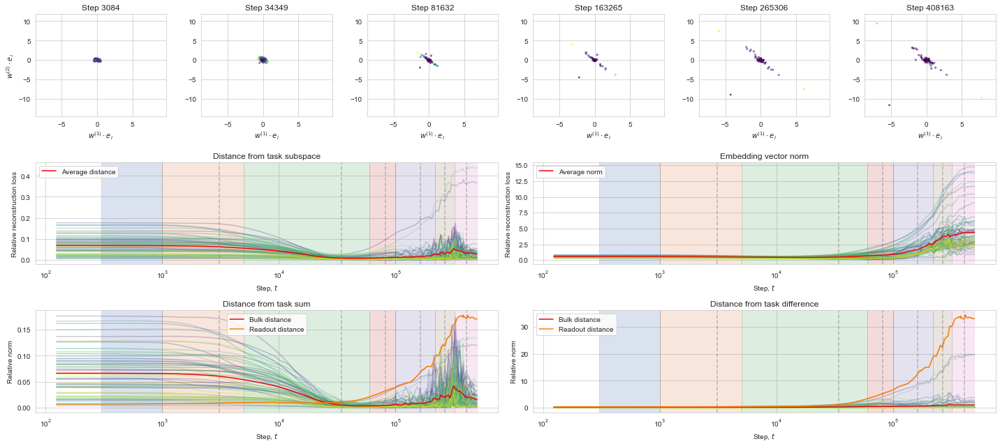

In [39]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.gridspec as gridspec

# Your existing setup code
# highlight_steps = [1000, 10000, 25000, 80000, 150000, 250000, 400000]
highlight_steps = [0.5 * (m1 + m2) for m1, m2, _ in TRANSITIONS][1:]

def get_nearest_step(step):
    idx = np.argmin(np.abs(np.array(steps) - step))
    return steps[idx]

highlight_steps = list(map(get_nearest_step, highlight_steps))
metrics_restriction = metrics_df.loc[metrics_df.step.isin(highlight_steps)]

xmin, xmax = metrics_restriction.task0_comp.min() * 1.25, metrics_restriction.task0_comp.max() * 1.25 
ymin, ymax = metrics_restriction.task1_comp.min() * 1.25, metrics_restriction.task1_comp.max() * 1.25

# Create a GridSpec layout
fig = plt.figure(figsize=(20, 9))  # Adjust the size as needed
gs = gridspec.GridSpec(3, len(highlight_steps))  # 3 rows, one for each set of highlight_steps

# Place your original plots in the first row
for i, step in enumerate(highlight_steps):
    ax = plt.subplot(gs[0, i])  # First row, ith column
    subset = metrics_df.loc[metrics_df.step==step]
    task0_comp, task1_comp = subset.task0_comp.values, subset.task1_comp.values

    ax.scatter(task0_comp, task1_comp, c=subset.dist_from_tasksubspace, cmap="viridis", alpha=0.5, s=5)    
    ax.set_title(f"Step {step}")
    ax.set_xlabel(r"$w^{(1)}\cdot e_i$")

    if i == 0:
        ax.set_ylabel(r"$w^{(2)}\cdot e_i$")

    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)

num_total_cols = len(highlight_steps)
num_cols = 2
extra_axes = []

# Add your additional plots in the new rows
for row in range(1, 3):  # Second and third rows
    for col in range(num_cols):
        ax = plt.subplot(gs[row, col * num_total_cols // num_cols:(col + 1) * num_total_cols // num_cols])
        ax.set_xlabel("Step, $t$")
        extra_axes.append(ax)

        if row == 1:
            ax.set_ylabel("Relative reconstruction loss")
        elif row == 2:
            ax.set_ylabel("Relative norm")

        # ax.set_yscale("log")
        ax.set_xscale("log")

ax_subspace_dist = extra_axes[0]
dist_ycol = "adj_dist_from_tasksubspace"
sns.lineplot(data=metrics_df, x="step", y=dist_ycol, hue="embed_idx", palette="viridis", ax=ax_subspace_dist, alpha=0.25, legend=False)
sns.lineplot(data=summary_stats_df, x="step", y=f"avg_{dist_ycol}", ax=ax_subspace_dist, color=BRED, label="Average distance")
ax_subspace_dist.set_title("Distance from task subspace")

ax_norms = extra_axes[1]
norm_ycol = "norm"
sns.lineplot(data=metrics_df, x="step", y=norm_ycol, hue="embed_idx", palette="viridis", ax=ax_norms, alpha=0.25, legend=False)
sns.lineplot(data=summary_stats_df, x="step", y=f"avg_{norm_ycol}", ax=ax_norms, color=BRED, label="Average norm")
ax_norms.set_title("Embedding vector norm")
# sns.lineplot(data=readout_df, x="step", y="norm", ax=ax_subspace_dist, color=BORANGE, label="Readout norm")

ax_sum = extra_axes[2]
sum_ycol = "adj_dist_from_tasksum"
sns.lineplot(data=metrics_df, x="step", y=sum_ycol, hue="embed_idx", palette="viridis", ax=ax_sum, alpha=0.25, legend=False)
sns.lineplot(data=summary_stats_df, x="step", y=f"bulk_{sum_ycol}", ax=ax_sum, color=BRED, label="Bulk distance")
sns.lineplot(data=readout_df, x="step", y=sum_ycol, ax=ax_sum, color=BORANGE, label="Readout distance")
ax_sum.set_title("Distance from task sum")

ax_diff = extra_axes[3]
diff_ycol = "adj_dist_from_taskdiff"
sns.lineplot(data=metrics_df, x="step", y=diff_ycol, hue="embed_idx", palette="viridis", ax=ax_diff, alpha=0.25, legend=False)
sns.lineplot(data=summary_stats_df, x="step", y=f"bulk_{diff_ycol}", ax=ax_diff, color=BRED, label="Bulk distance")
sns.lineplot(data=readout_df, x="step", y=diff_ycol, ax=ax_diff, color=BORANGE, label="Readout distance")
ax_diff.set_title("Distance from task difference")

add_milestones(np.array(extra_axes))

def add_highlight_steps(axes, highlights):
    for ax in axes.flatten():
        for step in highlights:
            ax.axvline(step, color="gray", alpha=0.5, linestyle="--")

add_highlight_steps(np.array(extra_axes), highlight_steps)
plt.tight_layout()
plt.show()


In [40]:
projected_embeds_over_time = []

for step, embed in zip(steps, normalized_embedding_matrices):
    _x_embeds = embed[:, 1:].to("mps")
    projected_embeds_over_time.append(torch.matmul(_x_embeds, task_basis))

frames = []

for i, (step, embed) in enumerate(zip(steps, normalized_embedding_matrices)):
    _x_embeds = embed[:, 1:].to("mps")
    projected_embeds = projected_embeds_over_time[i]
    reembedded_projections = torch.matmul(projected_embeds, task_basis.T)
    dist_from_proj = np.linalg.norm(_x_embeds.detach().cpu().numpy() - reembedded_projections.detach().cpu().numpy(), axis=1)
    
    frame = go.Frame(
        data=[
            go.Scatter(
                x=projected_embeds[:, 0].detach().cpu().numpy(),
                y=projected_embeds[:, 1].detach().cpu().numpy(),
                mode='markers',
                marker=dict(
                    color=dist_from_proj, 
                    colorscale='Viridis', 
                    colorbar=dict(title="Distance from Projection"),
                    opacity=0.8
                )
            )
        ],
        name=str(step)
    )
    frames.append(frame)
    
# Calculate differences between successive steps for timing
diff_steps = [steps[i+1] - steps[i] for i in range(len(steps)-1)]
diff_steps.append(diff_steps[-1])  # Append the last difference for the last step

# Create steps for the slider
slider_steps = []
for i, step in enumerate(steps):
    step_duration = diff_steps[i] * 10  # Convert to milliseconds
    step_dict = {
        "args": [
            [str(step)],
            {
                "frame": {"duration": step_duration, "redraw": True},
                "mode": "immediate",
                "transition": {"duration": 10},
            },
        ],
        "label": str(step),
        "method": "animate",
    }
    slider_steps.append(step_dict)

fig = go.Figure(
    data=frames[0]['data'],
    layout=go.Layout(
        title="Projected Embeddings",
        updatemenus=[dict(type='buttons', showactive=True, buttons=[dict(label='Play', method='animate', args=[None, dict(frame=dict(duration=1000, redraw=True), fromcurrent=True)])])],
        sliders=[{"active": 0, "yanchor": "top", "xanchor": "left", "currentvalue": {"font": {"size": 20}, "prefix": "Step:", "visible": True, "xanchor": "right"}, "pad": {"b": 10, "t": 50}, "len": 0.9, "x": 0.1, "y": 0, "steps": slider_steps}],
        xaxis_title="Task 0",
        yaxis_title="Task 1",
        xaxis=dict(range=[-25, 25]),
        yaxis=dict(range=[-25, 25]),
        width=1200,  
        height=1200   
    ),
    frames=frames
)

fig.show()



### Y embedding

Text(0.5, 0, 'Step')

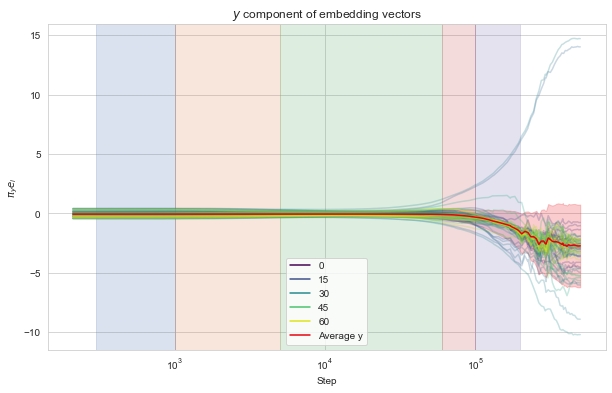

In [41]:
y_embeds = pd.DataFrame([{"step": step, "embed_idx": i, "y": y.item()} for step, vec in zip(steps[18:], embedding_matrices[18:]) for i, y in enumerate(vec[:, 0])])
y_embeds_dropped_embed_idx= pd.DataFrame([{"step": step, "y": y.item()} for step, vec in zip(steps[18:], embedding_matrices[18:]) for y in vec[:, 0]])

fig, ax = plt.subplots(figsize=(10, 6))

sns.lineplot(data=y_embeds, x="step", y="y", ax=ax, hue="embed_idx", palette="viridis", alpha=0.25)
sns.lineplot(data=y_embeds, x="step", y="y", ax=ax, errorbar="sd", label="Average y", color=BRED)
add_milestones(np.array([ax]), max_step=MAX_STEP)

ax.set_xscale('log')
ax.set_title("$y$ component of embedding vectors")
ax.set_ylabel(r"$\pi_y e_i$")
ax.set_xlabel("Step")

### PCA of embedding vectors over time


Text(0.5, 0, 'Step')

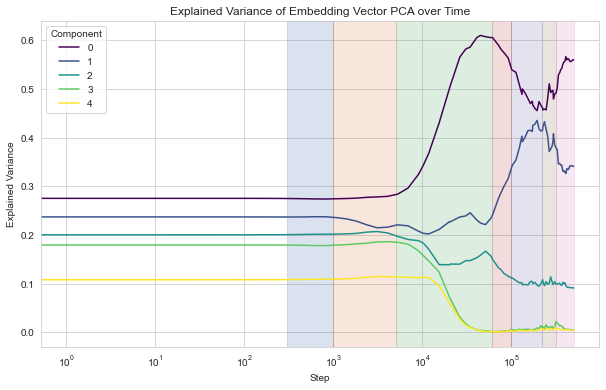

In [42]:
# PCA explained Variance over time
pcas = []

for model in models:
    embed = model.token_sequence_transformer.token_embedding.weight.detach().cpu().numpy()
    pca = PCA(n_components=embed.shape[1])
    proj = pca.fit_transform(embed)[:,:3]
    pcas.append((proj, pca))

explained_variances = [{"value": value, "index": idx, "step": step} for step, (_, pca) in zip(steps, pcas) for idx, value in enumerate(pca.explained_variance_ratio_)]
explained_variances = pd.DataFrame(explained_variances)

fig, ax = plt.subplots(figsize=(10, 6))
sns.lineplot(data=explained_variances, x="step", y="value", hue="index", palette="viridis", ax=ax)
ax.legend(title="Component", loc='upper left')
add_milestones(np.array([ax]))
ax.set_xscale('log')
ax.set_title("Explained Variance of Embedding Vector PCA over Time")
ax.set_ylabel("Explained Variance")
ax.set_xlabel("Step")

Text(0.5, 0, 'Step')

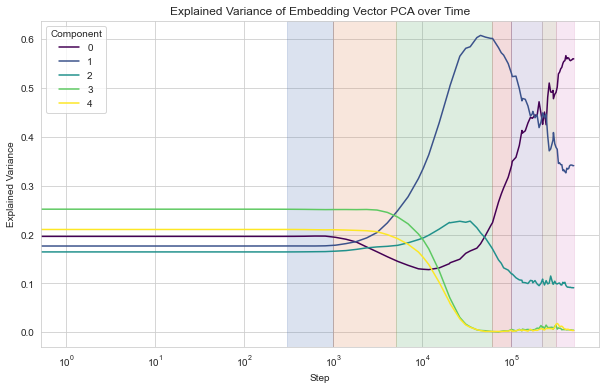

In [43]:
# Using the final PCA

def compute_explained_variance(pca, embed):
    proj = pca.transform(embed)

    # Step 4 and 5: Compute variance of projected data and total variance
    variance_projected = np.var(proj, axis=0)
    total_variance = np.sum(variance_projected)

    # Step 6: Calculate explained variance ratio
    explained_variance_ratio = variance_projected / total_variance

    return explained_variance_ratio

explained_variances_rel_last_pca = [{"value": value, "index": idx, "step": step} for step, embed in zip(steps, embedding_matrices) for idx, value in enumerate(compute_explained_variance(pcas[-1][-1], embed.detach().cpu().numpy()))]
explained_variances_rel_last_pca = pd.DataFrame(explained_variances_rel_last_pca)

fig, ax = plt.subplots(figsize=(10, 6))
sns.lineplot(data=explained_variances_rel_last_pca, x="step", y="value", hue="index", palette="viridis", ax=ax)
ax.legend(title="Component", loc='upper left')
add_milestones(np.array([ax]))
ax.set_xscale('log')
ax.set_title("Explained Variance of Embedding Vector PCA over Time")
ax.set_ylabel("Explained Variance")
ax.set_xlabel("Step")

In [44]:
pca_final = pcas[-1][-1]
pca_final.components_[:3, :]


array([[ 0.99840516, -0.01214787, -0.00751522, -0.05058235,  0.02060895],
       [ 0.05071861,  0.4709285 ,  0.18311097,  0.8614651 ,  0.00165461],
       [ 0.02424761, -0.5501412 , -0.22007295,  0.3474859 , -0.726346  ]],
      dtype=float32)

[7.933793676810417, 0.8945543184626755, 0.9256849916287487, 1.08915035753067, 1.023385167541885, 5.420007, 0.70428663, 0.8526169, 3.0303805, 0.67912036, 7.2892127, 1.6277932, 3.4905958, 1.9647044, 3.359435] 15


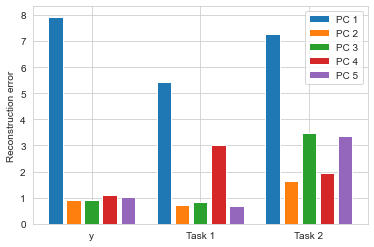

In [45]:
y = torch.tensor([1, 0, 0, 0, 0]).to('mps')
task0_embed = torch.zeros(5).to('mps')
task0_embed[1:] = tasks[0]
task1_embed = torch.zeros(5).to('mps')
task1_embed[1:] = tasks[1]

def get_pca_reconstruction_errors(pca, embed):
    proj = pca.transform(embed.reshape(1, -1))
    
    errors = []

    for comp in pca.components_:
        reembedded = np.matmul(proj, comp) 
        errors.append(np.linalg.norm(embed - reembedded))

    return errors

y_reconstruction_errors = [get_pca_reconstruction_errors(pca, y.detach().cpu().numpy()) for _, pca in pcas]
task0_reconstruction_errors = [get_pca_reconstruction_errors(pca, task0_embed.detach().cpu().numpy()) for _, pca in pcas]
task1_reconstruction_errors = [get_pca_reconstruction_errors(pca, task1_embed.detach().cpu().numpy()) for _, pca in pcas]

final_reconstruction_errors = [
    *y_reconstruction_errors[-1],
    *task0_reconstruction_errors[-1],
    *task1_reconstruction_errors[-1]
]

print(final_reconstruction_errors, len(final_reconstruction_errors))

# final_reconstruction_errors = [1] * 15

for i in range(5):
    plt.bar(np.arange(i, 18, 6), final_reconstruction_errors[i::5], label=f"PC {i+1}")


plt.ylabel("Reconstruction error")
plt.xlabel("")
plt.xticks(np.arange(2, 15, 6), ["y", "Task 1", "Task 2"])
plt.legend()


## Layer norms

,value,std,frac_nonzero,index,step,layer,layer_pretty
0,8.000000,4.567838e-08,1.000000,0,0,unembed,Unembed
1,8.000000,1.126422e-07,1.000000,1,1,unembed,Unembed
2,8.000000,2.257845e-07,1.000000,2,2,unembed,Unembed
3,7.999999,3.597503e-07,1.000000,3,3,unembed,Unembed
4,7.999999,5.466984e-07,1.000000,4,4,unembed,Unembed
...,...,...,...,...,...,...,...
475,7.562551,8.589303e-01,0.203125,91,459183,block_2_mlp,Block 2 Mlp
476,7.572585,8.618812e-01,0.218750,92,469387,block_2_mlp,Block 2 Mlp
477,7.589704,8.651271e-01,0.203125,93,479591,block_2_mlp,Block 2 Mlp
478,7.621700,8.693601e-01,0.203125,94,489795,block_2_mlp,Block 2 Mlp


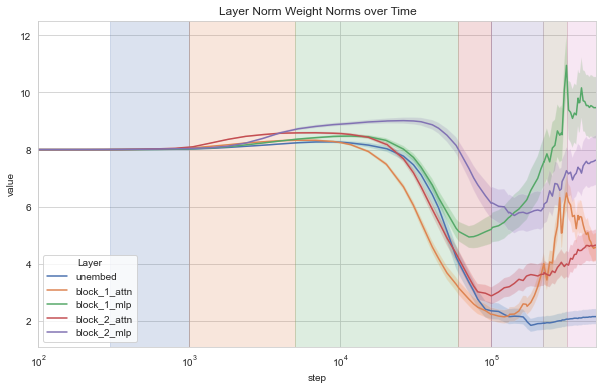

In [46]:
list(model.state_dict().keys())

def get_ln(model, key):
    return (model.state_dict()[f'{key}.weight'], model.state_dict()[f'{key}.bias'])

unembed_lns = [get_ln(model, 'token_sequence_transformer.unembedding.0') for model in models]
block_1_attn_lns =  [get_ln(model, 'token_sequence_transformer.blocks.0.layer_norms.0') for model in models]
block_1_mlp_lns =  [get_ln(model, 'token_sequence_transformer.blocks.0.layer_norms.1') for model in models]
block_2_attn_lns =  [get_ln(model, 'token_sequence_transformer.blocks.1.layer_norms.0') for model in models]
block_2_mlp_lns =  [get_ln(model, 'token_sequence_transformer.blocks.1.layer_norms.1') for model in models]

def ln_norm(weight, bias):
    return torch.norm(weight).detach().cpu().numpy()

def ln_norm_std(weight, bias):
    return torch.std(weight.abs()).detach().cpu().numpy()

unembed_ln_norms = [ln_norm(weight, bias) for weight, bias in unembed_lns]
block_1_attn_ln_norms = [ln_norm(weight, bias) for weight, bias in block_1_attn_lns]
block_1_mlp_ln_norms = [ln_norm(weight, bias) for weight, bias in block_1_mlp_lns]
block_2_attn_ln_norms = [ln_norm(weight, bias) for weight, bias in block_2_attn_lns]
block_2_mlp_ln_norms = [ln_norm(weight, bias) for weight, bias in block_2_mlp_lns]

unembed_ln_norms_std = np.array([ln_norm_std(weight, bias) for weight, bias in unembed_lns])
block_1_attn_ln_norms_std = np.array([ln_norm_std(weight, bias) for weight, bias in block_1_attn_lns])
block_1_mlp_ln_norms_std = np.array([ln_norm_std(weight, bias) for weight, bias in block_1_mlp_lns])
block_2_attn_ln_norms_std = np.array([ln_norm_std(weight, bias) for weight, bias in block_2_attn_lns])
block_2_mlp_ln_norms_std = np.array([ln_norm_std(weight, bias) for weight, bias in block_2_mlp_lns])

def frac_nonzero(weight, eps=1e-1):
    return (weight.abs() > eps).float().mean().detach().cpu().numpy()

unembed_ln_norm_nonzero = [frac_nonzero(weight) for weight, bias in unembed_lns]
block_1_attn_ln_norm_nonzero = [frac_nonzero(weight) for weight, bias in block_1_attn_lns]
block_1_mlp_ln_norm_nonzero = [frac_nonzero(weight) for weight, bias in block_1_mlp_lns]
block_2_attn_ln_norm_nonzero = [frac_nonzero(weight) for weight, bias in block_2_attn_lns]
block_2_mlp_ln_norm_nonzero = [frac_nonzero(weight) for weight, bias in block_2_mlp_lns]

ln_norms = pd.DataFrame([
    {"value": value.item(), "std": std_value, "frac_nonzero": nonzero.item(), "index": idx, "step": step, "layer": layer, "layer_pretty": layer.replace("_", " ").title()} 
    for layer in ["unembed", "block_1_attn", "block_1_mlp", "block_2_attn", "block_2_mlp"] 
    for idx, (step, value, std_value, nonzero) in enumerate(zip(steps, eval(f"{layer}_ln_norms"), eval(f"{layer}_ln_norms_std"), eval(f"{layer}_ln_norm_nonzero")))
]) 

fig, ax = plt.subplots(figsize=(10, 6))
sns.lineplot(data=ln_norms, x="step", y="value", hue="layer", palette="deep", ax=ax)

# Fill between using the std
for layer in ["unembed", "block_1_attn", "block_1_mlp", "block_2_attn", "block_2_mlp"]:
    ax.fill_between(steps, eval(f"{layer}_ln_norms") - eval(f"{layer}_ln_norms_std"), eval(f"{layer}_ln_norms") + eval(f"{layer}_ln_norms_std"), alpha=0.2)

ax.legend(title="Layer", loc='lower left')
add_milestones(np.array([ax]))
ax.set_title("Layer Norm Weight Norms over Time")
ax.set_xscale('log')
ax.set_xlim(100, 500_000)
ln_norms

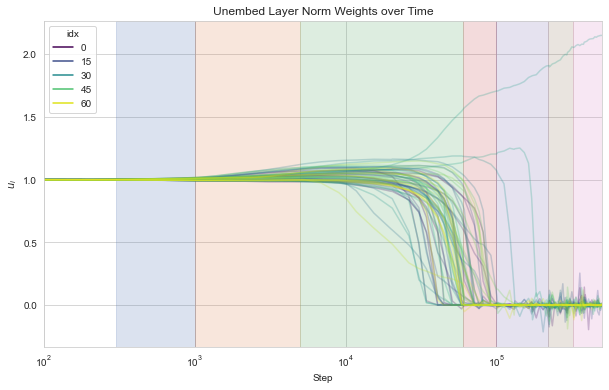

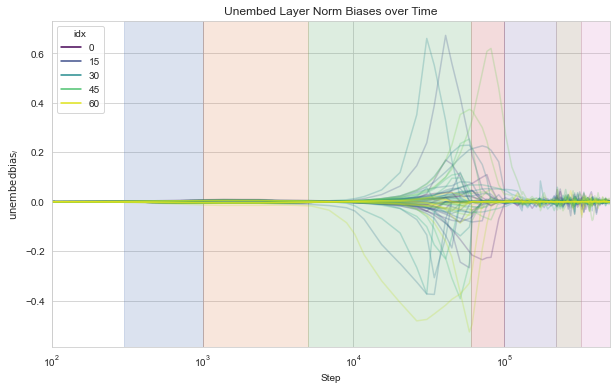

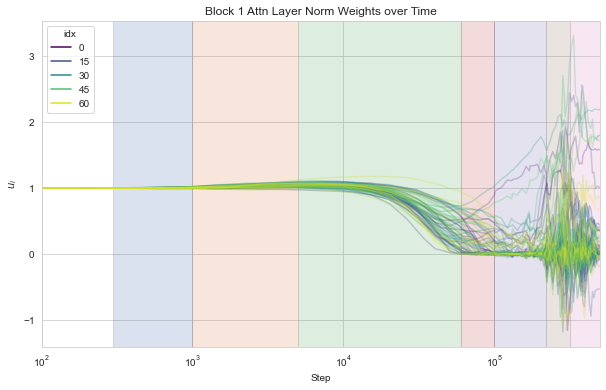

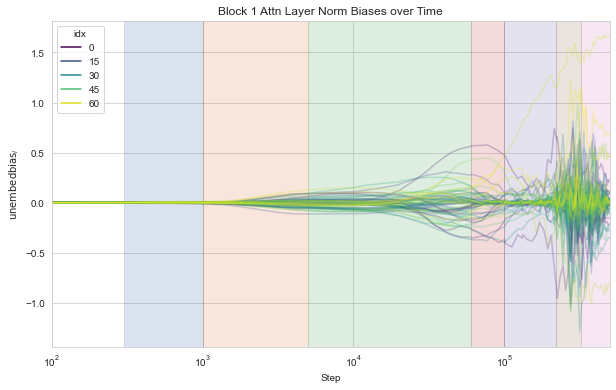

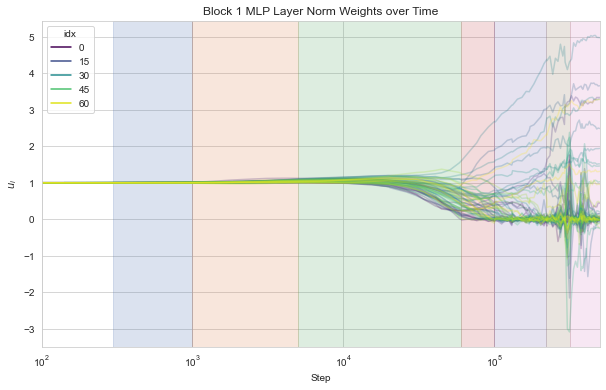

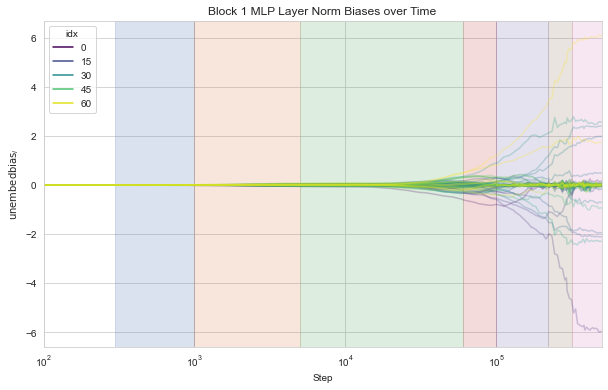

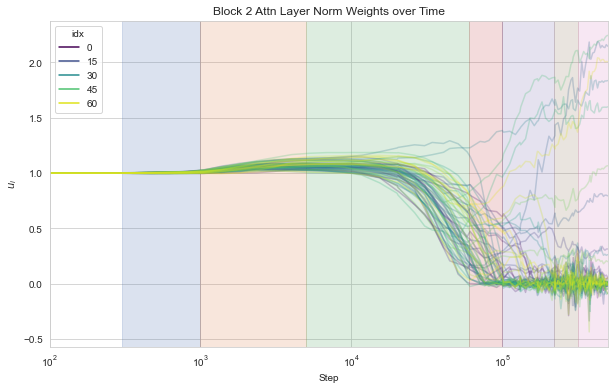

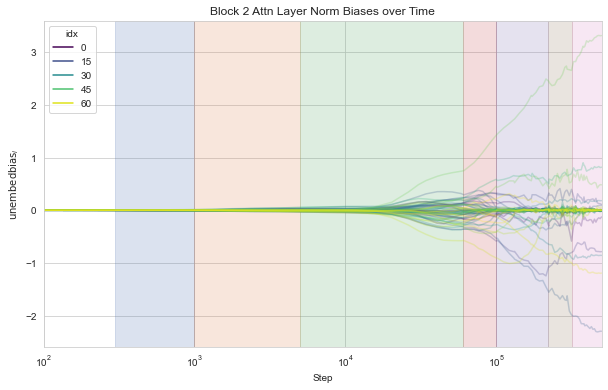

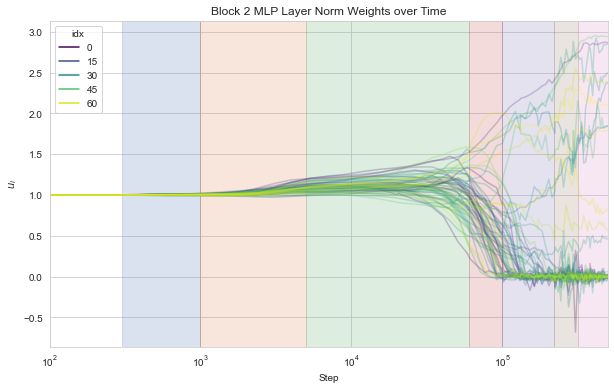

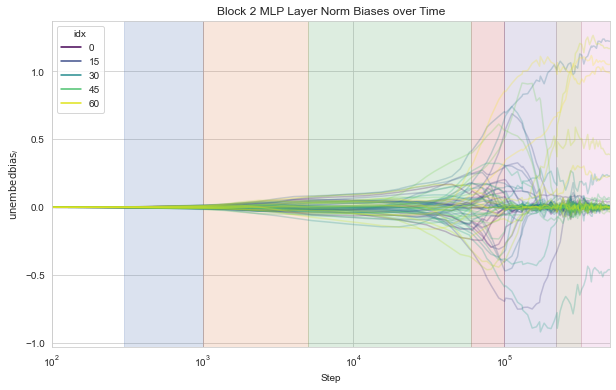

In [47]:
labels = ["Unembed", "Block 1 Attn", "Block 1 MLP", "Block 2 Attn", "Block 2 MLP"]

for i, lns in enumerate([unembed_lns, block_1_attn_lns, block_1_mlp_lns, block_2_attn_lns, block_2_mlp_lns]):
    label = labels[i]
    lns_df = pd.DataFrame([{"step": step, "idx": i, "weight": weight.item(), "bias": bias.item()} for step, (weights, biases) in zip(steps, lns) for i, (weight, bias) in enumerate(zip(weights, biases))])

    fig, ax = plt.subplots(figsize=(10, 6))
    sns.lineplot(data=lns_df, x="step", y="weight", hue="idx", palette="viridis", ax=ax, alpha=0.25)
    ax.set_xscale('log')
    ax.set_title(f"{label} Layer Norm Weights over Time")
    ax.set_ylabel("$u_i$")
    ax.set_xlabel("Step")
    ax.set_xlim(100, 500_000)
    add_milestones(np.array([ax]))
    
    fig, ax = plt.subplots(figsize=(10, 6))
    sns.lineplot(data=lns_df, x="step", y="bias", hue="idx", palette="viridis", ax=ax, alpha=0.25)
    ax.set_xscale('log')
    ax.set_title(f"{label} Layer Norm Biases over Time")
    ax.set_ylabel("$\mathrm{unembed bias}_i$")
    ax.set_xlabel("Step")
    ax.set_xlim(100, 500_000)
    add_milestones(np.array([ax]))

    plt.show()


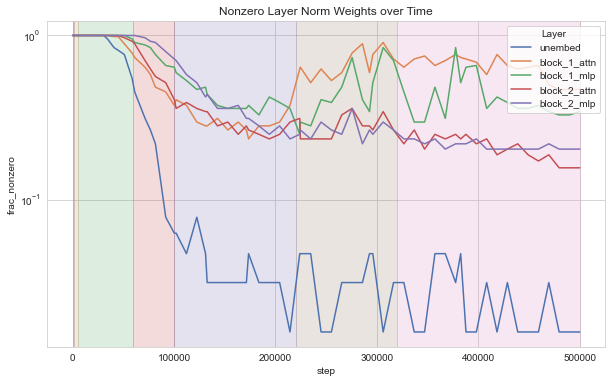

In [48]:
fig, ax = plt.subplots(figsize=(10, 6))
sns.lineplot(data=ln_norms, x="step", y="frac_nonzero", hue="layer", palette="deep", ax=ax)

ax.legend(title="Layer", loc='upper right')
add_milestones(np.array([ax]))
ax.set_title("Nonzero Layer Norm Weights over Time")

ax.set_yscale('log')

## Gradient norms

In [49]:
from torch.nn import functional as F

gradients = []

xs, ys = run.evaluator.pretrain_xs, run.evaluator.pretrain_ys

for model in models:
    model.eval()
    
    xs, ys = xs.to("mps"), ys.to("mps")

    yhats = model(xs, ys)
    loss = F.mse_loss(yhats, ys)
    loss.backward()

    gradients.append([p.grad.clone() for n, p in model.named_parameters()])

    for p in model.parameters():
        p.grad = None



        step     value                                               name
0          0  2.211837  token_sequence_transformer.token_embedding.weight
1          0  0.343357  token_sequence_transformer.postn_embedding.weight
2          0  1.330100  token_sequence_transformer.blocks.0.attention....
3          0  1.244004  token_sequence_transformer.blocks.0.compute.0....
4          0  0.158709  token_sequence_transformer.blocks.0.compute.0....
...      ...       ...                                                ...
2299  499999  0.004180  token_sequence_transformer.blocks.1.layer_norm...
2300  499999  0.000084    token_sequence_transformer.unembedding.0.weight
2301  499999  0.002272      token_sequence_transformer.unembedding.0.bias
2302  499999  0.000192    token_sequence_transformer.unembedding.1.weight
2303  499999  0.002381      token_sequence_transformer.unembedding.1.bias

[2304 rows x 3 columns]


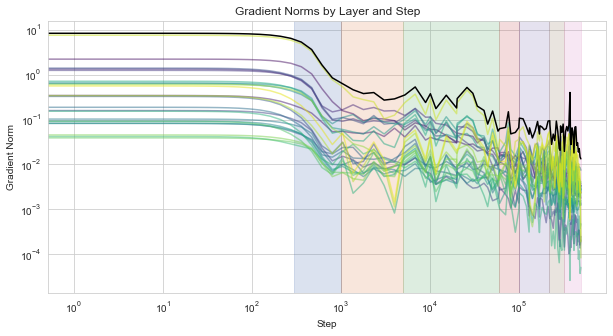

In [50]:
names = [n for n, _ in run.model.named_parameters()]

gradient_norms = pd.DataFrame([{"step": step, "value": torch.norm(g).item(), "name": n}  for step, gs in zip(steps, gradients) for n, g in zip(names, gs)])
full_gradient_norms = [(sum((g ** 2).sum() for g in gs) ** 0.5).item() for gs in gradients]

print(gradient_norms)

fig, ax = plt.subplots(figsize=(10, 5))

sns.lineplot(data=gradient_norms, x="step", y="value", hue="name", palette="viridis", ax=ax, alpha=0.5)
ax.plot(steps, full_gradient_norms, color="black", label="Full Norm")
ax.set_ylabel("Gradient Norm")
ax.set_xlabel("Step")
ax.set_title("Gradient Norms by Layer and Step")
ax.legend().remove()

add_milestones(np.array([ax]))

ax.set_yscale("log")
ax.set_xscale("log")

In [51]:
len(list((optimizer_state_dicts[0])["state"].values()))

24

        step     value                                               name
0          0  2.211837  token_sequence_transformer.token_embedding.weight
1          0  0.343357  token_sequence_transformer.postn_embedding.weight
2          0  1.330100  token_sequence_transformer.blocks.0.attention....
3          0  1.244004  token_sequence_transformer.blocks.0.compute.0....
4          0  0.158709  token_sequence_transformer.blocks.0.compute.0....
...      ...       ...                                                ...
2299  499999  0.004180  token_sequence_transformer.blocks.1.layer_norm...
2300  499999  0.000084    token_sequence_transformer.unembedding.0.weight
2301  499999  0.002272      token_sequence_transformer.unembedding.0.bias
2302  499999  0.000192    token_sequence_transformer.unembedding.1.weight
2303  499999  0.002381      token_sequence_transformer.unembedding.1.bias

[2304 rows x 3 columns]


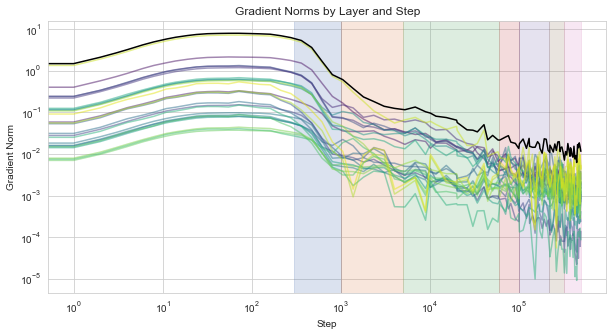

In [52]:
names = [n for n, _ in run.model.named_parameters()]

avg_gradients = [[g["exp_avg"] for g in gs["state"].values()] for gs in optimizer_state_dicts]

avg_gradient_norms = pd.DataFrame([{"step": step, "value": torch.norm(g).item(), "name": n}  for step, gs in zip(steps, avg_gradients) for n, g in zip(names, gs)])
full_avg_gradient_norms = [(sum((g ** 2).sum() for g in gs) ** 0.5).item() for gs in avg_gradients]

print(gradient_norms)

fig, ax = plt.subplots(figsize=(10, 5))

sns.lineplot(data=avg_gradient_norms, x="step", y="value", hue="name", palette="viridis", ax=ax, alpha=0.5)
ax.plot(steps, full_avg_gradient_norms, color="black", label="Full Norm")
ax.set_ylabel("Gradient Norm")
ax.set_xlabel("Step")
ax.set_title("Gradient Norms by Layer and Step")
ax.legend().remove()

add_milestones(np.array([ax]))

ax.set_yscale("log")
ax.set_xscale("log")

        step     value                                               name
0          0  2.211837  token_sequence_transformer.token_embedding.weight
1          0  0.343357  token_sequence_transformer.postn_embedding.weight
2          0  1.330100  token_sequence_transformer.blocks.0.attention....
3          0  1.244004  token_sequence_transformer.blocks.0.compute.0....
4          0  0.158709  token_sequence_transformer.blocks.0.compute.0....
...      ...       ...                                                ...
2299  499999  0.004180  token_sequence_transformer.blocks.1.layer_norm...
2300  499999  0.000084    token_sequence_transformer.unembedding.0.weight
2301  499999  0.002272      token_sequence_transformer.unembedding.0.bias
2302  499999  0.000192    token_sequence_transformer.unembedding.1.weight
2303  499999  0.002381      token_sequence_transformer.unembedding.1.bias

[2304 rows x 3 columns]


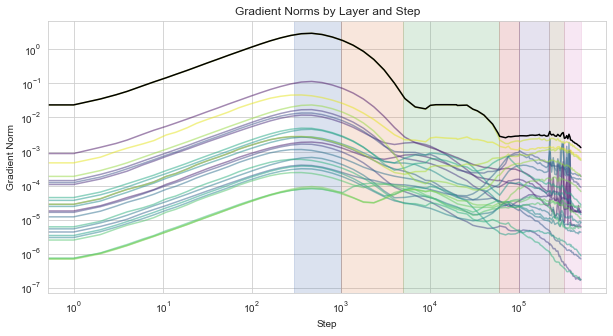

In [53]:
names = [n for n, _ in run.model.named_parameters()]

avg_sq_gradients = [[g["exp_avg_sq"] for g in gs["state"].values()] for gs in optimizer_state_dicts]

avg_sq_gradient_norms = pd.DataFrame([{"step": step, "value": torch.norm(g).item(), "name": n}  for step, gs in zip(steps, avg_sq_gradients) for n, g in zip(names, gs)])
full_avg_sq_gradient_norms = [(sum((g ** 2).sum() for g in gs) ** 0.5).item() for gs in avg_sq_gradients]

print(gradient_norms)

fig, ax = plt.subplots(figsize=(10, 5))

sns.lineplot(data=avg_sq_gradient_norms, x="step", y="value", hue="name", palette="viridis", ax=ax, alpha=0.5)
ax.plot(steps, full_avg_sq_gradient_norms, color="black", label="Full Norm")
ax.set_ylabel("Gradient Norm")
ax.set_xlabel("Step")
ax.set_title("Gradient Norms by Layer and Step")
ax.legend().remove()

add_milestones(np.array([ax]))

ax.set_yscale("log")
ax.set_xscale("log")

## Activations

In [63]:
from devinfra.utils.seed import set_seed

DEVICE = 'mps'

# Gonna override activations sorry.
losses_over_time = []
outputs_over_time = []
activation_stats_over_time = []

train_xs_noise, train_ys_noise = run.evaluator.pretrain_xs, run.evaluator.pretrain_ys

pretrain_dist_noiseless = run.config.task_config.pretrain_dist_factory().to(
    DEVICE
)
pretrain_dist_noiseless.var = 0.

set_seed(run.config.task_config.true_seed)

train_xs, train_ys = pretrain_dist_noiseless.get_batch(8, 8196)

# assert torch.allclose(train_xs, train_xs_noise)

resid_stream_layers = [
    "token_sequence_transformer.token_embedding",
    "token_sequence_transformer.blocks.0.resid_after_attn",
    "token_sequence_transformer.blocks.0",
    "token_sequence_transformer.blocks.1.resid_after_attn",
    "token_sequence_transformer.blocks.1"
]

act_stats_over_time = []

for step, model in zip(steps, models):
    hooked_model = hook(model)
    output, act = hooked_model.run_with_cache(train_xs, train_ys)
    outputs_over_time.append(output)
    losses_over_time.append(nn.MSELoss()(output, train_ys).item())
    
    for layer in resid_stream_layers:
        #print(act[layer].shape)
        act_stats_over_time.append({
            'mean': act[layer].mean().item(),  # mean over batch, over tokens, over activations
            'abs_mean': act[layer].mean(dim=-1).abs().mean().item(),  # mean over batch and tokens of abs mean over activations
            'var': act[layer].var().item(),  # var over batch, over tokens, over activations
            'batch_var_of_mean': act[layer].var(dim=-1).mean().item(),  # mean over batch and tokens of var over activations
            'batch_var_of_var': act[layer].var(dim=-1).var().item(),  # var over batch and tokens of var over activations
            'max': act[layer].max().item(),
            'min': act[layer].min().item(),
            "step": step, 
            "layer": layer,
            "layer_idx": resid_stream_layers.index(layer)
        })

act_stats_over_time = pd.DataFrame(act_stats_over_time)

In [581]:
from devinfra.utils.iterables import flatten_dict

act_stats_over_time

In [64]:
# act_stats_over_time = act_stats_over_time[act_stats_over_time["step"] > 0]


more_metrics_to_plot = [
    ("$\overline{|\mathrm{mean}[z^{(l)}_t]|}$", "abs_mean", {}),
#    ("Mean over batch, token index, and activation index of residual stream activations", "std", {}),
    ("$\overline{\mathrm{var}[z^{(l)}_t]}$", "batch_var_of_mean", {}),
#    ("Std over batch and token index of std within residual stream activations", "batch_std_of_std", {}),
]

layers = act_stats_over_time["layer"].unique()
slopes = np.zeros((len(layers), len(run.checkpointer.file_ids[1:])))

slopes_list = []

for (_, key, _) in more_metrics_to_plot:
    for j, layer in enumerate(layers):
        values = act_stats_over_time.loc[act_stats_over_time["layer"] == layer][key].values
        slopes[j, :] = dlog_dlogt(run.checkpointer.file_ids[1:], values)

    slopes_list.extend([{"layer": layer, "step": step, key: slopes[j, step_idx]} for j, layer in enumerate(layers) for step_idx, step in enumerate(run.checkpointer.file_ids[1:]) for slope in slopes])

slopes_df = pd.DataFrame(slopes_list)

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

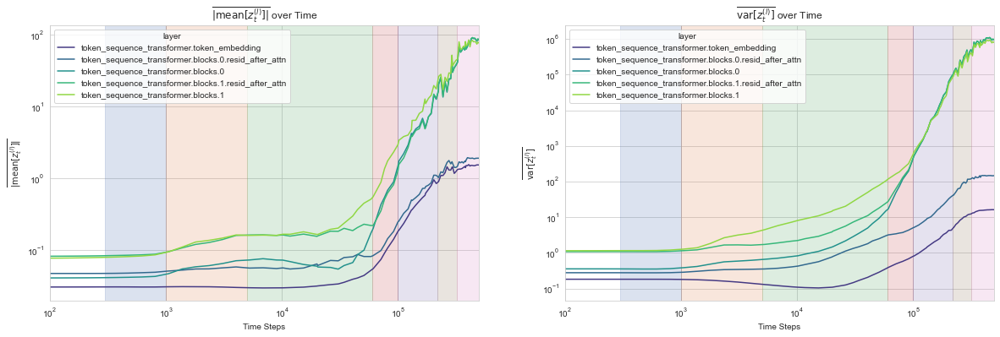

In [65]:
fig, axes = plt.subplots(1, len(more_metrics_to_plot), figsize=(20, 6))

# act_stats_over_time = act_stats_over_time[act_stats_over_time["step"] > 0]

for i, (metric_name, key, kwargs) in enumerate(more_metrics_to_plot):
    sns.lineplot(ax=axes[i], data=act_stats_over_time, x="step", y=key, hue='layer', palette='viridis')

    axes[i].set_title(metric_name + " over Time")
    axes[i].set_xlabel('Time Steps')
    axes[i].set_ylabel(metric_name)
    axes[i].set_yscale('log')

    # sns.lineplot(ax=axes[1, i], data=slopes_df, x="step", y=key, hue='layer', palette='viridis')
    # axes[1, i].set_title(metric_name + " Slope over Time")
    # axes[1, i].set_xlabel('Time Steps')
    # axes[1, i].set_ylabel(metric_name + " Slope")

add_milestones(axes)

for ax in axes.flatten():
    ax.set_xscale('log')
    ax.set_xlim(100, 500_000)

axes[0, 0].legend(title="Layer")
axes[0, 1].legend().remove()
fig.tight_layout()
fig.set_facecolor("white")

# axes[1, 0].set_ylim(-10, 10)
# axes[1, 1].set_ylim(-5, 5)

# Show the plots
plt.show()


# Reverse Engineering

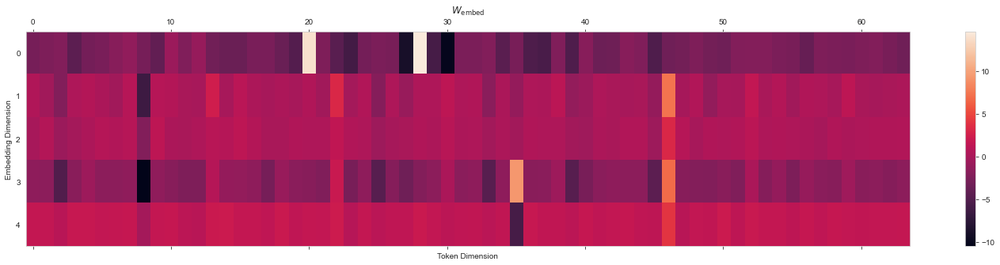

In [ ]:
# Let's look at the embeddings. 

embed_weights = run.model.token_sequence_transformer.token_embedding.weight

fig, ax0 = plt.subplots(1, 1, figsize=(25, 5))

cax = ax0.matshow(embed_weights.detach().cpu().numpy().T, aspect='auto')
ax0.set_title("$W_\mathrm{embed}$")
ax0.set_xlabel("Token Dimension")
ax0.set_ylabel("Embedding Dimension")
ax0.grid(False)
fig.colorbar(cax, ax=ax0)

# ax1.bar(range(len(embed_bias)), embed_bias.detach().cpu().numpy())
# ax1.set_title("$b_\mathrm{embed}$")
# ax1.set_xlabel("Dimension")
# ax1.set_ylabel("Weight")


<ipython-input-1010-95448129ad0e>:5: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).



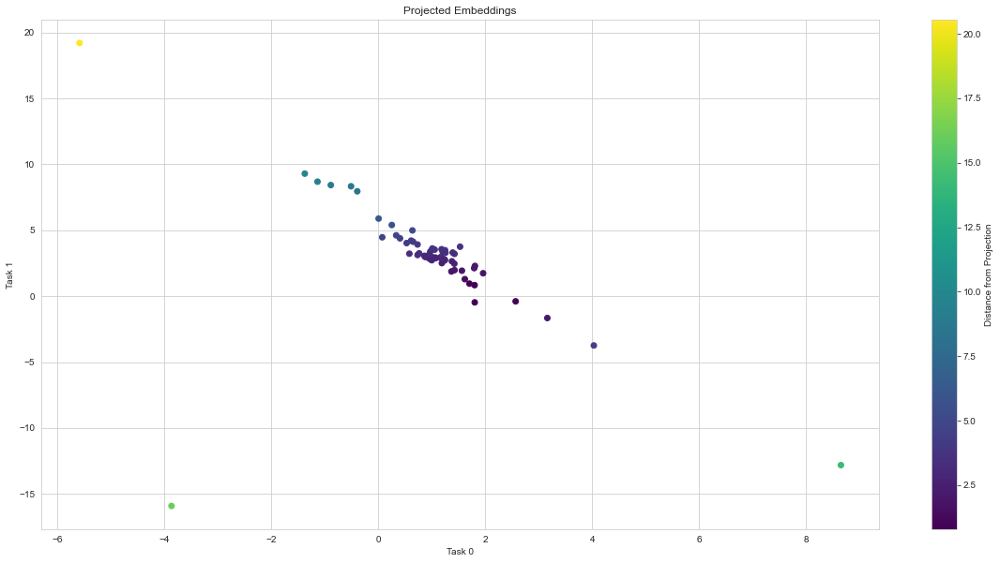

In [1010]:
# Wait what I should really be doing is checking whether the embedding vectors are in the plane spanned by the tasks. If so, what are their coordinates in that plane?

projection_matrix = torch.stack([tasks[0], tasks[1]], dim=1)
projected_embeds = torch.matmul(x_embeds, projection_matrix)
reembedded_projections = torch.matmul(torch.tensor(projected_embeds), projection_matrix.T)
projected_embeds = projected_embeds.detach().cpu().numpy()

# I also want to know how far from the plane they are.
dist_from_proj = np.linalg.norm(x_embeds.detach().cpu().numpy() - reembedded_projections.detach().cpu().numpy(), axis=1)
fig, ax0 = plt.subplots(1, 1, figsize=(20, 10))

cax = ax0.scatter(projected_embeds[:, 0], projected_embeds[:, 1], c=dist_from_proj, cmap='viridis')
ax0.set_title("Projected Embeddings")
ax0.set_xlabel("Task 0")
ax0.set_ylabel("Task 1")
fig.colorbar(cax, ax=ax0, label="Distance from Projection")

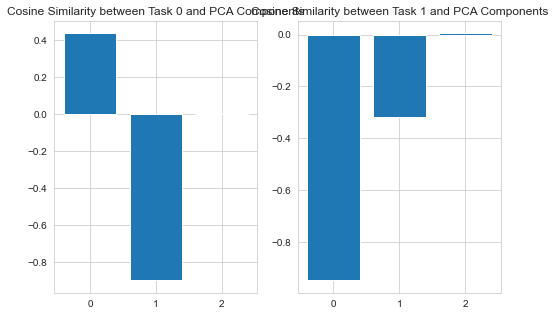

[0.77479714 0.20742752 0.00948194]
[[ 4.7039968e-01  1.8313658e-01  8.6324120e-01 -2.7251244e-04]
 [-5.5056572e-01 -2.1978842e-01  3.4641442e-01 -7.2702658e-01]
 [-4.8670644e-01  8.5663170e-01  8.3529949e-02  1.4940628e-01]]


In [1013]:
# I guess I should have just done the 3-component PCA from the start

pca = PCA(n_components=3)
pca_embeds = pca.fit_transform(x_embeds.detach().cpu().numpy())
dist_from_pca = np.linalg.norm(x_embeds.detach().cpu().numpy() - pca.inverse_transform(pca_embeds), axis=1)

# Create the 3D scatter plot using Plotly
fig = go.Figure(data=[
    go.Scatter3d(
        x=pca_embeds[:, 0],
        y=pca_embeds[:, 1],
        z=pca_embeds[:, 2],
        mode='markers',
        marker=dict(
            size=5,
            color=dist_from_pca, 
            colorscale='Viridis', 
            colorbar=dict(title="Distance from PCA"),
            opacity=0.8
        )
    )
])

fig.update_layout(
    title="PCA Embeddings",
    scene=dict(
        xaxis_title="PC 1",
        yaxis_title="PC 2",
        zaxis_title="PC 3"
    )
)

fig.show()

# So the first two components match the tasks. What is the third? 

# cos sims with the PCA components
task0_pca_cos_sims = []
task1_pca_cos_sims = []

for pca_comp in pca.components_:
    task0_pca_cos_sims.append(torch.cosine_similarity(torch.tensor(pca_comp, device="mps").unsqueeze(0).unsqueeze(-1), tasks[0].unsqueeze(0).unsqueeze(-1)).item())
    task1_pca_cos_sims.append(torch.cosine_similarity(torch.tensor(pca_comp, device="mps").unsqueeze(0).unsqueeze(-1), tasks[1].unsqueeze(0).unsqueeze(-1)).item())

task0_pca_cos_sims = np.array(task0_pca_cos_sims)
task1_pca_cos_sims = np.array(task1_pca_cos_sims)
task_cross_pca_cos_sims = np.abs(task0_pca_cos_sims - task1_pca_cos_sims)

fig, (ax0, ax1) = plt.subplots(1, 2, figsize=(8, 5))

ax0.bar(range(3), task0_pca_cos_sims, label="Task 0")
ax0.set_title("Cosine Similarity between Task 0 and PCA Components")

ax1.bar(range(3), task1_pca_cos_sims, label="Task 1")
ax1.set_title("Cosine Similarity between Task 1 and PCA Components")

plt.show()

print(pca.explained_variance_ratio_)
print(pca.components_)


In [ ]:
# At this point, I want more than anything to see the embeddings evolve over time. Do those extremes shoot off suddenly or not at all. But I'm going to bed. 
# Nevermind I'm going to do it

In [13]:
frames = []

for step, embed in zip(steps, embedding_matrices):
    _x_embeds = embed[:, 1:].to("mps")
    projection_matrix = torch.stack([tasks[0], tasks[1]], dim=1)
    projected_embeds = torch.matmul(_x_embeds, projection_matrix)
    reembedded_projections = torch.matmul(torch.tensor(projected_embeds), projection_matrix.T)
    projected_embeds = projected_embeds.detach().cpu().numpy()
    dist_from_proj = np.linalg.norm(_x_embeds.detach().cpu().numpy() - reembedded_projections.detach().cpu().numpy(), axis=1)
    
    frame = go.Frame(
        data=[
            go.Scatter(
                x=projected_embeds[:, 0],
                y=projected_embeds[:, 1],
                mode='markers',
                marker=dict(
                    color=dist_from_proj, 
                    colorscale='Viridis', 
                    colorbar=dict(title="Distance from Projection"),
                    opacity=0.8
                )
            )
        ],
        name=str(step)
    )
    frames.append(frame)
    
# Calculate differences between successive steps for timing
diff_steps = [steps[i+1] - steps[i] for i in range(len(steps)-1)]
diff_steps.append(diff_steps[-1])  # Append the last difference for the last step

# Create steps for the slider
slider_steps = []
for i, step in enumerate(steps):
    step_duration = diff_steps[i] * 10  # Convert to milliseconds
    step_dict = {
        "args": [
            [str(step)],
            {
                "frame": {"duration": step_duration, "redraw": True},
                "mode": "immediate",
                "transition": {"duration": 10},
            },
        ],
        "label": str(step),
        "method": "animate",
    }
    slider_steps.append(step_dict)

fig = go.Figure(
    data=frames[0]['data'],
    layout=go.Layout(
        title="Projected Embeddings",
        updatemenus=[dict(type='buttons', showactive=True, buttons=[dict(label='Play', method='animate', args=[None, dict(frame=dict(duration=1000, redraw=True), fromcurrent=True)])])],
        sliders=[{"active": 0, "yanchor": "top", "xanchor": "left", "currentvalue": {"font": {"size": 20}, "prefix": "Step:", "visible": True, "xanchor": "right"}, "pad": {"b": 10, "t": 50}, "len": 0.9, "x": 0.1, "y": 0, "steps": slider_steps}],
        xaxis_title="Task 0",
        yaxis_title="Task 1",
        xaxis=dict(range=[-25, 25]),
        yaxis=dict(range=[-25, 25]),
        width=1200,  
        height=1200   
    ),
    frames=frames
)

fig.show()



<ipython-input-13-2efa923b4354>:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  reembedded_projections = torch.matmul(torch.tensor(projected_embeds), projection_matrix.T)
<ipython-input-13-2efa923b4354>:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  reembedded_projections = torch.matmul(torch.tensor(projected_embeds), projection_matrix.T)


In [68]:
# Let's come back to this. 
# Looking at the embedding projection again, almost all embedding vectors can be characterized by a single number (where they sit on the line between (~6, 20) and (9, -13). There is a sole exception sitting orthogonal to the line.

# Let's first get the endpoints of the line

# Find the point closest to -6, 20
task_line_endpoint0 = projected_embeds[np.argmin(np.linalg.norm(projected_embeds - np.array([-6, 20]), axis=1))]

# Find the point closest to 9, -13
task_line_endpoint1 = projected_embeds[np.argmin(np.linalg.norm(projected_embeds - np.array([9, -13]), axis=1))]

# Find the orthogonal point close to -15, -4
task_line_orthogonal = projected_embeds[np.argmin(np.linalg.norm(projected_embeds - np.array([-15, -4]), axis=1))]


print(task_line_endpoint0, task_line_endpoint1, task_line_orthogonal)

# Reembed these points
task_line_endpoint0 = torch.matmul(torch.tensor(task_line_endpoint0, device="mps"), projection_matrix.T).detach().cpu().numpy()
task_line_endpoint1 = torch.matmul(torch.tensor(task_line_endpoint1, device="mps"), projection_matrix.T).detach().cpu().numpy()
task_line_orthogonal = torch.matmul(torch.tensor(task_line_orthogonal, device="mps"), projection_matrix.T).detach().cpu().numpy()


# Find the points closest to these in the original embedding

task_line_endpoint0 = x_embeds[np.argmin(np.linalg.norm(x_embeds.detach().cpu().numpy() - task_line_endpoint0, axis=1))]
task_line_endpoint1 = x_embeds[np.argmin(np.linalg.norm(x_embeds.detach().cpu().numpy() - task_line_endpoint1, axis=1))]
task_line_orthogonal = x_embeds[np.argmin(np.linalg.norm(x_embeds.detach().cpu().numpy() - task_line_orthogonal, axis=1))]

print(task_line_endpoint0, task_line_endpoint1, task_line_orthogonal)

# Let's find the indices of these dimensions
task_line_endpoint0_idx = np.argmin(np.linalg.norm(embed_weights[:, 1:].detach().cpu().numpy() - task_line_endpoint0.detach().cpu().numpy(), axis=1))
task_line_endpoint1_idx = np.argmin(np.linalg.norm(embed_weights[:, 1:].detach().cpu().numpy() - task_line_endpoint1.detach().cpu().numpy(), axis=1))
task_line_orthogonal_idx = np.argmin(np.linalg.norm(embed_weights[:, 1:].detach().cpu().numpy() - task_line_orthogonal.detach().cpu().numpy(), axis=1))

print(task_line_endpoint0_idx, task_line_endpoint1_idx, task_line_orthogonal_idx)

[-5.5896606 19.206326 ] [  8.652351 -12.810981] [ -3.8689451 -15.907846 ]
tensor([ -6.3892,  -2.1992, -10.5283,  -0.2057], device='mps:0',
       grad_fn=<SelectBackward0>) tensor([7.3945, 3.1929, 6.8730, 4.0009], device='mps:0',
       grad_fn=<SelectBackward0>) tensor([-1.1320, -0.2851,  9.3529, -5.8280], device='mps:0',
       grad_fn=<SelectBackward0>)
8 46 35


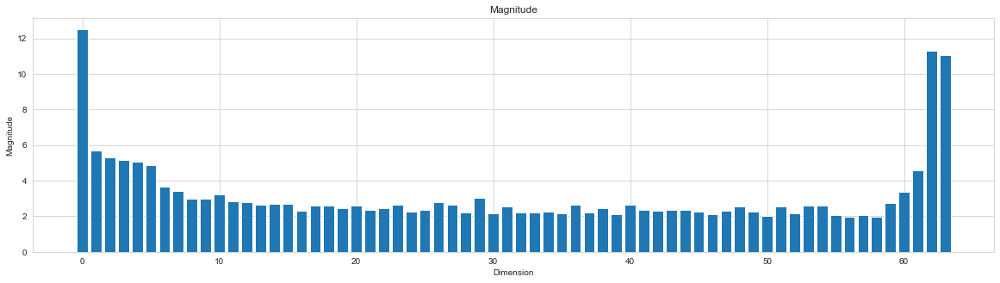

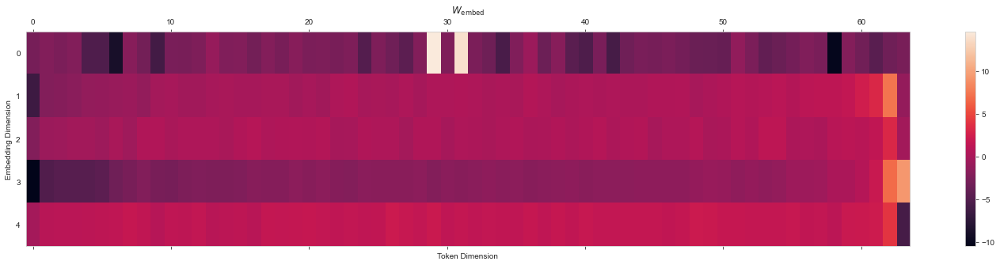

In [80]:
# Excellent. Let's use this to reorder the embedding dimension by how far they are along the line. We'll put the orthogonal component (the prediction track) at the end.

# Find the projection of each embedding vector onto the line
task_line_vec = task_line_endpoint1 - task_line_endpoint0
task_line_vec_np = task_line_vec.detach().cpu().numpy()

# Find the projection of each embedding vector onto the line
embed_vecs_1d = embed_weights[:, 1:].detach().cpu().numpy()
embed_vecs_1d = embed_vecs_1d @ task_line_vec_np / np.linalg.norm(task_line_vec_np)

# Find the order of components
task_line_ordering = np.argsort(embed_vecs_1d)

# Find where 35 is in this array and move it to the end
task_line_ordering = np.concatenate([task_line_ordering[task_line_ordering != 35], [35]])

# Let's plot magnitudes in this order

fig, ax0 = plt.subplots(1, 1, figsize=(20, 5))

ax0.bar(range(len(embed_weights)), magnitudes[task_line_ordering])
ax0.set_title("Magnitude")
ax0.set_xlabel("Dimension")
ax0.set_ylabel("Magnitude")

plt.show()


In [333]:
# (Later) What's the slope of this line? 
limit_y = 

tensor(32.0173, device='mps:0', grad_fn=<DotBackward0>) tensor(-14.2420, device='mps:0', grad_fn=<DotBackward0>) tensor(-2.2481, device='mps:0', grad_fn=<DivBackward0>)


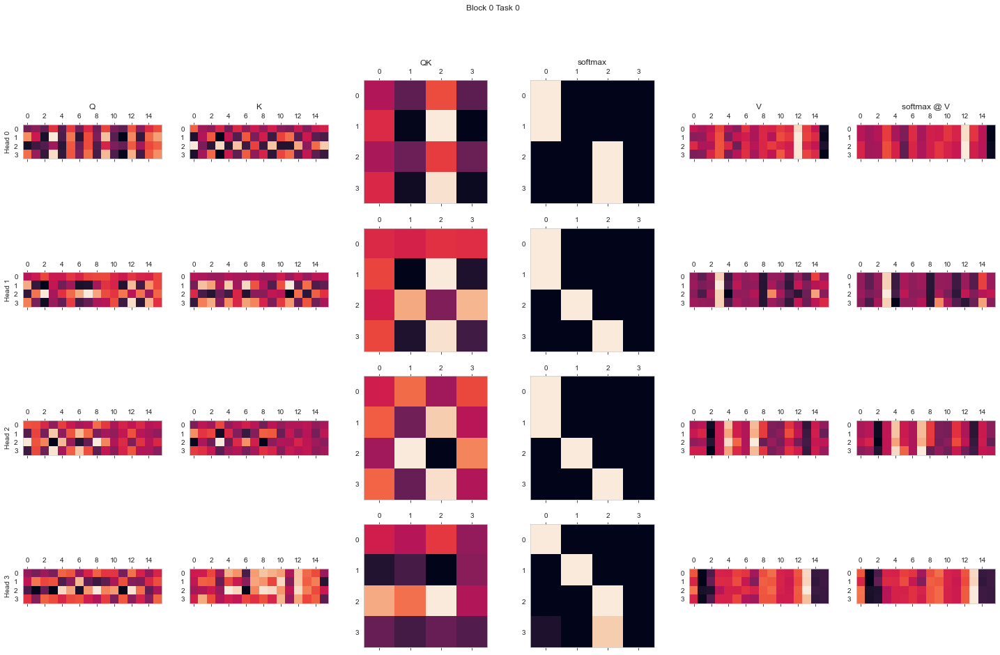

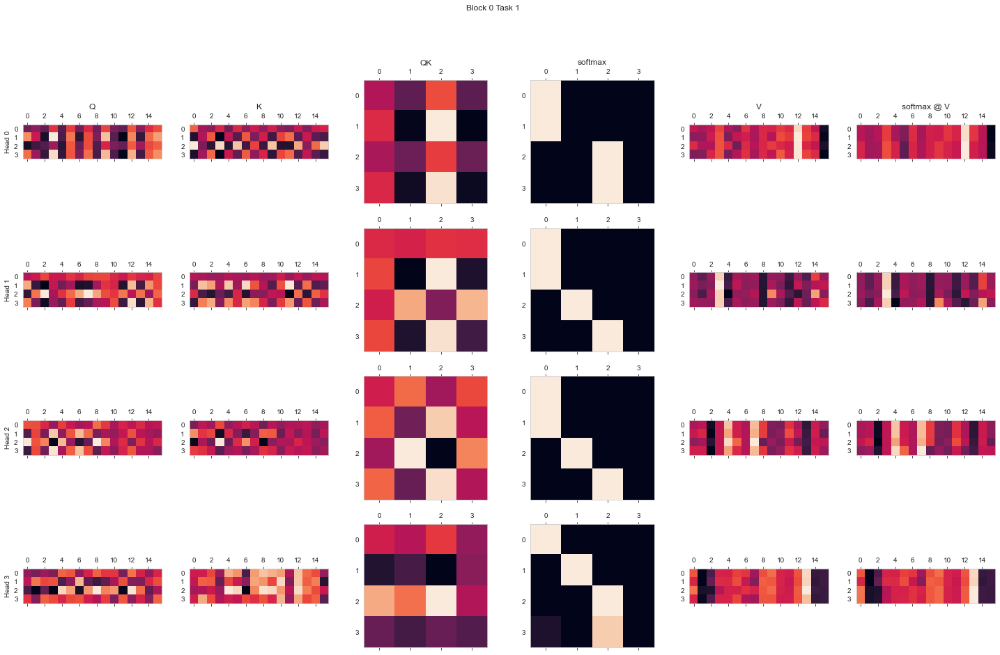

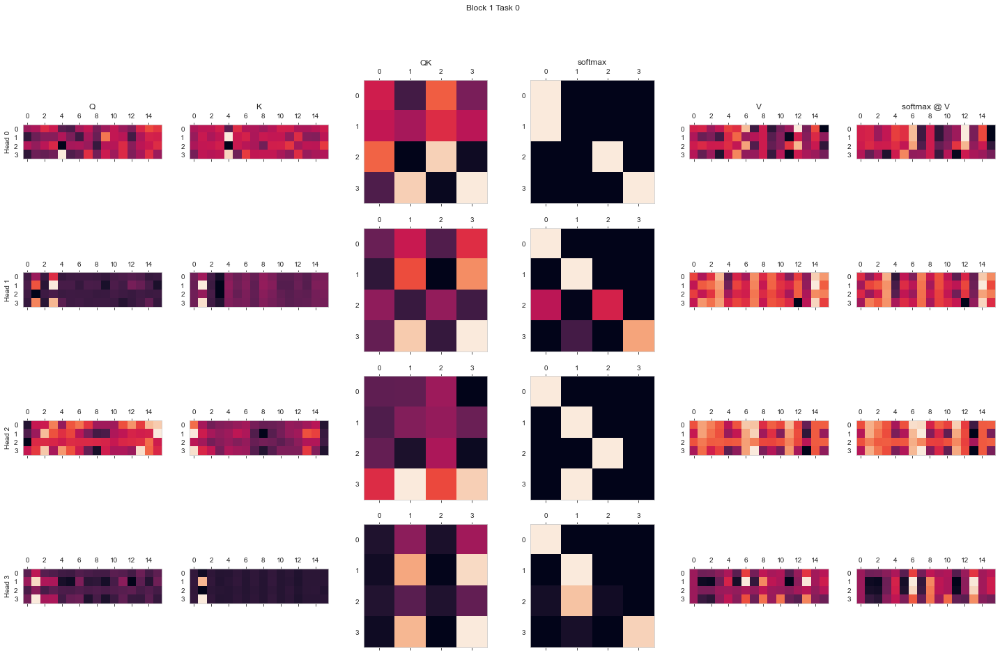

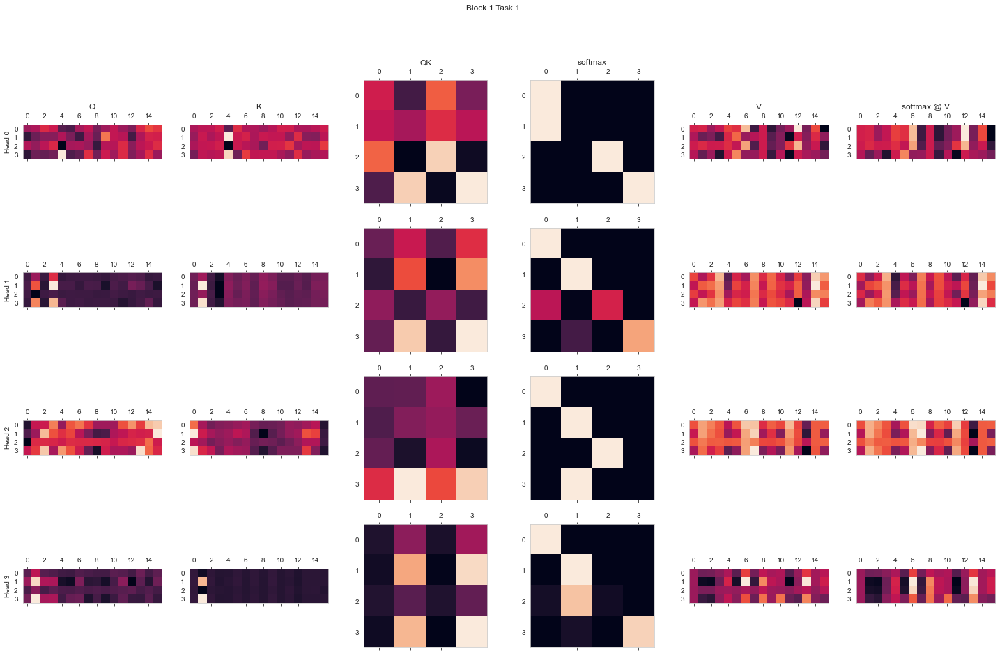

In [109]:
from typing import Optional

def separate_attention(qkv, num_heads, batch_size, head_size, num_tokens):
    return (qkv.view(batch_size, num_tokens, num_heads, 3*head_size)
            .transpose(-2, -3)
            .split(head_size, dim=-1))

def plot_matrix(ax, data, title: Optional[str] = None):
    ax.matshow(data.detach().to("cpu").numpy())
    ax.grid(None)

    if title is not None:
        ax.set_title(title)

def plot_attention(axs, data, titles, num_heads):
    q, k, softmax, v  = data
    qk = (q.unsqueeze(0) @ k.unsqueeze(0).transpose(-2, -1))[0]

    softmax_v = softmax @ v

    # Rows for each head
    # Columns for Q, K, QK, V
    for j, (name, x) in enumerate(zip(titles, [q, k, qk, softmax, v, softmax_v])):
        axs[0, j].set_title(name)

        for h in range(num_heads):
            plot_matrix(axs[h, j], x[h])

    for h in range(num_heads):
        axs[h, 0].set_ylabel(f"Head {h}")


for b in range(2):
    for i, activations in enumerate([activations0, activations1]):
        fig, axes = plt.subplots(4, 6, figsize=(25, 15))
        softmax = activations[f"token_sequence_transformer.blocks.{b}.attention.attention_softmax"]
        q, k, v = separate_attention(activations[f"token_sequence_transformer.blocks.{b}.attention.attention"], 4, 1, 16, 4)
        attn = [q[0], k[0], softmax[0], v[0]]
        plot_attention(axes, attn, ["Q", "K", "QK", "softmax", "V", "softmax @ V"], num_heads=4)
        plt.suptitle(f"Block {b} Task {i}")

In [385]:
from torchtyping import TensorType

# The important observation is that the attention patterns don't depend on the task. There's no decision-making going on here.
# We've got a previous x-head (b0h0) and previous-token heads (b0h{1,2}) and weirder things. 

# My guess is that the main function here is to carry information from ys to xs. It's not suprising that the previous-token head b0h1 forms first. 

# I want to have a better idea of how the model's internal representations are changing. If I take a basis of R^4. And pass these as my x, then I can 
# do the same dimensionality reduction I did on the embedding weights to track how the representation changes with depth. 


TOKEN_IDX = -2

def get_representation_evolution(model, w: torch.Tensor, x0: torch.Tensor):
    _hooked_model = hook(model)
    basis = torch.eye(4, device="mps") * 1.
    # basis[1:, 1:] = 0.
    #basis[0, 0] = 0.
    #basis[2:, 2:] = 0.
    # basis[:,:] = 0.

    y0 = w @ x0

    activations_per_basis = []

    for x in basis:
        y = w @ x

        xs = torch.stack([x0, x]).unsqueeze(0)
        ys = torch.stack([y0, y]).unsqueeze(0).unsqueeze(-1)

        _activations = _hooked_model.run_with_cache(xs, ys)[1]
        
        activations_per_basis.append({
            "embed": _activations["token_sequence_transformer.token_embedding"],
            "attn0": _activations["token_sequence_transformer.blocks.0.resid_after_attn"],
            "mlp0":  _activations["token_sequence_transformer.blocks.0"],
            "attn1": _activations["token_sequence_transformer.blocks.1.resid_after_attn"],
            "mlp1":  _activations["token_sequence_transformer.blocks.1"],
            "ln": _activations["token_sequence_transformer.unembedding.0"],
        })

    # Stack them back together

    return [
        torch.stack([a["embed"] for a in activations_per_basis]),
        torch.stack([a["attn0"] for a in activations_per_basis]),
        torch.stack([a["mlp0"] for a in activations_per_basis]),
        torch.stack([a["attn1"] for a in activations_per_basis]),
        torch.stack([a["mlp1"] for a in activations_per_basis]),
        torch.stack([a["ln"] for a in activations_per_basis]),        
    ]

basis = torch.eye(4, device="mps")
task0_evoln = get_representation_evolution(run.model, tasks[0], basis[0])
task1_evoln = get_representation_evolution(run.model, tasks[1], basis[1])

def reduce_evoln(evolution: List[TensorType["dim_x", "batch_size", "num_tokens", "dim_embed"]], token_idx=TOKEN_IDX):
    evolution = [e[:,0, token_idx, :] for e in evolution]

    for i in range(len(evolution)):
        mean_i = evolution[i].mean(dim=1)
        new_evolution = torch.zeros((4, 66), device="mps")
        new_evolution[:, :64] = evolution[i]
        new_evolution[:, 64] = mean_i
        new_evolution[:, 65] = evolution[i][:, 35] - mean_i # prediction
        evolution[i] = new_evolution
        
    evoln_embedded = [torch.matmul(e.T, projection_matrix) for e in evolution]
    evoln_reembed = [torch.matmul(e, projection_matrix.T).T for e in evoln_embedded]
    evolution_with_distances = [(e_em, (e-e_rem).norm(dim=0).abs().detach().cpu().numpy()) for e_em, e_rem, e in zip(evoln_embedded, evoln_reembed, evolution)]

    return evolution_with_distances

task0_evoln = reduce_evoln(task0_evoln)
task1_evoln = reduce_evoln(task1_evoln)

In [319]:
TASK_IDX = 0
DEFAULT_LAYER = 0
task_evoln = task0_evoln if TASK_IDX == 0 else task1_evoln
print(task_evoln[0][0].shape)

torch.Size([66, 2])


In [228]:
len(models)

96

In [238]:
task_evolns_over_training = []

for model in models:
    _task_evoln = get_representation_evolution(model, tasks[TASK_IDX], basis[0])
    _task_evoln = reduce_evoln(_task_evoln)
    task_evolns_over_training.append(_task_evoln)

In [239]:
CHECKPOINT = -3
task0_evoln = task_evolns_over_training[CHECKPOINT]

In [ ]:
frames = []
for i, (tensor, dist) in enumerate(task0_evoln):
    x = tensor[:, 0].tolist()
    y = tensor[:, 1].tolist()

    frame = go.Frame(
        data=[
            go.Scatter(
                x=x, 
                y=y, 
                mode='markers',
                marker=dict(
                    symbol=symbols,
                    size=sizes,
                    color=dist.tolist(), 
                    colorscale=COLORSCALE, 
                    colorbar=dict(title="Distance from Projection"),
                    opacity=opacities
                )
        )
    ],
        name=f"Frame {i}"
    )

    frames.append(frame)

# Initialize with the first frame
init_x = task0_evoln[0][0][:, 0].tolist()
init_y = task0_evoln[0][0][:, 1].tolist()
init_dist = task0_evoln[0][1]

fig = go.Figure(
    data=[go.Scatter(
                x=init_x, 
                y=init_y, 
                mode='markers',
                marker=dict(
                    symbol=symbols,
                    size=sizes,
                    color=init_dist,
                    colorscale=COLORSCALE, 
                    colorbar=dict(title="Distance from Projection"),
                    opacity=opacities
                )
        )],
    layout=go.Layout(
        sliders=[{
            'steps': [
                {
                    'args': [[f'Frame {i}'], {'frame': {'duration': 300, 'redraw': True}}],
                    'label': str(i),
                    'method': 'animate',
                } for i, _ in enumerate(frames)
            ],
        }],
        xaxis_title="Task 0",
        yaxis_title="Task 1",
        xaxis=dict(range=[-25, 25], autorange=True),
        yaxis=dict(range=[-25, 25], autorange=True),
        width=1200,  
        height=1200   
    ),
    frames=frames,
)

fig.show()

In [241]:
LAYER = 2

In [ ]:
frames = []
for i, task_evoln in enumerate(task_evolns_over_training):
    tensor, dist = task_evoln[LAYER]
    x = tensor[:, 0].tolist()
    y = tensor[:, 1].tolist()

    frame = go.Frame(
        data=[
            go.Scatter(
                x=x, 
                y=y, 
                mode='markers',
                marker=dict(
                    symbol=symbols,
                    size=sizes,
                    color=dist.tolist(), 
                    colorscale=COLORSCALE, 
                    colorbar=dict(title="Distance from Projection"),
                    opacity=opacities
                )
        )
    ],
        name=f"Frame {i}"
    )

    frames.append(frame)

# Initialize with the first frame
init_x = task_evolns_over_training[0][0][0][:, 0].tolist()
init_y = task_evolns_over_training[0][0][0][:, 1].tolist()
init_dist = task_evolns_over_training[0][0][1]

fig = go.Figure(
    data=[go.Scatter(
                x=init_x, 
                y=init_y, 
                mode='markers',
                marker=dict(
                    symbol=symbols,
                    size=sizes,
                    color=init_dist,
                    colorscale=COLORSCALE, 
                    colorbar=dict(title="Distance from Projection"),
                    opacity=opacities
                )
        )],
    layout=go.Layout(
        sliders=[{
            'steps': [
                {
                    'args': [[f'Frame {i}'], {'frame': {'duration': 100, 'redraw': True}}],
                    'label': str(i),
                    'method': 'animate',
                } for i, _ in enumerate(frames)
            ],
        }],
        xaxis_title="Task 0",
        yaxis_title="Task 1",
        xaxis=dict(range=[-25, 25], autorange=True),
        yaxis=dict(range=[-25, 25], autorange=True),
        width=1200,  
        height=1200   
    ),
    frames=frames,
)

fig.show()

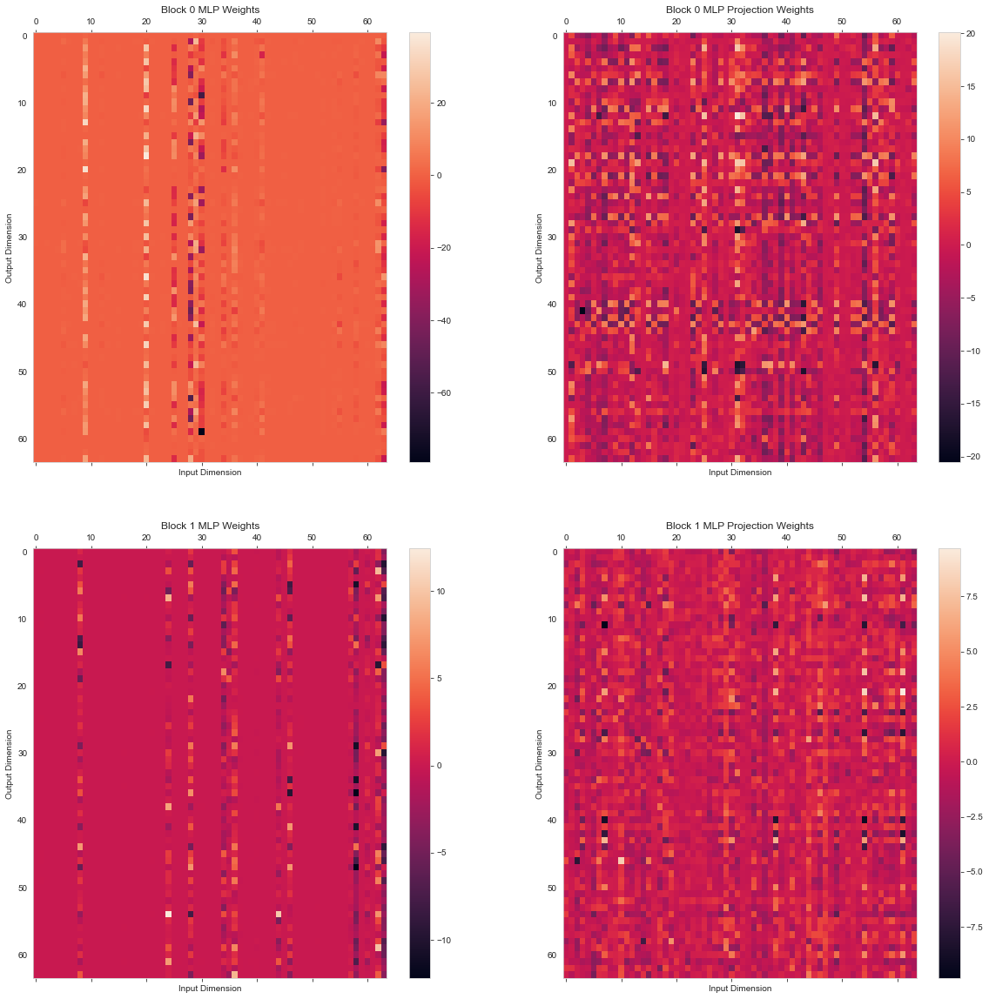

In [247]:
# Okay let's look at the last MLP
block0_mlp = run.model.token_sequence_transformer.blocks[0].compute[0]
block0_mlp_proj = run.model.token_sequence_transformer.blocks[0].compute[2]
block1_mlp = run.model.token_sequence_transformer.blocks[1].compute[0]
block1_mlp_proj = run.model.token_sequence_transformer.blocks[1].compute[2]

block0_mlp_weights = block0_mlp.weight.detach().cpu().numpy() * block0_ln1.detach().cpu().numpy()
block0_mlp_proj_weights = block0_mlp_proj.weight.detach().cpu().numpy() 
block1_mlp_weights = block1_mlp.weight.detach().cpu().numpy() * block1_ln1.detach().cpu().numpy()
block1_mlp_proj_weights = block1_mlp_proj.weight.detach().cpu().numpy()

block0_mlp_bias = block0_mlp.bias.detach().cpu().numpy()
block0_mlp_proj_bias = block0_mlp_proj.bias.detach().cpu().numpy()
block1_mlp_bias = block1_mlp.bias.detach().cpu().numpy()
block1_mlp_proj_bias = block1_mlp_proj.bias.detach().cpu().numpy()

# Matshow the last weights 

fig, axes = plt.subplots(2, 2, figsize=(20, 20))

cax = axes[0, 0].matshow(block0_mlp_weights, aspect='auto')
axes[0, 0].set_title("Block 0 MLP Weights")
axes[0, 0].set_xlabel("Input Dimension")
axes[0, 0].set_ylabel("Output Dimension")
axes[0, 0].grid(False)
fig.colorbar(cax, ax=axes[0, 0])

cax = axes[0, 1].matshow(block0_mlp_proj_weights, aspect='auto')
axes[0, 1].set_title("Block 0 MLP Projection Weights")
axes[0, 1].set_xlabel("Input Dimension")
axes[0, 1].set_ylabel("Output Dimension")
axes[0, 1].grid(False)
fig.colorbar(cax, ax=axes[0, 1])

cax = axes[1, 0].matshow(block1_mlp_weights, aspect='auto')
axes[1, 0].set_title("Block 1 MLP Weights")
axes[1, 0].set_xlabel("Input Dimension")
axes[1, 0].set_ylabel("Output Dimension")
axes[1, 0].grid(False)
fig.colorbar(cax, ax=axes[1, 0])

cax = axes[1, 1].matshow(block1_mlp_proj_weights, aspect='auto')
axes[1, 1].set_title("Block 1 MLP Projection Weights")
axes[1, 1].set_xlabel("Input Dimension")
axes[1, 1].set_ylabel("Output Dimension")
axes[1, 1].grid(False)
fig.colorbar(cax, ax=axes[1, 1])

In [259]:
# Print ranks (tol=1e-1)

print("Block 0 MLP Weights Rank:", np.linalg.matrix_rank(block0_mlp_weights, tol=1e-1))
print("Block 0 MLP Projection Weights Rank:", np.linalg.matrix_rank(block0_mlp_proj_weights, tol=1e-1))
print("Block 1 MLP Weights Rank:", np.linalg.matrix_rank(block1_mlp_weights, tol=1e-1))
print("Block 1 MLP Projection Weights Rank:", np.linalg.matrix_rank(block1_mlp_proj_weights, tol=1e-1))

Block 0 MLP Weights Rank: 38
Block 0 MLP Projection Weights Rank: 63
Block 1 MLP Weights Rank: 19
Block 1 MLP Projection Weights Rank: 63


/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/matplotlib/transforms.py:762: ComplexWarning:

Casting complex values to real discards the imaginary part



Text(0, 0.5, 'Eigenvalue')

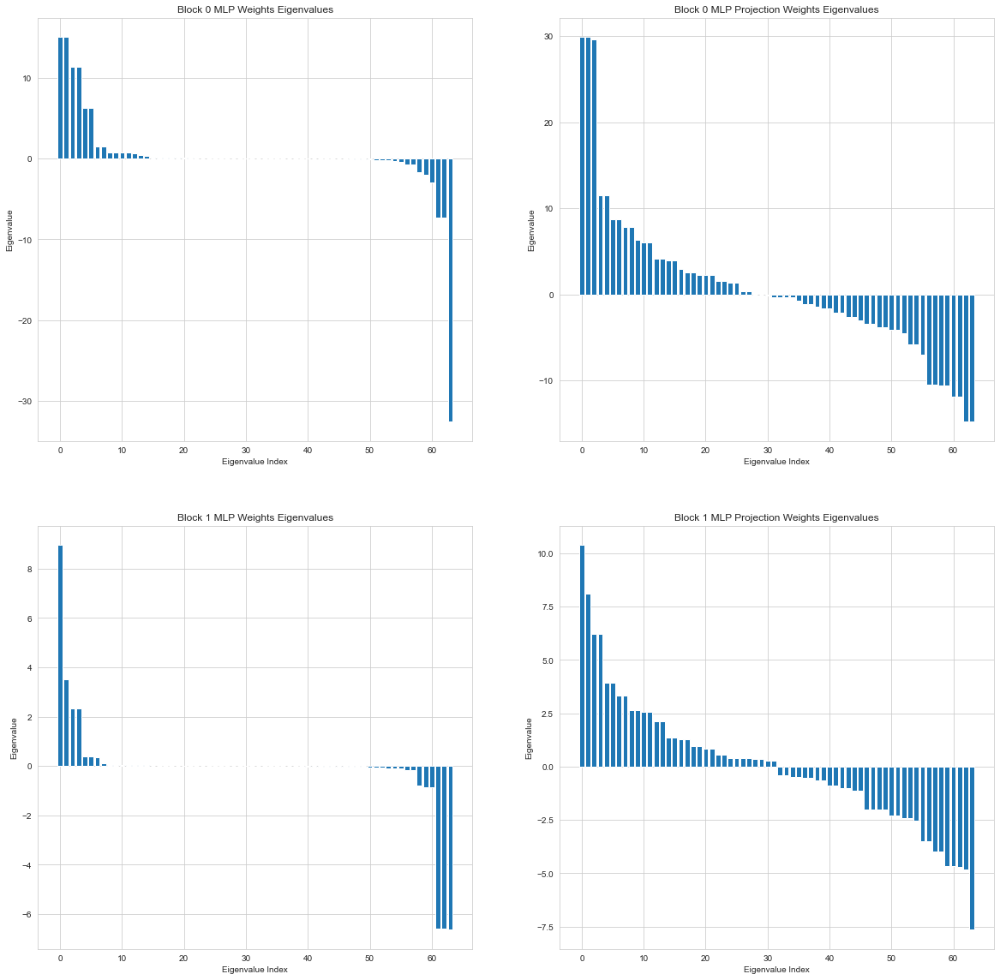

In [253]:
# Do eigenvalue decompositions and plot the eigenvalues in decreasing order

fig, axes = plt.subplots(2, 2, figsize=(20, 20))

eigvals, eigvecs = np.linalg.eig(block0_mlp_weights)
eigvals = np.sort(eigvals)[::-1]
axes[0, 0].bar(range(len(eigvals)), eigvals)
axes[0, 0].set_title("Block 0 MLP Weights Eigenvalues")
axes[0, 0].set_xlabel("Eigenvalue Index")
axes[0, 0].set_ylabel("Eigenvalue")

eigvals, eigvecs = np.linalg.eig(block0_mlp_proj_weights)
eigvals = np.sort(eigvals)[::-1]
axes[0, 1].bar(range(len(eigvals)), eigvals)
axes[0, 1].set_title("Block 0 MLP Projection Weights Eigenvalues")
axes[0, 1].set_xlabel("Eigenvalue Index")
axes[0, 1].set_ylabel("Eigenvalue")

eigvals, eigvecs = np.linalg.eig(block1_mlp_weights)
eigvals = np.sort(eigvals)[::-1]
axes[1, 0].bar(range(len(eigvals)), eigvals)
axes[1, 0].set_title("Block 1 MLP Weights Eigenvalues")
axes[1, 0].set_xlabel("Eigenvalue Index")
axes[1, 0].set_ylabel("Eigenvalue")

eigvals, eigvecs = np.linalg.eig(block1_mlp_proj_weights)
eigvals = np.sort(eigvals)[::-1]
axes[1, 1].bar(range(len(eigvals)), eigvals)
axes[1, 1].set_title("Block 1 MLP Projection Weights Eigenvalues")
axes[1, 1].set_xlabel("Eigenvalue Index")
axes[1, 1].set_ylabel("Eigenvalue")


Text(0, 0.5, 'Output dim')

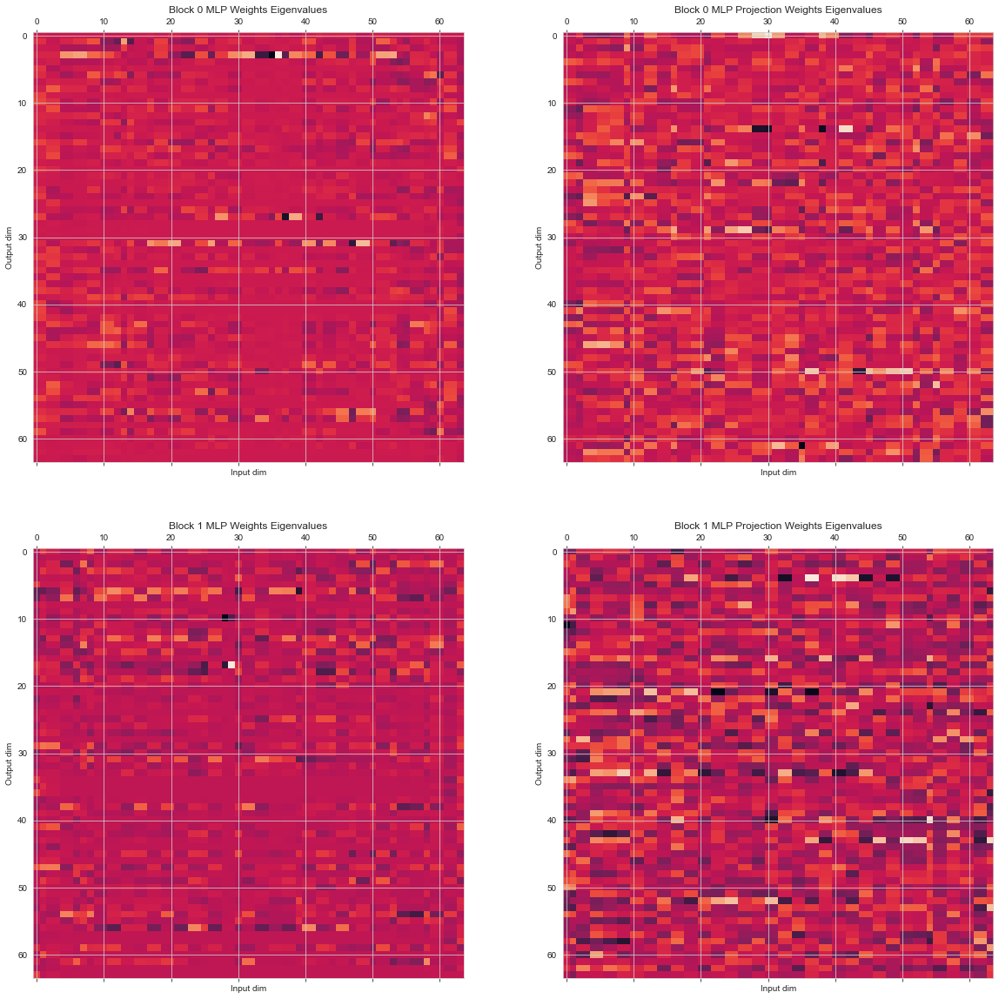

In [256]:
fig, axes = plt.subplots(2, 2, figsize=(20, 20))

eigvals, eigvecs = np.linalg.eig(block0_mlp_weights)
eigval_idxs = np.argsort(eigvals)[::-1]
eigvecs = eigvecs[:, eigval_idxs].real
axes[0, 0].matshow(eigvecs)
axes[0, 0].set_title("Block 0 MLP Weights Eigenvalues")
axes[0, 0].set_xlabel("Input dim")
axes[0, 0].set_ylabel("Output dim")

eigvals, eigvecs = np.linalg.eig(block0_mlp_proj_weights)
eigval_idxs = np.argsort(eigvals)[::-1]
eigvecs = eigvecs[:, eigval_idxs].real
axes[0, 1].matshow(eigvecs)
axes[0, 1].set_title("Block 0 MLP Projection Weights Eigenvalues")
axes[0, 1].set_xlabel("Input dim")
axes[0, 1].set_ylabel("Output dim")

eigvals, eigvecs = np.linalg.eig(block1_mlp_weights)
eigval_idxs = np.argsort(eigvals)[::-1]
eigvecs = eigvecs[:, eigval_idxs].real
axes[1, 0].matshow(eigvecs)
axes[1, 0].set_title("Block 1 MLP Weights Eigenvalues")
axes[1, 0].set_xlabel("Input dim")
axes[1, 0].set_ylabel("Output dim")

eigvals, eigvecs = np.linalg.eig(block1_mlp_proj_weights)
eigval_idxs = np.argsort(eigvals)[::-1]
eigvecs = eigvecs[:, eigval_idxs].real
axes[1, 1].matshow(eigvecs)
axes[1, 1].set_title("Block 1 MLP Projection Weights Eigenvalues")
axes[1, 1].set_xlabel("Input dim")
axes[1, 1].set_ylabel("Output dim")

Text(0, 0.5, 'Weight')

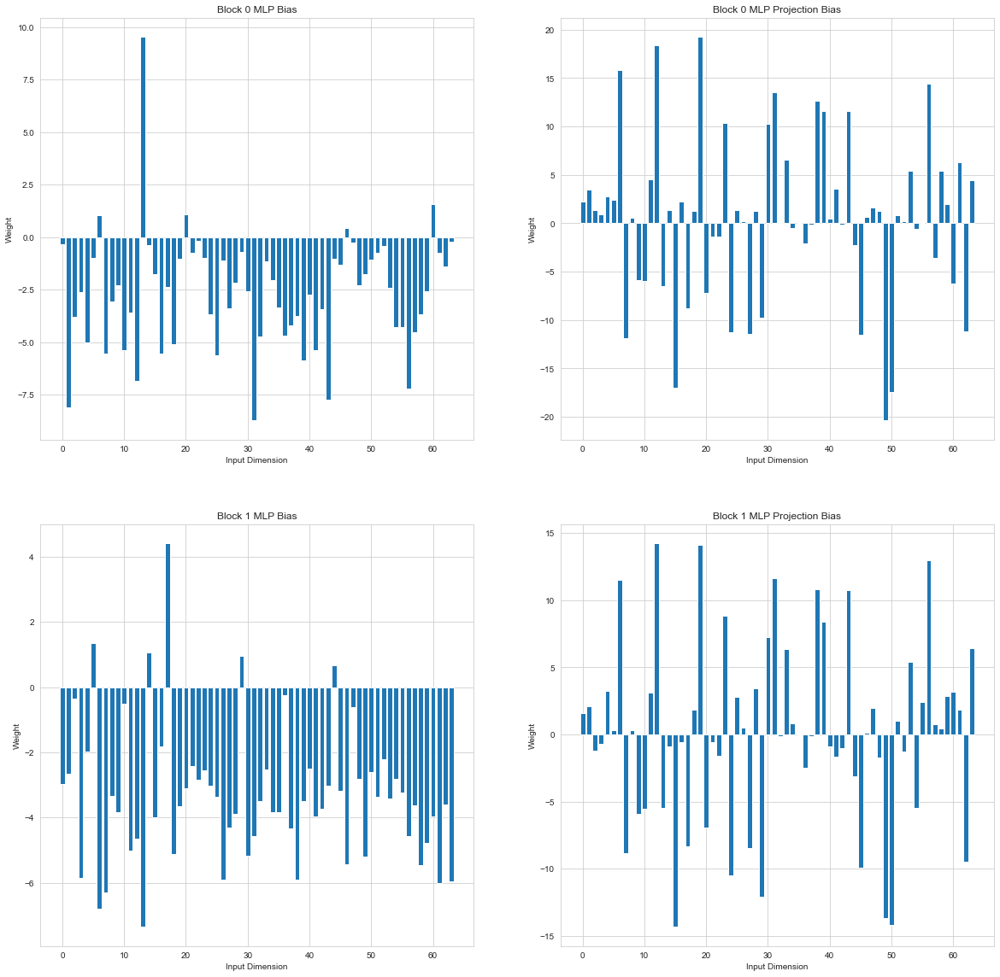

In [250]:
# Bars for the bias

fig, axes = plt.subplots(2, 2, figsize=(20, 20))

axes[0, 0].bar(range(len(block0_mlp_bias)), block0_mlp_bias)
axes[0, 0].set_title("Block 0 MLP Bias")
axes[0, 0].set_xlabel("Input Dimension")
axes[0, 0].set_ylabel("Weight")

axes[0, 1].bar(range(len(block0_mlp_proj_bias)), block0_mlp_proj_bias)
axes[0, 1].set_title("Block 0 MLP Projection Bias")
axes[0, 1].set_xlabel("Input Dimension")
axes[0, 1].set_ylabel("Weight")

axes[1, 0].bar(range(len(block1_mlp_bias)), block1_mlp_bias)
axes[1, 0].set_title("Block 1 MLP Bias")
axes[1, 0].set_xlabel("Input Dimension")
axes[1, 0].set_ylabel("Weight")

axes[1, 1].bar(range(len(block1_mlp_proj_bias)), block1_mlp_proj_bias)
axes[1, 1].set_title("Block 1 MLP Projection Bias")
axes[1, 1].set_xlabel("Input Dimension")
axes[1, 1].set_ylabel("Weight")

In [341]:
# Okay I want to actually figure out what the slope is of that line. I realize I've been thinking of the two tasks as orthogonal this entire time when clearly they aren't. 

# Let's find an orthonormal basis in the plane spanned by the two tasks.

task_basis = torch.stack([tasks[0], tasks[1]]).T

task_basis[:, 0] = task_basis[:, 0] / task_basis[:, 0].norm()
task_basis[:, 1] = task_basis[:, 1] - task_basis[:, 1].dot(task_basis[:, 0]) * task_basis[:, 0]
task_basis[:, 1] = task_basis[:, 1] / task_basis[:, 1].norm()

task_basis_np = task_basis.detach().cpu().numpy()

[-5.8970194 11.030293 ] [ 9.1281185 -6.6843805] [-0.9210677 -0.4745723  9.27699   -5.9636183]


<ipython-input-377-21b1146029fa>:20: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).



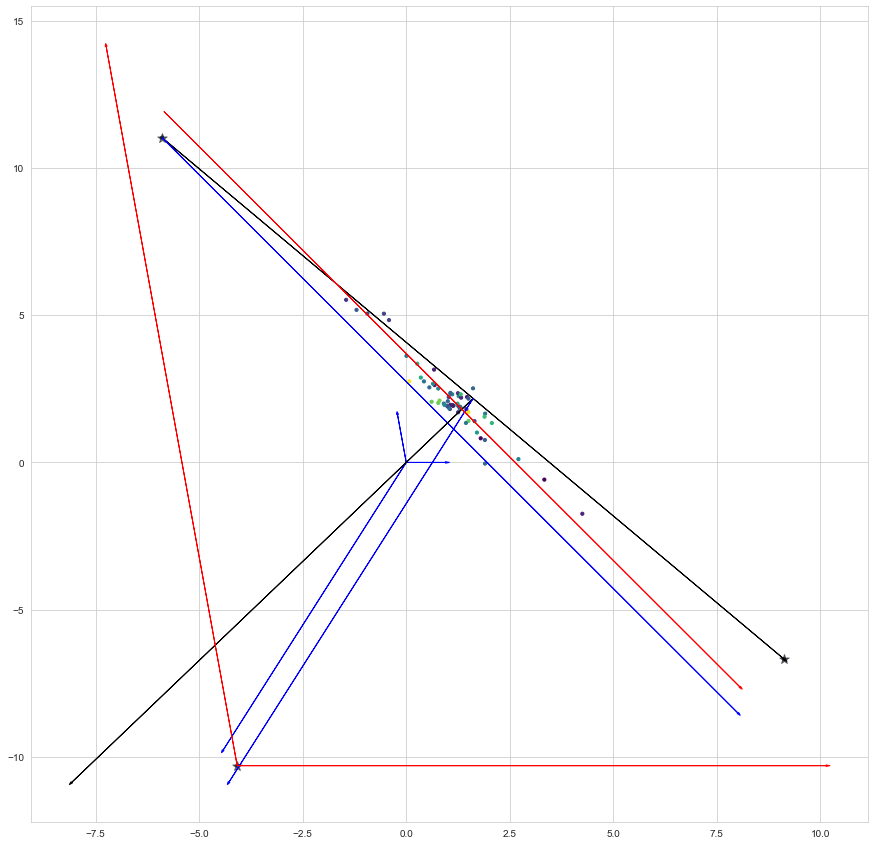

In [377]:
# First plot the tasks in this basis

fig, ax = plt.subplots(1, 1, figsize=(15, 15))

task0_decomp = task_basis_np.T @ tasks[0].detach().cpu().numpy()
task1_decomp = task_basis_np.T @ tasks[1].detach().cpu().numpy()

delta_task_decomp = - task1_decomp + task0_decomp
sum_task_decomp = task1_decomp + task0_decomp

# Using arrows

ax.arrow(0, 0, task0_decomp[0], task0_decomp[1], head_width=0.05, head_length=0.1, fc='blue', ec='blue')
ax.arrow(0, 0, task1_decomp[0], task1_decomp[1], head_width=0.05, head_length=0.1, fc='blue', ec='blue')

embed = embedding_matrices[-1]
_x_embeds = embed[:, 1:].to("mps")
projection_matrix = task_basis
projected_embeds = torch.matmul(_x_embeds, projection_matrix)
reembedded_projections = torch.matmul(torch.tensor(projected_embeds), projection_matrix.T)
projected_embeds = projected_embeds.detach().cpu().numpy()
dist_from_proj = np.linalg.norm(_x_embeds.detach().cpu().numpy() - reembedded_projections.detach().cpu().numpy(), axis=1)
    
ax.scatter(projected_embeds[:, 0], projected_embeds[:, 1], c=dist_from_proj, cmap="viridis", s=10)

task_line_endpoint_decomp0 = projected_embeds[np.argmin(np.linalg.norm(projected_embeds - np.array([-6, 10]), axis=1))]

# Find the point closest to 9, -13
task_line_endpoint_decomp1 = projected_embeds[np.argmin(np.linalg.norm(projected_embeds - np.array([8, -6]), axis=1))]

# Find the orthogonal point close to -15, -4
task_line_orthogonal_decomp = projected_embeds[np.argmin(np.linalg.norm(projected_embeds - np.array([-4, -10]), axis=1))]


print(task_line_endpoint_decomp0, task_line_endpoint_decomp1, task_line_orthogonal)


# Plot these points with special shapes
ax.scatter(task_line_endpoint_decomp0[0], task_line_endpoint_decomp0[1], marker="*", s=100, c="k", alpha=.5)
ax.scatter(task_line_endpoint_decomp1[0], task_line_endpoint_decomp1[1], marker="*", s=100, c="k", alpha=.5)
ax.scatter(task_line_orthogonal_decomp[0], task_line_orthogonal_decomp[1], marker="*", s=100, c="k", alpha=.5)

ax.arrow(task_line_endpoint_decomp0[0].item(), task_line_endpoint_decomp0[1].item(), task_line_endpoint_decomp1[0].item() - task_line_endpoint_decomp0[0].item(), task_line_endpoint_decomp1[1].item() - task_line_endpoint_decomp0[1].item(), head_width=0.05, head_length=0.1, fc='k', ec='k')
ax.arrow(task_line_endpoint_decomp0[0], task_line_endpoint_decomp0[1], delta_task_decomp[0]* 12, delta_task_decomp[1] * 12, head_width=0.05, head_length=0.1, fc='blue', ec='blue')

ax.arrow(0, 0, sum_task_decomp[0] * -6, sum_task_decomp[1] * -6, head_width=0.05, head_length=0.1, fc='blue', ec='blue')

task_line_midpoint = (task_line_endpoint_decomp0 + task_line_endpoint_decomp1) / 2
ax.arrow(task_line_midpoint[0], task_line_midpoint[1], -task_line_midpoint[0] * 6, -task_line_midpoint[1] * 6, head_width=0.05, head_length=0.1, fc='k', ec='k')
ax.arrow(task_line_midpoint[0], task_line_midpoint[1], sum_task_decomp[0] * -8, sum_task_decomp[1] * -8, head_width=0.05, head_length=0.1, fc='blue', ec='blue')


centroid = (projected_embeds.mean(axis=0) * 64 - task_line_orthogonal_decomp) / 63
ax.arrow(centroid[0] - delta_task_decomp[0]* 6, centroid[1] - delta_task_decomp[1]* 6, delta_task_decomp[0]* 12, delta_task_decomp[1] * 12, head_width=0.05, head_length=0.1, fc='red', ec='red')

ax.arrow(task_line_orthogonal_decomp[0], task_line_orthogonal_decomp[1], task0_decomp[0] * 15, task0_decomp[1] * 15, head_width=0.05, head_length=0.1, fc='red', ec='red')
ax.arrow(task_line_orthogonal_decomp[0], task_line_orthogonal_decomp[1], task1_decomp[0] * 15, task1_decomp[1] * 15, head_width=0.05, head_length=0.1, fc='red', ec='red')
plt.show()



tensor(0.2943, device='mps:0', grad_fn=<DivBackward0>)
tensor([[[ 0.9373],
         [-1.2660],
         [ 0.7107],
         [-0.6805],
         [-0.5675],
         [-0.5355],
         [-0.6120],
         [ 0.3257]]], device='mps:0', grad_fn=<SliceBackward0>)
tensor([[[-0.2398],
         [-1.2613],
         [ 0.7125],
         [-0.6751],
         [-0.5643],
         [-0.5250],
         [-0.6075],
         [ 0.3316]]], device='mps:0')


tensor(0.2936, device='mps:0', grad_fn=<DivBackward0>)
tensor([[[ 0.9373],
         [-1.7408],
         [ 0.8878],
         [-0.0578],
         [-0.4713],
         [ 1.8462],
         [-0.4373],
         [ 0.9938]]], device='mps:0', grad_fn=<SliceBackward0>)
tensor([[[ 2.1119],
         [-1.7419],
         [ 0.8873],
         [-0.0596],
         [-0.4721],
         [ 1.8435],
         [-0.4394],
         [ 0.9907]]], device='mps:0')


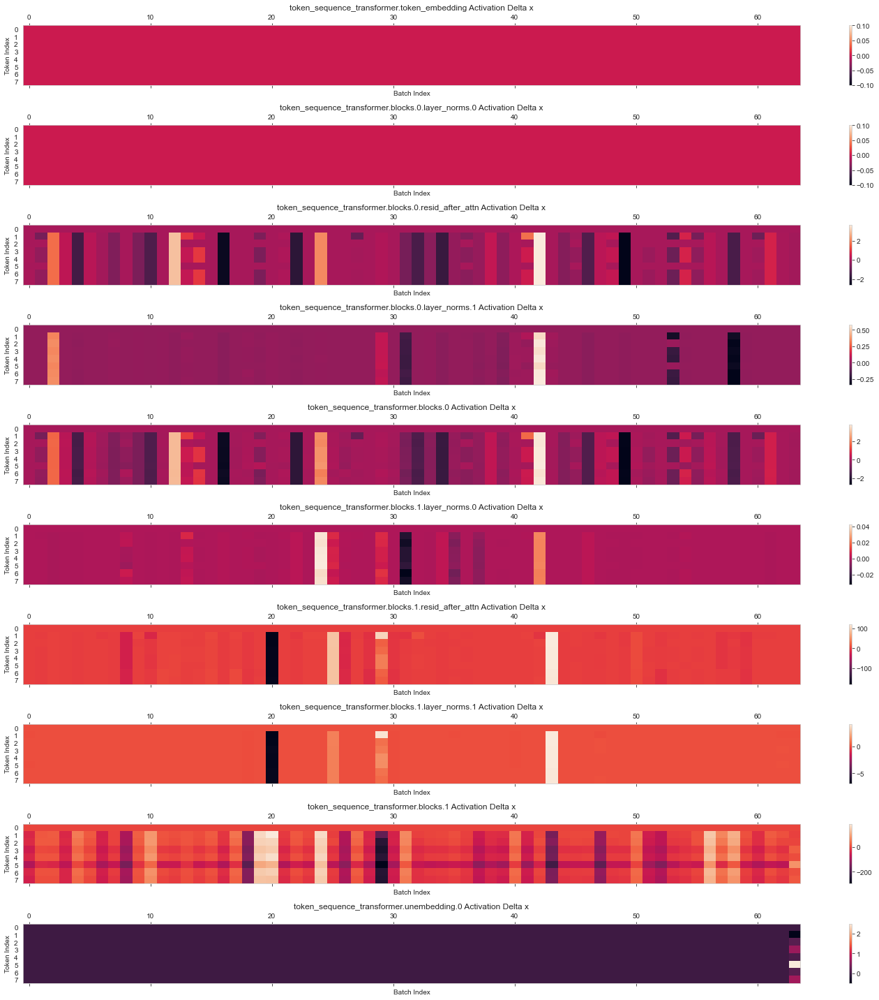

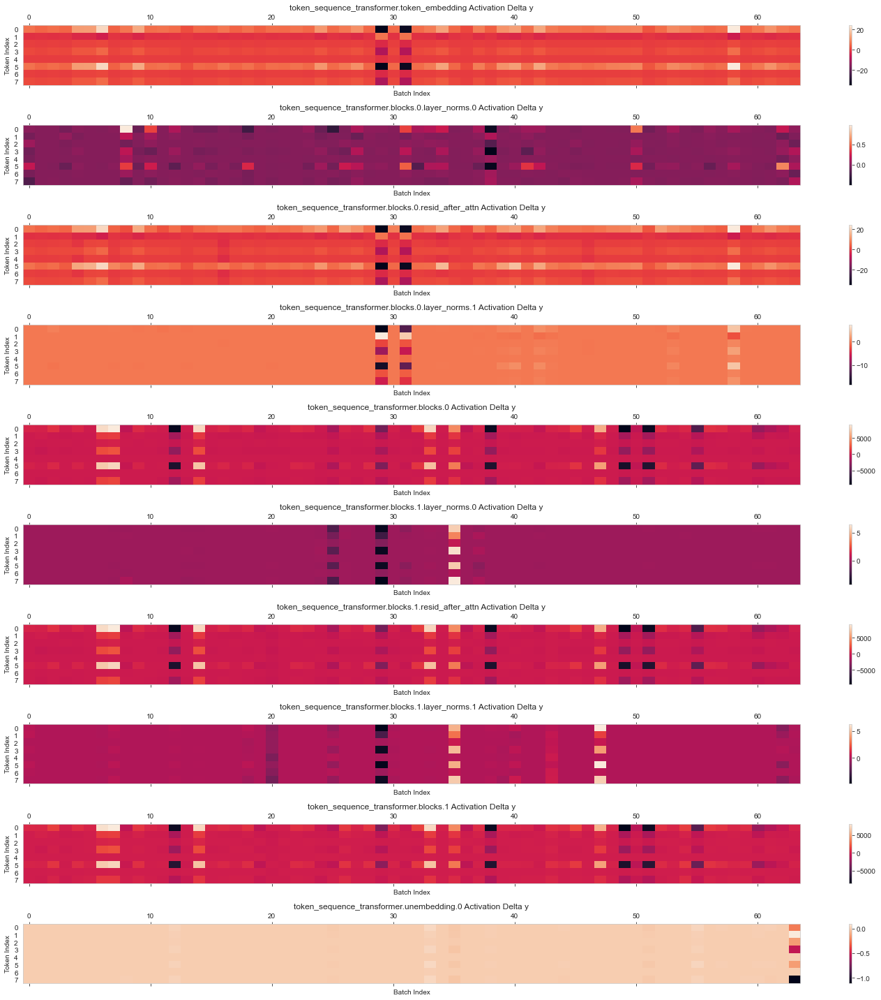

In [405]:
# Alright I want to compare the activations in the residual stream between the two tasks.

hooked_model = hook(run.model)

x0s = [torch.randn(4, device="mps") for _ in range(8)]
activations_multiple_xs = []

for w in tasks:
    ys = []
    for x in x0s:
        ys.append(w @ x)

    xs = torch.stack(x0s).unsqueeze(0)
    ys = torch.stack(ys).unsqueeze(0).unsqueeze(-1)

    predictions, cache = hooked_model.run_with_cache(xs, ys)
    activations.append(cache)

    print("\n")
    print((predictions - ys).norm() / 4)
    print(predictions)
    print(ys)

layers = [
    "token_sequence_transformer.token_embedding",
    "token_sequence_transformer.blocks.0.layer_norms.0",
    "token_sequence_transformer.blocks.0.resid_after_attn",
    "token_sequence_transformer.blocks.0.layer_norms.1",
    "token_sequence_transformer.blocks.0",
    "token_sequence_transformer.blocks.1.layer_norms.0",
    "token_sequence_transformer.blocks.1.resid_after_attn",
    "token_sequence_transformer.blocks.1.layer_norms.1",
    "token_sequence_transformer.blocks.1",
    "token_sequence_transformer.unembedding.0"       
]

activation_deltas = [
    (activations[0][layer] - activations[1][layer])[0]
    for layer in layers
]


for x_or_y in range(2):
    fig, axes = plt.subplots(len(activation_deltas), figsize=(20, 20))

    for i, (layer, delta) in enumerate(zip(layers, activation_deltas)):
        subdelta = delta[x_or_y::2, task_line_ordering]
        cax = axes[i].matshow(subdelta.detach().cpu().numpy(), aspect='auto')
        axes[i].set_title(f"{layer} Activation Delta {'x' if x_or_y == 0 else 'y'}")
        axes[i].set_xlabel("Batch Index")
        axes[i].set_ylabel("Token Index")
        axes[i].grid(False)
        fig.colorbar(cax, ax=axes[i])
        

    plt.tight_layout()
    plt.show()

In [ ]:
# Looks very much like more transitions at 100-1k steps and 1k-5k steps. Maybe also at 30k? We already established something at 60k-80k.

# Okay, I want to see if I can eliminate the layer norm and still get the model to work, to confirm my hypothesis that most of the model is involved in layer norm bypass. 
# And I want to figure out how the MLP is making the decision.



In [682]:
# After a foray into M=4, it's really time to figure out that MLP

# What we're going to do is to linearly interpolate between the two tasks. 
# We'll look at the activations as we change from y_1 = w_1^T x_1 to y_1 = w_2^T x_1.

# Alright I want to compare the activations in the residual stream between the two tasks.
NUM_CONTEXT_EXAMPLES = 2
NUM_INTERPOLATION_STEPS = 100

hooked_model = hook(run.model)

# xs = [torch.randn(4, device="mps") for _ in range(NUM_CONTEXT_EXAMPLES)]
# xs = [torch.randn(4, device="mps")] * NUM_CONTEXT_EXAMPLES
xs = [tasks[1]-tasks[0]] * NUM_CONTEXT_EXAMPLES
# xs = [tasks[1]] * NUM_CONTEXT_EXAMPLES
y0s = []
y1s = []

for x in xs:
    y0s.append(tasks[0] @ x)
    y1s.append(tasks[1] @ x)

xs = torch.stack(xs).unsqueeze(0)
y0s = torch.stack(y0s).unsqueeze(0).unsqueeze(-1)
y1s = torch.stack(y1s).unsqueeze(0).unsqueeze(-1)

yinterp_steps = torch.linspace(0, 1, NUM_INTERPOLATION_STEPS)

def get_y(y0, y1, alpha):
    return y0 * (1 - alpha) + y1 * alpha

outputs = []
losses = []
activations = []

for alpha in yinterp_steps:
    ys = get_y(y0s, y1s, alpha)
    output, activation = hooked_model.run_with_cache(xs, ys)
    outputs.append(output)
    losses.append(((output - ys) ** 2).mean().item())
    activations.append(activation)

torch.Size([100, 2])


Text(0.5, 1.0, 'Loss as a function of interpolation step')

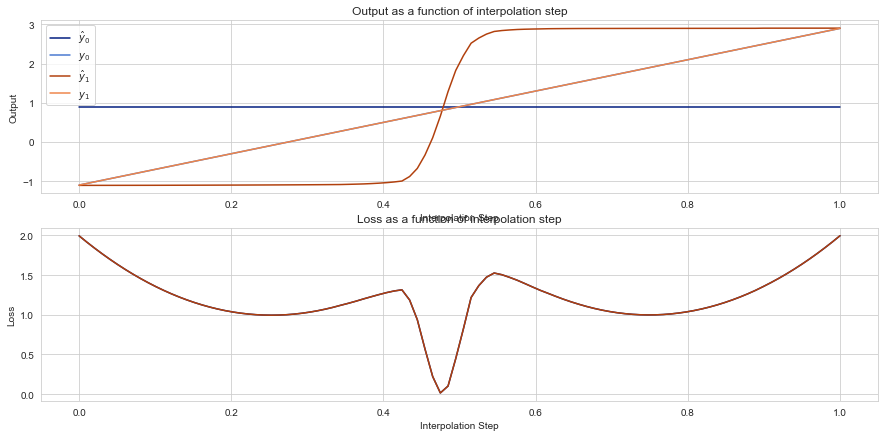

In [683]:
yinterps = [get_y(y0s, y1s, alpha.to('mps')) for alpha in yinterp_steps]
yinterps = torch.stack(yinterps).squeeze()
print(yinterps.shape)

fig, (ax0, ax1) = plt.subplots(2, 1, figsize=(15, 7))

colors = sns.color_palette("dark", NUM_CONTEXT_EXAMPLES)
light_colors = sns.color_palette("muted", NUM_CONTEXT_EXAMPLES)

for i in range(NUM_CONTEXT_EXAMPLES):
    ax0.plot(yinterp_steps, torch.stack(outputs).squeeze()[:, i].detach().cpu().numpy(), label=f"$\hat y_{i}$", color=colors[i])
    ax0.plot(yinterp_steps, yinterps[:, i].detach().cpu().numpy(), label=f"$y_{i}$", color=light_colors[i])
# ax0.plot(yinterp_steps, torch.stack(outputs).squeeze().detach().cpu().numpy(), label=[f"$\hat y_{i}$" for i in range(NUM_CONTEXT_EXAMPLES)], color=colors)
# ax0.plot(yinterp_steps, yinterps.detach().cpu().numpy(), label=[f"$y_{i}$" for i in range(NUM_CONTEXT_EXAMPLES)], color=light_colors)
ax0.set_xlabel("Interpolation Step")
ax0.set_ylabel("Output")
ax0.set_title("Output as a function of interpolation step")
ax0.legend()

for i in range(NUM_CONTEXT_EXAMPLES):
    ax1.plot(yinterp_steps, losses, label=f"$\hat y_{i}$", color=colors[i])

ax1.set_xlabel("Interpolation Step")
ax1.set_ylabel("Loss")
ax1.set_title("Loss as a function of interpolation step")

In [684]:

DELTAS = False

layers = [
    "token_sequence_transformer.token_embedding",
    "token_sequence_transformer.blocks.0.layer_norms.0",
    "token_sequence_transformer.blocks.0.resid_after_attn",
    "token_sequence_transformer.blocks.0.layer_norms.1",
    "token_sequence_transformer.blocks.0.compute.0",
    "token_sequence_transformer.blocks.0.compute.1",
    "token_sequence_transformer.blocks.0",
    "token_sequence_transformer.blocks.1.layer_norms.0",
    "token_sequence_transformer.blocks.1.resid_after_attn",
    "token_sequence_transformer.blocks.1.layer_norms.1",
    "token_sequence_transformer.blocks.1.compute.0",
    "token_sequence_transformer.blocks.1.compute.1",
    "token_sequence_transformer.blocks.1",
    "token_sequence_transformer.unembedding.0"       
]

# Create an empty figure
fig = make_subplots(rows=len(layers), cols=2, subplot_titles=[f"{layer} {subset}" for layer in layers for subset in ['x', 'y']])


zmins = {}
zmaxes = {}

for layer in layers:
    zmins[layer] = min([activation[layer].min().item() for activation in activations])
    zmaxes[layer] = max([activation[layer].max().item() for activation in activations])

# Loop through each element in 'activations' list
for i, layer in enumerate(layers):
    for x_or_y in range(2):
        for act_index, activations_element in enumerate(activations):
            activ = activations_element[layer][0]

            if DELTAS:
                activ = activ - activations[0][layer][0] # activations[len(activations) // 2][layer][0]

            subactiv = activ[x_or_y::2, :] # task_line_ordering]
            subactiv_np = subactiv.detach().cpu().numpy() # [::-1, :]

            # Add the heatmap to the figure
            fig.add_trace(go.Heatmap(
                    z=subactiv_np,
                    x=list(range(subactiv_np.shape[1])),  # Batch index
                    # y=list(range(subactiv_np.shape[0], 0, -1)),  # Token index
                    y=list(range(subactiv_np.shape[0])),  # Token index
                    colorscale='Viridis',
                    visible=(act_index == 0),
                    name=f"{layer} Activation {'x' if x_or_y == 0 else 'y'}",
                    # zmin=zmins[layer],
                    # zmax=zmaxes[layer],
                    colorbar=dict(title="Activation"),
                    
                ),
                row=i + 1, 
                col=x_or_y + 1                    
            )

# Create slider steps
steps = []
for i, _ in enumerate(activations):
    step = dict(
        args=[{"visible": [j == i for j in range(len(activations))]}],
        method="restyle",
        label=str(i)
    )
    steps.append(step)

# Add slider
sliders = [dict(
    active=0,
    currentvalue={"prefix": "Activation Index: "},
    pad={"t": 50},
    steps=steps
)]

fig.update_layout(sliders=sliders, width=1200, height=1200)

fig.show()

print(xs)
print(y0s)
print(y1s)


tensor([[[-1.1133, -0.4331, -1.5844, -0.2396],
         [-1.1133, -0.4331, -1.5844, -0.2396]]], device='mps:0')
tensor([[[-1.0985],
         [-1.0985]]], device='mps:0')
tensor([[[2.8963],
         [2.8963]]], device='mps:0')


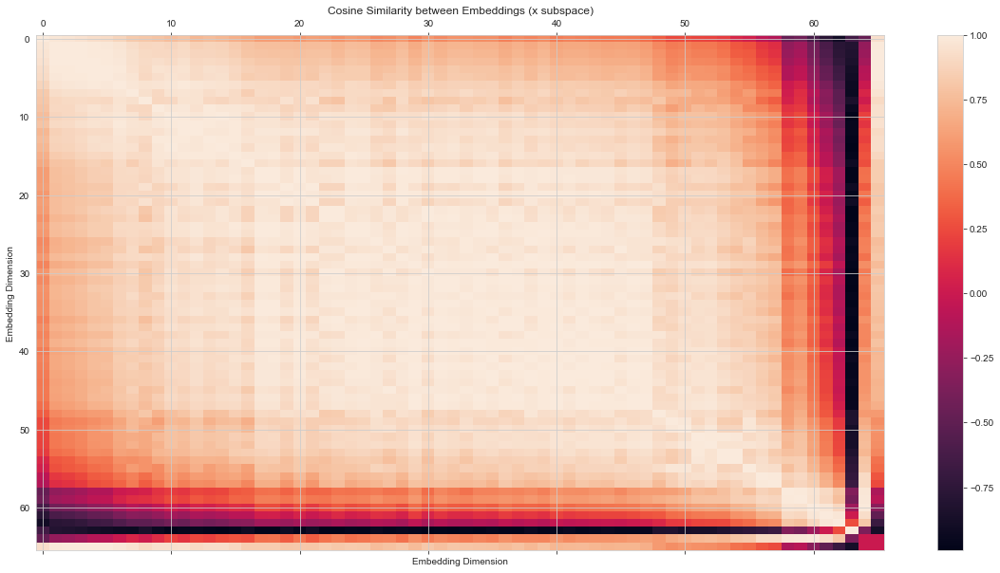

In [543]:
# Okay it looks like there are a bunch of redundant embeddings. Let's look at the cosine similarity between the embeddings. 

embed_cos_sims = np.zeros((len(embed_weights) + 2, len(embed_weights) + 2))

x_embeds_reordered = x_embeds[task_line_ordering]

for i, embed_i in enumerate(x_embeds_reordered):
    for j, embed_j in enumerate(x_embeds_reordered):
        embed_cos_sims[i, j] = torch.cosine_similarity(embed_i.unsqueeze(0).unsqueeze(-1), embed_j.unsqueeze(0).unsqueeze(-1)).item()

# Do the tasks as well

for i, embed_i in enumerate(x_embeds_reordered):
    for t, task in enumerate(tasks):
        embed_cos_sims[i, len(embed_weights) + t] = torch.cosine_similarity(embed_i.unsqueeze(0).unsqueeze(-1), task.unsqueeze(0).unsqueeze(-1)).item()
        embed_cos_sims[len(embed_weights) + t, i] = torch.cosine_similarity(embed_i.unsqueeze(0).unsqueeze(-1), task.unsqueeze(0).unsqueeze(-1)).item()

fig, ax0 = plt.subplots(1, 1, figsize=(20, 10))

cax = ax0.matshow(embed_cos_sims, aspect='auto')
ax0.set_title("Cosine Similarity between Embeddings (x subspace)")
ax0.set_xlabel("Embedding Dimension")
ax0.set_ylabel("Embedding Dimension")

fig.colorbar(cax, ax=ax0)


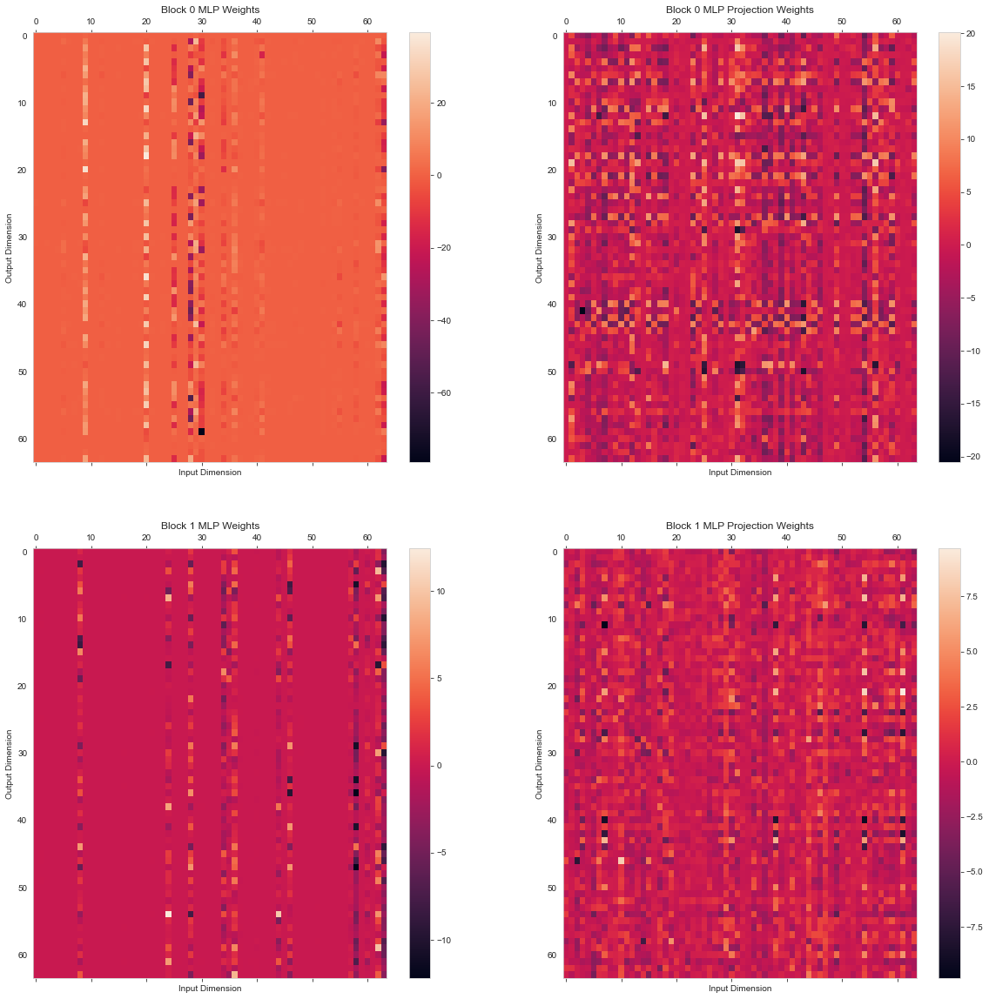

In [585]:
# Okay let's look at the last MLP
block0_mlp = run.model.token_sequence_transformer.blocks[0].compute[0]
block0_mlp_proj = run.model.token_sequence_transformer.blocks[0].compute[2]
block1_mlp = run.model.token_sequence_transformer.blocks[1].compute[0]
block1_mlp_proj = run.model.token_sequence_transformer.blocks[1].compute[2]

block0_mlp_weights = block0_mlp.weight.detach().cpu().numpy() * block0_ln1.detach().cpu().numpy()
block0_mlp_proj_weights = block0_mlp_proj.weight.detach().cpu().numpy() 
block1_mlp_weights = block1_mlp.weight.detach().cpu().numpy() * block1_ln1.detach().cpu().numpy()
block1_mlp_proj_weights = block1_mlp_proj.weight.detach().cpu().numpy()

block0_mlp_bias = block0_mlp.bias.detach().cpu().numpy()
block0_mlp_proj_bias = block0_mlp_proj.bias.detach().cpu().numpy()
block1_mlp_bias = block1_mlp.bias.detach().cpu().numpy()
block1_mlp_proj_bias = block1_mlp_proj.bias.detach().cpu().numpy()

# Matshow the last weights 

fig, axes = plt.subplots(2, 2, figsize=(20, 20))

cax = axes[0, 0].matshow(block0_mlp_weights, aspect='auto')
axes[0, 0].set_title("Block 0 MLP Weights")
axes[0, 0].set_xlabel("Input Dimension")
axes[0, 0].set_ylabel("Output Dimension")
axes[0, 0].grid(False)
fig.colorbar(cax, ax=axes[0, 0])

cax = axes[0, 1].matshow(block0_mlp_proj_weights, aspect='auto')
axes[0, 1].set_title("Block 0 MLP Projection Weights")
axes[0, 1].set_xlabel("Input Dimension")
axes[0, 1].set_ylabel("Output Dimension")
axes[0, 1].grid(False)
fig.colorbar(cax, ax=axes[0, 1])

cax = axes[1, 0].matshow(block1_mlp_weights, aspect='auto')
axes[1, 0].set_title("Block 1 MLP Weights")
axes[1, 0].set_xlabel("Input Dimension")
axes[1, 0].set_ylabel("Output Dimension")
axes[1, 0].grid(False)
fig.colorbar(cax, ax=axes[1, 0])

cax = axes[1, 1].matshow(block1_mlp_proj_weights, aspect='auto')
axes[1, 1].set_title("Block 1 MLP Projection Weights")
axes[1, 1].set_xlabel("Input Dimension")
axes[1, 1].set_ylabel("Output Dimension")
axes[1, 1].grid(False)
fig.colorbar(cax, ax=axes[1, 1])

[2 5 3 4 1 0 5 1 3 7 0 3 2 4 2 2 0 3 1 2 4 2 2 7 0 1 2 5 3 2 3 5 1 0 2 0 1
 5 0 1 0 5 0 1 7 0 1 2 2 2 2 2 3 3 5 3 5 5 3 7 6 2 2 3]


/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



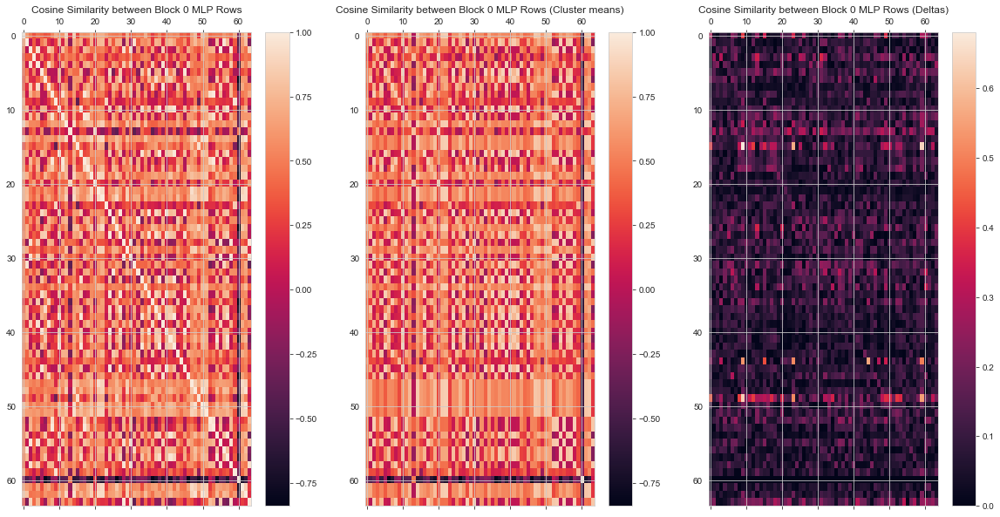

In [644]:
block0_mlp_cos_sims = np.zeros((block0_mlp_weights.shape[0], block0_mlp_weights.shape[0]))

for i, weight_i in enumerate(block0_mlp_weights):
    for j, weight_j in enumerate(block0_mlp_weights):
        block0_mlp_cos_sims[i, j] = torch.cosine_similarity(torch.tensor(weight_i).unsqueeze(0).unsqueeze(-1), torch.tensor(weight_j).unsqueeze(0).unsqueeze(-1)).item()

# Cluster the cos sims
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=8, random_state=0).fit(block0_mlp_cos_sims)

print(kmeans.labels_)
# print(kmeans.cluster_centers_)

block0_mlp_cos_sims_centers = np.zeros((block0_mlp_weights.shape[0], block0_mlp_weights.shape[0]))

for i, weight_i in enumerate(block0_mlp_weights):
    block0_mlp_cos_sims_centers[i, :] = kmeans.cluster_centers_[kmeans.labels_[i]]

fig, (ax0, ax1, ax2) = plt.subplots(1, 3, figsize=(20, 10))

cax = ax0.matshow(block0_mlp_cos_sims, aspect='auto')
ax0.set_title("Cosine Similarity between Block 0 MLP Rows")
fig.colorbar(cax, ax=ax0)

cax = ax1.matshow(block0_mlp_cos_sims_centers, aspect='auto')
ax1.set_title("Cosine Similarity between Block 0 MLP Rows (Cluster means)")
fig.colorbar(cax, ax=ax1)

# Plot the deltas

block0_mlp_cos_sims_deltas = np.abs((block0_mlp_cos_sims - block0_mlp_cos_sims_centers))

cax = ax2.matshow(block0_mlp_cos_sims_deltas, aspect='auto')
ax2.set_title("Cosine Similarity between Block 0 MLP Rows (Deltas)")
fig.colorbar(cax, ax=ax2)



/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



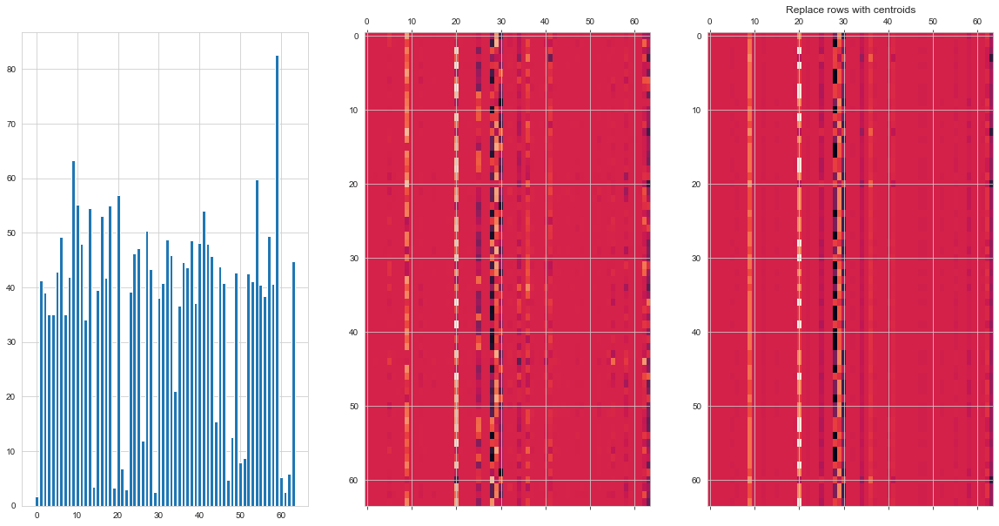

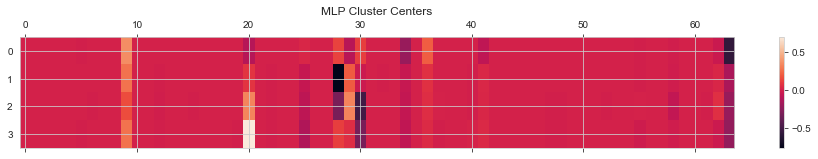

In [647]:
# Clustering the cos sim matrix doesn't really make sense
# Rescale each row in the block0_mlp_weights to have unit_norm

block0_mlp_row_norms = np.linalg.norm(block0_mlp_weights, axis=1)
block0_mlp_weights_rescaled = block0_mlp_weights / block0_mlp_row_norms[:, np.newaxis]

fig, (ax0, ax1, ax2) = plt.subplots(1, 3, figsize=(20, 10))

ax0.bar(range(block0_mlp_weights_rescaled.shape[0]), block0_mlp_row_norms)
ax1.matshow(block0_mlp_weights_rescaled, aspect='auto')

 # Cluster the rescaled rows

mlp_kmeans = KMeans(n_clusters=4, random_state=0).fit(block0_mlp_weights_rescaled)

block0_mlp_to_centroids = np.zeros((block0_mlp_weights.shape[0], block0_mlp_weights.shape[0]))

for i, weight_i in enumerate(block0_mlp_weights):
    block0_mlp_to_centroids[i, :] = mlp_kmeans.cluster_centers_[mlp_kmeans.labels_[i]]

cax = ax2.matshow(block0_mlp_to_centroids, aspect='auto')
ax2.set_title("Replace rows with centroids")

plt.show()

15.38775394449418


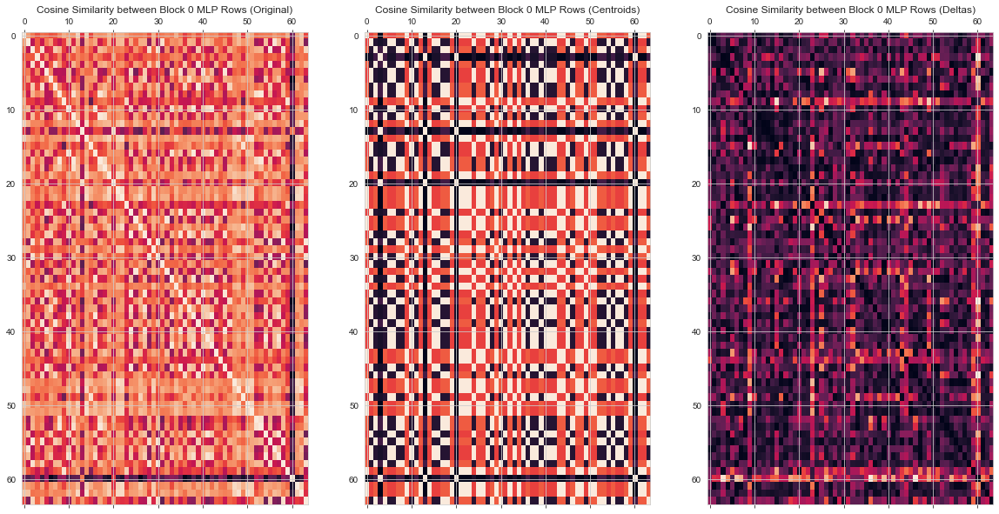

In [635]:

# Now compute the cos sim matrix

block0_mlp_rescaled_cos_sims = np.zeros((block0_mlp_weights.shape[0], block0_mlp_weights.shape[0]))

for i, weight_i in enumerate(block0_mlp_to_centroids):
    for j, weight_j in enumerate(block0_mlp_to_centroids):
        block0_mlp_rescaled_cos_sims[i, j] = torch.cosine_similarity(torch.tensor(weight_i).unsqueeze(0).unsqueeze(-1), torch.tensor(weight_j).unsqueeze(0).unsqueeze(-1)).item()

fig, (ax0, ax1, ax2) = plt.subplots(1, 3, figsize=(20, 10))


cax = ax0.matshow(block0_mlp_cos_sims, aspect='auto')
ax0.set_title("Cosine Similarity between Block 0 MLP Rows (Original)")


cax = ax1.matshow(block0_mlp_rescaled_cos_sims, aspect='auto')
ax1.set_title("Cosine Similarity between Block 0 MLP Rows (Centroids)")

# Deltas

block0_mlp_rescaled_cos_sims_deltas = np.abs((block0_mlp_rescaled_cos_sims - block0_mlp_cos_sims))

cax = ax2.matshow(block0_mlp_rescaled_cos_sims_deltas, aspect='auto')
ax2.set_title("Cosine Similarity between Block 0 MLP Rows (Deltas)")

print(np.mean(np.sum(block0_mlp_rescaled_cos_sims_deltas, axis=1)))


/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



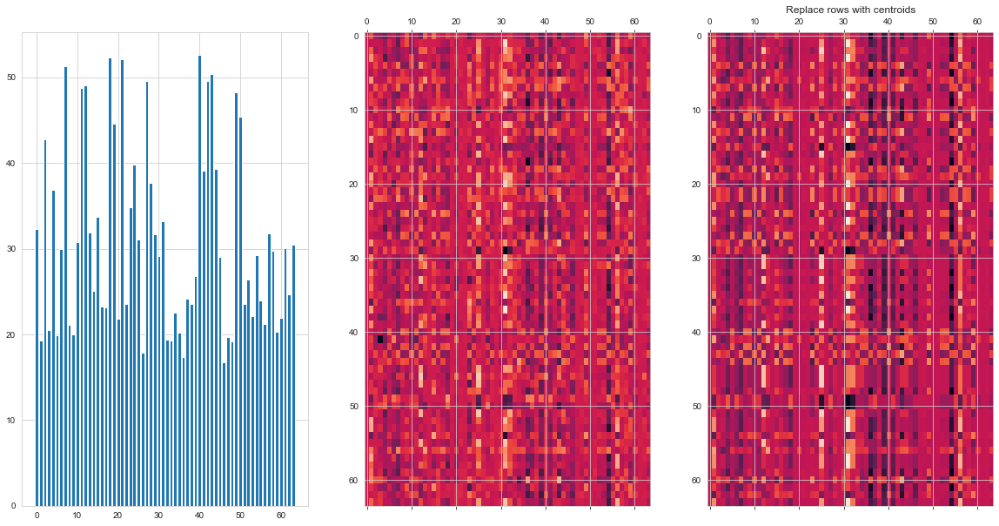

In [645]:
# Okay, so maybe I've reduced the MLP to a mere four operations?

# Can I do the same to the projection?

block0_mlp_proj_row_norms = np.linalg.norm(block0_mlp_proj_weights, axis=1)
block0_mlp_proj_weights_rescaled = block0_mlp_proj_weights / block0_mlp_proj_row_norms[:, np.newaxis]

fig, (ax0, ax1, ax2) = plt.subplots(1, 3, figsize=(20, 10))

ax0.bar(range(block0_mlp_proj_weights_rescaled.shape[0]), block0_mlp_proj_row_norms)
ax1.matshow(block0_mlp_proj_weights_rescaled, aspect='auto')

 # Cluster the rescaled rows

mlp_proj_kmeans = KMeans(n_clusters=8, random_state=0).fit(block0_mlp_proj_weights_rescaled)

block0_mlp_proj_to_centroids = np.zeros((block0_mlp_proj_weights.shape[0], block0_mlp_proj_weights.shape[0]))

for i, weight_i in enumerate(block0_mlp_proj_weights):
    block0_mlp_proj_to_centroids[i, :] = mlp_proj_kmeans.cluster_centers_[mlp_proj_kmeans.labels_[i]]

cax = ax2.matshow(block0_mlp_proj_to_centroids, aspect='auto')
ax2.set_title("Replace rows with centroids")

plt.show()

13.233820086667496


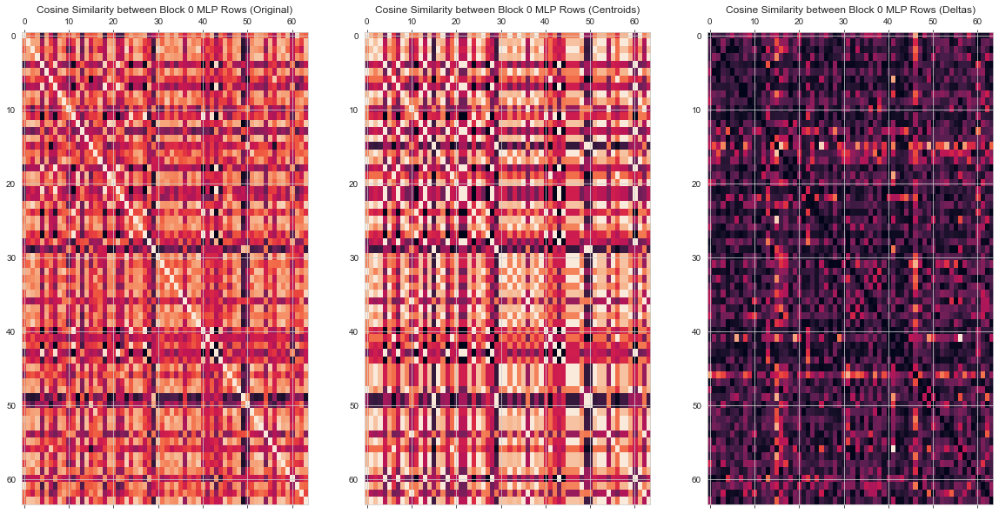

In [642]:
# Now compute the cos sim matrix
block0_mlp_proj_cos_sims = np.zeros((block0_mlp_proj_weights.shape[0], block0_mlp_proj_weights.shape[0]))

for i, weight_i in enumerate(block0_mlp_proj_weights):
    for j, weight_j in enumerate(block0_mlp_proj_weights):
        block0_mlp_proj_cos_sims[i, j] = torch.cosine_similarity(torch.tensor(weight_i).unsqueeze(0).unsqueeze(-1), torch.tensor(weight_j).unsqueeze(0).unsqueeze(-1)).item()


block0_mlp_proj_rescaled_cos_sims = np.zeros((block0_mlp_proj_weights.shape[0], block0_mlp_proj_weights.shape[0]))

for i, weight_i in enumerate(block0_mlp_proj_to_centroids):
    for j, weight_j in enumerate(block0_mlp_proj_to_centroids):
        block0_mlp_proj_rescaled_cos_sims[i, j] = torch.cosine_similarity(torch.tensor(weight_i).unsqueeze(0).unsqueeze(-1), torch.tensor(weight_j).unsqueeze(0).unsqueeze(-1)).item()

fig, (ax0, ax1, ax2) = plt.subplots(1, 3, figsize=(20, 10))


cax = ax0.matshow(block0_mlp_proj_cos_sims, aspect='auto')
ax0.set_title("Cosine Similarity between Block 0 MLP Rows (Original)")


cax = ax1.matshow(block0_mlp_proj_rescaled_cos_sims, aspect='auto')
ax1.set_title("Cosine Similarity between Block 0 MLP Rows (Centroids)")

# Deltas

block0_mlp_proj_rescaled_cos_sims_deltas = np.abs((block0_mlp_proj_rescaled_cos_sims - block0_mlp_proj_cos_sims))

cax = ax2.matshow(block0_mlp_proj_rescaled_cos_sims_deltas, aspect='auto')
ax2.set_title("Cosine Similarity between Block 0 MLP Rows (Deltas)")

print(np.mean(np.sum(block0_mlp_proj_rescaled_cos_sims_deltas, axis=1)))


[2 1 3 0 3 1 1 3 3 2 1 3 2 0 2 1 1 3 3 2 0 2 2 2 1 2 2 1 3 2 3 1 2 1 2 1 3
 1 1 3 1 1 1 2 2 1 3 2 2 1 2 2 3 3 1 3 1 1 3 2 0 2 2 3]
[6 1 3 1 4 6 0 4 1 6 2 5 1 4 1 7 3 6 4 0 1 4 4 1 5 1 6 5 4 7 3 3 6 3 6 1 2
 1 6 3 5 0 5 4 5 3 3 3 6 7 7 3 1 1 2 3 0 1 1 6 4 6 2 1]


Text(0.5, 1.0, 'Block 0 MLP neuron types')

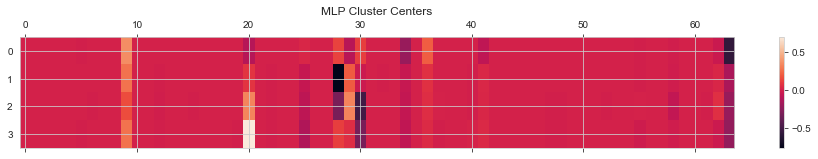

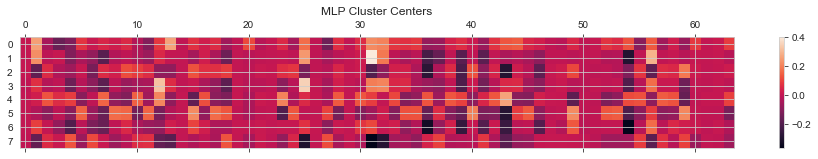

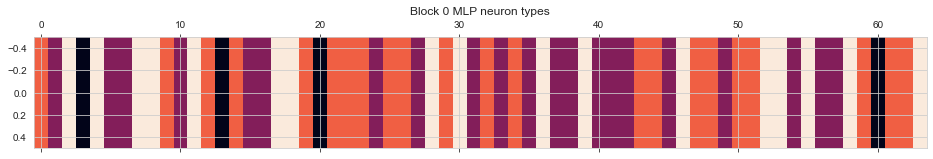

In [658]:
cax = plt.matshow(mlp_kmeans.cluster_centers_, aspect='auto')
plt.title("MLP Cluster Centers")
plt.colorbar(cax)

cax = plt.matshow(mlp_proj_kmeans.cluster_centers_, aspect='auto')
plt.title("MLP Cluster Centers")
plt.colorbar(cax)

print(mlp_kmeans.labels_)
print(mlp_proj_kmeans.labels_)

plt.matshow(mlp_kmeans.labels_[:, np.newaxis].T, aspect='auto')
plt.title("Block 0 MLP neuron types")

<BarContainer object of 64 artists>

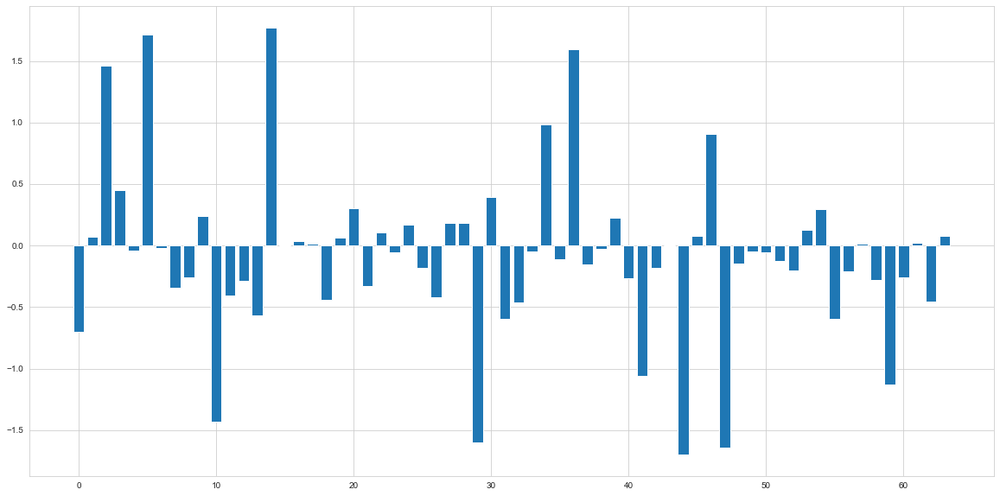

In [678]:
fig = plt.figure(figsize=(20, 10))
plt.bar(range(64), block1_mlp_proj_weights[35, :])

In [16]:
# Let's look at the 5 layer norms over time

ln_layers = [
    "token_sequence_transformer.blocks.0.layer_norms.0",
    "token_sequence_transformer.blocks.0.layer_norms.1",
    "token_sequence_transformer.blocks.1.layer_norms.0",
    "token_sequence_transformer.blocks.1.layer_norms.1",
    "token_sequence_transformer.unembedding.0"
]

lns_over_time = []

for step, model in zip(run.checkpointer.file_ids, models):
    for layer in ln_layers:
        lns_over_time.append({
            "step": step,
            "layer": layer,
            "weight": model.state_dict()[layer + ".weight"].detach().cpu().numpy(),
            "bias": model.state_dict()[layer + ".bias"].detach().cpu().numpy()
        })

lns_over_time = pd.DataFrame(lns_over_time)

max_y_weight = {}
max_y_bias = {}
for layer in ln_layers:
    all_weights = [item for item in lns_over_time.loc[lns_over_time['layer'] == layer]['weight']]
    all_biases = [item for item in lns_over_time.loc[lns_over_time['layer'] == layer]['bias']]
    max_y_weight[layer] = max([val.max() for val in all_weights])
    max_y_bias[layer] = max([val.max() for val in all_biases])


In [21]:
# Initialize subplots, 2 rows (for weight and bias) and 5 columns (for each layer)
fig = make_subplots(rows=2, cols=5, subplot_titles=[(".").join(ln_layer.replace("layer_norms", "ln").split('.')[1:]) + ".weight" for ln_layer in ln_layers] + [(".").join(ln_layer.replace("layer_norms", "ln").split('.')[1:]) + ".bias" for ln_layer in ln_layers])

for index, layer in enumerate(ln_layers):
    initial_data = lns_over_time[(lns_over_time['layer'] == layer) & (lns_over_time['step'] == 0)]
    
    # Weight bar plot
    fig.add_trace(
        go.Bar(x=list(range(len(initial_data['weight'].iloc[0]))), y=initial_data['weight'].iloc[0]),
        row=1, col=index+1
    )
    fig.update_yaxes(range=[0, max_y_weight[layer]], row=1, col=index+1)
    
    # Bias bar plot
    fig.add_trace(
        go.Bar(x=list(range(len(initial_data['bias'].iloc[0]))), y=initial_data['bias'].iloc[0]),
        row=2, col=index+1
    )
    fig.update_yaxes(range=[0, max_y_bias[layer]], row=2, col=index+1)

# Define animation frames
frames = []
for step in lns_over_time['step'].unique():
    frame_data = []
    
    for index, layer in enumerate(ln_layers):
        step_data = lns_over_time[(lns_over_time['layer'] == layer) & (lns_over_time['step'] == step)]
        
        # Weight
        frame_data.append(go.Bar(x=list(range(len(step_data['weight'].iloc[0]))), y=step_data['weight'].iloc[0]))
        
        # Bias
        frame_data.append(go.Bar(x=list(range(len(step_data['bias'].iloc[0]))), y=step_data['bias'].iloc[0]))
    
    frames.append(go.Frame(data=frame_data, name=f"Step {step}"))

fig.frames = frames

# Add play and pause buttons
animation_settings = dict(frame=dict(duration=300, redraw=True), fromcurrent=True)
fig.update_layout(updatemenus=[dict(type="buttons", showactive=False, buttons=[dict(label="Play",
                                            method="animate", args=[None, animation_settings]),
                                          dict(label="Pause", method="animate", args=[[None], dict(frame=dict(duration=0, redraw=False), mode="immediate")])])])


# Add sliders
sliders = [dict(steps=[dict(method='animate', args=[[f'Step {s}'], dict(mode='immediate', frame=dict(duration=300, redraw=True))], label=f'Step {s}') for s in lns_over_time['step'].unique()], active=0)]

fig.update_layout(sliders=sliders)

# Show figure
fig.show()

In [19]:
import yaml
from fancy_einsum import einsum
from icl.analysis.evals import ICLEvaluator
from collections import defaultdict
from tqdm import tqdm


# Okay, I'm going to train linear probes_normalized to read out the internal activations I expect the model to develop at each point:
# - For x_k, I want to check v_+^T x_k and v_-^T x_k, $x_i$, $y_i$, $\delta_mi$, $|\delta_mi|$ for i < k, and $\bar|\delta_m|$ 

# print(train_xs.shape, train_ys.shape)

v_plus = (tasks[0] + tasks[1]) / 2.
v_minus = (tasks[0] - tasks[1]) / 2.

task_0_xs = einsum('D, B T D -> B T', tasks[0], train_xs)
task_1_xs = einsum('D, B T D -> B T', tasks[1], train_xs)
v_plus_x_ks = einsum('D, B T D -> B T', v_plus, train_xs)
v_minus_x_ks = einsum('D, B T D -> B T', v_minus, train_xs)

delta_0s = train_ys.squeeze(-1) - task_0_xs
delta_1s = train_ys.squeeze(-1) - task_1_xs

abs_delta_0s = torch.abs(delta_0s)
abs_delta_1s = torch.abs(delta_1s)

sq_delta_0s = delta_0s ** 2
sq_delta_1s = delta_1s ** 2

# print(v_plus_x_ks.shape, v_minus_x_ks.shape)
# print(train_ys.shape)
# print("DELTAS", delta_0s.shape, delta_1s.shape, abs_delta_0s.shape, abs_delta_1s.shape)

avg_abs_delta_0s = torch.cumsum(abs_delta_0s, dim=1) / torch.arange(1, 9, device=DEVICE).unsqueeze(0)
avg_abs_delta_1s = torch.cumsum(abs_delta_1s, dim=1) / torch.arange(1, 9, device=DEVICE).unsqueeze(0)

mse_delta_0s = torch.cumsum(sq_delta_0s, dim=1) / torch.arange(1, 9, device=DEVICE).unsqueeze(0)
mse_delta_1s = torch.cumsum(sq_delta_1s, dim=1) / torch.arange(1, 9, device=DEVICE).unsqueeze(0)

rt_mse_delta_0s = torch.sqrt(mse_delta_0s)
rt_mse_delta_1s = torch.sqrt(mse_delta_1s)

probes = defaultdict(dict)

# print(delta_0s[0])
# print(avg_abs_delta_0s[0])

def train_probe(activations: TensorType["B", "E"], target: TensorType["B"]):
    assert activations.shape[0] == target.shape[0] and len(activations.shape) == 2 and len(target.shape) == 1, f"Activations shape {activations.shape} and target shape {target.shape} are not compatible"
    X = torch.cat([activations, torch.ones(activations.shape[0], 1, device=DEVICE, dtype=torch.float32)], dim=1)

    # Calculate the pseudo-inverse of X
    X_pseudo_inv = torch.pinverse((X.t().mm(X)).to("cpu")).to(DEVICE).mm(X.t())

    # Calculate optimal weights
    w_optimal = X_pseudo_inv.mm(target.unsqueeze(1))

    # Extract the learned weights and bias
    learned_weights = w_optimal[:-1, :]
    learned_bias = w_optimal[-1, :]
    
    loss = nn.MSELoss()(activations.mm(learned_weights) + learned_bias, target.unsqueeze(1))

    return {"probe": w_optimal, "loss": loss.item()}


for layer in tqdm(resid_stream_layers, desc=f"Iterating over layers"):
    print("=" * 20 + f" Layer {layer} " + "=" * 20)
    activation = activations_over_time[-1][layer].detach()

    layer_probes = []

    for i in tqdm(range(2 * 8), desc=f"Layer {layer}"):
        # Train a separate linear probe for each token position, both xs and ys
        local_activation = activation[:, i, :]
        i_probes = []

        for j in tqdm(range(min(i+1, 8)), desc=f"Token position {i}"):
            ij_probes = {}

            # Some of these combinations won't make sense (e.g., trying to predict y_1 from x_1). I'm too lazy to customize this. 
            ij_probes["v_plus_x_j"] = train_probe(local_activation, v_plus_x_ks[:, j])
            ij_probes["v_minus_x_j"] = train_probe(local_activation, v_minus_x_ks[:, j])
            ij_probes["y_j"] = train_probe(local_activation, train_ys[:, j].squeeze(-1))
            ij_probes["delta_0j"] = train_probe(local_activation, delta_0s[:, j])
            ij_probes["delta_1j"] = train_probe(local_activation, delta_1s[:, j])
            ij_probes["abs_delta_0j"] = train_probe(local_activation, abs_delta_0s[:, j])
            ij_probes["abs_delta_1j"] = train_probe(local_activation, abs_delta_1s[:, j])
            ij_probes["sq_delta_0j"] = train_probe(local_activation, sq_delta_0s[:, j])
            ij_probes["sq_delta_1j"] = train_probe(local_activation, sq_delta_1s[:, j])
            ij_probes["avg_abs_delta_0j"] = train_probe(local_activation, avg_abs_delta_0s[:, j])
            ij_probes["avg_abs_delta_1j"] = train_probe(local_activation, avg_abs_delta_1s[:, j])
            ij_probes["mse_delta_0j"] = train_probe(local_activation, mse_delta_0s[:, j])
            ij_probes["mse_delta_1j"] = train_probe(local_activation, mse_delta_1s[:, j])
            ij_probes["rt_mse_delta_0j"] = train_probe(local_activation, rt_mse_delta_0s[:, j])
            ij_probes["rt_mse_delta_1j"] = train_probe(local_activation, rt_mse_delta_1s[:, j])

            i_probes.append(ij_probes)

            print(yaml.dump({('x' if i % 2 == 0 else 'y') + str(i//2) + ":" + k[:-1] + str(j): v["loss"] for k, v in ij_probes.items()}))
        layer_probes.append(i_probes)
    probes[layer] = layer_probes


NameError: name 'train_xs' is not defined

In [955]:
test_evaluator = ICLEvaluator(pretrain_dist=run.pretrain_dist, true_dist=run.true_dist, max_examples=8, eval_batch_size=1024, seed=42)
test_xs, test_ys = test_evaluator.pretrain_xs, test_evaluator.pretrain_ys


In [956]:
probes_flattened = [{"layer": name, "layer_idx": l, "token": i, "i": i // 2, "j": j, **{k: v["loss"] for k, v in pij.items()}} for l, (name, p) in enumerate(probes.items()) for i, pi in enumerate(p) for j, pij in enumerate(pi)]
probes_df = pd.DataFrame(probes_flattened)
probes_df

,layer,layer_idx,token,i,j,v_plus_x_j,v_minus_x_j,y_j,delta_0j,delta_1j,abs_delta_0j,abs_delta_1j,sq_delta_0j,sq_delta_1j,avg_abs_delta_0j,avg_abs_delta_1j,mse_delta_0j,mse_delta_1j,rt_mse_delta_0j,rt_mse_delta_1j
0,token_sequence_transformer.token_embedding,0,0,0,0,0.066168,0.082990,0.988398,1.006437,1.017697,1.245104,1.275725,15.599723,18.417576,1.245104,1.275725,15.599723,18.417576,1.245104,1.275725
1,token_sequence_transformer.token_embedding,0,1,0,0,0.473554,0.830622,0.090683,0.862046,1.761925,1.228129,1.273342,15.268342,18.400278,1.228129,1.273342,15.268342,18.400278,1.228129,1.273342
2,token_sequence_transformer.token_embedding,0,1,0,1,0.796901,0.986022,1.775578,1.923770,2.010881,1.333297,1.358743,19.035671,21.688717,0.963507,0.942257,10.391363,11.667521,1.150300,1.161485
3,token_sequence_transformer.token_embedding,0,2,1,0,0.784694,0.926363,1.614440,1.826766,1.873392,1.241355,1.268260,15.781712,18.344582,1.241355,1.268260,15.781712,18.344582,1.241355,1.268260
4,token_sequence_transformer.token_embedding,0,2,1,1,0.035322,0.001001,1.013859,0.981559,0.981429,1.310720,1.339055,18.815022,21.450058,0.957279,0.930503,10.474255,11.522082,1.146502,1.146497
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,token_sequence_transformer.blocks.1,4,15,7,3,0.857114,1.098093,1.830791,2.014246,2.103729,0.712338,0.785152,15.965361,15.282301,0.190800,0.226239,3.409643,4.307006,0.242454,0.304302
496,token_sequence_transformer.blocks.1,4,15,7,4,0.780460,0.865252,1.620990,1.794882,1.718624,0.614968,0.629497,10.643761,9.870970,0.154993,0.184645,2.565533,3.115402,0.203402,0.250151
497,token_sequence_transformer.blocks.1,4,15,7,5,0.762935,0.950124,1.811909,1.845762,1.894555,0.720491,0.757252,18.667179,16.465088,0.146743,0.158002,2.330071,2.576696,0.195234,0.214270
498,token_sequence_transformer.blocks.1,4,15,7,6,0.490916,0.539919,1.674741,1.442245,1.558237,0.665161,0.650596,12.128195,12.192958,0.136607,0.136858,1.956081,2.037332,0.182414,0.189755


/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.

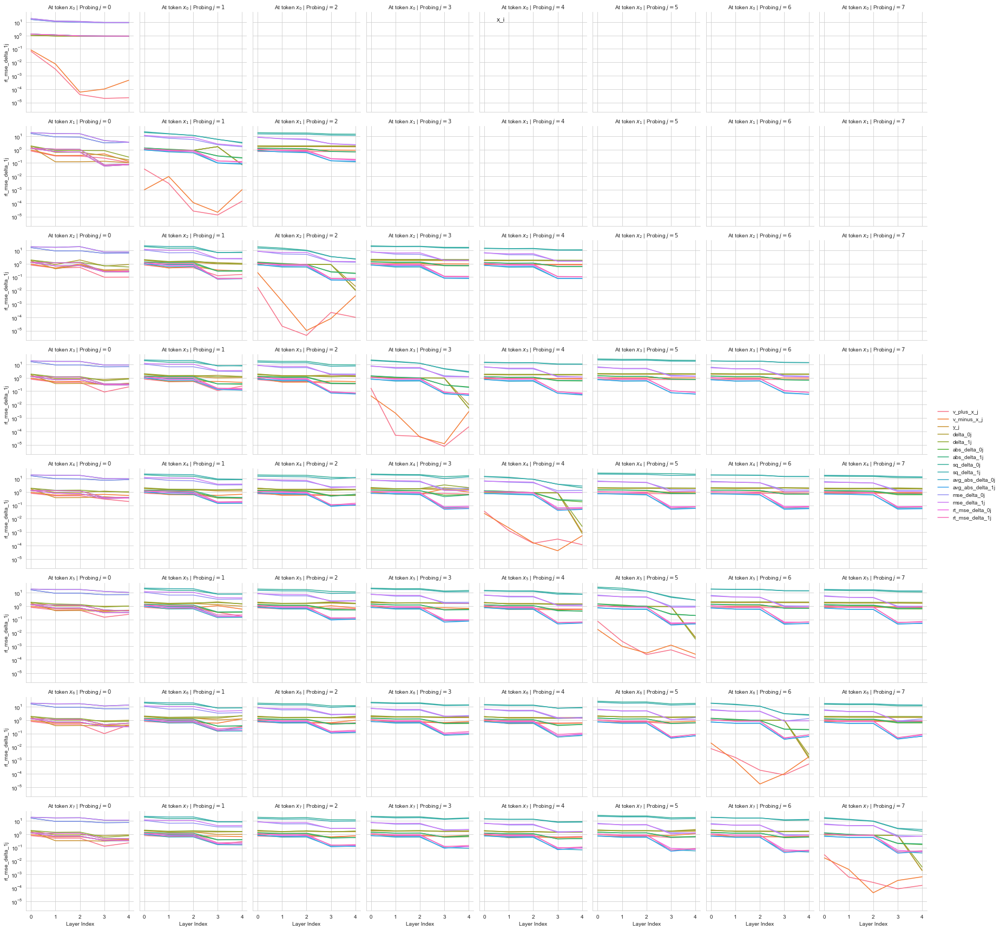

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.

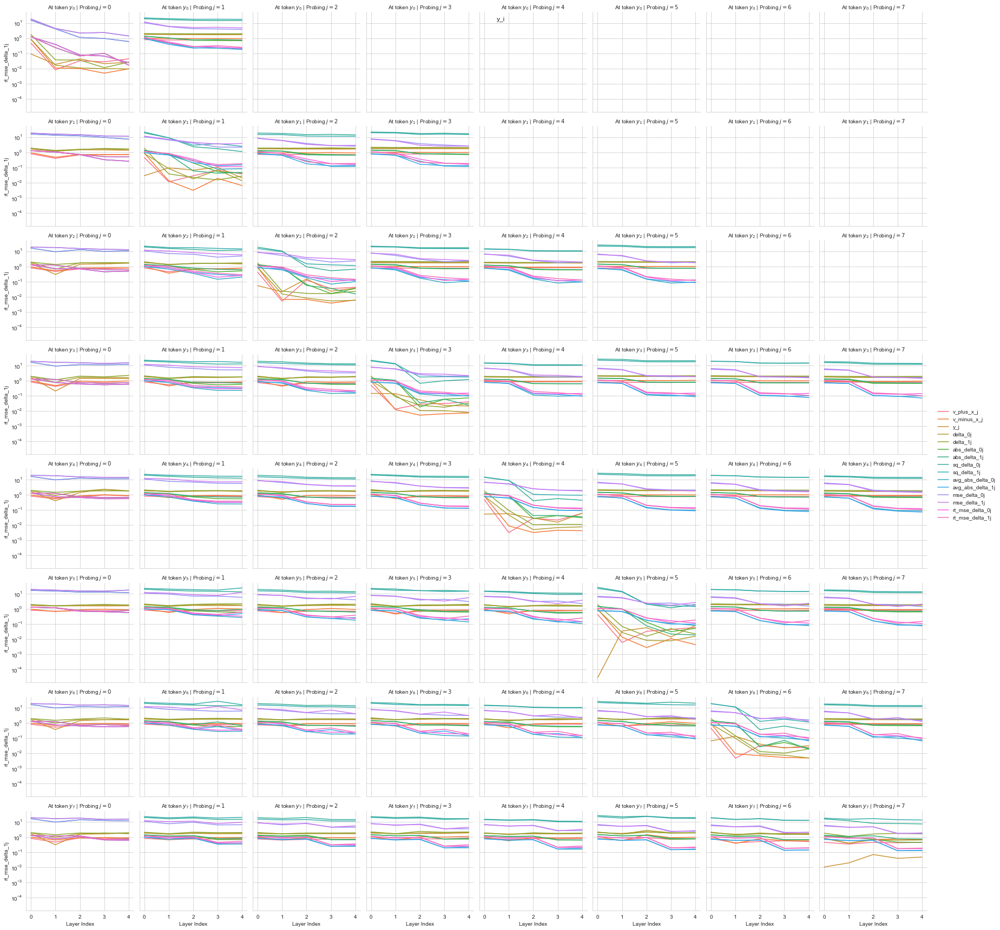

In [957]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

x_probes_df = probes_df[probes_df["token"] % 2 == 0]
y_probes_df = probes_df[probes_df["token"] % 2 == 1]

# Create a FacetGrid
g = sns.FacetGrid(x_probes_df, row="i", col="j", margin_titles=False, row_order=range(8), col_order=range(8)) #, sharey=False, sharex=False)


# Map line plots onto the FacetGrid
metrics = ["v_plus_x_j", "v_minus_x_j", "y_j", "delta_0j", "delta_1j", "abs_delta_0j", "abs_delta_1j", "sq_delta_0j", "sq_delta_1j", "avg_abs_delta_0j", "avg_abs_delta_1j", "mse_delta_0j", "mse_delta_1j", "rt_mse_delta_0j", "rt_mse_delta_1j"]
palette = sns.color_palette("husl", len(metrics))  
for i, metric in enumerate(metrics):
    g.map_dataframe(sns.lineplot, x="layer_idx", y=metric, label=metric, color=palette[i])

# Add legend and titles
g.set_axis_labels("Layer Index")
g.set_titles(col_template="Probing $j={col_name}$", row_template="At token $x_{row_name}$")
g.set(xticks=probes_df.layer_idx.unique())
g.tight_layout()
g.add_legend()  
g.fig.set_facecolor('white')
g.fig.suptitle("x_i")
g.set(yscale="log")

plt.savefig("../figures/M2L2H4_x_probes@t_final.png",)
plt.show()

# Create a FacetGrid
g = sns.FacetGrid(y_probes_df, row="i", col="j", margin_titles=False, row_order=range(8), col_order=range(8)) #, sharey=False, sharex=False)

# Map line plots onto the FacetGrid
for i, metric in enumerate(metrics):
    g.map_dataframe(sns.lineplot, x="layer_idx", y=metric, label=metric, color=palette[i])

# Add legend and titles
g.set_axis_labels("Layer Index")
g.set_titles(col_template="Probing $j={col_name}$", row_template="At token $y_{row_name}$")
g.set(xticks=probes_df.layer_idx.unique())
g.tight_layout()
g.add_legend()
g.fig.set_facecolor('white')
g.fig.suptitle("y_i")
g.set(yscale="log")

plt.savefig("../figures/M2L2H4_y_probes@t_final.png")
plt.show()


In [958]:
normalized_activations_over_time = []

for act in activations_over_time:
    normalized_act = {}
    for layer, layer_act in act.items():
        if layer_act is None:
            continue
        layer_act = layer_act.detach()
        layer_act = (layer_act - layer_act.mean()) / (layer_act.std() + 1e-8)
        normalized_act[layer] = layer_act
    normalized_activations_over_time.append(normalized_act)
    

In [959]:
import yaml
from fancy_einsum import einsum
from icl.analysis.evals import ICLEvaluator
from collections import defaultdict
from tqdm import tqdm
from devinfra.utils.seed import set_seed


probes_normalized = defaultdict(dict)

# print(delta_0s[0])
# print(avg_abs_delta_0s[0])

def train_probe(activations: TensorType["B", "E"], target: TensorType["B"]):
    assert activations.shape[0] == target.shape[0] and len(activations.shape) == 2 and len(target.shape) == 1, f"Activations shape {activations.shape} and target shape {target.shape} are not compatible"
    X = torch.cat([activations, torch.ones(activations.shape[0], 1, device=DEVICE, dtype=torch.float32)], dim=1)

    # Calculate the pseudo-inverse of X
    X_pseudo_inv = torch.pinverse((X.t().mm(X)).to("cpu")).to(DEVICE).mm(X.t())

    # Calculate optimal weights
    w_optimal = X_pseudo_inv.mm(target.unsqueeze(1))

    # Extract the learned weights and bias
    learned_weights = w_optimal[:-1, :]
    learned_bias = w_optimal[-1, :]
    
    loss = nn.MSELoss()(activations.mm(learned_weights) + learned_bias, target.unsqueeze(1))

    return {"probe": w_optimal, "loss": loss.item()}


for layer in tqdm(resid_stream_layers, desc=f"Iterating over layers"):
    print("=" * 20 + f" Layer {layer} " + "=" * 20)
    activation = normalized_activations_over_time[-1][layer].detach()

    layer_probes_normalized = []

    for i in tqdm(range(2 * 8), desc=f"Layer {layer}"):
        # Train a separate linear probe for each token position, both xs and ys
        local_activation = activation[:, i, :]
        i_probes_normalized = []

        for j in tqdm(range(min(i+1, 8)), desc=f"Token position {i}"):
            ij_probes = {}

            # Some of these combinations won't make sense (e.g., trying to predict y_1 from x_1). I'm too lazy to customize this. 
            ij_probes["v_plus_x_j"] = train_probe(local_activation, v_plus_x_ks[:, j])
            ij_probes["v_minus_x_j"] = train_probe(local_activation, v_minus_x_ks[:, j])
            ij_probes["y_j"] = train_probe(local_activation, train_ys[:, j].squeeze(-1))
            ij_probes["delta_0j"] = train_probe(local_activation, delta_0s[:, j])
            ij_probes["delta_1j"] = train_probe(local_activation, delta_1s[:, j])
            ij_probes["abs_delta_0j"] = train_probe(local_activation, abs_delta_0s[:, j])
            ij_probes["abs_delta_1j"] = train_probe(local_activation, abs_delta_1s[:, j])
            ij_probes["sq_delta_0j"] = train_probe(local_activation, sq_delta_0s[:, j])
            ij_probes["sq_delta_1j"] = train_probe(local_activation, sq_delta_1s[:, j])
            ij_probes["avg_abs_delta_0j"] = train_probe(local_activation, avg_abs_delta_0s[:, j])
            ij_probes["avg_abs_delta_1j"] = train_probe(local_activation, avg_abs_delta_1s[:, j])
            ij_probes["mse_delta_0j"] = train_probe(local_activation, mse_delta_0s[:, j])
            ij_probes["mse_delta_1j"] = train_probe(local_activation, mse_delta_1s[:, j])
            ij_probes["rt_mse_delta_0j"] = train_probe(local_activation, rt_mse_delta_0s[:, j])
            ij_probes["rt_mse_delta_1j"] = train_probe(local_activation, rt_mse_delta_1s[:, j])

            i_probes_normalized.append(ij_probes)

            print(yaml.dump({('x' if i % 2 == 0 else 'y') + str(i//2) + ":" + k[:-1] + str(j): v["loss"] for k, v in ij_probes_normalized.items()}))
        layer_probes_normalized.append(i_probes_normalized)
    probes_normalized[layer] = layer_probes_normalized


Iterating over layers:   0%|          | 0/5 [00:00<?, ?it/s]

==================== Layer token_sequence_transformer.token_embedding ====================



Token position 0: 100%|██████████| 1/1 [00:00<00:00, 18.65it/s]


x0:abs_delta_00: 0.5166820287704468
x0:abs_delta_10: 0.7298492193222046
x0:avg_abs_delta_00: 0.1260380744934082
x0:delta_00: 0.6626103520393372
x0:delta_10: 1.5354059934616089
x0:v_minus_x_0: 0.6698140501976013
x0:v_plus_x_0: 0.4730055630207062
x0:y_0: 0.1522381454706192




Token position 1: 100%|██████████| 2/2 [00:00<00:00, 26.76it/s]


y0:abs_delta_00: 0.5166820287704468
y0:abs_delta_10: 0.7298492193222046
y0:avg_abs_delta_00: 0.1260380744934082
y0:delta_00: 0.6626103520393372
y0:delta_10: 1.5354059934616089
y0:v_minus_x_0: 0.6698140501976013
y0:v_plus_x_0: 0.4730055630207062
y0:y_0: 0.1522381454706192

y0:abs_delta_01: 0.5166820287704468
y0:abs_delta_11: 0.7298492193222046
y0:avg_abs_delta_01: 0.1260380744934082
y0:delta_01: 0.6626103520393372
y0:delta_11: 1.5354059934616089
y0:v_minus_x_1: 0.6698140501976013
y0:v_plus_x_1: 0.4730055630207062
y0:y_1: 0.1522381454706192



x1:abs_delta_00: 0.5166820287704468
x1:abs_delta_10: 0.7298492193222046
x1:avg_abs_delta_00: 0.1260380744934082
x1:delta_00: 0.6626103520393372
x1:delta_10: 1.5354059934616089
x1:v_minus_x_0: 0.6698140501976013
x1:v_plus_x_0: 0.4730055630207062
x1:y_0: 0.1522381454706192




Token position 2: 100%|██████████| 3/3 [00:00<00:00, 27.18it/s]


x1:abs_delta_01: 0.5166820287704468
x1:abs_delta_11: 0.7298492193222046
x1:avg_abs_delta_01: 0.1260380744934082
x1:delta_01: 0.6626103520393372
x1:delta_11: 1.5354059934616089
x1:v_minus_x_1: 0.6698140501976013
x1:v_plus_x_1: 0.4730055630207062
x1:y_1: 0.1522381454706192

x1:abs_delta_02: 0.5166820287704468
x1:abs_delta_12: 0.7298492193222046
x1:avg_abs_delta_02: 0.1260380744934082
x1:delta_02: 0.6626103520393372
x1:delta_12: 1.5354059934616089
x1:v_minus_x_2: 0.6698140501976013
x1:v_plus_x_2: 0.4730055630207062
x1:y_2: 0.1522381454706192



y1:abs_delta_00: 0.5166820287704468
y1:abs_delta_10: 0.7298492193222046
y1:avg_abs_delta_00: 0.1260380744934082
y1:delta_00: 0.6626103520393372
y1:delta_10: 1.5354059934616089
y1:v_minus_x_0: 0.6698140501976013
y1:v_plus_x_0: 0.4730055630207062
y1:y_0: 0.1522381454706192



y1:abs_delta_01: 0.5166820287704468
y1:abs_delta_11: 0.7298492193222046
y1:avg_abs_delta_01: 0.1260380744934082
y1:delta_01: 0.6626103520393372
y1:delta_11: 1.5354059934616089
y1:v_minus_x_1: 0.6698140501976013
y1:v_plus_x_1: 0.4730055630207062
y1:y_1: 0.1522381454706192

y1:abs_delta_02: 0.5166820287704468
y1:abs_delta_12: 0.7298492193222046
y1:avg_abs_delta_02: 0.1260380744934082
y1:delta_02: 0.6626103520393372
y1:delta_12: 1.5354059934616089
y1:v_minus_x_2: 0.6698140501976013
y1:v_plus_x_2: 0.4730055630207062
y1:y_2: 0.1522381454706192



Token position 3: 100%|██████████| 4/4 [00:00<00:00, 26.60it/s]


y1:abs_delta_03: 0.5166820287704468
y1:abs_delta_13: 0.7298492193222046
y1:avg_abs_delta_03: 0.1260380744934082
y1:delta_03: 0.6626103520393372
y1:delta_13: 1.5354059934616089
y1:v_minus_x_3: 0.6698140501976013
y1:v_plus_x_3: 0.4730055630207062
y1:y_3: 0.1522381454706192



x2:abs_delta_00: 0.5166820287704468
x2:abs_delta_10: 0.7298492193222046
x2:avg_abs_delta_00: 0.1260380744934082
x2:delta_00: 0.6626103520393372
x2:delta_10: 1.5354059934616089
x2:v_minus_x_0: 0.6698140501976013
x2:v_plus_x_0: 0.4730055630207062
x2:y_0: 0.1522381454706192

x2:abs_delta_01: 0.5166820287704468
x2:abs_delta_11: 0.7298492193222046
x2:avg_abs_delta_01: 0.1260380744934082
x2:delta_01: 0.6626103520393372
x2:delta_11: 1.5354059934616089
x2:v_minus_x_1: 0.6698140501976013
x2:v_plus_x_1: 0.4730055630207062
x2:y_1: 0.1522381454706192



x2:abs_delta_02: 0.5166820287704468
x2:abs_delta_12: 0.7298492193222046
x2:avg_abs_delta_02: 0.1260380744934082
x2:delta_02: 0.6626103520393372
x2:delta_12: 1.5354059934616089
x2:v_minus_x_2: 0.6698140501976013
x2:v_plus_x_2: 0.4730055630207062
x2:y_2: 0.1522381454706192



Token position 4: 100%|██████████| 5/5 [00:00<00:00, 27.99it/s]


x2:abs_delta_03: 0.5166820287704468
x2:abs_delta_13: 0.7298492193222046
x2:avg_abs_delta_03: 0.1260380744934082
x2:delta_03: 0.6626103520393372
x2:delta_13: 1.5354059934616089
x2:v_minus_x_3: 0.6698140501976013
x2:v_plus_x_3: 0.4730055630207062
x2:y_3: 0.1522381454706192

x2:abs_delta_04: 0.5166820287704468
x2:abs_delta_14: 0.7298492193222046
x2:avg_abs_delta_04: 0.1260380744934082
x2:delta_04: 0.6626103520393372
x2:delta_14: 1.5354059934616089
x2:v_minus_x_4: 0.6698140501976013
x2:v_plus_x_4: 0.4730055630207062
x2:y_4: 0.1522381454706192



y2:abs_delta_00: 0.5166820287704468
y2:abs_delta_10: 0.7298492193222046
y2:avg_abs_delta_00: 0.1260380744934082
y2:delta_00: 0.6626103520393372
y2:delta_10: 1.5354059934616089
y2:v_minus_x_0: 0.6698140501976013
y2:v_plus_x_0: 0.4730055630207062
y2:y_0: 0.1522381454706192

y2:abs_delta_01: 0.5166820287704468
y2:abs_delta_11: 0.7298492193222046
y2:avg_abs_delta_01: 0.1260380744934082
y2:delta_01: 0.6626103520393372
y2:delta_11: 1.5354059934616089
y2:v_minus_x_1: 0.6698140501976013
y2:v_plus_x_1: 0.4730055630207062
y2:y_1: 0.1522381454706192



y2:abs_delta_02: 0.5166820287704468
y2:abs_delta_12: 0.7298492193222046
y2:avg_abs_delta_02: 0.1260380744934082
y2:delta_02: 0.6626103520393372
y2:delta_12: 1.5354059934616089
y2:v_minus_x_2: 0.6698140501976013
y2:v_plus_x_2: 0.4730055630207062
y2:y_2: 0.1522381454706192

y2:abs_delta_03: 0.5166820287704468
y2:abs_delta_13: 0.7298492193222046
y2:avg_abs_delta_03: 0.1260380744934082
y2:delta_03: 0.6626103520393372
y2:delta_13: 1.5354059934616089
y2:v_minus_x_3: 0.6698140501976013
y2:v_plus_x_3: 0.4730055630207062
y2:y_3: 0.1522381454706192




Token position 5: 100%|██████████| 6/6 [00:00<00:00, 26.35it/s]


y2:abs_delta_04: 0.5166820287704468
y2:abs_delta_14: 0.7298492193222046
y2:avg_abs_delta_04: 0.1260380744934082
y2:delta_04: 0.6626103520393372
y2:delta_14: 1.5354059934616089
y2:v_minus_x_4: 0.6698140501976013
y2:v_plus_x_4: 0.4730055630207062
y2:y_4: 0.1522381454706192

y2:abs_delta_05: 0.5166820287704468
y2:abs_delta_15: 0.7298492193222046
y2:avg_abs_delta_05: 0.1260380744934082
y2:delta_05: 0.6626103520393372
y2:delta_15: 1.5354059934616089
y2:v_minus_x_5: 0.6698140501976013
y2:v_plus_x_5: 0.4730055630207062
y2:y_5: 0.1522381454706192



x3:abs_delta_00: 0.5166820287704468
x3:abs_delta_10: 0.7298492193222046
x3:avg_abs_delta_00: 0.1260380744934082
x3:delta_00: 0.6626103520393372
x3:delta_10: 1.5354059934616089
x3:v_minus_x_0: 0.6698140501976013
x3:v_plus_x_0: 0.4730055630207062
x3:y_0: 0.1522381454706192



x3:abs_delta_01: 0.5166820287704468
x3:abs_delta_11: 0.7298492193222046
x3:avg_abs_delta_01: 0.1260380744934082
x3:delta_01: 0.6626103520393372
x3:delta_11: 1.5354059934616089
x3:v_minus_x_1: 0.6698140501976013
x3:v_plus_x_1: 0.4730055630207062
x3:y_1: 0.1522381454706192

x3:abs_delta_02: 0.5166820287704468
x3:abs_delta_12: 0.7298492193222046
x3:avg_abs_delta_02: 0.1260380744934082
x3:delta_02: 0.6626103520393372
x3:delta_12: 1.5354059934616089
x3:v_minus_x_2: 0.6698140501976013
x3:v_plus_x_2: 0.4730055630207062
x3:y_2: 0.1522381454706192



x3:abs_delta_03: 0.5166820287704468
x3:abs_delta_13: 0.7298492193222046
x3:avg_abs_delta_03: 0.1260380744934082
x3:delta_03: 0.6626103520393372
x3:delta_13: 1.5354059934616089
x3:v_minus_x_3: 0.6698140501976013
x3:v_plus_x_3: 0.4730055630207062
x3:y_3: 0.1522381454706192

x3:abs_delta_04: 0.5166820287704468
x3:abs_delta_14: 0.7298492193222046
x3:avg_abs_delta_04: 0.1260380744934082
x3:delta_04: 0.6626103520393372
x3:delta_14: 1.5354059934616089
x3:v_minus_x_4: 0.6698140501976013
x3:v_plus_x_4: 0.4730055630207062
x3:y_4: 0.1522381454706192

x3:abs_delta_05: 0.5166820287704468
x3:abs_delta_15: 0.7298492193222046
x3:avg_abs_delta_05: 0.1260380744934082
x3:delta_05: 0.6626103520393372
x3:delta_15: 1.5354059934616089
x3:v_minus_x_5: 0.6698140501976013
x3:v_plus_x_5: 0.4730055630207062
x3:y_5: 0.1522381454706192



Token position 6: 100%|██████████| 7/7 [00:00<00:00, 20.30it/s]


x3:abs_delta_06: 0.5166820287704468
x3:abs_delta_16: 0.7298492193222046
x3:avg_abs_delta_06: 0.1260380744934082
x3:delta_06: 0.6626103520393372
x3:delta_16: 1.5354059934616089
x3:v_minus_x_6: 0.6698140501976013
x3:v_plus_x_6: 0.4730055630207062
x3:y_6: 0.1522381454706192



y3:abs_delta_00: 0.5166820287704468
y3:abs_delta_10: 0.7298492193222046
y3:avg_abs_delta_00: 0.1260380744934082
y3:delta_00: 0.6626103520393372
y3:delta_10: 1.5354059934616089
y3:v_minus_x_0: 0.6698140501976013
y3:v_plus_x_0: 0.4730055630207062
y3:y_0: 0.1522381454706192

y3:abs_delta_01: 0.5166820287704468
y3:abs_delta_11: 0.7298492193222046
y3:avg_abs_delta_01: 0.1260380744934082
y3:delta_01: 0.6626103520393372
y3:delta_11: 1.5354059934616089
y3:v_minus_x_1: 0.6698140501976013
y3:v_plus_x_1: 0.4730055630207062
y3:y_1: 0.1522381454706192

y3:abs_delta_02: 0.5166820287704468
y3:abs_delta_12: 0.7298492193222046
y3:avg_abs_delta_02: 0.1260380744934082
y3:delta_02: 0.6626103520393372
y3:delta_12: 1.5354059934616089
y3:v_minus_x_2: 0.6698140501976013
y3:v_plus_x_2: 0.4730055630207062
y3:y_2: 0.1522381454706192

y3:abs_delta_03: 0.5166820287704468
y3:abs_delta_13: 0.7298492193222046
y3:avg_abs_delta_03: 0.1260380744934082
y3:delta_03: 0.6626103520393372
y3:delta_13: 1.5354059934616089
y3:v_


Token position 7: 100%|██████████| 8/8 [00:00<00:00, 29.40it/s]


y3:abs_delta_06: 0.5166820287704468
y3:abs_delta_16: 0.7298492193222046
y3:avg_abs_delta_06: 0.1260380744934082
y3:delta_06: 0.6626103520393372
y3:delta_16: 1.5354059934616089
y3:v_minus_x_6: 0.6698140501976013
y3:v_plus_x_6: 0.4730055630207062
y3:y_6: 0.1522381454706192

y3:abs_delta_07: 0.5166820287704468
y3:abs_delta_17: 0.7298492193222046
y3:avg_abs_delta_07: 0.1260380744934082
y3:delta_07: 0.6626103520393372
y3:delta_17: 1.5354059934616089
y3:v_minus_x_7: 0.6698140501976013
y3:v_plus_x_7: 0.4730055630207062
y3:y_7: 0.1522381454706192



x4:abs_delta_00: 0.5166820287704468
x4:abs_delta_10: 0.7298492193222046
x4:avg_abs_delta_00: 0.1260380744934082
x4:delta_00: 0.6626103520393372
x4:delta_10: 1.5354059934616089
x4:v_minus_x_0: 0.6698140501976013
x4:v_plus_x_0: 0.4730055630207062
x4:y_0: 0.1522381454706192

x4:abs_delta_01: 0.5166820287704468
x4:abs_delta_11: 0.7298492193222046
x4:avg_abs_delta_01: 0.1260380744934082
x4:delta_01: 0.6626103520393372
x4:delta_11: 1.5354059934616089
x4:v_minus_x_1: 0.6698140501976013
x4:v_plus_x_1: 0.4730055630207062
x4:y_1: 0.1522381454706192

x4:abs_delta_02: 0.5166820287704468
x4:abs_delta_12: 0.7298492193222046
x4:avg_abs_delta_02: 0.1260380744934082
x4:delta_02: 0.6626103520393372
x4:delta_12: 1.5354059934616089
x4:v_minus_x_2: 0.6698140501976013
x4:v_plus_x_2: 0.4730055630207062
x4:y_2: 0.1522381454706192

x4:abs_delta_03: 0.5166820287704468
x4:abs_delta_13: 0.7298492193222046
x4:avg_abs_delta_03: 0.1260380744934082
x4:delta_03: 0.6626103520393372
x4:delta_13: 1.5354059934616089
x4:v_

x4:abs_delta_04: 0.5166820287704468
x4:abs_delta_14: 0.7298492193222046
x4:avg_abs_delta_04: 0.1260380744934082
x4:delta_04: 0.6626103520393372
x4:delta_14: 1.5354059934616089
x4:v_minus_x_4: 0.6698140501976013
x4:v_plus_x_4: 0.4730055630207062
x4:y_4: 0.1522381454706192

x4:abs_delta_05: 0.5166820287704468
x4:abs_delta_15: 0.7298492193222046
x4:avg_abs_delta_05: 0.1260380744934082
x4:delta_05: 0.6626103520393372
x4:delta_15: 1.5354059934616089
x4:v_minus_x_5: 0.6698140501976013
x4:v_plus_x_5: 0.4730055630207062
x4:y_5: 0.1522381454706192



Token position 8: 100%|██████████| 8/8 [00:00<00:00, 28.49it/s]


x4:abs_delta_06: 0.5166820287704468
x4:abs_delta_16: 0.7298492193222046
x4:avg_abs_delta_06: 0.1260380744934082
x4:delta_06: 0.6626103520393372
x4:delta_16: 1.5354059934616089
x4:v_minus_x_6: 0.6698140501976013
x4:v_plus_x_6: 0.4730055630207062
x4:y_6: 0.1522381454706192

x4:abs_delta_07: 0.5166820287704468
x4:abs_delta_17: 0.7298492193222046
x4:avg_abs_delta_07: 0.1260380744934082
x4:delta_07: 0.6626103520393372
x4:delta_17: 1.5354059934616089
x4:v_minus_x_7: 0.6698140501976013
x4:v_plus_x_7: 0.4730055630207062
x4:y_7: 0.1522381454706192



y4:abs_delta_00: 0.5166820287704468
y4:abs_delta_10: 0.7298492193222046
y4:avg_abs_delta_00: 0.1260380744934082
y4:delta_00: 0.6626103520393372
y4:delta_10: 1.5354059934616089
y4:v_minus_x_0: 0.6698140501976013
y4:v_plus_x_0: 0.4730055630207062
y4:y_0: 0.1522381454706192

y4:abs_delta_01: 0.5166820287704468
y4:abs_delta_11: 0.7298492193222046
y4:avg_abs_delta_01: 0.1260380744934082
y4:delta_01: 0.6626103520393372
y4:delta_11: 1.5354059934616089
y4:v_minus_x_1: 0.6698140501976013
y4:v_plus_x_1: 0.4730055630207062
y4:y_1: 0.1522381454706192



y4:abs_delta_02: 0.5166820287704468
y4:abs_delta_12: 0.7298492193222046
y4:avg_abs_delta_02: 0.1260380744934082
y4:delta_02: 0.6626103520393372
y4:delta_12: 1.5354059934616089
y4:v_minus_x_2: 0.6698140501976013
y4:v_plus_x_2: 0.4730055630207062
y4:y_2: 0.1522381454706192

y4:abs_delta_03: 0.5166820287704468
y4:abs_delta_13: 0.7298492193222046
y4:avg_abs_delta_03: 0.1260380744934082
y4:delta_03: 0.6626103520393372
y4:delta_13: 1.5354059934616089
y4:v_minus_x_3: 0.6698140501976013
y4:v_plus_x_3: 0.4730055630207062
y4:y_3: 0.1522381454706192



y4:abs_delta_04: 0.5166820287704468
y4:abs_delta_14: 0.7298492193222046
y4:avg_abs_delta_04: 0.1260380744934082
y4:delta_04: 0.6626103520393372
y4:delta_14: 1.5354059934616089
y4:v_minus_x_4: 0.6698140501976013
y4:v_plus_x_4: 0.4730055630207062
y4:y_4: 0.1522381454706192

y4:abs_delta_05: 0.5166820287704468
y4:abs_delta_15: 0.7298492193222046
y4:avg_abs_delta_05: 0.1260380744934082
y4:delta_05: 0.6626103520393372
y4:delta_15: 1.5354059934616089
y4:v_minus_x_5: 0.6698140501976013
y4:v_plus_x_5: 0.4730055630207062
y4:y_5: 0.1522381454706192

y4:abs_delta_06: 0.5166820287704468
y4:abs_delta_16: 0.7298492193222046
y4:avg_abs_delta_06: 0.1260380744934082
y4:delta_06: 0.6626103520393372
y4:delta_16: 1.5354059934616089
y4:v_minus_x_6: 0.6698140501976013
y4:v_plus_x_6: 0.4730055630207062
y4:y_6: 0.1522381454706192



Token position 9: 100%|██████████| 8/8 [00:00<00:00, 28.04it/s]


y4:abs_delta_07: 0.5166820287704468
y4:abs_delta_17: 0.7298492193222046
y4:avg_abs_delta_07: 0.1260380744934082
y4:delta_07: 0.6626103520393372
y4:delta_17: 1.5354059934616089
y4:v_minus_x_7: 0.6698140501976013
y4:v_plus_x_7: 0.4730055630207062
y4:y_7: 0.1522381454706192



x5:abs_delta_00: 0.5166820287704468
x5:abs_delta_10: 0.7298492193222046
x5:avg_abs_delta_00: 0.1260380744934082
x5:delta_00: 0.6626103520393372
x5:delta_10: 1.5354059934616089
x5:v_minus_x_0: 0.6698140501976013
x5:v_plus_x_0: 0.4730055630207062
x5:y_0: 0.1522381454706192

x5:abs_delta_01: 0.5166820287704468
x5:abs_delta_11: 0.7298492193222046
x5:avg_abs_delta_01: 0.1260380744934082
x5:delta_01: 0.6626103520393372
x5:delta_11: 1.5354059934616089
x5:v_minus_x_1: 0.6698140501976013
x5:v_plus_x_1: 0.4730055630207062
x5:y_1: 0.1522381454706192



x5:abs_delta_02: 0.5166820287704468
x5:abs_delta_12: 0.7298492193222046
x5:avg_abs_delta_02: 0.1260380744934082
x5:delta_02: 0.6626103520393372
x5:delta_12: 1.5354059934616089
x5:v_minus_x_2: 0.6698140501976013
x5:v_plus_x_2: 0.4730055630207062
x5:y_2: 0.1522381454706192

x5:abs_delta_03: 0.5166820287704468
x5:abs_delta_13: 0.7298492193222046
x5:avg_abs_delta_03: 0.1260380744934082
x5:delta_03: 0.6626103520393372
x5:delta_13: 1.5354059934616089
x5:v_minus_x_3: 0.6698140501976013
x5:v_plus_x_3: 0.4730055630207062
x5:y_3: 0.1522381454706192

x5:abs_delta_04: 0.5166820287704468
x5:abs_delta_14: 0.7298492193222046
x5:avg_abs_delta_04: 0.1260380744934082
x5:delta_04: 0.6626103520393372
x5:delta_14: 1.5354059934616089
x5:v_minus_x_4: 0.6698140501976013
x5:v_plus_x_4: 0.4730055630207062
x5:y_4: 0.1522381454706192



x5:abs_delta_05: 0.5166820287704468
x5:abs_delta_15: 0.7298492193222046
x5:avg_abs_delta_05: 0.1260380744934082
x5:delta_05: 0.6626103520393372
x5:delta_15: 1.5354059934616089
x5:v_minus_x_5: 0.6698140501976013
x5:v_plus_x_5: 0.4730055630207062
x5:y_5: 0.1522381454706192

x5:abs_delta_06: 0.5166820287704468
x5:abs_delta_16: 0.7298492193222046
x5:avg_abs_delta_06: 0.1260380744934082
x5:delta_06: 0.6626103520393372
x5:delta_16: 1.5354059934616089
x5:v_minus_x_6: 0.6698140501976013
x5:v_plus_x_6: 0.4730055630207062
x5:y_6: 0.1522381454706192



Token position 10: 100%|██████████| 8/8 [00:00<00:00, 24.21it/s]


x5:abs_delta_07: 0.5166820287704468
x5:abs_delta_17: 0.7298492193222046
x5:avg_abs_delta_07: 0.1260380744934082
x5:delta_07: 0.6626103520393372
x5:delta_17: 1.5354059934616089
x5:v_minus_x_7: 0.6698140501976013
x5:v_plus_x_7: 0.4730055630207062
x5:y_7: 0.1522381454706192



y5:abs_delta_00: 0.5166820287704468
y5:abs_delta_10: 0.7298492193222046
y5:avg_abs_delta_00: 0.1260380744934082
y5:delta_00: 0.6626103520393372
y5:delta_10: 1.5354059934616089
y5:v_minus_x_0: 0.6698140501976013
y5:v_plus_x_0: 0.4730055630207062
y5:y_0: 0.1522381454706192

y5:abs_delta_01: 0.5166820287704468
y5:abs_delta_11: 0.7298492193222046
y5:avg_abs_delta_01: 0.1260380744934082
y5:delta_01: 0.6626103520393372
y5:delta_11: 1.5354059934616089
y5:v_minus_x_1: 0.6698140501976013
y5:v_plus_x_1: 0.4730055630207062
y5:y_1: 0.1522381454706192



y5:abs_delta_02: 0.5166820287704468
y5:abs_delta_12: 0.7298492193222046
y5:avg_abs_delta_02: 0.1260380744934082
y5:delta_02: 0.6626103520393372
y5:delta_12: 1.5354059934616089
y5:v_minus_x_2: 0.6698140501976013
y5:v_plus_x_2: 0.4730055630207062
y5:y_2: 0.1522381454706192

y5:abs_delta_03: 0.5166820287704468
y5:abs_delta_13: 0.7298492193222046
y5:avg_abs_delta_03: 0.1260380744934082
y5:delta_03: 0.6626103520393372
y5:delta_13: 1.5354059934616089
y5:v_minus_x_3: 0.6698140501976013
y5:v_plus_x_3: 0.4730055630207062
y5:y_3: 0.1522381454706192

y5:abs_delta_04: 0.5166820287704468
y5:abs_delta_14: 0.7298492193222046
y5:avg_abs_delta_04: 0.1260380744934082
y5:delta_04: 0.6626103520393372
y5:delta_14: 1.5354059934616089
y5:v_minus_x_4: 0.6698140501976013
y5:v_plus_x_4: 0.4730055630207062
y5:y_4: 0.1522381454706192



y5:abs_delta_05: 0.5166820287704468
y5:abs_delta_15: 0.7298492193222046
y5:avg_abs_delta_05: 0.1260380744934082
y5:delta_05: 0.6626103520393372
y5:delta_15: 1.5354059934616089
y5:v_minus_x_5: 0.6698140501976013
y5:v_plus_x_5: 0.4730055630207062
y5:y_5: 0.1522381454706192

y5:abs_delta_06: 0.5166820287704468
y5:abs_delta_16: 0.7298492193222046
y5:avg_abs_delta_06: 0.1260380744934082
y5:delta_06: 0.6626103520393372
y5:delta_16: 1.5354059934616089
y5:v_minus_x_6: 0.6698140501976013
y5:v_plus_x_6: 0.4730055630207062
y5:y_6: 0.1522381454706192



Token position 11: 100%|██████████| 8/8 [00:00<00:00, 27.78it/s]


y5:abs_delta_07: 0.5166820287704468
y5:abs_delta_17: 0.7298492193222046
y5:avg_abs_delta_07: 0.1260380744934082
y5:delta_07: 0.6626103520393372
y5:delta_17: 1.5354059934616089
y5:v_minus_x_7: 0.6698140501976013
y5:v_plus_x_7: 0.4730055630207062
y5:y_7: 0.1522381454706192



x6:abs_delta_00: 0.5166820287704468
x6:abs_delta_10: 0.7298492193222046
x6:avg_abs_delta_00: 0.1260380744934082
x6:delta_00: 0.6626103520393372
x6:delta_10: 1.5354059934616089
x6:v_minus_x_0: 0.6698140501976013
x6:v_plus_x_0: 0.4730055630207062
x6:y_0: 0.1522381454706192



x6:abs_delta_01: 0.5166820287704468
x6:abs_delta_11: 0.7298492193222046
x6:avg_abs_delta_01: 0.1260380744934082
x6:delta_01: 0.6626103520393372
x6:delta_11: 1.5354059934616089
x6:v_minus_x_1: 0.6698140501976013
x6:v_plus_x_1: 0.4730055630207062
x6:y_1: 0.1522381454706192

x6:abs_delta_02: 0.5166820287704468
x6:abs_delta_12: 0.7298492193222046
x6:avg_abs_delta_02: 0.1260380744934082
x6:delta_02: 0.6626103520393372
x6:delta_12: 1.5354059934616089
x6:v_minus_x_2: 0.6698140501976013
x6:v_plus_x_2: 0.4730055630207062
x6:y_2: 0.1522381454706192

x6:abs_delta_03: 0.5166820287704468
x6:abs_delta_13: 0.7298492193222046
x6:avg_abs_delta_03: 0.1260380744934082
x6:delta_03: 0.6626103520393372
x6:delta_13: 1.5354059934616089
x6:v_minus_x_3: 0.6698140501976013
x6:v_plus_x_3: 0.4730055630207062
x6:y_3: 0.1522381454706192

x6:abs_delta_04: 0.5166820287704468
x6:abs_delta_14: 0.7298492193222046
x6:avg_abs_delta_04: 0.1260380744934082
x6:delta_04: 0.6626103520393372
x6:delta_14: 1.5354059934616089
x6:v_

x6:abs_delta_05: 0.5166820287704468
x6:abs_delta_15: 0.7298492193222046
x6:avg_abs_delta_05: 0.1260380744934082
x6:delta_05: 0.6626103520393372
x6:delta_15: 1.5354059934616089
x6:v_minus_x_5: 0.6698140501976013
x6:v_plus_x_5: 0.4730055630207062
x6:y_5: 0.1522381454706192

x6:abs_delta_06: 0.5166820287704468
x6:abs_delta_16: 0.7298492193222046
x6:avg_abs_delta_06: 0.1260380744934082
x6:delta_06: 0.6626103520393372
x6:delta_16: 1.5354059934616089
x6:v_minus_x_6: 0.6698140501976013
x6:v_plus_x_6: 0.4730055630207062
x6:y_6: 0.1522381454706192



Token position 12: 100%|██████████| 8/8 [00:00<00:00, 28.63it/s]


x6:abs_delta_07: 0.5166820287704468
x6:abs_delta_17: 0.7298492193222046
x6:avg_abs_delta_07: 0.1260380744934082
x6:delta_07: 0.6626103520393372
x6:delta_17: 1.5354059934616089
x6:v_minus_x_7: 0.6698140501976013
x6:v_plus_x_7: 0.4730055630207062
x6:y_7: 0.1522381454706192



y6:abs_delta_00: 0.5166820287704468
y6:abs_delta_10: 0.7298492193222046
y6:avg_abs_delta_00: 0.1260380744934082
y6:delta_00: 0.6626103520393372
y6:delta_10: 1.5354059934616089
y6:v_minus_x_0: 0.6698140501976013
y6:v_plus_x_0: 0.4730055630207062
y6:y_0: 0.1522381454706192

y6:abs_delta_01: 0.5166820287704468
y6:abs_delta_11: 0.7298492193222046
y6:avg_abs_delta_01: 0.1260380744934082
y6:delta_01: 0.6626103520393372
y6:delta_11: 1.5354059934616089
y6:v_minus_x_1: 0.6698140501976013
y6:v_plus_x_1: 0.4730055630207062
y6:y_1: 0.1522381454706192



y6:abs_delta_02: 0.5166820287704468
y6:abs_delta_12: 0.7298492193222046
y6:avg_abs_delta_02: 0.1260380744934082
y6:delta_02: 0.6626103520393372
y6:delta_12: 1.5354059934616089
y6:v_minus_x_2: 0.6698140501976013
y6:v_plus_x_2: 0.4730055630207062
y6:y_2: 0.1522381454706192

y6:abs_delta_03: 0.5166820287704468
y6:abs_delta_13: 0.7298492193222046
y6:avg_abs_delta_03: 0.1260380744934082
y6:delta_03: 0.6626103520393372
y6:delta_13: 1.5354059934616089
y6:v_minus_x_3: 0.6698140501976013
y6:v_plus_x_3: 0.4730055630207062
y6:y_3: 0.1522381454706192

y6:abs_delta_04: 0.5166820287704468
y6:abs_delta_14: 0.7298492193222046
y6:avg_abs_delta_04: 0.1260380744934082
y6:delta_04: 0.6626103520393372
y6:delta_14: 1.5354059934616089
y6:v_minus_x_4: 0.6698140501976013
y6:v_plus_x_4: 0.4730055630207062
y6:y_4: 0.1522381454706192



y6:abs_delta_05: 0.5166820287704468
y6:abs_delta_15: 0.7298492193222046
y6:avg_abs_delta_05: 0.1260380744934082
y6:delta_05: 0.6626103520393372
y6:delta_15: 1.5354059934616089
y6:v_minus_x_5: 0.6698140501976013
y6:v_plus_x_5: 0.4730055630207062
y6:y_5: 0.1522381454706192

y6:abs_delta_06: 0.5166820287704468
y6:abs_delta_16: 0.7298492193222046
y6:avg_abs_delta_06: 0.1260380744934082
y6:delta_06: 0.6626103520393372
y6:delta_16: 1.5354059934616089
y6:v_minus_x_6: 0.6698140501976013
y6:v_plus_x_6: 0.4730055630207062
y6:y_6: 0.1522381454706192



Token position 13: 100%|██████████| 8/8 [00:00<00:00, 28.05it/s]


y6:abs_delta_07: 0.5166820287704468
y6:abs_delta_17: 0.7298492193222046
y6:avg_abs_delta_07: 0.1260380744934082
y6:delta_07: 0.6626103520393372
y6:delta_17: 1.5354059934616089
y6:v_minus_x_7: 0.6698140501976013
y6:v_plus_x_7: 0.4730055630207062
y6:y_7: 0.1522381454706192



x7:abs_delta_00: 0.5166820287704468
x7:abs_delta_10: 0.7298492193222046
x7:avg_abs_delta_00: 0.1260380744934082
x7:delta_00: 0.6626103520393372
x7:delta_10: 1.5354059934616089
x7:v_minus_x_0: 0.6698140501976013
x7:v_plus_x_0: 0.4730055630207062
x7:y_0: 0.1522381454706192

x7:abs_delta_01: 0.5166820287704468
x7:abs_delta_11: 0.7298492193222046
x7:avg_abs_delta_01: 0.1260380744934082
x7:delta_01: 0.6626103520393372
x7:delta_11: 1.5354059934616089
x7:v_minus_x_1: 0.6698140501976013
x7:v_plus_x_1: 0.4730055630207062
x7:y_1: 0.1522381454706192

x7:abs_delta_02: 0.5166820287704468
x7:abs_delta_12: 0.7298492193222046
x7:avg_abs_delta_02: 0.1260380744934082
x7:delta_02: 0.6626103520393372
x7:delta_12: 1.5354059934616089
x7:v_minus_x_2: 0.6698140501976013
x7:v_plus_x_2: 0.4730055630207062
x7:y_2: 0.1522381454706192



x7:abs_delta_03: 0.5166820287704468
x7:abs_delta_13: 0.7298492193222046
x7:avg_abs_delta_03: 0.1260380744934082
x7:delta_03: 0.6626103520393372
x7:delta_13: 1.5354059934616089
x7:v_minus_x_3: 0.6698140501976013
x7:v_plus_x_3: 0.4730055630207062
x7:y_3: 0.1522381454706192

x7:abs_delta_04: 0.5166820287704468
x7:abs_delta_14: 0.7298492193222046
x7:avg_abs_delta_04: 0.1260380744934082
x7:delta_04: 0.6626103520393372
x7:delta_14: 1.5354059934616089
x7:v_minus_x_4: 0.6698140501976013
x7:v_plus_x_4: 0.4730055630207062
x7:y_4: 0.1522381454706192

x7:abs_delta_05: 0.5166820287704468
x7:abs_delta_15: 0.7298492193222046
x7:avg_abs_delta_05: 0.1260380744934082
x7:delta_05: 0.6626103520393372
x7:delta_15: 1.5354059934616089
x7:v_minus_x_5: 0.6698140501976013
x7:v_plus_x_5: 0.4730055630207062
x7:y_5: 0.1522381454706192

x7:abs_delta_06: 0.5166820287704468
x7:abs_delta_16: 0.7298492193222046
x7:avg_abs_delta_06: 0.1260380744934082
x7:delta_06: 0.6626103520393372
x7:delta_16: 1.5354059934616089
x7:v_


Token position 14: 100%|██████████| 8/8 [00:00<00:00, 28.92it/s]


x7:abs_delta_07: 0.5166820287704468
x7:abs_delta_17: 0.7298492193222046
x7:avg_abs_delta_07: 0.1260380744934082
x7:delta_07: 0.6626103520393372
x7:delta_17: 1.5354059934616089
x7:v_minus_x_7: 0.6698140501976013
x7:v_plus_x_7: 0.4730055630207062
x7:y_7: 0.1522381454706192



y7:abs_delta_00: 0.5166820287704468
y7:abs_delta_10: 0.7298492193222046
y7:avg_abs_delta_00: 0.1260380744934082
y7:delta_00: 0.6626103520393372
y7:delta_10: 1.5354059934616089
y7:v_minus_x_0: 0.6698140501976013
y7:v_plus_x_0: 0.4730055630207062
y7:y_0: 0.1522381454706192

y7:abs_delta_01: 0.5166820287704468
y7:abs_delta_11: 0.7298492193222046
y7:avg_abs_delta_01: 0.1260380744934082
y7:delta_01: 0.6626103520393372
y7:delta_11: 1.5354059934616089
y7:v_minus_x_1: 0.6698140501976013
y7:v_plus_x_1: 0.4730055630207062
y7:y_1: 0.1522381454706192



y7:abs_delta_02: 0.5166820287704468
y7:abs_delta_12: 0.7298492193222046
y7:avg_abs_delta_02: 0.1260380744934082
y7:delta_02: 0.6626103520393372
y7:delta_12: 1.5354059934616089
y7:v_minus_x_2: 0.6698140501976013
y7:v_plus_x_2: 0.4730055630207062
y7:y_2: 0.1522381454706192

y7:abs_delta_03: 0.5166820287704468
y7:abs_delta_13: 0.7298492193222046
y7:avg_abs_delta_03: 0.1260380744934082
y7:delta_03: 0.6626103520393372
y7:delta_13: 1.5354059934616089
y7:v_minus_x_3: 0.6698140501976013
y7:v_plus_x_3: 0.4730055630207062
y7:y_3: 0.1522381454706192

y7:abs_delta_04: 0.5166820287704468
y7:abs_delta_14: 0.7298492193222046
y7:avg_abs_delta_04: 0.1260380744934082
y7:delta_04: 0.6626103520393372
y7:delta_14: 1.5354059934616089
y7:v_minus_x_4: 0.6698140501976013
y7:v_plus_x_4: 0.4730055630207062
y7:y_4: 0.1522381454706192



y7:abs_delta_05: 0.5166820287704468
y7:abs_delta_15: 0.7298492193222046
y7:avg_abs_delta_05: 0.1260380744934082
y7:delta_05: 0.6626103520393372
y7:delta_15: 1.5354059934616089
y7:v_minus_x_5: 0.6698140501976013
y7:v_plus_x_5: 0.4730055630207062
y7:y_5: 0.1522381454706192

y7:abs_delta_06: 0.5166820287704468
y7:abs_delta_16: 0.7298492193222046
y7:avg_abs_delta_06: 0.1260380744934082
y7:delta_06: 0.6626103520393372
y7:delta_16: 1.5354059934616089
y7:v_minus_x_6: 0.6698140501976013
y7:v_plus_x_6: 0.4730055630207062
y7:y_6: 0.1522381454706192



Iterating over layers:  20%|██        | 1/5 [00:03<00:15,  3.77s/it]

y7:abs_delta_07: 0.5166820287704468
y7:abs_delta_17: 0.7298492193222046
y7:avg_abs_delta_07: 0.1260380744934082
y7:delta_07: 0.6626103520393372
y7:delta_17: 1.5354059934616089
y7:v_minus_x_7: 0.6698140501976013
y7:v_plus_x_7: 0.4730055630207062
y7:y_7: 0.1522381454706192

==================== Layer token_sequence_transformer.blocks.0.resid_after_attn ====================



Token position 0: 100%|██████████| 1/1 [00:00<00:00, 16.87it/s]


x0:abs_delta_00: 0.5166820287704468
x0:abs_delta_10: 0.7298492193222046
x0:avg_abs_delta_00: 0.1260380744934082
x0:delta_00: 0.6626103520393372
x0:delta_10: 1.5354059934616089
x0:v_minus_x_0: 0.6698140501976013
x0:v_plus_x_0: 0.4730055630207062
x0:y_0: 0.1522381454706192



y0:abs_delta_00: 0.5166820287704468
y0:abs_delta_10: 0.7298492193222046
y0:avg_abs_delta_00: 0.1260380744934082
y0:delta_00: 0.6626103520393372
y0:delta_10: 1.5354059934616089
y0:v_minus_x_0: 0.6698140501976013
y0:v_plus_x_0: 0.4730055630207062
y0:y_0: 0.1522381454706192



Token position 1: 100%|██████████| 2/2 [00:00<00:00, 27.63it/s]


y0:abs_delta_01: 0.5166820287704468
y0:abs_delta_11: 0.7298492193222046
y0:avg_abs_delta_01: 0.1260380744934082
y0:delta_01: 0.6626103520393372
y0:delta_11: 1.5354059934616089
y0:v_minus_x_1: 0.6698140501976013
y0:v_plus_x_1: 0.4730055630207062
y0:y_1: 0.1522381454706192



x1:abs_delta_00: 0.5166820287704468
x1:abs_delta_10: 0.7298492193222046
x1:avg_abs_delta_00: 0.1260380744934082
x1:delta_00: 0.6626103520393372
x1:delta_10: 1.5354059934616089
x1:v_minus_x_0: 0.6698140501976013
x1:v_plus_x_0: 0.4730055630207062
x1:y_0: 0.1522381454706192




Token position 2: 100%|██████████| 3/3 [00:00<00:00, 28.45it/s]


x1:abs_delta_01: 0.5166820287704468
x1:abs_delta_11: 0.7298492193222046
x1:avg_abs_delta_01: 0.1260380744934082
x1:delta_01: 0.6626103520393372
x1:delta_11: 1.5354059934616089
x1:v_minus_x_1: 0.6698140501976013
x1:v_plus_x_1: 0.4730055630207062
x1:y_1: 0.1522381454706192

x1:abs_delta_02: 0.5166820287704468
x1:abs_delta_12: 0.7298492193222046
x1:avg_abs_delta_02: 0.1260380744934082
x1:delta_02: 0.6626103520393372
x1:delta_12: 1.5354059934616089
x1:v_minus_x_2: 0.6698140501976013
x1:v_plus_x_2: 0.4730055630207062
x1:y_2: 0.1522381454706192



y1:abs_delta_00: 0.5166820287704468
y1:abs_delta_10: 0.7298492193222046
y1:avg_abs_delta_00: 0.1260380744934082
y1:delta_00: 0.6626103520393372
y1:delta_10: 1.5354059934616089
y1:v_minus_x_0: 0.6698140501976013
y1:v_plus_x_0: 0.4730055630207062
y1:y_0: 0.1522381454706192

y1:abs_delta_01: 0.5166820287704468
y1:abs_delta_11: 0.7298492193222046
y1:avg_abs_delta_01: 0.1260380744934082
y1:delta_01: 0.6626103520393372
y1:delta_11: 1.5354059934616089
y1:v_minus_x_1: 0.6698140501976013
y1:v_plus_x_1: 0.4730055630207062
y1:y_1: 0.1522381454706192



y1:abs_delta_02: 0.5166820287704468
y1:abs_delta_12: 0.7298492193222046
y1:avg_abs_delta_02: 0.1260380744934082
y1:delta_02: 0.6626103520393372
y1:delta_12: 1.5354059934616089
y1:v_minus_x_2: 0.6698140501976013
y1:v_plus_x_2: 0.4730055630207062
y1:y_2: 0.1522381454706192



Token position 3: 100%|██████████| 4/4 [00:00<00:00, 28.08it/s]


y1:abs_delta_03: 0.5166820287704468
y1:abs_delta_13: 0.7298492193222046
y1:avg_abs_delta_03: 0.1260380744934082
y1:delta_03: 0.6626103520393372
y1:delta_13: 1.5354059934616089
y1:v_minus_x_3: 0.6698140501976013
y1:v_plus_x_3: 0.4730055630207062
y1:y_3: 0.1522381454706192



x2:abs_delta_00: 0.5166820287704468
x2:abs_delta_10: 0.7298492193222046
x2:avg_abs_delta_00: 0.1260380744934082
x2:delta_00: 0.6626103520393372
x2:delta_10: 1.5354059934616089
x2:v_minus_x_0: 0.6698140501976013
x2:v_plus_x_0: 0.4730055630207062
x2:y_0: 0.1522381454706192

x2:abs_delta_01: 0.5166820287704468
x2:abs_delta_11: 0.7298492193222046
x2:avg_abs_delta_01: 0.1260380744934082
x2:delta_01: 0.6626103520393372
x2:delta_11: 1.5354059934616089
x2:v_minus_x_1: 0.6698140501976013
x2:v_plus_x_1: 0.4730055630207062
x2:y_1: 0.1522381454706192



x2:abs_delta_02: 0.5166820287704468
x2:abs_delta_12: 0.7298492193222046
x2:avg_abs_delta_02: 0.1260380744934082
x2:delta_02: 0.6626103520393372
x2:delta_12: 1.5354059934616089
x2:v_minus_x_2: 0.6698140501976013
x2:v_plus_x_2: 0.4730055630207062
x2:y_2: 0.1522381454706192

x2:abs_delta_03: 0.5166820287704468
x2:abs_delta_13: 0.7298492193222046
x2:avg_abs_delta_03: 0.1260380744934082
x2:delta_03: 0.6626103520393372
x2:delta_13: 1.5354059934616089
x2:v_minus_x_3: 0.6698140501976013
x2:v_plus_x_3: 0.4730055630207062
x2:y_3: 0.1522381454706192



Token position 4: 100%|██████████| 5/5 [00:00<00:00, 28.77it/s]


x2:abs_delta_04: 0.5166820287704468
x2:abs_delta_14: 0.7298492193222046
x2:avg_abs_delta_04: 0.1260380744934082
x2:delta_04: 0.6626103520393372
x2:delta_14: 1.5354059934616089
x2:v_minus_x_4: 0.6698140501976013
x2:v_plus_x_4: 0.4730055630207062
x2:y_4: 0.1522381454706192



y2:abs_delta_00: 0.5166820287704468
y2:abs_delta_10: 0.7298492193222046
y2:avg_abs_delta_00: 0.1260380744934082
y2:delta_00: 0.6626103520393372
y2:delta_10: 1.5354059934616089
y2:v_minus_x_0: 0.6698140501976013
y2:v_plus_x_0: 0.4730055630207062
y2:y_0: 0.1522381454706192

y2:abs_delta_01: 0.5166820287704468
y2:abs_delta_11: 0.7298492193222046
y2:avg_abs_delta_01: 0.1260380744934082
y2:delta_01: 0.6626103520393372
y2:delta_11: 1.5354059934616089
y2:v_minus_x_1: 0.6698140501976013
y2:v_plus_x_1: 0.4730055630207062
y2:y_1: 0.1522381454706192

y2:abs_delta_02: 0.5166820287704468
y2:abs_delta_12: 0.7298492193222046
y2:avg_abs_delta_02: 0.1260380744934082
y2:delta_02: 0.6626103520393372
y2:delta_12: 1.5354059934616089
y2:v_minus_x_2: 0.6698140501976013
y2:v_plus_x_2: 0.4730055630207062
y2:y_2: 0.1522381454706192




Token position 5: 100%|██████████| 6/6 [00:00<00:00, 21.52it/s]


y2:abs_delta_03: 0.5166820287704468
y2:abs_delta_13: 0.7298492193222046
y2:avg_abs_delta_03: 0.1260380744934082
y2:delta_03: 0.6626103520393372
y2:delta_13: 1.5354059934616089
y2:v_minus_x_3: 0.6698140501976013
y2:v_plus_x_3: 0.4730055630207062
y2:y_3: 0.1522381454706192

y2:abs_delta_04: 0.5166820287704468
y2:abs_delta_14: 0.7298492193222046
y2:avg_abs_delta_04: 0.1260380744934082
y2:delta_04: 0.6626103520393372
y2:delta_14: 1.5354059934616089
y2:v_minus_x_4: 0.6698140501976013
y2:v_plus_x_4: 0.4730055630207062
y2:y_4: 0.1522381454706192

y2:abs_delta_05: 0.5166820287704468
y2:abs_delta_15: 0.7298492193222046
y2:avg_abs_delta_05: 0.1260380744934082
y2:delta_05: 0.6626103520393372
y2:delta_15: 1.5354059934616089
y2:v_minus_x_5: 0.6698140501976013
y2:v_plus_x_5: 0.4730055630207062
y2:y_5: 0.1522381454706192



x3:abs_delta_00: 0.5166820287704468
x3:abs_delta_10: 0.7298492193222046
x3:avg_abs_delta_00: 0.1260380744934082
x3:delta_00: 0.6626103520393372
x3:delta_10: 1.5354059934616089
x3:v_minus_x_0: 0.6698140501976013
x3:v_plus_x_0: 0.4730055630207062
x3:y_0: 0.1522381454706192

x3:abs_delta_01: 0.5166820287704468
x3:abs_delta_11: 0.7298492193222046
x3:avg_abs_delta_01: 0.1260380744934082
x3:delta_01: 0.6626103520393372
x3:delta_11: 1.5354059934616089
x3:v_minus_x_1: 0.6698140501976013
x3:v_plus_x_1: 0.4730055630207062
x3:y_1: 0.1522381454706192



x3:abs_delta_02: 0.5166820287704468
x3:abs_delta_12: 0.7298492193222046
x3:avg_abs_delta_02: 0.1260380744934082
x3:delta_02: 0.6626103520393372
x3:delta_12: 1.5354059934616089
x3:v_minus_x_2: 0.6698140501976013
x3:v_plus_x_2: 0.4730055630207062
x3:y_2: 0.1522381454706192



x3:abs_delta_03: 0.5166820287704468
x3:abs_delta_13: 0.7298492193222046
x3:avg_abs_delta_03: 0.1260380744934082
x3:delta_03: 0.6626103520393372
x3:delta_13: 1.5354059934616089
x3:v_minus_x_3: 0.6698140501976013
x3:v_plus_x_3: 0.4730055630207062
x3:y_3: 0.1522381454706192

x3:abs_delta_04: 0.5166820287704468
x3:abs_delta_14: 0.7298492193222046
x3:avg_abs_delta_04: 0.1260380744934082
x3:delta_04: 0.6626103520393372
x3:delta_14: 1.5354059934616089
x3:v_minus_x_4: 0.6698140501976013
x3:v_plus_x_4: 0.4730055630207062
x3:y_4: 0.1522381454706192

x3:abs_delta_05: 0.5166820287704468
x3:abs_delta_15: 0.7298492193222046
x3:avg_abs_delta_05: 0.1260380744934082
x3:delta_05: 0.6626103520393372
x3:delta_15: 1.5354059934616089
x3:v_minus_x_5: 0.6698140501976013
x3:v_plus_x_5: 0.4730055630207062
x3:y_5: 0.1522381454706192



Token position 6: 100%|██████████| 7/7 [00:00<00:00, 28.20it/s]


x3:abs_delta_06: 0.5166820287704468
x3:abs_delta_16: 0.7298492193222046
x3:avg_abs_delta_06: 0.1260380744934082
x3:delta_06: 0.6626103520393372
x3:delta_16: 1.5354059934616089
x3:v_minus_x_6: 0.6698140501976013
x3:v_plus_x_6: 0.4730055630207062
x3:y_6: 0.1522381454706192



y3:abs_delta_00: 0.5166820287704468
y3:abs_delta_10: 0.7298492193222046
y3:avg_abs_delta_00: 0.1260380744934082
y3:delta_00: 0.6626103520393372
y3:delta_10: 1.5354059934616089
y3:v_minus_x_0: 0.6698140501976013
y3:v_plus_x_0: 0.4730055630207062
y3:y_0: 0.1522381454706192

y3:abs_delta_01: 0.5166820287704468
y3:abs_delta_11: 0.7298492193222046
y3:avg_abs_delta_01: 0.1260380744934082
y3:delta_01: 0.6626103520393372
y3:delta_11: 1.5354059934616089
y3:v_minus_x_1: 0.6698140501976013
y3:v_plus_x_1: 0.4730055630207062
y3:y_1: 0.1522381454706192



y3:abs_delta_02: 0.5166820287704468
y3:abs_delta_12: 0.7298492193222046
y3:avg_abs_delta_02: 0.1260380744934082
y3:delta_02: 0.6626103520393372
y3:delta_12: 1.5354059934616089
y3:v_minus_x_2: 0.6698140501976013
y3:v_plus_x_2: 0.4730055630207062
y3:y_2: 0.1522381454706192

y3:abs_delta_03: 0.5166820287704468
y3:abs_delta_13: 0.7298492193222046
y3:avg_abs_delta_03: 0.1260380744934082
y3:delta_03: 0.6626103520393372
y3:delta_13: 1.5354059934616089
y3:v_minus_x_3: 0.6698140501976013
y3:v_plus_x_3: 0.4730055630207062
y3:y_3: 0.1522381454706192

y3:abs_delta_04: 0.5166820287704468
y3:abs_delta_14: 0.7298492193222046
y3:avg_abs_delta_04: 0.1260380744934082
y3:delta_04: 0.6626103520393372
y3:delta_14: 1.5354059934616089
y3:v_minus_x_4: 0.6698140501976013
y3:v_plus_x_4: 0.4730055630207062
y3:y_4: 0.1522381454706192



y3:abs_delta_05: 0.5166820287704468
y3:abs_delta_15: 0.7298492193222046
y3:avg_abs_delta_05: 0.1260380744934082
y3:delta_05: 0.6626103520393372
y3:delta_15: 1.5354059934616089
y3:v_minus_x_5: 0.6698140501976013
y3:v_plus_x_5: 0.4730055630207062
y3:y_5: 0.1522381454706192

y3:abs_delta_06: 0.5166820287704468
y3:abs_delta_16: 0.7298492193222046
y3:avg_abs_delta_06: 0.1260380744934082
y3:delta_06: 0.6626103520393372
y3:delta_16: 1.5354059934616089
y3:v_minus_x_6: 0.6698140501976013
y3:v_plus_x_6: 0.4730055630207062
y3:y_6: 0.1522381454706192



Token position 7: 100%|██████████| 8/8 [00:00<00:00, 26.31it/s]


y3:abs_delta_07: 0.5166820287704468
y3:abs_delta_17: 0.7298492193222046
y3:avg_abs_delta_07: 0.1260380744934082
y3:delta_07: 0.6626103520393372
y3:delta_17: 1.5354059934616089
y3:v_minus_x_7: 0.6698140501976013
y3:v_plus_x_7: 0.4730055630207062
y3:y_7: 0.1522381454706192



x4:abs_delta_00: 0.5166820287704468
x4:abs_delta_10: 0.7298492193222046
x4:avg_abs_delta_00: 0.1260380744934082
x4:delta_00: 0.6626103520393372
x4:delta_10: 1.5354059934616089
x4:v_minus_x_0: 0.6698140501976013
x4:v_plus_x_0: 0.4730055630207062
x4:y_0: 0.1522381454706192

x4:abs_delta_01: 0.5166820287704468
x4:abs_delta_11: 0.7298492193222046
x4:avg_abs_delta_01: 0.1260380744934082
x4:delta_01: 0.6626103520393372
x4:delta_11: 1.5354059934616089
x4:v_minus_x_1: 0.6698140501976013
x4:v_plus_x_1: 0.4730055630207062
x4:y_1: 0.1522381454706192

x4:abs_delta_02: 0.5166820287704468
x4:abs_delta_12: 0.7298492193222046
x4:avg_abs_delta_02: 0.1260380744934082
x4:delta_02: 0.6626103520393372
x4:delta_12: 1.5354059934616089
x4:v_minus_x_2: 0.6698140501976013
x4:v_plus_x_2: 0.4730055630207062
x4:y_2: 0.1522381454706192

x4:abs_delta_03: 0.5166820287704468
x4:abs_delta_13: 0.7298492193222046
x4:avg_abs_delta_03: 0.1260380744934082
x4:delta_03: 0.6626103520393372
x4:delta_13: 1.5354059934616089
x4:v_

x4:abs_delta_05: 0.5166820287704468
x4:abs_delta_15: 0.7298492193222046
x4:avg_abs_delta_05: 0.1260380744934082
x4:delta_05: 0.6626103520393372
x4:delta_15: 1.5354059934616089
x4:v_minus_x_5: 0.6698140501976013
x4:v_plus_x_5: 0.4730055630207062
x4:y_5: 0.1522381454706192



Token position 8: 100%|██████████| 8/8 [00:00<00:00, 27.76it/s]


x4:abs_delta_06: 0.5166820287704468
x4:abs_delta_16: 0.7298492193222046
x4:avg_abs_delta_06: 0.1260380744934082
x4:delta_06: 0.6626103520393372
x4:delta_16: 1.5354059934616089
x4:v_minus_x_6: 0.6698140501976013
x4:v_plus_x_6: 0.4730055630207062
x4:y_6: 0.1522381454706192

x4:abs_delta_07: 0.5166820287704468
x4:abs_delta_17: 0.7298492193222046
x4:avg_abs_delta_07: 0.1260380744934082
x4:delta_07: 0.6626103520393372
x4:delta_17: 1.5354059934616089
x4:v_minus_x_7: 0.6698140501976013
x4:v_plus_x_7: 0.4730055630207062
x4:y_7: 0.1522381454706192



y4:abs_delta_00: 0.5166820287704468
y4:abs_delta_10: 0.7298492193222046
y4:avg_abs_delta_00: 0.1260380744934082
y4:delta_00: 0.6626103520393372
y4:delta_10: 1.5354059934616089
y4:v_minus_x_0: 0.6698140501976013
y4:v_plus_x_0: 0.4730055630207062
y4:y_0: 0.1522381454706192

y4:abs_delta_01: 0.5166820287704468
y4:abs_delta_11: 0.7298492193222046
y4:avg_abs_delta_01: 0.1260380744934082
y4:delta_01: 0.6626103520393372
y4:delta_11: 1.5354059934616089
y4:v_minus_x_1: 0.6698140501976013
y4:v_plus_x_1: 0.4730055630207062
y4:y_1: 0.1522381454706192



y4:abs_delta_02: 0.5166820287704468
y4:abs_delta_12: 0.7298492193222046
y4:avg_abs_delta_02: 0.1260380744934082
y4:delta_02: 0.6626103520393372
y4:delta_12: 1.5354059934616089
y4:v_minus_x_2: 0.6698140501976013
y4:v_plus_x_2: 0.4730055630207062
y4:y_2: 0.1522381454706192

y4:abs_delta_03: 0.5166820287704468
y4:abs_delta_13: 0.7298492193222046
y4:avg_abs_delta_03: 0.1260380744934082
y4:delta_03: 0.6626103520393372
y4:delta_13: 1.5354059934616089
y4:v_minus_x_3: 0.6698140501976013
y4:v_plus_x_3: 0.4730055630207062
y4:y_3: 0.1522381454706192



y4:abs_delta_04: 0.5166820287704468
y4:abs_delta_14: 0.7298492193222046
y4:avg_abs_delta_04: 0.1260380744934082
y4:delta_04: 0.6626103520393372
y4:delta_14: 1.5354059934616089
y4:v_minus_x_4: 0.6698140501976013
y4:v_plus_x_4: 0.4730055630207062
y4:y_4: 0.1522381454706192

y4:abs_delta_05: 0.5166820287704468
y4:abs_delta_15: 0.7298492193222046
y4:avg_abs_delta_05: 0.1260380744934082
y4:delta_05: 0.6626103520393372
y4:delta_15: 1.5354059934616089
y4:v_minus_x_5: 0.6698140501976013
y4:v_plus_x_5: 0.4730055630207062
y4:y_5: 0.1522381454706192

y4:abs_delta_06: 0.5166820287704468
y4:abs_delta_16: 0.7298492193222046
y4:avg_abs_delta_06: 0.1260380744934082
y4:delta_06: 0.6626103520393372
y4:delta_16: 1.5354059934616089
y4:v_minus_x_6: 0.6698140501976013
y4:v_plus_x_6: 0.4730055630207062
y4:y_6: 0.1522381454706192



Token position 9: 100%|██████████| 8/8 [00:00<00:00, 28.04it/s]


y4:abs_delta_07: 0.5166820287704468
y4:abs_delta_17: 0.7298492193222046
y4:avg_abs_delta_07: 0.1260380744934082
y4:delta_07: 0.6626103520393372
y4:delta_17: 1.5354059934616089
y4:v_minus_x_7: 0.6698140501976013
y4:v_plus_x_7: 0.4730055630207062
y4:y_7: 0.1522381454706192



x5:abs_delta_00: 0.5166820287704468
x5:abs_delta_10: 0.7298492193222046
x5:avg_abs_delta_00: 0.1260380744934082
x5:delta_00: 0.6626103520393372
x5:delta_10: 1.5354059934616089
x5:v_minus_x_0: 0.6698140501976013
x5:v_plus_x_0: 0.4730055630207062
x5:y_0: 0.1522381454706192

x5:abs_delta_01: 0.5166820287704468
x5:abs_delta_11: 0.7298492193222046
x5:avg_abs_delta_01: 0.1260380744934082
x5:delta_01: 0.6626103520393372
x5:delta_11: 1.5354059934616089
x5:v_minus_x_1: 0.6698140501976013
x5:v_plus_x_1: 0.4730055630207062
x5:y_1: 0.1522381454706192



x5:abs_delta_02: 0.5166820287704468
x5:abs_delta_12: 0.7298492193222046
x5:avg_abs_delta_02: 0.1260380744934082
x5:delta_02: 0.6626103520393372
x5:delta_12: 1.5354059934616089
x5:v_minus_x_2: 0.6698140501976013
x5:v_plus_x_2: 0.4730055630207062
x5:y_2: 0.1522381454706192

x5:abs_delta_03: 0.5166820287704468
x5:abs_delta_13: 0.7298492193222046
x5:avg_abs_delta_03: 0.1260380744934082
x5:delta_03: 0.6626103520393372
x5:delta_13: 1.5354059934616089
x5:v_minus_x_3: 0.6698140501976013
x5:v_plus_x_3: 0.4730055630207062
x5:y_3: 0.1522381454706192

x5:abs_delta_04: 0.5166820287704468
x5:abs_delta_14: 0.7298492193222046
x5:avg_abs_delta_04: 0.1260380744934082
x5:delta_04: 0.6626103520393372
x5:delta_14: 1.5354059934616089
x5:v_minus_x_4: 0.6698140501976013
x5:v_plus_x_4: 0.4730055630207062
x5:y_4: 0.1522381454706192



x5:abs_delta_05: 0.5166820287704468
x5:abs_delta_15: 0.7298492193222046
x5:avg_abs_delta_05: 0.1260380744934082
x5:delta_05: 0.6626103520393372
x5:delta_15: 1.5354059934616089
x5:v_minus_x_5: 0.6698140501976013
x5:v_plus_x_5: 0.4730055630207062
x5:y_5: 0.1522381454706192

x5:abs_delta_06: 0.5166820287704468
x5:abs_delta_16: 0.7298492193222046
x5:avg_abs_delta_06: 0.1260380744934082
x5:delta_06: 0.6626103520393372
x5:delta_16: 1.5354059934616089
x5:v_minus_x_6: 0.6698140501976013
x5:v_plus_x_6: 0.4730055630207062
x5:y_6: 0.1522381454706192



Token position 10: 100%|██████████| 8/8 [00:00<00:00, 29.78it/s]


x5:abs_delta_07: 0.5166820287704468
x5:abs_delta_17: 0.7298492193222046
x5:avg_abs_delta_07: 0.1260380744934082
x5:delta_07: 0.6626103520393372
x5:delta_17: 1.5354059934616089
x5:v_minus_x_7: 0.6698140501976013
x5:v_plus_x_7: 0.4730055630207062
x5:y_7: 0.1522381454706192



y5:abs_delta_00: 0.5166820287704468
y5:abs_delta_10: 0.7298492193222046
y5:avg_abs_delta_00: 0.1260380744934082
y5:delta_00: 0.6626103520393372
y5:delta_10: 1.5354059934616089
y5:v_minus_x_0: 0.6698140501976013
y5:v_plus_x_0: 0.4730055630207062
y5:y_0: 0.1522381454706192

y5:abs_delta_01: 0.5166820287704468
y5:abs_delta_11: 0.7298492193222046
y5:avg_abs_delta_01: 0.1260380744934082
y5:delta_01: 0.6626103520393372
y5:delta_11: 1.5354059934616089
y5:v_minus_x_1: 0.6698140501976013
y5:v_plus_x_1: 0.4730055630207062
y5:y_1: 0.1522381454706192

y5:abs_delta_02: 0.5166820287704468
y5:abs_delta_12: 0.7298492193222046
y5:avg_abs_delta_02: 0.1260380744934082
y5:delta_02: 0.6626103520393372
y5:delta_12: 1.5354059934616089
y5:v_minus_x_2: 0.6698140501976013
y5:v_plus_x_2: 0.4730055630207062
y5:y_2: 0.1522381454706192

y5:abs_delta_03: 0.5166820287704468
y5:abs_delta_13: 0.7298492193222046
y5:avg_abs_delta_03: 0.1260380744934082
y5:delta_03: 0.6626103520393372
y5:delta_13: 1.5354059934616089
y5:v_

y5:abs_delta_05: 0.5166820287704468
y5:abs_delta_15: 0.7298492193222046
y5:avg_abs_delta_05: 0.1260380744934082
y5:delta_05: 0.6626103520393372
y5:delta_15: 1.5354059934616089
y5:v_minus_x_5: 0.6698140501976013
y5:v_plus_x_5: 0.4730055630207062
y5:y_5: 0.1522381454706192



Token position 11: 100%|██████████| 8/8 [00:00<00:00, 28.49it/s]


y5:abs_delta_06: 0.5166820287704468
y5:abs_delta_16: 0.7298492193222046
y5:avg_abs_delta_06: 0.1260380744934082
y5:delta_06: 0.6626103520393372
y5:delta_16: 1.5354059934616089
y5:v_minus_x_6: 0.6698140501976013
y5:v_plus_x_6: 0.4730055630207062
y5:y_6: 0.1522381454706192

y5:abs_delta_07: 0.5166820287704468
y5:abs_delta_17: 0.7298492193222046
y5:avg_abs_delta_07: 0.1260380744934082
y5:delta_07: 0.6626103520393372
y5:delta_17: 1.5354059934616089
y5:v_minus_x_7: 0.6698140501976013
y5:v_plus_x_7: 0.4730055630207062
y5:y_7: 0.1522381454706192



x6:abs_delta_00: 0.5166820287704468
x6:abs_delta_10: 0.7298492193222046
x6:avg_abs_delta_00: 0.1260380744934082
x6:delta_00: 0.6626103520393372
x6:delta_10: 1.5354059934616089
x6:v_minus_x_0: 0.6698140501976013
x6:v_plus_x_0: 0.4730055630207062
x6:y_0: 0.1522381454706192



x6:abs_delta_01: 0.5166820287704468
x6:abs_delta_11: 0.7298492193222046
x6:avg_abs_delta_01: 0.1260380744934082
x6:delta_01: 0.6626103520393372
x6:delta_11: 1.5354059934616089
x6:v_minus_x_1: 0.6698140501976013
x6:v_plus_x_1: 0.4730055630207062
x6:y_1: 0.1522381454706192

x6:abs_delta_02: 0.5166820287704468
x6:abs_delta_12: 0.7298492193222046
x6:avg_abs_delta_02: 0.1260380744934082
x6:delta_02: 0.6626103520393372
x6:delta_12: 1.5354059934616089
x6:v_minus_x_2: 0.6698140501976013
x6:v_plus_x_2: 0.4730055630207062
x6:y_2: 0.1522381454706192

x6:abs_delta_03: 0.5166820287704468
x6:abs_delta_13: 0.7298492193222046
x6:avg_abs_delta_03: 0.1260380744934082
x6:delta_03: 0.6626103520393372
x6:delta_13: 1.5354059934616089
x6:v_minus_x_3: 0.6698140501976013
x6:v_plus_x_3: 0.4730055630207062
x6:y_3: 0.1522381454706192



x6:abs_delta_04: 0.5166820287704468
x6:abs_delta_14: 0.7298492193222046
x6:avg_abs_delta_04: 0.1260380744934082
x6:delta_04: 0.6626103520393372
x6:delta_14: 1.5354059934616089
x6:v_minus_x_4: 0.6698140501976013
x6:v_plus_x_4: 0.4730055630207062
x6:y_4: 0.1522381454706192

x6:abs_delta_05: 0.5166820287704468
x6:abs_delta_15: 0.7298492193222046
x6:avg_abs_delta_05: 0.1260380744934082
x6:delta_05: 0.6626103520393372
x6:delta_15: 1.5354059934616089
x6:v_minus_x_5: 0.6698140501976013
x6:v_plus_x_5: 0.4730055630207062
x6:y_5: 0.1522381454706192

x6:abs_delta_06: 0.5166820287704468
x6:abs_delta_16: 0.7298492193222046
x6:avg_abs_delta_06: 0.1260380744934082
x6:delta_06: 0.6626103520393372
x6:delta_16: 1.5354059934616089
x6:v_minus_x_6: 0.6698140501976013
x6:v_plus_x_6: 0.4730055630207062
x6:y_6: 0.1522381454706192



Token position 12: 100%|██████████| 8/8 [00:00<00:00, 28.29it/s]


x6:abs_delta_07: 0.5166820287704468
x6:abs_delta_17: 0.7298492193222046
x6:avg_abs_delta_07: 0.1260380744934082
x6:delta_07: 0.6626103520393372
x6:delta_17: 1.5354059934616089
x6:v_minus_x_7: 0.6698140501976013
x6:v_plus_x_7: 0.4730055630207062
x6:y_7: 0.1522381454706192



y6:abs_delta_00: 0.5166820287704468
y6:abs_delta_10: 0.7298492193222046
y6:avg_abs_delta_00: 0.1260380744934082
y6:delta_00: 0.6626103520393372
y6:delta_10: 1.5354059934616089
y6:v_minus_x_0: 0.6698140501976013
y6:v_plus_x_0: 0.4730055630207062
y6:y_0: 0.1522381454706192

y6:abs_delta_01: 0.5166820287704468
y6:abs_delta_11: 0.7298492193222046
y6:avg_abs_delta_01: 0.1260380744934082
y6:delta_01: 0.6626103520393372
y6:delta_11: 1.5354059934616089
y6:v_minus_x_1: 0.6698140501976013
y6:v_plus_x_1: 0.4730055630207062
y6:y_1: 0.1522381454706192

y6:abs_delta_02: 0.5166820287704468
y6:abs_delta_12: 0.7298492193222046
y6:avg_abs_delta_02: 0.1260380744934082
y6:delta_02: 0.6626103520393372
y6:delta_12: 1.5354059934616089
y6:v_minus_x_2: 0.6698140501976013
y6:v_plus_x_2: 0.4730055630207062
y6:y_2: 0.1522381454706192



y6:abs_delta_03: 0.5166820287704468
y6:abs_delta_13: 0.7298492193222046
y6:avg_abs_delta_03: 0.1260380744934082
y6:delta_03: 0.6626103520393372
y6:delta_13: 1.5354059934616089
y6:v_minus_x_3: 0.6698140501976013
y6:v_plus_x_3: 0.4730055630207062
y6:y_3: 0.1522381454706192

y6:abs_delta_04: 0.5166820287704468
y6:abs_delta_14: 0.7298492193222046
y6:avg_abs_delta_04: 0.1260380744934082
y6:delta_04: 0.6626103520393372
y6:delta_14: 1.5354059934616089
y6:v_minus_x_4: 0.6698140501976013
y6:v_plus_x_4: 0.4730055630207062
y6:y_4: 0.1522381454706192

y6:abs_delta_05: 0.5166820287704468
y6:abs_delta_15: 0.7298492193222046
y6:avg_abs_delta_05: 0.1260380744934082
y6:delta_05: 0.6626103520393372
y6:delta_15: 1.5354059934616089
y6:v_minus_x_5: 0.6698140501976013
y6:v_plus_x_5: 0.4730055630207062
y6:y_5: 0.1522381454706192




Token position 13: 100%|██████████| 8/8 [00:00<00:00, 23.02it/s]


y6:abs_delta_06: 0.5166820287704468
y6:abs_delta_16: 0.7298492193222046
y6:avg_abs_delta_06: 0.1260380744934082
y6:delta_06: 0.6626103520393372
y6:delta_16: 1.5354059934616089
y6:v_minus_x_6: 0.6698140501976013
y6:v_plus_x_6: 0.4730055630207062
y6:y_6: 0.1522381454706192

y6:abs_delta_07: 0.5166820287704468
y6:abs_delta_17: 0.7298492193222046
y6:avg_abs_delta_07: 0.1260380744934082
y6:delta_07: 0.6626103520393372
y6:delta_17: 1.5354059934616089
y6:v_minus_x_7: 0.6698140501976013
y6:v_plus_x_7: 0.4730055630207062
y6:y_7: 0.1522381454706192



x7:abs_delta_00: 0.5166820287704468
x7:abs_delta_10: 0.7298492193222046
x7:avg_abs_delta_00: 0.1260380744934082
x7:delta_00: 0.6626103520393372
x7:delta_10: 1.5354059934616089
x7:v_minus_x_0: 0.6698140501976013
x7:v_plus_x_0: 0.4730055630207062
x7:y_0: 0.1522381454706192



x7:abs_delta_01: 0.5166820287704468
x7:abs_delta_11: 0.7298492193222046
x7:avg_abs_delta_01: 0.1260380744934082
x7:delta_01: 0.6626103520393372
x7:delta_11: 1.5354059934616089
x7:v_minus_x_1: 0.6698140501976013
x7:v_plus_x_1: 0.4730055630207062
x7:y_1: 0.1522381454706192

x7:abs_delta_02: 0.5166820287704468
x7:abs_delta_12: 0.7298492193222046
x7:avg_abs_delta_02: 0.1260380744934082
x7:delta_02: 0.6626103520393372
x7:delta_12: 1.5354059934616089
x7:v_minus_x_2: 0.6698140501976013
x7:v_plus_x_2: 0.4730055630207062
x7:y_2: 0.1522381454706192

x7:abs_delta_03: 0.5166820287704468
x7:abs_delta_13: 0.7298492193222046
x7:avg_abs_delta_03: 0.1260380744934082
x7:delta_03: 0.6626103520393372
x7:delta_13: 1.5354059934616089
x7:v_minus_x_3: 0.6698140501976013
x7:v_plus_x_3: 0.4730055630207062
x7:y_3: 0.1522381454706192



x7:abs_delta_04: 0.5166820287704468
x7:abs_delta_14: 0.7298492193222046
x7:avg_abs_delta_04: 0.1260380744934082
x7:delta_04: 0.6626103520393372
x7:delta_14: 1.5354059934616089
x7:v_minus_x_4: 0.6698140501976013
x7:v_plus_x_4: 0.4730055630207062
x7:y_4: 0.1522381454706192

x7:abs_delta_05: 0.5166820287704468
x7:abs_delta_15: 0.7298492193222046
x7:avg_abs_delta_05: 0.1260380744934082
x7:delta_05: 0.6626103520393372
x7:delta_15: 1.5354059934616089
x7:v_minus_x_5: 0.6698140501976013
x7:v_plus_x_5: 0.4730055630207062
x7:y_5: 0.1522381454706192

x7:abs_delta_06: 0.5166820287704468
x7:abs_delta_16: 0.7298492193222046
x7:avg_abs_delta_06: 0.1260380744934082
x7:delta_06: 0.6626103520393372
x7:delta_16: 1.5354059934616089
x7:v_minus_x_6: 0.6698140501976013
x7:v_plus_x_6: 0.4730055630207062
x7:y_6: 0.1522381454706192



Token position 14: 100%|██████████| 8/8 [00:00<00:00, 27.64it/s]


x7:abs_delta_07: 0.5166820287704468
x7:abs_delta_17: 0.7298492193222046
x7:avg_abs_delta_07: 0.1260380744934082
x7:delta_07: 0.6626103520393372
x7:delta_17: 1.5354059934616089
x7:v_minus_x_7: 0.6698140501976013
x7:v_plus_x_7: 0.4730055630207062
x7:y_7: 0.1522381454706192



y7:abs_delta_00: 0.5166820287704468
y7:abs_delta_10: 0.7298492193222046
y7:avg_abs_delta_00: 0.1260380744934082
y7:delta_00: 0.6626103520393372
y7:delta_10: 1.5354059934616089
y7:v_minus_x_0: 0.6698140501976013
y7:v_plus_x_0: 0.4730055630207062
y7:y_0: 0.1522381454706192

y7:abs_delta_01: 0.5166820287704468
y7:abs_delta_11: 0.7298492193222046
y7:avg_abs_delta_01: 0.1260380744934082
y7:delta_01: 0.6626103520393372
y7:delta_11: 1.5354059934616089
y7:v_minus_x_1: 0.6698140501976013
y7:v_plus_x_1: 0.4730055630207062
y7:y_1: 0.1522381454706192



y7:abs_delta_02: 0.5166820287704468
y7:abs_delta_12: 0.7298492193222046
y7:avg_abs_delta_02: 0.1260380744934082
y7:delta_02: 0.6626103520393372
y7:delta_12: 1.5354059934616089
y7:v_minus_x_2: 0.6698140501976013
y7:v_plus_x_2: 0.4730055630207062
y7:y_2: 0.1522381454706192

y7:abs_delta_03: 0.5166820287704468
y7:abs_delta_13: 0.7298492193222046
y7:avg_abs_delta_03: 0.1260380744934082
y7:delta_03: 0.6626103520393372
y7:delta_13: 1.5354059934616089
y7:v_minus_x_3: 0.6698140501976013
y7:v_plus_x_3: 0.4730055630207062
y7:y_3: 0.1522381454706192

y7:abs_delta_04: 0.5166820287704468
y7:abs_delta_14: 0.7298492193222046
y7:avg_abs_delta_04: 0.1260380744934082
y7:delta_04: 0.6626103520393372
y7:delta_14: 1.5354059934616089
y7:v_minus_x_4: 0.6698140501976013
y7:v_plus_x_4: 0.4730055630207062
y7:y_4: 0.1522381454706192



y7:abs_delta_05: 0.5166820287704468
y7:abs_delta_15: 0.7298492193222046
y7:avg_abs_delta_05: 0.1260380744934082
y7:delta_05: 0.6626103520393372
y7:delta_15: 1.5354059934616089
y7:v_minus_x_5: 0.6698140501976013
y7:v_plus_x_5: 0.4730055630207062
y7:y_5: 0.1522381454706192



Token position 15: 100%|██████████| 8/8 [00:00<00:00, 28.77it/s]
Layer token_sequence_transformer.blocks.0.resid_after_attn: 100%|██████████| 16/16 [00:03<00:00,  4.26it/s]
Iterating over layers:  40%|████      | 2/5 [00:07<00:11,  3.76s/it]

y7:abs_delta_06: 0.5166820287704468
y7:abs_delta_16: 0.7298492193222046
y7:avg_abs_delta_06: 0.1260380744934082
y7:delta_06: 0.6626103520393372
y7:delta_16: 1.5354059934616089
y7:v_minus_x_6: 0.6698140501976013
y7:v_plus_x_6: 0.4730055630207062
y7:y_6: 0.1522381454706192

y7:abs_delta_07: 0.5166820287704468
y7:abs_delta_17: 0.7298492193222046
y7:avg_abs_delta_07: 0.1260380744934082
y7:delta_07: 0.6626103520393372
y7:delta_17: 1.5354059934616089
y7:v_minus_x_7: 0.6698140501976013
y7:v_plus_x_7: 0.4730055630207062
y7:y_7: 0.1522381454706192

==================== Layer token_sequence_transformer.blocks.0 ====================



Token position 0: 100%|██████████| 1/1 [00:00<00:00, 17.48it/s]


x0:abs_delta_00: 0.5166820287704468
x0:abs_delta_10: 0.7298492193222046
x0:avg_abs_delta_00: 0.1260380744934082
x0:delta_00: 0.6626103520393372
x0:delta_10: 1.5354059934616089
x0:v_minus_x_0: 0.6698140501976013
x0:v_plus_x_0: 0.4730055630207062
x0:y_0: 0.1522381454706192



y0:abs_delta_00: 0.5166820287704468
y0:abs_delta_10: 0.7298492193222046
y0:avg_abs_delta_00: 0.1260380744934082
y0:delta_00: 0.6626103520393372
y0:delta_10: 1.5354059934616089
y0:v_minus_x_0: 0.6698140501976013
y0:v_plus_x_0: 0.4730055630207062
y0:y_0: 0.1522381454706192




Token position 1: 100%|██████████| 2/2 [00:00<00:00, 17.21it/s]


y0:abs_delta_01: 0.5166820287704468
y0:abs_delta_11: 0.7298492193222046
y0:avg_abs_delta_01: 0.1260380744934082
y0:delta_01: 0.6626103520393372
y0:delta_11: 1.5354059934616089
y0:v_minus_x_1: 0.6698140501976013
y0:v_plus_x_1: 0.4730055630207062
y0:y_1: 0.1522381454706192



x1:abs_delta_00: 0.5166820287704468
x1:abs_delta_10: 0.7298492193222046
x1:avg_abs_delta_00: 0.1260380744934082
x1:delta_00: 0.6626103520393372
x1:delta_10: 1.5354059934616089
x1:v_minus_x_0: 0.6698140501976013
x1:v_plus_x_0: 0.4730055630207062
x1:y_0: 0.1522381454706192

x1:abs_delta_01: 0.5166820287704468
x1:abs_delta_11: 0.7298492193222046
x1:avg_abs_delta_01: 0.1260380744934082
x1:delta_01: 0.6626103520393372
x1:delta_11: 1.5354059934616089
x1:v_minus_x_1: 0.6698140501976013
x1:v_plus_x_1: 0.4730055630207062
x1:y_1: 0.1522381454706192




Token position 2: 100%|██████████| 3/3 [00:00<00:00, 25.91it/s]


x1:abs_delta_02: 0.5166820287704468
x1:abs_delta_12: 0.7298492193222046
x1:avg_abs_delta_02: 0.1260380744934082
x1:delta_02: 0.6626103520393372
x1:delta_12: 1.5354059934616089
x1:v_minus_x_2: 0.6698140501976013
x1:v_plus_x_2: 0.4730055630207062
x1:y_2: 0.1522381454706192



y1:abs_delta_00: 0.5166820287704468
y1:abs_delta_10: 0.7298492193222046
y1:avg_abs_delta_00: 0.1260380744934082
y1:delta_00: 0.6626103520393372
y1:delta_10: 1.5354059934616089
y1:v_minus_x_0: 0.6698140501976013
y1:v_plus_x_0: 0.4730055630207062
y1:y_0: 0.1522381454706192

y1:abs_delta_01: 0.5166820287704468
y1:abs_delta_11: 0.7298492193222046
y1:avg_abs_delta_01: 0.1260380744934082
y1:delta_01: 0.6626103520393372
y1:delta_11: 1.5354059934616089
y1:v_minus_x_1: 0.6698140501976013
y1:v_plus_x_1: 0.4730055630207062
y1:y_1: 0.1522381454706192



y1:abs_delta_02: 0.5166820287704468
y1:abs_delta_12: 0.7298492193222046
y1:avg_abs_delta_02: 0.1260380744934082
y1:delta_02: 0.6626103520393372
y1:delta_12: 1.5354059934616089
y1:v_minus_x_2: 0.6698140501976013
y1:v_plus_x_2: 0.4730055630207062
y1:y_2: 0.1522381454706192



Token position 3: 100%|██████████| 4/4 [00:00<00:00, 28.49it/s]


y1:abs_delta_03: 0.5166820287704468
y1:abs_delta_13: 0.7298492193222046
y1:avg_abs_delta_03: 0.1260380744934082
y1:delta_03: 0.6626103520393372
y1:delta_13: 1.5354059934616089
y1:v_minus_x_3: 0.6698140501976013
y1:v_plus_x_3: 0.4730055630207062
y1:y_3: 0.1522381454706192



x2:abs_delta_00: 0.5166820287704468
x2:abs_delta_10: 0.7298492193222046
x2:avg_abs_delta_00: 0.1260380744934082
x2:delta_00: 0.6626103520393372
x2:delta_10: 1.5354059934616089
x2:v_minus_x_0: 0.6698140501976013
x2:v_plus_x_0: 0.4730055630207062
x2:y_0: 0.1522381454706192

x2:abs_delta_01: 0.5166820287704468
x2:abs_delta_11: 0.7298492193222046
x2:avg_abs_delta_01: 0.1260380744934082
x2:delta_01: 0.6626103520393372
x2:delta_11: 1.5354059934616089
x2:v_minus_x_1: 0.6698140501976013
x2:v_plus_x_1: 0.4730055630207062
x2:y_1: 0.1522381454706192



x2:abs_delta_02: 0.5166820287704468
x2:abs_delta_12: 0.7298492193222046
x2:avg_abs_delta_02: 0.1260380744934082
x2:delta_02: 0.6626103520393372
x2:delta_12: 1.5354059934616089
x2:v_minus_x_2: 0.6698140501976013
x2:v_plus_x_2: 0.4730055630207062
x2:y_2: 0.1522381454706192

x2:abs_delta_03: 0.5166820287704468
x2:abs_delta_13: 0.7298492193222046
x2:avg_abs_delta_03: 0.1260380744934082
x2:delta_03: 0.6626103520393372
x2:delta_13: 1.5354059934616089
x2:v_minus_x_3: 0.6698140501976013
x2:v_plus_x_3: 0.4730055630207062
x2:y_3: 0.1522381454706192



Token position 4: 100%|██████████| 5/5 [00:00<00:00, 29.19it/s]


x2:abs_delta_04: 0.5166820287704468
x2:abs_delta_14: 0.7298492193222046
x2:avg_abs_delta_04: 0.1260380744934082
x2:delta_04: 0.6626103520393372
x2:delta_14: 1.5354059934616089
x2:v_minus_x_4: 0.6698140501976013
x2:v_plus_x_4: 0.4730055630207062
x2:y_4: 0.1522381454706192



y2:abs_delta_00: 0.5166820287704468
y2:abs_delta_10: 0.7298492193222046
y2:avg_abs_delta_00: 0.1260380744934082
y2:delta_00: 0.6626103520393372
y2:delta_10: 1.5354059934616089
y2:v_minus_x_0: 0.6698140501976013
y2:v_plus_x_0: 0.4730055630207062
y2:y_0: 0.1522381454706192

y2:abs_delta_01: 0.5166820287704468
y2:abs_delta_11: 0.7298492193222046
y2:avg_abs_delta_01: 0.1260380744934082
y2:delta_01: 0.6626103520393372
y2:delta_11: 1.5354059934616089
y2:v_minus_x_1: 0.6698140501976013
y2:v_plus_x_1: 0.4730055630207062
y2:y_1: 0.1522381454706192



y2:abs_delta_02: 0.5166820287704468
y2:abs_delta_12: 0.7298492193222046
y2:avg_abs_delta_02: 0.1260380744934082
y2:delta_02: 0.6626103520393372
y2:delta_12: 1.5354059934616089
y2:v_minus_x_2: 0.6698140501976013
y2:v_plus_x_2: 0.4730055630207062
y2:y_2: 0.1522381454706192

y2:abs_delta_03: 0.5166820287704468
y2:abs_delta_13: 0.7298492193222046
y2:avg_abs_delta_03: 0.1260380744934082
y2:delta_03: 0.6626103520393372
y2:delta_13: 1.5354059934616089
y2:v_minus_x_3: 0.6698140501976013
y2:v_plus_x_3: 0.4730055630207062
y2:y_3: 0.1522381454706192

y2:abs_delta_04: 0.5166820287704468
y2:abs_delta_14: 0.7298492193222046
y2:avg_abs_delta_04: 0.1260380744934082
y2:delta_04: 0.6626103520393372
y2:delta_14: 1.5354059934616089
y2:v_minus_x_4: 0.6698140501976013
y2:v_plus_x_4: 0.4730055630207062
y2:y_4: 0.1522381454706192




Token position 5: 100%|██████████| 6/6 [00:00<00:00, 27.74it/s]


y2:abs_delta_05: 0.5166820287704468
y2:abs_delta_15: 0.7298492193222046
y2:avg_abs_delta_05: 0.1260380744934082
y2:delta_05: 0.6626103520393372
y2:delta_15: 1.5354059934616089
y2:v_minus_x_5: 0.6698140501976013
y2:v_plus_x_5: 0.4730055630207062
y2:y_5: 0.1522381454706192



x3:abs_delta_00: 0.5166820287704468
x3:abs_delta_10: 0.7298492193222046
x3:avg_abs_delta_00: 0.1260380744934082
x3:delta_00: 0.6626103520393372
x3:delta_10: 1.5354059934616089
x3:v_minus_x_0: 0.6698140501976013
x3:v_plus_x_0: 0.4730055630207062
x3:y_0: 0.1522381454706192

x3:abs_delta_01: 0.5166820287704468
x3:abs_delta_11: 0.7298492193222046
x3:avg_abs_delta_01: 0.1260380744934082
x3:delta_01: 0.6626103520393372
x3:delta_11: 1.5354059934616089
x3:v_minus_x_1: 0.6698140501976013
x3:v_plus_x_1: 0.4730055630207062
x3:y_1: 0.1522381454706192



x3:abs_delta_02: 0.5166820287704468
x3:abs_delta_12: 0.7298492193222046
x3:avg_abs_delta_02: 0.1260380744934082
x3:delta_02: 0.6626103520393372
x3:delta_12: 1.5354059934616089
x3:v_minus_x_2: 0.6698140501976013
x3:v_plus_x_2: 0.4730055630207062
x3:y_2: 0.1522381454706192

x3:abs_delta_03: 0.5166820287704468
x3:abs_delta_13: 0.7298492193222046
x3:avg_abs_delta_03: 0.1260380744934082
x3:delta_03: 0.6626103520393372
x3:delta_13: 1.5354059934616089
x3:v_minus_x_3: 0.6698140501976013
x3:v_plus_x_3: 0.4730055630207062
x3:y_3: 0.1522381454706192

x3:abs_delta_04: 0.5166820287704468
x3:abs_delta_14: 0.7298492193222046
x3:avg_abs_delta_04: 0.1260380744934082
x3:delta_04: 0.6626103520393372
x3:delta_14: 1.5354059934616089
x3:v_minus_x_4: 0.6698140501976013
x3:v_plus_x_4: 0.4730055630207062
x3:y_4: 0.1522381454706192



x3:abs_delta_05: 0.5166820287704468
x3:abs_delta_15: 0.7298492193222046
x3:avg_abs_delta_05: 0.1260380744934082
x3:delta_05: 0.6626103520393372
x3:delta_15: 1.5354059934616089
x3:v_minus_x_5: 0.6698140501976013
x3:v_plus_x_5: 0.4730055630207062
x3:y_5: 0.1522381454706192



Token position 6: 100%|██████████| 7/7 [00:00<00:00, 28.54it/s]


x3:abs_delta_06: 0.5166820287704468
x3:abs_delta_16: 0.7298492193222046
x3:avg_abs_delta_06: 0.1260380744934082
x3:delta_06: 0.6626103520393372
x3:delta_16: 1.5354059934616089
x3:v_minus_x_6: 0.6698140501976013
x3:v_plus_x_6: 0.4730055630207062
x3:y_6: 0.1522381454706192



y3:abs_delta_00: 0.5166820287704468
y3:abs_delta_10: 0.7298492193222046
y3:avg_abs_delta_00: 0.1260380744934082
y3:delta_00: 0.6626103520393372
y3:delta_10: 1.5354059934616089
y3:v_minus_x_0: 0.6698140501976013
y3:v_plus_x_0: 0.4730055630207062
y3:y_0: 0.1522381454706192

y3:abs_delta_01: 0.5166820287704468
y3:abs_delta_11: 0.7298492193222046
y3:avg_abs_delta_01: 0.1260380744934082
y3:delta_01: 0.6626103520393372
y3:delta_11: 1.5354059934616089
y3:v_minus_x_1: 0.6698140501976013
y3:v_plus_x_1: 0.4730055630207062
y3:y_1: 0.1522381454706192



y3:abs_delta_02: 0.5166820287704468
y3:abs_delta_12: 0.7298492193222046
y3:avg_abs_delta_02: 0.1260380744934082
y3:delta_02: 0.6626103520393372
y3:delta_12: 1.5354059934616089
y3:v_minus_x_2: 0.6698140501976013
y3:v_plus_x_2: 0.4730055630207062
y3:y_2: 0.1522381454706192

y3:abs_delta_03: 0.5166820287704468
y3:abs_delta_13: 0.7298492193222046
y3:avg_abs_delta_03: 0.1260380744934082
y3:delta_03: 0.6626103520393372
y3:delta_13: 1.5354059934616089
y3:v_minus_x_3: 0.6698140501976013
y3:v_plus_x_3: 0.4730055630207062
y3:y_3: 0.1522381454706192

y3:abs_delta_04: 0.5166820287704468
y3:abs_delta_14: 0.7298492193222046
y3:avg_abs_delta_04: 0.1260380744934082
y3:delta_04: 0.6626103520393372
y3:delta_14: 1.5354059934616089
y3:v_minus_x_4: 0.6698140501976013
y3:v_plus_x_4: 0.4730055630207062
y3:y_4: 0.1522381454706192



y3:abs_delta_05: 0.5166820287704468
y3:abs_delta_15: 0.7298492193222046
y3:avg_abs_delta_05: 0.1260380744934082
y3:delta_05: 0.6626103520393372
y3:delta_15: 1.5354059934616089
y3:v_minus_x_5: 0.6698140501976013
y3:v_plus_x_5: 0.4730055630207062
y3:y_5: 0.1522381454706192



Token position 7: 100%|██████████| 8/8 [00:00<00:00, 23.39it/s]


y3:abs_delta_06: 0.5166820287704468
y3:abs_delta_16: 0.7298492193222046
y3:avg_abs_delta_06: 0.1260380744934082
y3:delta_06: 0.6626103520393372
y3:delta_16: 1.5354059934616089
y3:v_minus_x_6: 0.6698140501976013
y3:v_plus_x_6: 0.4730055630207062
y3:y_6: 0.1522381454706192

y3:abs_delta_07: 0.5166820287704468
y3:abs_delta_17: 0.7298492193222046
y3:avg_abs_delta_07: 0.1260380744934082
y3:delta_07: 0.6626103520393372
y3:delta_17: 1.5354059934616089
y3:v_minus_x_7: 0.6698140501976013
y3:v_plus_x_7: 0.4730055630207062
y3:y_7: 0.1522381454706192



x4:abs_delta_00: 0.5166820287704468
x4:abs_delta_10: 0.7298492193222046
x4:avg_abs_delta_00: 0.1260380744934082
x4:delta_00: 0.6626103520393372
x4:delta_10: 1.5354059934616089
x4:v_minus_x_0: 0.6698140501976013
x4:v_plus_x_0: 0.4730055630207062
x4:y_0: 0.1522381454706192



x4:abs_delta_01: 0.5166820287704468
x4:abs_delta_11: 0.7298492193222046
x4:avg_abs_delta_01: 0.1260380744934082
x4:delta_01: 0.6626103520393372
x4:delta_11: 1.5354059934616089
x4:v_minus_x_1: 0.6698140501976013
x4:v_plus_x_1: 0.4730055630207062
x4:y_1: 0.1522381454706192

x4:abs_delta_02: 0.5166820287704468
x4:abs_delta_12: 0.7298492193222046
x4:avg_abs_delta_02: 0.1260380744934082
x4:delta_02: 0.6626103520393372
x4:delta_12: 1.5354059934616089
x4:v_minus_x_2: 0.6698140501976013
x4:v_plus_x_2: 0.4730055630207062
x4:y_2: 0.1522381454706192

x4:abs_delta_03: 0.5166820287704468
x4:abs_delta_13: 0.7298492193222046
x4:avg_abs_delta_03: 0.1260380744934082
x4:delta_03: 0.6626103520393372
x4:delta_13: 1.5354059934616089
x4:v_minus_x_3: 0.6698140501976013
x4:v_plus_x_3: 0.4730055630207062
x4:y_3: 0.1522381454706192



x4:abs_delta_04: 0.5166820287704468
x4:abs_delta_14: 0.7298492193222046
x4:avg_abs_delta_04: 0.1260380744934082
x4:delta_04: 0.6626103520393372
x4:delta_14: 1.5354059934616089
x4:v_minus_x_4: 0.6698140501976013
x4:v_plus_x_4: 0.4730055630207062
x4:y_4: 0.1522381454706192

x4:abs_delta_05: 0.5166820287704468
x4:abs_delta_15: 0.7298492193222046
x4:avg_abs_delta_05: 0.1260380744934082
x4:delta_05: 0.6626103520393372
x4:delta_15: 1.5354059934616089
x4:v_minus_x_5: 0.6698140501976013
x4:v_plus_x_5: 0.4730055630207062
x4:y_5: 0.1522381454706192

x4:abs_delta_06: 0.5166820287704468
x4:abs_delta_16: 0.7298492193222046
x4:avg_abs_delta_06: 0.1260380744934082
x4:delta_06: 0.6626103520393372
x4:delta_16: 1.5354059934616089
x4:v_minus_x_6: 0.6698140501976013
x4:v_plus_x_6: 0.4730055630207062
x4:y_6: 0.1522381454706192



Token position 8: 100%|██████████| 8/8 [00:00<00:00, 28.73it/s]


x4:abs_delta_07: 0.5166820287704468
x4:abs_delta_17: 0.7298492193222046
x4:avg_abs_delta_07: 0.1260380744934082
x4:delta_07: 0.6626103520393372
x4:delta_17: 1.5354059934616089
x4:v_minus_x_7: 0.6698140501976013
x4:v_plus_x_7: 0.4730055630207062
x4:y_7: 0.1522381454706192



y4:abs_delta_00: 0.5166820287704468
y4:abs_delta_10: 0.7298492193222046
y4:avg_abs_delta_00: 0.1260380744934082
y4:delta_00: 0.6626103520393372
y4:delta_10: 1.5354059934616089
y4:v_minus_x_0: 0.6698140501976013
y4:v_plus_x_0: 0.4730055630207062
y4:y_0: 0.1522381454706192

y4:abs_delta_01: 0.5166820287704468
y4:abs_delta_11: 0.7298492193222046
y4:avg_abs_delta_01: 0.1260380744934082
y4:delta_01: 0.6626103520393372
y4:delta_11: 1.5354059934616089
y4:v_minus_x_1: 0.6698140501976013
y4:v_plus_x_1: 0.4730055630207062
y4:y_1: 0.1522381454706192



y4:abs_delta_02: 0.5166820287704468
y4:abs_delta_12: 0.7298492193222046
y4:avg_abs_delta_02: 0.1260380744934082
y4:delta_02: 0.6626103520393372
y4:delta_12: 1.5354059934616089
y4:v_minus_x_2: 0.6698140501976013
y4:v_plus_x_2: 0.4730055630207062
y4:y_2: 0.1522381454706192

y4:abs_delta_03: 0.5166820287704468
y4:abs_delta_13: 0.7298492193222046
y4:avg_abs_delta_03: 0.1260380744934082
y4:delta_03: 0.6626103520393372
y4:delta_13: 1.5354059934616089
y4:v_minus_x_3: 0.6698140501976013
y4:v_plus_x_3: 0.4730055630207062
y4:y_3: 0.1522381454706192

y4:abs_delta_04: 0.5166820287704468
y4:abs_delta_14: 0.7298492193222046
y4:avg_abs_delta_04: 0.1260380744934082
y4:delta_04: 0.6626103520393372
y4:delta_14: 1.5354059934616089
y4:v_minus_x_4: 0.6698140501976013
y4:v_plus_x_4: 0.4730055630207062
y4:y_4: 0.1522381454706192



y4:abs_delta_05: 0.5166820287704468
y4:abs_delta_15: 0.7298492193222046
y4:avg_abs_delta_05: 0.1260380744934082
y4:delta_05: 0.6626103520393372
y4:delta_15: 1.5354059934616089
y4:v_minus_x_5: 0.6698140501976013
y4:v_plus_x_5: 0.4730055630207062
y4:y_5: 0.1522381454706192

y4:abs_delta_06: 0.5166820287704468
y4:abs_delta_16: 0.7298492193222046
y4:avg_abs_delta_06: 0.1260380744934082
y4:delta_06: 0.6626103520393372
y4:delta_16: 1.5354059934616089
y4:v_minus_x_6: 0.6698140501976013
y4:v_plus_x_6: 0.4730055630207062
y4:y_6: 0.1522381454706192



Token position 9: 100%|██████████| 8/8 [00:00<00:00, 26.40it/s]


y4:abs_delta_07: 0.5166820287704468
y4:abs_delta_17: 0.7298492193222046
y4:avg_abs_delta_07: 0.1260380744934082
y4:delta_07: 0.6626103520393372
y4:delta_17: 1.5354059934616089
y4:v_minus_x_7: 0.6698140501976013
y4:v_plus_x_7: 0.4730055630207062
y4:y_7: 0.1522381454706192



x5:abs_delta_00: 0.5166820287704468
x5:abs_delta_10: 0.7298492193222046
x5:avg_abs_delta_00: 0.1260380744934082
x5:delta_00: 0.6626103520393372
x5:delta_10: 1.5354059934616089
x5:v_minus_x_0: 0.6698140501976013
x5:v_plus_x_0: 0.4730055630207062
x5:y_0: 0.1522381454706192

x5:abs_delta_01: 0.5166820287704468
x5:abs_delta_11: 0.7298492193222046
x5:avg_abs_delta_01: 0.1260380744934082
x5:delta_01: 0.6626103520393372
x5:delta_11: 1.5354059934616089
x5:v_minus_x_1: 0.6698140501976013
x5:v_plus_x_1: 0.4730055630207062
x5:y_1: 0.1522381454706192



x5:abs_delta_02: 0.5166820287704468
x5:abs_delta_12: 0.7298492193222046
x5:avg_abs_delta_02: 0.1260380744934082
x5:delta_02: 0.6626103520393372
x5:delta_12: 1.5354059934616089
x5:v_minus_x_2: 0.6698140501976013
x5:v_plus_x_2: 0.4730055630207062
x5:y_2: 0.1522381454706192

x5:abs_delta_03: 0.5166820287704468
x5:abs_delta_13: 0.7298492193222046
x5:avg_abs_delta_03: 0.1260380744934082
x5:delta_03: 0.6626103520393372
x5:delta_13: 1.5354059934616089
x5:v_minus_x_3: 0.6698140501976013
x5:v_plus_x_3: 0.4730055630207062
x5:y_3: 0.1522381454706192

x5:abs_delta_04: 0.5166820287704468
x5:abs_delta_14: 0.7298492193222046
x5:avg_abs_delta_04: 0.1260380744934082
x5:delta_04: 0.6626103520393372
x5:delta_14: 1.5354059934616089
x5:v_minus_x_4: 0.6698140501976013
x5:v_plus_x_4: 0.4730055630207062
x5:y_4: 0.1522381454706192



x5:abs_delta_05: 0.5166820287704468
x5:abs_delta_15: 0.7298492193222046
x5:avg_abs_delta_05: 0.1260380744934082
x5:delta_05: 0.6626103520393372
x5:delta_15: 1.5354059934616089
x5:v_minus_x_5: 0.6698140501976013
x5:v_plus_x_5: 0.4730055630207062
x5:y_5: 0.1522381454706192



Token position 10: 100%|██████████| 8/8 [00:00<00:00, 27.92it/s]


x5:abs_delta_06: 0.5166820287704468
x5:abs_delta_16: 0.7298492193222046
x5:avg_abs_delta_06: 0.1260380744934082
x5:delta_06: 0.6626103520393372
x5:delta_16: 1.5354059934616089
x5:v_minus_x_6: 0.6698140501976013
x5:v_plus_x_6: 0.4730055630207062
x5:y_6: 0.1522381454706192

x5:abs_delta_07: 0.5166820287704468
x5:abs_delta_17: 0.7298492193222046
x5:avg_abs_delta_07: 0.1260380744934082
x5:delta_07: 0.6626103520393372
x5:delta_17: 1.5354059934616089
x5:v_minus_x_7: 0.6698140501976013
x5:v_plus_x_7: 0.4730055630207062
x5:y_7: 0.1522381454706192



y5:abs_delta_00: 0.5166820287704468
y5:abs_delta_10: 0.7298492193222046
y5:avg_abs_delta_00: 0.1260380744934082
y5:delta_00: 0.6626103520393372
y5:delta_10: 1.5354059934616089
y5:v_minus_x_0: 0.6698140501976013
y5:v_plus_x_0: 0.4730055630207062
y5:y_0: 0.1522381454706192

y5:abs_delta_01: 0.5166820287704468
y5:abs_delta_11: 0.7298492193222046
y5:avg_abs_delta_01: 0.1260380744934082
y5:delta_01: 0.6626103520393372
y5:delta_11: 1.5354059934616089
y5:v_minus_x_1: 0.6698140501976013
y5:v_plus_x_1: 0.4730055630207062
y5:y_1: 0.1522381454706192



y5:abs_delta_02: 0.5166820287704468
y5:abs_delta_12: 0.7298492193222046
y5:avg_abs_delta_02: 0.1260380744934082
y5:delta_02: 0.6626103520393372
y5:delta_12: 1.5354059934616089
y5:v_minus_x_2: 0.6698140501976013
y5:v_plus_x_2: 0.4730055630207062
y5:y_2: 0.1522381454706192

y5:abs_delta_03: 0.5166820287704468
y5:abs_delta_13: 0.7298492193222046
y5:avg_abs_delta_03: 0.1260380744934082
y5:delta_03: 0.6626103520393372
y5:delta_13: 1.5354059934616089
y5:v_minus_x_3: 0.6698140501976013
y5:v_plus_x_3: 0.4730055630207062
y5:y_3: 0.1522381454706192



y5:abs_delta_04: 0.5166820287704468
y5:abs_delta_14: 0.7298492193222046
y5:avg_abs_delta_04: 0.1260380744934082
y5:delta_04: 0.6626103520393372
y5:delta_14: 1.5354059934616089
y5:v_minus_x_4: 0.6698140501976013
y5:v_plus_x_4: 0.4730055630207062
y5:y_4: 0.1522381454706192

y5:abs_delta_05: 0.5166820287704468
y5:abs_delta_15: 0.7298492193222046
y5:avg_abs_delta_05: 0.1260380744934082
y5:delta_05: 0.6626103520393372
y5:delta_15: 1.5354059934616089
y5:v_minus_x_5: 0.6698140501976013
y5:v_plus_x_5: 0.4730055630207062
y5:y_5: 0.1522381454706192

y5:abs_delta_06: 0.5166820287704468
y5:abs_delta_16: 0.7298492193222046
y5:avg_abs_delta_06: 0.1260380744934082
y5:delta_06: 0.6626103520393372
y5:delta_16: 1.5354059934616089
y5:v_minus_x_6: 0.6698140501976013
y5:v_plus_x_6: 0.4730055630207062
y5:y_6: 0.1522381454706192



Token position 11: 100%|██████████| 8/8 [00:00<00:00, 26.77it/s]


y5:abs_delta_07: 0.5166820287704468
y5:abs_delta_17: 0.7298492193222046
y5:avg_abs_delta_07: 0.1260380744934082
y5:delta_07: 0.6626103520393372
y5:delta_17: 1.5354059934616089
y5:v_minus_x_7: 0.6698140501976013
y5:v_plus_x_7: 0.4730055630207062
y5:y_7: 0.1522381454706192



x6:abs_delta_00: 0.5166820287704468
x6:abs_delta_10: 0.7298492193222046
x6:avg_abs_delta_00: 0.1260380744934082
x6:delta_00: 0.6626103520393372
x6:delta_10: 1.5354059934616089
x6:v_minus_x_0: 0.6698140501976013
x6:v_plus_x_0: 0.4730055630207062
x6:y_0: 0.1522381454706192

x6:abs_delta_01: 0.5166820287704468
x6:abs_delta_11: 0.7298492193222046
x6:avg_abs_delta_01: 0.1260380744934082
x6:delta_01: 0.6626103520393372
x6:delta_11: 1.5354059934616089
x6:v_minus_x_1: 0.6698140501976013
x6:v_plus_x_1: 0.4730055630207062
x6:y_1: 0.1522381454706192



x6:abs_delta_02: 0.5166820287704468
x6:abs_delta_12: 0.7298492193222046
x6:avg_abs_delta_02: 0.1260380744934082
x6:delta_02: 0.6626103520393372
x6:delta_12: 1.5354059934616089
x6:v_minus_x_2: 0.6698140501976013
x6:v_plus_x_2: 0.4730055630207062
x6:y_2: 0.1522381454706192

x6:abs_delta_03: 0.5166820287704468
x6:abs_delta_13: 0.7298492193222046
x6:avg_abs_delta_03: 0.1260380744934082
x6:delta_03: 0.6626103520393372
x6:delta_13: 1.5354059934616089
x6:v_minus_x_3: 0.6698140501976013
x6:v_plus_x_3: 0.4730055630207062
x6:y_3: 0.1522381454706192

x6:abs_delta_04: 0.5166820287704468
x6:abs_delta_14: 0.7298492193222046
x6:avg_abs_delta_04: 0.1260380744934082
x6:delta_04: 0.6626103520393372
x6:delta_14: 1.5354059934616089
x6:v_minus_x_4: 0.6698140501976013
x6:v_plus_x_4: 0.4730055630207062
x6:y_4: 0.1522381454706192



x6:abs_delta_05: 0.5166820287704468
x6:abs_delta_15: 0.7298492193222046
x6:avg_abs_delta_05: 0.1260380744934082
x6:delta_05: 0.6626103520393372
x6:delta_15: 1.5354059934616089
x6:v_minus_x_5: 0.6698140501976013
x6:v_plus_x_5: 0.4730055630207062
x6:y_5: 0.1522381454706192

x6:abs_delta_06: 0.5166820287704468
x6:abs_delta_16: 0.7298492193222046
x6:avg_abs_delta_06: 0.1260380744934082
x6:delta_06: 0.6626103520393372
x6:delta_16: 1.5354059934616089
x6:v_minus_x_6: 0.6698140501976013
x6:v_plus_x_6: 0.4730055630207062
x6:y_6: 0.1522381454706192



Token position 12: 100%|██████████| 8/8 [00:00<00:00, 22.36it/s]


x6:abs_delta_07: 0.5166820287704468
x6:abs_delta_17: 0.7298492193222046
x6:avg_abs_delta_07: 0.1260380744934082
x6:delta_07: 0.6626103520393372
x6:delta_17: 1.5354059934616089
x6:v_minus_x_7: 0.6698140501976013
x6:v_plus_x_7: 0.4730055630207062
x6:y_7: 0.1522381454706192



y6:abs_delta_00: 0.5166820287704468
y6:abs_delta_10: 0.7298492193222046
y6:avg_abs_delta_00: 0.1260380744934082
y6:delta_00: 0.6626103520393372
y6:delta_10: 1.5354059934616089
y6:v_minus_x_0: 0.6698140501976013
y6:v_plus_x_0: 0.4730055630207062
y6:y_0: 0.1522381454706192

y6:abs_delta_01: 0.5166820287704468
y6:abs_delta_11: 0.7298492193222046
y6:avg_abs_delta_01: 0.1260380744934082
y6:delta_01: 0.6626103520393372
y6:delta_11: 1.5354059934616089
y6:v_minus_x_1: 0.6698140501976013
y6:v_plus_x_1: 0.4730055630207062
y6:y_1: 0.1522381454706192



y6:abs_delta_02: 0.5166820287704468
y6:abs_delta_12: 0.7298492193222046
y6:avg_abs_delta_02: 0.1260380744934082
y6:delta_02: 0.6626103520393372
y6:delta_12: 1.5354059934616089
y6:v_minus_x_2: 0.6698140501976013
y6:v_plus_x_2: 0.4730055630207062
y6:y_2: 0.1522381454706192

y6:abs_delta_03: 0.5166820287704468
y6:abs_delta_13: 0.7298492193222046
y6:avg_abs_delta_03: 0.1260380744934082
y6:delta_03: 0.6626103520393372
y6:delta_13: 1.5354059934616089
y6:v_minus_x_3: 0.6698140501976013
y6:v_plus_x_3: 0.4730055630207062
y6:y_3: 0.1522381454706192

y6:abs_delta_04: 0.5166820287704468
y6:abs_delta_14: 0.7298492193222046
y6:avg_abs_delta_04: 0.1260380744934082
y6:delta_04: 0.6626103520393372
y6:delta_14: 1.5354059934616089
y6:v_minus_x_4: 0.6698140501976013
y6:v_plus_x_4: 0.4730055630207062
y6:y_4: 0.1522381454706192



y6:abs_delta_05: 0.5166820287704468
y6:abs_delta_15: 0.7298492193222046
y6:avg_abs_delta_05: 0.1260380744934082
y6:delta_05: 0.6626103520393372
y6:delta_15: 1.5354059934616089
y6:v_minus_x_5: 0.6698140501976013
y6:v_plus_x_5: 0.4730055630207062
y6:y_5: 0.1522381454706192

y6:abs_delta_06: 0.5166820287704468
y6:abs_delta_16: 0.7298492193222046
y6:avg_abs_delta_06: 0.1260380744934082
y6:delta_06: 0.6626103520393372
y6:delta_16: 1.5354059934616089
y6:v_minus_x_6: 0.6698140501976013
y6:v_plus_x_6: 0.4730055630207062
y6:y_6: 0.1522381454706192



Token position 13: 100%|██████████| 8/8 [00:00<00:00, 26.54it/s]


y6:abs_delta_07: 0.5166820287704468
y6:abs_delta_17: 0.7298492193222046
y6:avg_abs_delta_07: 0.1260380744934082
y6:delta_07: 0.6626103520393372
y6:delta_17: 1.5354059934616089
y6:v_minus_x_7: 0.6698140501976013
y6:v_plus_x_7: 0.4730055630207062
y6:y_7: 0.1522381454706192



x7:abs_delta_00: 0.5166820287704468
x7:abs_delta_10: 0.7298492193222046
x7:avg_abs_delta_00: 0.1260380744934082
x7:delta_00: 0.6626103520393372
x7:delta_10: 1.5354059934616089
x7:v_minus_x_0: 0.6698140501976013
x7:v_plus_x_0: 0.4730055630207062
x7:y_0: 0.1522381454706192



x7:abs_delta_01: 0.5166820287704468
x7:abs_delta_11: 0.7298492193222046
x7:avg_abs_delta_01: 0.1260380744934082
x7:delta_01: 0.6626103520393372
x7:delta_11: 1.5354059934616089
x7:v_minus_x_1: 0.6698140501976013
x7:v_plus_x_1: 0.4730055630207062
x7:y_1: 0.1522381454706192

x7:abs_delta_02: 0.5166820287704468
x7:abs_delta_12: 0.7298492193222046
x7:avg_abs_delta_02: 0.1260380744934082
x7:delta_02: 0.6626103520393372
x7:delta_12: 1.5354059934616089
x7:v_minus_x_2: 0.6698140501976013
x7:v_plus_x_2: 0.4730055630207062
x7:y_2: 0.1522381454706192



x7:abs_delta_03: 0.5166820287704468
x7:abs_delta_13: 0.7298492193222046
x7:avg_abs_delta_03: 0.1260380744934082
x7:delta_03: 0.6626103520393372
x7:delta_13: 1.5354059934616089
x7:v_minus_x_3: 0.6698140501976013
x7:v_plus_x_3: 0.4730055630207062
x7:y_3: 0.1522381454706192

x7:abs_delta_04: 0.5166820287704468
x7:abs_delta_14: 0.7298492193222046
x7:avg_abs_delta_04: 0.1260380744934082
x7:delta_04: 0.6626103520393372
x7:delta_14: 1.5354059934616089
x7:v_minus_x_4: 0.6698140501976013
x7:v_plus_x_4: 0.4730055630207062
x7:y_4: 0.1522381454706192

x7:abs_delta_05: 0.5166820287704468
x7:abs_delta_15: 0.7298492193222046
x7:avg_abs_delta_05: 0.1260380744934082
x7:delta_05: 0.6626103520393372
x7:delta_15: 1.5354059934616089
x7:v_minus_x_5: 0.6698140501976013
x7:v_plus_x_5: 0.4730055630207062
x7:y_5: 0.1522381454706192

x7:abs_delta_06: 0.5166820287704468
x7:abs_delta_16: 0.7298492193222046
x7:avg_abs_delta_06: 0.1260380744934082
x7:delta_06: 0.6626103520393372
x7:delta_16: 1.5354059934616089
x7:v_


Token position 14: 100%|██████████| 8/8 [00:00<00:00, 23.25it/s]


x7:abs_delta_07: 0.5166820287704468
x7:abs_delta_17: 0.7298492193222046
x7:avg_abs_delta_07: 0.1260380744934082
x7:delta_07: 0.6626103520393372
x7:delta_17: 1.5354059934616089
x7:v_minus_x_7: 0.6698140501976013
x7:v_plus_x_7: 0.4730055630207062
x7:y_7: 0.1522381454706192



y7:abs_delta_00: 0.5166820287704468
y7:abs_delta_10: 0.7298492193222046
y7:avg_abs_delta_00: 0.1260380744934082
y7:delta_00: 0.6626103520393372
y7:delta_10: 1.5354059934616089
y7:v_minus_x_0: 0.6698140501976013
y7:v_plus_x_0: 0.4730055630207062
y7:y_0: 0.1522381454706192



y7:abs_delta_01: 0.5166820287704468
y7:abs_delta_11: 0.7298492193222046
y7:avg_abs_delta_01: 0.1260380744934082
y7:delta_01: 0.6626103520393372
y7:delta_11: 1.5354059934616089
y7:v_minus_x_1: 0.6698140501976013
y7:v_plus_x_1: 0.4730055630207062
y7:y_1: 0.1522381454706192

y7:abs_delta_02: 0.5166820287704468
y7:abs_delta_12: 0.7298492193222046
y7:avg_abs_delta_02: 0.1260380744934082
y7:delta_02: 0.6626103520393372
y7:delta_12: 1.5354059934616089
y7:v_minus_x_2: 0.6698140501976013
y7:v_plus_x_2: 0.4730055630207062
y7:y_2: 0.1522381454706192

y7:abs_delta_03: 0.5166820287704468
y7:abs_delta_13: 0.7298492193222046
y7:avg_abs_delta_03: 0.1260380744934082
y7:delta_03: 0.6626103520393372
y7:delta_13: 1.5354059934616089
y7:v_minus_x_3: 0.6698140501976013
y7:v_plus_x_3: 0.4730055630207062
y7:y_3: 0.1522381454706192

y7:abs_delta_04: 0.5166820287704468
y7:abs_delta_14: 0.7298492193222046
y7:avg_abs_delta_04: 0.1260380744934082
y7:delta_04: 0.6626103520393372
y7:delta_14: 1.5354059934616089
y7:v_

y7:abs_delta_05: 0.5166820287704468
y7:abs_delta_15: 0.7298492193222046
y7:avg_abs_delta_05: 0.1260380744934082
y7:delta_05: 0.6626103520393372
y7:delta_15: 1.5354059934616089
y7:v_minus_x_5: 0.6698140501976013
y7:v_plus_x_5: 0.4730055630207062
y7:y_5: 0.1522381454706192

y7:abs_delta_06: 0.5166820287704468
y7:abs_delta_16: 0.7298492193222046
y7:avg_abs_delta_06: 0.1260380744934082
y7:delta_06: 0.6626103520393372
y7:delta_16: 1.5354059934616089
y7:v_minus_x_6: 0.6698140501976013
y7:v_plus_x_6: 0.4730055630207062
y7:y_6: 0.1522381454706192



Iterating over layers:  60%|██████    | 3/5 [00:11<00:07,  3.83s/it]

y7:abs_delta_07: 0.5166820287704468
y7:abs_delta_17: 0.7298492193222046
y7:avg_abs_delta_07: 0.1260380744934082
y7:delta_07: 0.6626103520393372
y7:delta_17: 1.5354059934616089
y7:v_minus_x_7: 0.6698140501976013
y7:v_plus_x_7: 0.4730055630207062
y7:y_7: 0.1522381454706192

==================== Layer token_sequence_transformer.blocks.1.resid_after_attn ====================



Token position 0: 100%|██████████| 1/1 [00:00<00:00, 12.99it/s]


x0:abs_delta_00: 0.5166820287704468
x0:abs_delta_10: 0.7298492193222046
x0:avg_abs_delta_00: 0.1260380744934082
x0:delta_00: 0.6626103520393372
x0:delta_10: 1.5354059934616089
x0:v_minus_x_0: 0.6698140501976013
x0:v_plus_x_0: 0.4730055630207062
x0:y_0: 0.1522381454706192



y0:abs_delta_00: 0.5166820287704468
y0:abs_delta_10: 0.7298492193222046
y0:avg_abs_delta_00: 0.1260380744934082
y0:delta_00: 0.6626103520393372
y0:delta_10: 1.5354059934616089
y0:v_minus_x_0: 0.6698140501976013
y0:v_plus_x_0: 0.4730055630207062
y0:y_0: 0.1522381454706192



Token position 1: 100%|██████████| 2/2 [00:00<00:00, 23.08it/s]


y0:abs_delta_01: 0.5166820287704468
y0:abs_delta_11: 0.7298492193222046
y0:avg_abs_delta_01: 0.1260380744934082
y0:delta_01: 0.6626103520393372
y0:delta_11: 1.5354059934616089
y0:v_minus_x_1: 0.6698140501976013
y0:v_plus_x_1: 0.4730055630207062
y0:y_1: 0.1522381454706192



x1:abs_delta_00: 0.5166820287704468
x1:abs_delta_10: 0.7298492193222046
x1:avg_abs_delta_00: 0.1260380744934082
x1:delta_00: 0.6626103520393372
x1:delta_10: 1.5354059934616089
x1:v_minus_x_0: 0.6698140501976013
x1:v_plus_x_0: 0.4730055630207062
x1:y_0: 0.1522381454706192

x1:abs_delta_01: 0.5166820287704468
x1:abs_delta_11: 0.7298492193222046
x1:avg_abs_delta_01: 0.1260380744934082
x1:delta_01: 0.6626103520393372
x1:delta_11: 1.5354059934616089
x1:v_minus_x_1: 0.6698140501976013
x1:v_plus_x_1: 0.4730055630207062
x1:y_1: 0.1522381454706192




Token position 2: 100%|██████████| 3/3 [00:00<00:00, 24.64it/s]


x1:abs_delta_02: 0.5166820287704468
x1:abs_delta_12: 0.7298492193222046
x1:avg_abs_delta_02: 0.1260380744934082
x1:delta_02: 0.6626103520393372
x1:delta_12: 1.5354059934616089
x1:v_minus_x_2: 0.6698140501976013
x1:v_plus_x_2: 0.4730055630207062
x1:y_2: 0.1522381454706192



y1:abs_delta_00: 0.5166820287704468
y1:abs_delta_10: 0.7298492193222046
y1:avg_abs_delta_00: 0.1260380744934082
y1:delta_00: 0.6626103520393372
y1:delta_10: 1.5354059934616089
y1:v_minus_x_0: 0.6698140501976013
y1:v_plus_x_0: 0.4730055630207062
y1:y_0: 0.1522381454706192

y1:abs_delta_01: 0.5166820287704468
y1:abs_delta_11: 0.7298492193222046
y1:avg_abs_delta_01: 0.1260380744934082
y1:delta_01: 0.6626103520393372
y1:delta_11: 1.5354059934616089
y1:v_minus_x_1: 0.6698140501976013
y1:v_plus_x_1: 0.4730055630207062
y1:y_1: 0.1522381454706192



y1:abs_delta_02: 0.5166820287704468
y1:abs_delta_12: 0.7298492193222046
y1:avg_abs_delta_02: 0.1260380744934082
y1:delta_02: 0.6626103520393372
y1:delta_12: 1.5354059934616089
y1:v_minus_x_2: 0.6698140501976013
y1:v_plus_x_2: 0.4730055630207062
y1:y_2: 0.1522381454706192



Token position 3: 100%|██████████| 4/4 [00:00<00:00, 26.70it/s]


y1:abs_delta_03: 0.5166820287704468
y1:abs_delta_13: 0.7298492193222046
y1:avg_abs_delta_03: 0.1260380744934082
y1:delta_03: 0.6626103520393372
y1:delta_13: 1.5354059934616089
y1:v_minus_x_3: 0.6698140501976013
y1:v_plus_x_3: 0.4730055630207062
y1:y_3: 0.1522381454706192



x2:abs_delta_00: 0.5166820287704468
x2:abs_delta_10: 0.7298492193222046
x2:avg_abs_delta_00: 0.1260380744934082
x2:delta_00: 0.6626103520393372
x2:delta_10: 1.5354059934616089
x2:v_minus_x_0: 0.6698140501976013
x2:v_plus_x_0: 0.4730055630207062
x2:y_0: 0.1522381454706192

x2:abs_delta_01: 0.5166820287704468
x2:abs_delta_11: 0.7298492193222046
x2:avg_abs_delta_01: 0.1260380744934082
x2:delta_01: 0.6626103520393372
x2:delta_11: 1.5354059934616089
x2:v_minus_x_1: 0.6698140501976013
x2:v_plus_x_1: 0.4730055630207062
x2:y_1: 0.1522381454706192



x2:abs_delta_02: 0.5166820287704468
x2:abs_delta_12: 0.7298492193222046
x2:avg_abs_delta_02: 0.1260380744934082
x2:delta_02: 0.6626103520393372
x2:delta_12: 1.5354059934616089
x2:v_minus_x_2: 0.6698140501976013
x2:v_plus_x_2: 0.4730055630207062
x2:y_2: 0.1522381454706192

x2:abs_delta_03: 0.5166820287704468
x2:abs_delta_13: 0.7298492193222046
x2:avg_abs_delta_03: 0.1260380744934082
x2:delta_03: 0.6626103520393372
x2:delta_13: 1.5354059934616089
x2:v_minus_x_3: 0.6698140501976013
x2:v_plus_x_3: 0.4730055630207062
x2:y_3: 0.1522381454706192



Token position 4: 100%|██████████| 5/5 [00:00<00:00, 21.67it/s]


x2:abs_delta_04: 0.5166820287704468
x2:abs_delta_14: 0.7298492193222046
x2:avg_abs_delta_04: 0.1260380744934082
x2:delta_04: 0.6626103520393372
x2:delta_14: 1.5354059934616089
x2:v_minus_x_4: 0.6698140501976013
x2:v_plus_x_4: 0.4730055630207062
x2:y_4: 0.1522381454706192



y2:abs_delta_00: 0.5166820287704468
y2:abs_delta_10: 0.7298492193222046
y2:avg_abs_delta_00: 0.1260380744934082
y2:delta_00: 0.6626103520393372
y2:delta_10: 1.5354059934616089
y2:v_minus_x_0: 0.6698140501976013
y2:v_plus_x_0: 0.4730055630207062
y2:y_0: 0.1522381454706192

y2:abs_delta_01: 0.5166820287704468
y2:abs_delta_11: 0.7298492193222046
y2:avg_abs_delta_01: 0.1260380744934082
y2:delta_01: 0.6626103520393372
y2:delta_11: 1.5354059934616089
y2:v_minus_x_1: 0.6698140501976013
y2:v_plus_x_1: 0.4730055630207062
y2:y_1: 0.1522381454706192



y2:abs_delta_02: 0.5166820287704468
y2:abs_delta_12: 0.7298492193222046
y2:avg_abs_delta_02: 0.1260380744934082
y2:delta_02: 0.6626103520393372
y2:delta_12: 1.5354059934616089
y2:v_minus_x_2: 0.6698140501976013
y2:v_plus_x_2: 0.4730055630207062
y2:y_2: 0.1522381454706192

y2:abs_delta_03: 0.5166820287704468
y2:abs_delta_13: 0.7298492193222046
y2:avg_abs_delta_03: 0.1260380744934082
y2:delta_03: 0.6626103520393372
y2:delta_13: 1.5354059934616089
y2:v_minus_x_3: 0.6698140501976013
y2:v_plus_x_3: 0.4730055630207062
y2:y_3: 0.1522381454706192

y2:abs_delta_04: 0.5166820287704468
y2:abs_delta_14: 0.7298492193222046
y2:avg_abs_delta_04: 0.1260380744934082
y2:delta_04: 0.6626103520393372
y2:delta_14: 1.5354059934616089
y2:v_minus_x_4: 0.6698140501976013
y2:v_plus_x_4: 0.4730055630207062
y2:y_4: 0.1522381454706192




Token position 5: 100%|██████████| 6/6 [00:00<00:00, 26.31it/s]


y2:abs_delta_05: 0.5166820287704468
y2:abs_delta_15: 0.7298492193222046
y2:avg_abs_delta_05: 0.1260380744934082
y2:delta_05: 0.6626103520393372
y2:delta_15: 1.5354059934616089
y2:v_minus_x_5: 0.6698140501976013
y2:v_plus_x_5: 0.4730055630207062
y2:y_5: 0.1522381454706192



x3:abs_delta_00: 0.5166820287704468
x3:abs_delta_10: 0.7298492193222046
x3:avg_abs_delta_00: 0.1260380744934082
x3:delta_00: 0.6626103520393372
x3:delta_10: 1.5354059934616089
x3:v_minus_x_0: 0.6698140501976013
x3:v_plus_x_0: 0.4730055630207062
x3:y_0: 0.1522381454706192



x3:abs_delta_01: 0.5166820287704468
x3:abs_delta_11: 0.7298492193222046
x3:avg_abs_delta_01: 0.1260380744934082
x3:delta_01: 0.6626103520393372
x3:delta_11: 1.5354059934616089
x3:v_minus_x_1: 0.6698140501976013
x3:v_plus_x_1: 0.4730055630207062
x3:y_1: 0.1522381454706192

x3:abs_delta_02: 0.5166820287704468
x3:abs_delta_12: 0.7298492193222046
x3:avg_abs_delta_02: 0.1260380744934082
x3:delta_02: 0.6626103520393372
x3:delta_12: 1.5354059934616089
x3:v_minus_x_2: 0.6698140501976013
x3:v_plus_x_2: 0.4730055630207062
x3:y_2: 0.1522381454706192

x3:abs_delta_03: 0.5166820287704468
x3:abs_delta_13: 0.7298492193222046
x3:avg_abs_delta_03: 0.1260380744934082
x3:delta_03: 0.6626103520393372
x3:delta_13: 1.5354059934616089
x3:v_minus_x_3: 0.6698140501976013
x3:v_plus_x_3: 0.4730055630207062
x3:y_3: 0.1522381454706192

x3:abs_delta_04: 0.5166820287704468
x3:abs_delta_14: 0.7298492193222046
x3:avg_abs_delta_04: 0.1260380744934082
x3:delta_04: 0.6626103520393372
x3:delta_14: 1.5354059934616089
x3:v_

x3:abs_delta_05: 0.5166820287704468
x3:abs_delta_15: 0.7298492193222046
x3:avg_abs_delta_05: 0.1260380744934082
x3:delta_05: 0.6626103520393372
x3:delta_15: 1.5354059934616089
x3:v_minus_x_5: 0.6698140501976013
x3:v_plus_x_5: 0.4730055630207062
x3:y_5: 0.1522381454706192



Token position 6: 100%|██████████| 7/7 [00:00<00:00, 26.78it/s]


x3:abs_delta_06: 0.5166820287704468
x3:abs_delta_16: 0.7298492193222046
x3:avg_abs_delta_06: 0.1260380744934082
x3:delta_06: 0.6626103520393372
x3:delta_16: 1.5354059934616089
x3:v_minus_x_6: 0.6698140501976013
x3:v_plus_x_6: 0.4730055630207062
x3:y_6: 0.1522381454706192



y3:abs_delta_00: 0.5166820287704468
y3:abs_delta_10: 0.7298492193222046
y3:avg_abs_delta_00: 0.1260380744934082
y3:delta_00: 0.6626103520393372
y3:delta_10: 1.5354059934616089
y3:v_minus_x_0: 0.6698140501976013
y3:v_plus_x_0: 0.4730055630207062
y3:y_0: 0.1522381454706192



y3:abs_delta_01: 0.5166820287704468
y3:abs_delta_11: 0.7298492193222046
y3:avg_abs_delta_01: 0.1260380744934082
y3:delta_01: 0.6626103520393372
y3:delta_11: 1.5354059934616089
y3:v_minus_x_1: 0.6698140501976013
y3:v_plus_x_1: 0.4730055630207062
y3:y_1: 0.1522381454706192

y3:abs_delta_02: 0.5166820287704468
y3:abs_delta_12: 0.7298492193222046
y3:avg_abs_delta_02: 0.1260380744934082
y3:delta_02: 0.6626103520393372
y3:delta_12: 1.5354059934616089
y3:v_minus_x_2: 0.6698140501976013
y3:v_plus_x_2: 0.4730055630207062
y3:y_2: 0.1522381454706192



y3:abs_delta_03: 0.5166820287704468
y3:abs_delta_13: 0.7298492193222046
y3:avg_abs_delta_03: 0.1260380744934082
y3:delta_03: 0.6626103520393372
y3:delta_13: 1.5354059934616089
y3:v_minus_x_3: 0.6698140501976013
y3:v_plus_x_3: 0.4730055630207062
y3:y_3: 0.1522381454706192

y3:abs_delta_04: 0.5166820287704468
y3:abs_delta_14: 0.7298492193222046
y3:avg_abs_delta_04: 0.1260380744934082
y3:delta_04: 0.6626103520393372
y3:delta_14: 1.5354059934616089
y3:v_minus_x_4: 0.6698140501976013
y3:v_plus_x_4: 0.4730055630207062
y3:y_4: 0.1522381454706192

y3:abs_delta_05: 0.5166820287704468
y3:abs_delta_15: 0.7298492193222046
y3:avg_abs_delta_05: 0.1260380744934082
y3:delta_05: 0.6626103520393372
y3:delta_15: 1.5354059934616089
y3:v_minus_x_5: 0.6698140501976013
y3:v_plus_x_5: 0.4730055630207062
y3:y_5: 0.1522381454706192



y3:abs_delta_06: 0.5166820287704468
y3:abs_delta_16: 0.7298492193222046
y3:avg_abs_delta_06: 0.1260380744934082
y3:delta_06: 0.6626103520393372
y3:delta_16: 1.5354059934616089
y3:v_minus_x_6: 0.6698140501976013
y3:v_plus_x_6: 0.4730055630207062
y3:y_6: 0.1522381454706192

y3:abs_delta_07: 0.5166820287704468
y3:abs_delta_17: 0.7298492193222046
y3:avg_abs_delta_07: 0.1260380744934082
y3:delta_07: 0.6626103520393372
y3:delta_17: 1.5354059934616089
y3:v_minus_x_7: 0.6698140501976013
y3:v_plus_x_7: 0.4730055630207062
y3:y_7: 0.1522381454706192



Token position 7: 100%|██████████| 8/8 [00:00<00:00, 21.15it/s]



x4:abs_delta_00: 0.5166820287704468
x4:abs_delta_10: 0.7298492193222046
x4:avg_abs_delta_00: 0.1260380744934082
x4:delta_00: 0.6626103520393372
x4:delta_10: 1.5354059934616089
x4:v_minus_x_0: 0.6698140501976013
x4:v_plus_x_0: 0.4730055630207062
x4:y_0: 0.1522381454706192



x4:abs_delta_01: 0.5166820287704468
x4:abs_delta_11: 0.7298492193222046
x4:avg_abs_delta_01: 0.1260380744934082
x4:delta_01: 0.6626103520393372
x4:delta_11: 1.5354059934616089
x4:v_minus_x_1: 0.6698140501976013
x4:v_plus_x_1: 0.4730055630207062
x4:y_1: 0.1522381454706192

x4:abs_delta_02: 0.5166820287704468
x4:abs_delta_12: 0.7298492193222046
x4:avg_abs_delta_02: 0.1260380744934082
x4:delta_02: 0.6626103520393372
x4:delta_12: 1.5354059934616089
x4:v_minus_x_2: 0.6698140501976013
x4:v_plus_x_2: 0.4730055630207062
x4:y_2: 0.1522381454706192

x4:abs_delta_03: 0.5166820287704468
x4:abs_delta_13: 0.7298492193222046
x4:avg_abs_delta_03: 0.1260380744934082
x4:delta_03: 0.6626103520393372
x4:delta_13: 1.5354059934616089
x4:v_minus_x_3: 0.6698140501976013
x4:v_plus_x_3: 0.4730055630207062
x4:y_3: 0.1522381454706192



x4:abs_delta_04: 0.5166820287704468
x4:abs_delta_14: 0.7298492193222046
x4:avg_abs_delta_04: 0.1260380744934082
x4:delta_04: 0.6626103520393372
x4:delta_14: 1.5354059934616089
x4:v_minus_x_4: 0.6698140501976013
x4:v_plus_x_4: 0.4730055630207062
x4:y_4: 0.1522381454706192

x4:abs_delta_05: 0.5166820287704468
x4:abs_delta_15: 0.7298492193222046
x4:avg_abs_delta_05: 0.1260380744934082
x4:delta_05: 0.6626103520393372
x4:delta_15: 1.5354059934616089
x4:v_minus_x_5: 0.6698140501976013
x4:v_plus_x_5: 0.4730055630207062
x4:y_5: 0.1522381454706192

x4:abs_delta_06: 0.5166820287704468
x4:abs_delta_16: 0.7298492193222046
x4:avg_abs_delta_06: 0.1260380744934082
x4:delta_06: 0.6626103520393372
x4:delta_16: 1.5354059934616089
x4:v_minus_x_6: 0.6698140501976013
x4:v_plus_x_6: 0.4730055630207062
x4:y_6: 0.1522381454706192



Token position 8: 100%|██████████| 8/8 [00:00<00:00, 26.70it/s]


x4:abs_delta_07: 0.5166820287704468
x4:abs_delta_17: 0.7298492193222046
x4:avg_abs_delta_07: 0.1260380744934082
x4:delta_07: 0.6626103520393372
x4:delta_17: 1.5354059934616089
x4:v_minus_x_7: 0.6698140501976013
x4:v_plus_x_7: 0.4730055630207062
x4:y_7: 0.1522381454706192



y4:abs_delta_00: 0.5166820287704468
y4:abs_delta_10: 0.7298492193222046
y4:avg_abs_delta_00: 0.1260380744934082
y4:delta_00: 0.6626103520393372
y4:delta_10: 1.5354059934616089
y4:v_minus_x_0: 0.6698140501976013
y4:v_plus_x_0: 0.4730055630207062
y4:y_0: 0.1522381454706192

y4:abs_delta_01: 0.5166820287704468
y4:abs_delta_11: 0.7298492193222046
y4:avg_abs_delta_01: 0.1260380744934082
y4:delta_01: 0.6626103520393372
y4:delta_11: 1.5354059934616089
y4:v_minus_x_1: 0.6698140501976013
y4:v_plus_x_1: 0.4730055630207062
y4:y_1: 0.1522381454706192



y4:abs_delta_02: 0.5166820287704468
y4:abs_delta_12: 0.7298492193222046
y4:avg_abs_delta_02: 0.1260380744934082
y4:delta_02: 0.6626103520393372
y4:delta_12: 1.5354059934616089
y4:v_minus_x_2: 0.6698140501976013
y4:v_plus_x_2: 0.4730055630207062
y4:y_2: 0.1522381454706192

y4:abs_delta_03: 0.5166820287704468
y4:abs_delta_13: 0.7298492193222046
y4:avg_abs_delta_03: 0.1260380744934082
y4:delta_03: 0.6626103520393372
y4:delta_13: 1.5354059934616089
y4:v_minus_x_3: 0.6698140501976013
y4:v_plus_x_3: 0.4730055630207062
y4:y_3: 0.1522381454706192

y4:abs_delta_04: 0.5166820287704468
y4:abs_delta_14: 0.7298492193222046
y4:avg_abs_delta_04: 0.1260380744934082
y4:delta_04: 0.6626103520393372
y4:delta_14: 1.5354059934616089
y4:v_minus_x_4: 0.6698140501976013
y4:v_plus_x_4: 0.4730055630207062
y4:y_4: 0.1522381454706192



y4:abs_delta_05: 0.5166820287704468
y4:abs_delta_15: 0.7298492193222046
y4:avg_abs_delta_05: 0.1260380744934082
y4:delta_05: 0.6626103520393372
y4:delta_15: 1.5354059934616089
y4:v_minus_x_5: 0.6698140501976013
y4:v_plus_x_5: 0.4730055630207062
y4:y_5: 0.1522381454706192

y4:abs_delta_06: 0.5166820287704468
y4:abs_delta_16: 0.7298492193222046
y4:avg_abs_delta_06: 0.1260380744934082
y4:delta_06: 0.6626103520393372
y4:delta_16: 1.5354059934616089
y4:v_minus_x_6: 0.6698140501976013
y4:v_plus_x_6: 0.4730055630207062
y4:y_6: 0.1522381454706192



Token position 9: 100%|██████████| 8/8 [00:00<00:00, 25.26it/s]


y4:abs_delta_07: 0.5166820287704468
y4:abs_delta_17: 0.7298492193222046
y4:avg_abs_delta_07: 0.1260380744934082
y4:delta_07: 0.6626103520393372
y4:delta_17: 1.5354059934616089
y4:v_minus_x_7: 0.6698140501976013
y4:v_plus_x_7: 0.4730055630207062
y4:y_7: 0.1522381454706192



x5:abs_delta_00: 0.5166820287704468
x5:abs_delta_10: 0.7298492193222046
x5:avg_abs_delta_00: 0.1260380744934082
x5:delta_00: 0.6626103520393372
x5:delta_10: 1.5354059934616089
x5:v_minus_x_0: 0.6698140501976013
x5:v_plus_x_0: 0.4730055630207062
x5:y_0: 0.1522381454706192

x5:abs_delta_01: 0.5166820287704468
x5:abs_delta_11: 0.7298492193222046
x5:avg_abs_delta_01: 0.1260380744934082
x5:delta_01: 0.6626103520393372
x5:delta_11: 1.5354059934616089
x5:v_minus_x_1: 0.6698140501976013
x5:v_plus_x_1: 0.4730055630207062
x5:y_1: 0.1522381454706192



x5:abs_delta_02: 0.5166820287704468
x5:abs_delta_12: 0.7298492193222046
x5:avg_abs_delta_02: 0.1260380744934082
x5:delta_02: 0.6626103520393372
x5:delta_12: 1.5354059934616089
x5:v_minus_x_2: 0.6698140501976013
x5:v_plus_x_2: 0.4730055630207062
x5:y_2: 0.1522381454706192

x5:abs_delta_03: 0.5166820287704468
x5:abs_delta_13: 0.7298492193222046
x5:avg_abs_delta_03: 0.1260380744934082
x5:delta_03: 0.6626103520393372
x5:delta_13: 1.5354059934616089
x5:v_minus_x_3: 0.6698140501976013
x5:v_plus_x_3: 0.4730055630207062
x5:y_3: 0.1522381454706192



x5:abs_delta_04: 0.5166820287704468
x5:abs_delta_14: 0.7298492193222046
x5:avg_abs_delta_04: 0.1260380744934082
x5:delta_04: 0.6626103520393372
x5:delta_14: 1.5354059934616089
x5:v_minus_x_4: 0.6698140501976013
x5:v_plus_x_4: 0.4730055630207062
x5:y_4: 0.1522381454706192

x5:abs_delta_05: 0.5166820287704468
x5:abs_delta_15: 0.7298492193222046
x5:avg_abs_delta_05: 0.1260380744934082
x5:delta_05: 0.6626103520393372
x5:delta_15: 1.5354059934616089
x5:v_minus_x_5: 0.6698140501976013
x5:v_plus_x_5: 0.4730055630207062
x5:y_5: 0.1522381454706192



Token position 10: 100%|██████████| 8/8 [00:00<00:00, 25.67it/s]


x5:abs_delta_06: 0.5166820287704468
x5:abs_delta_16: 0.7298492193222046
x5:avg_abs_delta_06: 0.1260380744934082
x5:delta_06: 0.6626103520393372
x5:delta_16: 1.5354059934616089
x5:v_minus_x_6: 0.6698140501976013
x5:v_plus_x_6: 0.4730055630207062
x5:y_6: 0.1522381454706192

x5:abs_delta_07: 0.5166820287704468
x5:abs_delta_17: 0.7298492193222046
x5:avg_abs_delta_07: 0.1260380744934082
x5:delta_07: 0.6626103520393372
x5:delta_17: 1.5354059934616089
x5:v_minus_x_7: 0.6698140501976013
x5:v_plus_x_7: 0.4730055630207062
x5:y_7: 0.1522381454706192



y5:abs_delta_00: 0.5166820287704468
y5:abs_delta_10: 0.7298492193222046
y5:avg_abs_delta_00: 0.1260380744934082
y5:delta_00: 0.6626103520393372
y5:delta_10: 1.5354059934616089
y5:v_minus_x_0: 0.6698140501976013
y5:v_plus_x_0: 0.4730055630207062
y5:y_0: 0.1522381454706192

y5:abs_delta_01: 0.5166820287704468
y5:abs_delta_11: 0.7298492193222046
y5:avg_abs_delta_01: 0.1260380744934082
y5:delta_01: 0.6626103520393372
y5:delta_11: 1.5354059934616089
y5:v_minus_x_1: 0.6698140501976013
y5:v_plus_x_1: 0.4730055630207062
y5:y_1: 0.1522381454706192



y5:abs_delta_02: 0.5166820287704468
y5:abs_delta_12: 0.7298492193222046
y5:avg_abs_delta_02: 0.1260380744934082
y5:delta_02: 0.6626103520393372
y5:delta_12: 1.5354059934616089
y5:v_minus_x_2: 0.6698140501976013
y5:v_plus_x_2: 0.4730055630207062
y5:y_2: 0.1522381454706192

y5:abs_delta_03: 0.5166820287704468
y5:abs_delta_13: 0.7298492193222046
y5:avg_abs_delta_03: 0.1260380744934082
y5:delta_03: 0.6626103520393372
y5:delta_13: 1.5354059934616089
y5:v_minus_x_3: 0.6698140501976013
y5:v_plus_x_3: 0.4730055630207062
y5:y_3: 0.1522381454706192



y5:abs_delta_04: 0.5166820287704468
y5:abs_delta_14: 0.7298492193222046
y5:avg_abs_delta_04: 0.1260380744934082
y5:delta_04: 0.6626103520393372
y5:delta_14: 1.5354059934616089
y5:v_minus_x_4: 0.6698140501976013
y5:v_plus_x_4: 0.4730055630207062
y5:y_4: 0.1522381454706192

y5:abs_delta_05: 0.5166820287704468
y5:abs_delta_15: 0.7298492193222046
y5:avg_abs_delta_05: 0.1260380744934082
y5:delta_05: 0.6626103520393372
y5:delta_15: 1.5354059934616089
y5:v_minus_x_5: 0.6698140501976013
y5:v_plus_x_5: 0.4730055630207062
y5:y_5: 0.1522381454706192

y5:abs_delta_06: 0.5166820287704468
y5:abs_delta_16: 0.7298492193222046
y5:avg_abs_delta_06: 0.1260380744934082
y5:delta_06: 0.6626103520393372
y5:delta_16: 1.5354059934616089
y5:v_minus_x_6: 0.6698140501976013
y5:v_plus_x_6: 0.4730055630207062
y5:y_6: 0.1522381454706192



Token position 11: 100%|██████████| 8/8 [00:00<00:00, 27.42it/s]


y5:abs_delta_07: 0.5166820287704468
y5:abs_delta_17: 0.7298492193222046
y5:avg_abs_delta_07: 0.1260380744934082
y5:delta_07: 0.6626103520393372
y5:delta_17: 1.5354059934616089
y5:v_minus_x_7: 0.6698140501976013
y5:v_plus_x_7: 0.4730055630207062
y5:y_7: 0.1522381454706192



x6:abs_delta_00: 0.5166820287704468
x6:abs_delta_10: 0.7298492193222046
x6:avg_abs_delta_00: 0.1260380744934082
x6:delta_00: 0.6626103520393372
x6:delta_10: 1.5354059934616089
x6:v_minus_x_0: 0.6698140501976013
x6:v_plus_x_0: 0.4730055630207062
x6:y_0: 0.1522381454706192

x6:abs_delta_01: 0.5166820287704468
x6:abs_delta_11: 0.7298492193222046
x6:avg_abs_delta_01: 0.1260380744934082
x6:delta_01: 0.6626103520393372
x6:delta_11: 1.5354059934616089
x6:v_minus_x_1: 0.6698140501976013
x6:v_plus_x_1: 0.4730055630207062
x6:y_1: 0.1522381454706192



x6:abs_delta_02: 0.5166820287704468
x6:abs_delta_12: 0.7298492193222046
x6:avg_abs_delta_02: 0.1260380744934082
x6:delta_02: 0.6626103520393372
x6:delta_12: 1.5354059934616089
x6:v_minus_x_2: 0.6698140501976013
x6:v_plus_x_2: 0.4730055630207062
x6:y_2: 0.1522381454706192

x6:abs_delta_03: 0.5166820287704468
x6:abs_delta_13: 0.7298492193222046
x6:avg_abs_delta_03: 0.1260380744934082
x6:delta_03: 0.6626103520393372
x6:delta_13: 1.5354059934616089
x6:v_minus_x_3: 0.6698140501976013
x6:v_plus_x_3: 0.4730055630207062
x6:y_3: 0.1522381454706192



x6:abs_delta_04: 0.5166820287704468
x6:abs_delta_14: 0.7298492193222046
x6:avg_abs_delta_04: 0.1260380744934082
x6:delta_04: 0.6626103520393372
x6:delta_14: 1.5354059934616089
x6:v_minus_x_4: 0.6698140501976013
x6:v_plus_x_4: 0.4730055630207062
x6:y_4: 0.1522381454706192

x6:abs_delta_05: 0.5166820287704468
x6:abs_delta_15: 0.7298492193222046
x6:avg_abs_delta_05: 0.1260380744934082
x6:delta_05: 0.6626103520393372
x6:delta_15: 1.5354059934616089
x6:v_minus_x_5: 0.6698140501976013
x6:v_plus_x_5: 0.4730055630207062
x6:y_5: 0.1522381454706192

x6:abs_delta_06: 0.5166820287704468
x6:abs_delta_16: 0.7298492193222046
x6:avg_abs_delta_06: 0.1260380744934082
x6:delta_06: 0.6626103520393372
x6:delta_16: 1.5354059934616089
x6:v_minus_x_6: 0.6698140501976013
x6:v_plus_x_6: 0.4730055630207062
x6:y_6: 0.1522381454706192



Token position 12: 100%|██████████| 8/8 [00:00<00:00, 21.81it/s]


x6:abs_delta_07: 0.5166820287704468
x6:abs_delta_17: 0.7298492193222046
x6:avg_abs_delta_07: 0.1260380744934082
x6:delta_07: 0.6626103520393372
x6:delta_17: 1.5354059934616089
x6:v_minus_x_7: 0.6698140501976013
x6:v_plus_x_7: 0.4730055630207062
x6:y_7: 0.1522381454706192



y6:abs_delta_00: 0.5166820287704468
y6:abs_delta_10: 0.7298492193222046
y6:avg_abs_delta_00: 0.1260380744934082
y6:delta_00: 0.6626103520393372
y6:delta_10: 1.5354059934616089
y6:v_minus_x_0: 0.6698140501976013
y6:v_plus_x_0: 0.4730055630207062
y6:y_0: 0.1522381454706192

y6:abs_delta_01: 0.5166820287704468
y6:abs_delta_11: 0.7298492193222046
y6:avg_abs_delta_01: 0.1260380744934082
y6:delta_01: 0.6626103520393372
y6:delta_11: 1.5354059934616089
y6:v_minus_x_1: 0.6698140501976013
y6:v_plus_x_1: 0.4730055630207062
y6:y_1: 0.1522381454706192



y6:abs_delta_02: 0.5166820287704468
y6:abs_delta_12: 0.7298492193222046
y6:avg_abs_delta_02: 0.1260380744934082
y6:delta_02: 0.6626103520393372
y6:delta_12: 1.5354059934616089
y6:v_minus_x_2: 0.6698140501976013
y6:v_plus_x_2: 0.4730055630207062
y6:y_2: 0.1522381454706192

y6:abs_delta_03: 0.5166820287704468
y6:abs_delta_13: 0.7298492193222046
y6:avg_abs_delta_03: 0.1260380744934082
y6:delta_03: 0.6626103520393372
y6:delta_13: 1.5354059934616089
y6:v_minus_x_3: 0.6698140501976013
y6:v_plus_x_3: 0.4730055630207062
y6:y_3: 0.1522381454706192



y6:abs_delta_04: 0.5166820287704468
y6:abs_delta_14: 0.7298492193222046
y6:avg_abs_delta_04: 0.1260380744934082
y6:delta_04: 0.6626103520393372
y6:delta_14: 1.5354059934616089
y6:v_minus_x_4: 0.6698140501976013
y6:v_plus_x_4: 0.4730055630207062
y6:y_4: 0.1522381454706192

y6:abs_delta_05: 0.5166820287704468
y6:abs_delta_15: 0.7298492193222046
y6:avg_abs_delta_05: 0.1260380744934082
y6:delta_05: 0.6626103520393372
y6:delta_15: 1.5354059934616089
y6:v_minus_x_5: 0.6698140501976013
y6:v_plus_x_5: 0.4730055630207062
y6:y_5: 0.1522381454706192

y6:abs_delta_06: 0.5166820287704468
y6:abs_delta_16: 0.7298492193222046
y6:avg_abs_delta_06: 0.1260380744934082
y6:delta_06: 0.6626103520393372
y6:delta_16: 1.5354059934616089
y6:v_minus_x_6: 0.6698140501976013
y6:v_plus_x_6: 0.4730055630207062
y6:y_6: 0.1522381454706192



Token position 13: 100%|██████████| 8/8 [00:00<00:00, 25.64it/s]


y6:abs_delta_07: 0.5166820287704468
y6:abs_delta_17: 0.7298492193222046
y6:avg_abs_delta_07: 0.1260380744934082
y6:delta_07: 0.6626103520393372
y6:delta_17: 1.5354059934616089
y6:v_minus_x_7: 0.6698140501976013
y6:v_plus_x_7: 0.4730055630207062
y6:y_7: 0.1522381454706192



x7:abs_delta_00: 0.5166820287704468
x7:abs_delta_10: 0.7298492193222046
x7:avg_abs_delta_00: 0.1260380744934082
x7:delta_00: 0.6626103520393372
x7:delta_10: 1.5354059934616089
x7:v_minus_x_0: 0.6698140501976013
x7:v_plus_x_0: 0.4730055630207062
x7:y_0: 0.1522381454706192

x7:abs_delta_01: 0.5166820287704468
x7:abs_delta_11: 0.7298492193222046
x7:avg_abs_delta_01: 0.1260380744934082
x7:delta_01: 0.6626103520393372
x7:delta_11: 1.5354059934616089
x7:v_minus_x_1: 0.6698140501976013
x7:v_plus_x_1: 0.4730055630207062
x7:y_1: 0.1522381454706192



x7:abs_delta_02: 0.5166820287704468
x7:abs_delta_12: 0.7298492193222046
x7:avg_abs_delta_02: 0.1260380744934082
x7:delta_02: 0.6626103520393372
x7:delta_12: 1.5354059934616089
x7:v_minus_x_2: 0.6698140501976013
x7:v_plus_x_2: 0.4730055630207062
x7:y_2: 0.1522381454706192

x7:abs_delta_03: 0.5166820287704468
x7:abs_delta_13: 0.7298492193222046
x7:avg_abs_delta_03: 0.1260380744934082
x7:delta_03: 0.6626103520393372
x7:delta_13: 1.5354059934616089
x7:v_minus_x_3: 0.6698140501976013
x7:v_plus_x_3: 0.4730055630207062
x7:y_3: 0.1522381454706192

x7:abs_delta_04: 0.5166820287704468
x7:abs_delta_14: 0.7298492193222046
x7:avg_abs_delta_04: 0.1260380744934082
x7:delta_04: 0.6626103520393372
x7:delta_14: 1.5354059934616089
x7:v_minus_x_4: 0.6698140501976013
x7:v_plus_x_4: 0.4730055630207062
x7:y_4: 0.1522381454706192



x7:abs_delta_05: 0.5166820287704468
x7:abs_delta_15: 0.7298492193222046
x7:avg_abs_delta_05: 0.1260380744934082
x7:delta_05: 0.6626103520393372
x7:delta_15: 1.5354059934616089
x7:v_minus_x_5: 0.6698140501976013
x7:v_plus_x_5: 0.4730055630207062
x7:y_5: 0.1522381454706192



Token position 14: 100%|██████████| 8/8 [00:00<00:00, 27.14it/s]


x7:abs_delta_06: 0.5166820287704468
x7:abs_delta_16: 0.7298492193222046
x7:avg_abs_delta_06: 0.1260380744934082
x7:delta_06: 0.6626103520393372
x7:delta_16: 1.5354059934616089
x7:v_minus_x_6: 0.6698140501976013
x7:v_plus_x_6: 0.4730055630207062
x7:y_6: 0.1522381454706192

x7:abs_delta_07: 0.5166820287704468
x7:abs_delta_17: 0.7298492193222046
x7:avg_abs_delta_07: 0.1260380744934082
x7:delta_07: 0.6626103520393372
x7:delta_17: 1.5354059934616089
x7:v_minus_x_7: 0.6698140501976013
x7:v_plus_x_7: 0.4730055630207062
x7:y_7: 0.1522381454706192



y7:abs_delta_00: 0.5166820287704468
y7:abs_delta_10: 0.7298492193222046
y7:avg_abs_delta_00: 0.1260380744934082
y7:delta_00: 0.6626103520393372
y7:delta_10: 1.5354059934616089
y7:v_minus_x_0: 0.6698140501976013
y7:v_plus_x_0: 0.4730055630207062
y7:y_0: 0.1522381454706192

y7:abs_delta_01: 0.5166820287704468
y7:abs_delta_11: 0.7298492193222046
y7:avg_abs_delta_01: 0.1260380744934082
y7:delta_01: 0.6626103520393372
y7:delta_11: 1.5354059934616089
y7:v_minus_x_1: 0.6698140501976013
y7:v_plus_x_1: 0.4730055630207062
y7:y_1: 0.1522381454706192



y7:abs_delta_02: 0.5166820287704468
y7:abs_delta_12: 0.7298492193222046
y7:avg_abs_delta_02: 0.1260380744934082
y7:delta_02: 0.6626103520393372
y7:delta_12: 1.5354059934616089
y7:v_minus_x_2: 0.6698140501976013
y7:v_plus_x_2: 0.4730055630207062
y7:y_2: 0.1522381454706192

y7:abs_delta_03: 0.5166820287704468
y7:abs_delta_13: 0.7298492193222046
y7:avg_abs_delta_03: 0.1260380744934082
y7:delta_03: 0.6626103520393372
y7:delta_13: 1.5354059934616089
y7:v_minus_x_3: 0.6698140501976013
y7:v_plus_x_3: 0.4730055630207062
y7:y_3: 0.1522381454706192



y7:abs_delta_04: 0.5166820287704468
y7:abs_delta_14: 0.7298492193222046
y7:avg_abs_delta_04: 0.1260380744934082
y7:delta_04: 0.6626103520393372
y7:delta_14: 1.5354059934616089
y7:v_minus_x_4: 0.6698140501976013
y7:v_plus_x_4: 0.4730055630207062
y7:y_4: 0.1522381454706192

y7:abs_delta_05: 0.5166820287704468
y7:abs_delta_15: 0.7298492193222046
y7:avg_abs_delta_05: 0.1260380744934082
y7:delta_05: 0.6626103520393372
y7:delta_15: 1.5354059934616089
y7:v_minus_x_5: 0.6698140501976013
y7:v_plus_x_5: 0.4730055630207062
y7:y_5: 0.1522381454706192



Token position 15: 100%|██████████| 8/8 [00:00<00:00, 27.06it/s]
Layer token_sequence_transformer.blocks.1.resid_after_attn: 100%|██████████| 16/16 [00:04<00:00,  3.94it/s]
Iterating over layers:  80%|████████  | 4/5 [00:15<00:03,  3.92s/it]

y7:abs_delta_06: 0.5166820287704468
y7:abs_delta_16: 0.7298492193222046
y7:avg_abs_delta_06: 0.1260380744934082
y7:delta_06: 0.6626103520393372
y7:delta_16: 1.5354059934616089
y7:v_minus_x_6: 0.6698140501976013
y7:v_plus_x_6: 0.4730055630207062
y7:y_6: 0.1522381454706192

y7:abs_delta_07: 0.5166820287704468
y7:abs_delta_17: 0.7298492193222046
y7:avg_abs_delta_07: 0.1260380744934082
y7:delta_07: 0.6626103520393372
y7:delta_17: 1.5354059934616089
y7:v_minus_x_7: 0.6698140501976013
y7:v_plus_x_7: 0.4730055630207062
y7:y_7: 0.1522381454706192

==================== Layer token_sequence_transformer.blocks.1 ====================



Token position 0: 100%|██████████| 1/1 [00:00<00:00, 16.35it/s]


x0:abs_delta_00: 0.5166820287704468
x0:abs_delta_10: 0.7298492193222046
x0:avg_abs_delta_00: 0.1260380744934082
x0:delta_00: 0.6626103520393372
x0:delta_10: 1.5354059934616089
x0:v_minus_x_0: 0.6698140501976013
x0:v_plus_x_0: 0.4730055630207062
x0:y_0: 0.1522381454706192




Token position 1: 100%|██████████| 2/2 [00:00<00:00, 30.82it/s]


y0:abs_delta_00: 0.5166820287704468
y0:abs_delta_10: 0.7298492193222046
y0:avg_abs_delta_00: 0.1260380744934082
y0:delta_00: 0.6626103520393372
y0:delta_10: 1.5354059934616089
y0:v_minus_x_0: 0.6698140501976013
y0:v_plus_x_0: 0.4730055630207062
y0:y_0: 0.1522381454706192

y0:abs_delta_01: 0.5166820287704468
y0:abs_delta_11: 0.7298492193222046
y0:avg_abs_delta_01: 0.1260380744934082
y0:delta_01: 0.6626103520393372
y0:delta_11: 1.5354059934616089
y0:v_minus_x_1: 0.6698140501976013
y0:v_plus_x_1: 0.4730055630207062
y0:y_1: 0.1522381454706192





Token position 2: 100%|██████████| 3/3 [00:00<00:00, 28.58it/s]


x1:abs_delta_00: 0.5166820287704468
x1:abs_delta_10: 0.7298492193222046
x1:avg_abs_delta_00: 0.1260380744934082
x1:delta_00: 0.6626103520393372
x1:delta_10: 1.5354059934616089
x1:v_minus_x_0: 0.6698140501976013
x1:v_plus_x_0: 0.4730055630207062
x1:y_0: 0.1522381454706192

x1:abs_delta_01: 0.5166820287704468
x1:abs_delta_11: 0.7298492193222046
x1:avg_abs_delta_01: 0.1260380744934082
x1:delta_01: 0.6626103520393372
x1:delta_11: 1.5354059934616089
x1:v_minus_x_1: 0.6698140501976013
x1:v_plus_x_1: 0.4730055630207062
x1:y_1: 0.1522381454706192

x1:abs_delta_02: 0.5166820287704468
x1:abs_delta_12: 0.7298492193222046
x1:avg_abs_delta_02: 0.1260380744934082
x1:delta_02: 0.6626103520393372
x1:delta_12: 1.5354059934616089
x1:v_minus_x_2: 0.6698140501976013
x1:v_plus_x_2: 0.4730055630207062
x1:y_2: 0.1522381454706192



y1:abs_delta_00: 0.5166820287704468
y1:abs_delta_10: 0.7298492193222046
y1:avg_abs_delta_00: 0.1260380744934082
y1:delta_00: 0.6626103520393372
y1:delta_10: 1.5354059934616089
y1:v_minus_x_0: 0.6698140501976013
y1:v_plus_x_0: 0.4730055630207062
y1:y_0: 0.1522381454706192



y1:abs_delta_01: 0.5166820287704468
y1:abs_delta_11: 0.7298492193222046
y1:avg_abs_delta_01: 0.1260380744934082
y1:delta_01: 0.6626103520393372
y1:delta_11: 1.5354059934616089
y1:v_minus_x_1: 0.6698140501976013
y1:v_plus_x_1: 0.4730055630207062
y1:y_1: 0.1522381454706192

y1:abs_delta_02: 0.5166820287704468
y1:abs_delta_12: 0.7298492193222046
y1:avg_abs_delta_02: 0.1260380744934082
y1:delta_02: 0.6626103520393372
y1:delta_12: 1.5354059934616089
y1:v_minus_x_2: 0.6698140501976013
y1:v_plus_x_2: 0.4730055630207062
y1:y_2: 0.1522381454706192



Token position 3: 100%|██████████| 4/4 [00:00<00:00, 27.26it/s]


y1:abs_delta_03: 0.5166820287704468
y1:abs_delta_13: 0.7298492193222046
y1:avg_abs_delta_03: 0.1260380744934082
y1:delta_03: 0.6626103520393372
y1:delta_13: 1.5354059934616089
y1:v_minus_x_3: 0.6698140501976013
y1:v_plus_x_3: 0.4730055630207062
y1:y_3: 0.1522381454706192



x2:abs_delta_00: 0.5166820287704468
x2:abs_delta_10: 0.7298492193222046
x2:avg_abs_delta_00: 0.1260380744934082
x2:delta_00: 0.6626103520393372
x2:delta_10: 1.5354059934616089
x2:v_minus_x_0: 0.6698140501976013
x2:v_plus_x_0: 0.4730055630207062
x2:y_0: 0.1522381454706192

x2:abs_delta_01: 0.5166820287704468
x2:abs_delta_11: 0.7298492193222046
x2:avg_abs_delta_01: 0.1260380744934082
x2:delta_01: 0.6626103520393372
x2:delta_11: 1.5354059934616089
x2:v_minus_x_1: 0.6698140501976013
x2:v_plus_x_1: 0.4730055630207062
x2:y_1: 0.1522381454706192



x2:abs_delta_02: 0.5166820287704468
x2:abs_delta_12: 0.7298492193222046
x2:avg_abs_delta_02: 0.1260380744934082
x2:delta_02: 0.6626103520393372
x2:delta_12: 1.5354059934616089
x2:v_minus_x_2: 0.6698140501976013
x2:v_plus_x_2: 0.4730055630207062
x2:y_2: 0.1522381454706192



Token position 4: 100%|██████████| 5/5 [00:00<00:00, 27.02it/s]


x2:abs_delta_03: 0.5166820287704468
x2:abs_delta_13: 0.7298492193222046
x2:avg_abs_delta_03: 0.1260380744934082
x2:delta_03: 0.6626103520393372
x2:delta_13: 1.5354059934616089
x2:v_minus_x_3: 0.6698140501976013
x2:v_plus_x_3: 0.4730055630207062
x2:y_3: 0.1522381454706192

x2:abs_delta_04: 0.5166820287704468
x2:abs_delta_14: 0.7298492193222046
x2:avg_abs_delta_04: 0.1260380744934082
x2:delta_04: 0.6626103520393372
x2:delta_14: 1.5354059934616089
x2:v_minus_x_4: 0.6698140501976013
x2:v_plus_x_4: 0.4730055630207062
x2:y_4: 0.1522381454706192



y2:abs_delta_00: 0.5166820287704468
y2:abs_delta_10: 0.7298492193222046
y2:avg_abs_delta_00: 0.1260380744934082
y2:delta_00: 0.6626103520393372
y2:delta_10: 1.5354059934616089
y2:v_minus_x_0: 0.6698140501976013
y2:v_plus_x_0: 0.4730055630207062
y2:y_0: 0.1522381454706192



y2:abs_delta_01: 0.5166820287704468
y2:abs_delta_11: 0.7298492193222046
y2:avg_abs_delta_01: 0.1260380744934082
y2:delta_01: 0.6626103520393372
y2:delta_11: 1.5354059934616089
y2:v_minus_x_1: 0.6698140501976013
y2:v_plus_x_1: 0.4730055630207062
y2:y_1: 0.1522381454706192

y2:abs_delta_02: 0.5166820287704468
y2:abs_delta_12: 0.7298492193222046
y2:avg_abs_delta_02: 0.1260380744934082
y2:delta_02: 0.6626103520393372
y2:delta_12: 1.5354059934616089
y2:v_minus_x_2: 0.6698140501976013
y2:v_plus_x_2: 0.4730055630207062
y2:y_2: 0.1522381454706192

y2:abs_delta_03: 0.5166820287704468
y2:abs_delta_13: 0.7298492193222046
y2:avg_abs_delta_03: 0.1260380744934082
y2:delta_03: 0.6626103520393372
y2:delta_13: 1.5354059934616089
y2:v_minus_x_3: 0.6698140501976013
y2:v_plus_x_3: 0.4730055630207062
y2:y_3: 0.1522381454706192

y2:abs_delta_04: 0.5166820287704468
y2:abs_delta_14: 0.7298492193222046
y2:avg_abs_delta_04: 0.1260380744934082
y2:delta_04: 0.6626103520393372
y2:delta_14: 1.5354059934616089
y2:v_


Token position 5: 100%|██████████| 6/6 [00:00<00:00, 22.78it/s]


y2:abs_delta_05: 0.5166820287704468
y2:abs_delta_15: 0.7298492193222046
y2:avg_abs_delta_05: 0.1260380744934082
y2:delta_05: 0.6626103520393372
y2:delta_15: 1.5354059934616089
y2:v_minus_x_5: 0.6698140501976013
y2:v_plus_x_5: 0.4730055630207062
y2:y_5: 0.1522381454706192



x3:abs_delta_00: 0.5166820287704468
x3:abs_delta_10: 0.7298492193222046
x3:avg_abs_delta_00: 0.1260380744934082
x3:delta_00: 0.6626103520393372
x3:delta_10: 1.5354059934616089
x3:v_minus_x_0: 0.6698140501976013
x3:v_plus_x_0: 0.4730055630207062
x3:y_0: 0.1522381454706192

x3:abs_delta_01: 0.5166820287704468
x3:abs_delta_11: 0.7298492193222046
x3:avg_abs_delta_01: 0.1260380744934082
x3:delta_01: 0.6626103520393372
x3:delta_11: 1.5354059934616089
x3:v_minus_x_1: 0.6698140501976013
x3:v_plus_x_1: 0.4730055630207062
x3:y_1: 0.1522381454706192

x3:abs_delta_02: 0.5166820287704468
x3:abs_delta_12: 0.7298492193222046
x3:avg_abs_delta_02: 0.1260380744934082
x3:delta_02: 0.6626103520393372
x3:delta_12: 1.5354059934616089
x3:v_minus_x_2: 0.6698140501976013
x3:v_plus_x_2: 0.4730055630207062
x3:y_2: 0.1522381454706192

x3:abs_delta_03: 0.5166820287704468
x3:abs_delta_13: 0.7298492193222046
x3:avg_abs_delta_03: 0.1260380744934082
x3:delta_03: 0.6626103520393372
x3:delta_13: 1.5354059934616089
x3:v_

x3:abs_delta_05: 0.5166820287704468
x3:abs_delta_15: 0.7298492193222046
x3:avg_abs_delta_05: 0.1260380744934082
x3:delta_05: 0.6626103520393372
x3:delta_15: 1.5354059934616089
x3:v_minus_x_5: 0.6698140501976013
x3:v_plus_x_5: 0.4730055630207062
x3:y_5: 0.1522381454706192



Token position 6: 100%|██████████| 7/7 [00:00<00:00, 27.13it/s]


x3:abs_delta_06: 0.5166820287704468
x3:abs_delta_16: 0.7298492193222046
x3:avg_abs_delta_06: 0.1260380744934082
x3:delta_06: 0.6626103520393372
x3:delta_16: 1.5354059934616089
x3:v_minus_x_6: 0.6698140501976013
x3:v_plus_x_6: 0.4730055630207062
x3:y_6: 0.1522381454706192



y3:abs_delta_00: 0.5166820287704468
y3:abs_delta_10: 0.7298492193222046
y3:avg_abs_delta_00: 0.1260380744934082
y3:delta_00: 0.6626103520393372
y3:delta_10: 1.5354059934616089
y3:v_minus_x_0: 0.6698140501976013
y3:v_plus_x_0: 0.4730055630207062
y3:y_0: 0.1522381454706192

y3:abs_delta_01: 0.5166820287704468
y3:abs_delta_11: 0.7298492193222046
y3:avg_abs_delta_01: 0.1260380744934082
y3:delta_01: 0.6626103520393372
y3:delta_11: 1.5354059934616089
y3:v_minus_x_1: 0.6698140501976013
y3:v_plus_x_1: 0.4730055630207062
y3:y_1: 0.1522381454706192



y3:abs_delta_02: 0.5166820287704468
y3:abs_delta_12: 0.7298492193222046
y3:avg_abs_delta_02: 0.1260380744934082
y3:delta_02: 0.6626103520393372
y3:delta_12: 1.5354059934616089
y3:v_minus_x_2: 0.6698140501976013
y3:v_plus_x_2: 0.4730055630207062
y3:y_2: 0.1522381454706192

y3:abs_delta_03: 0.5166820287704468
y3:abs_delta_13: 0.7298492193222046
y3:avg_abs_delta_03: 0.1260380744934082
y3:delta_03: 0.6626103520393372
y3:delta_13: 1.5354059934616089
y3:v_minus_x_3: 0.6698140501976013
y3:v_plus_x_3: 0.4730055630207062
y3:y_3: 0.1522381454706192

y3:abs_delta_04: 0.5166820287704468
y3:abs_delta_14: 0.7298492193222046
y3:avg_abs_delta_04: 0.1260380744934082
y3:delta_04: 0.6626103520393372
y3:delta_14: 1.5354059934616089
y3:v_minus_x_4: 0.6698140501976013
y3:v_plus_x_4: 0.4730055630207062
y3:y_4: 0.1522381454706192



y3:abs_delta_05: 0.5166820287704468
y3:abs_delta_15: 0.7298492193222046
y3:avg_abs_delta_05: 0.1260380744934082
y3:delta_05: 0.6626103520393372
y3:delta_15: 1.5354059934616089
y3:v_minus_x_5: 0.6698140501976013
y3:v_plus_x_5: 0.4730055630207062
y3:y_5: 0.1522381454706192



Token position 7: 100%|██████████| 8/8 [00:00<00:00, 27.58it/s]


y3:abs_delta_06: 0.5166820287704468
y3:abs_delta_16: 0.7298492193222046
y3:avg_abs_delta_06: 0.1260380744934082
y3:delta_06: 0.6626103520393372
y3:delta_16: 1.5354059934616089
y3:v_minus_x_6: 0.6698140501976013
y3:v_plus_x_6: 0.4730055630207062
y3:y_6: 0.1522381454706192

y3:abs_delta_07: 0.5166820287704468
y3:abs_delta_17: 0.7298492193222046
y3:avg_abs_delta_07: 0.1260380744934082
y3:delta_07: 0.6626103520393372
y3:delta_17: 1.5354059934616089
y3:v_minus_x_7: 0.6698140501976013
y3:v_plus_x_7: 0.4730055630207062
y3:y_7: 0.1522381454706192



x4:abs_delta_00: 0.5166820287704468
x4:abs_delta_10: 0.7298492193222046
x4:avg_abs_delta_00: 0.1260380744934082
x4:delta_00: 0.6626103520393372
x4:delta_10: 1.5354059934616089
x4:v_minus_x_0: 0.6698140501976013
x4:v_plus_x_0: 0.4730055630207062
x4:y_0: 0.1522381454706192

x4:abs_delta_01: 0.5166820287704468
x4:abs_delta_11: 0.7298492193222046
x4:avg_abs_delta_01: 0.1260380744934082
x4:delta_01: 0.6626103520393372
x4:delta_11: 1.5354059934616089
x4:v_minus_x_1: 0.6698140501976013
x4:v_plus_x_1: 0.4730055630207062
x4:y_1: 0.1522381454706192



x4:abs_delta_02: 0.5166820287704468
x4:abs_delta_12: 0.7298492193222046
x4:avg_abs_delta_02: 0.1260380744934082
x4:delta_02: 0.6626103520393372
x4:delta_12: 1.5354059934616089
x4:v_minus_x_2: 0.6698140501976013
x4:v_plus_x_2: 0.4730055630207062
x4:y_2: 0.1522381454706192

x4:abs_delta_03: 0.5166820287704468
x4:abs_delta_13: 0.7298492193222046
x4:avg_abs_delta_03: 0.1260380744934082
x4:delta_03: 0.6626103520393372
x4:delta_13: 1.5354059934616089
x4:v_minus_x_3: 0.6698140501976013
x4:v_plus_x_3: 0.4730055630207062
x4:y_3: 0.1522381454706192



x4:abs_delta_04: 0.5166820287704468
x4:abs_delta_14: 0.7298492193222046
x4:avg_abs_delta_04: 0.1260380744934082
x4:delta_04: 0.6626103520393372
x4:delta_14: 1.5354059934616089
x4:v_minus_x_4: 0.6698140501976013
x4:v_plus_x_4: 0.4730055630207062
x4:y_4: 0.1522381454706192

x4:abs_delta_05: 0.5166820287704468
x4:abs_delta_15: 0.7298492193222046
x4:avg_abs_delta_05: 0.1260380744934082
x4:delta_05: 0.6626103520393372
x4:delta_15: 1.5354059934616089
x4:v_minus_x_5: 0.6698140501976013
x4:v_plus_x_5: 0.4730055630207062
x4:y_5: 0.1522381454706192



Token position 8: 100%|██████████| 8/8 [00:00<00:00, 28.82it/s]


x4:abs_delta_06: 0.5166820287704468
x4:abs_delta_16: 0.7298492193222046
x4:avg_abs_delta_06: 0.1260380744934082
x4:delta_06: 0.6626103520393372
x4:delta_16: 1.5354059934616089
x4:v_minus_x_6: 0.6698140501976013
x4:v_plus_x_6: 0.4730055630207062
x4:y_6: 0.1522381454706192

x4:abs_delta_07: 0.5166820287704468
x4:abs_delta_17: 0.7298492193222046
x4:avg_abs_delta_07: 0.1260380744934082
x4:delta_07: 0.6626103520393372
x4:delta_17: 1.5354059934616089
x4:v_minus_x_7: 0.6698140501976013
x4:v_plus_x_7: 0.4730055630207062
x4:y_7: 0.1522381454706192



y4:abs_delta_00: 0.5166820287704468
y4:abs_delta_10: 0.7298492193222046
y4:avg_abs_delta_00: 0.1260380744934082
y4:delta_00: 0.6626103520393372
y4:delta_10: 1.5354059934616089
y4:v_minus_x_0: 0.6698140501976013
y4:v_plus_x_0: 0.4730055630207062
y4:y_0: 0.1522381454706192

y4:abs_delta_01: 0.5166820287704468
y4:abs_delta_11: 0.7298492193222046
y4:avg_abs_delta_01: 0.1260380744934082
y4:delta_01: 0.6626103520393372
y4:delta_11: 1.5354059934616089
y4:v_minus_x_1: 0.6698140501976013
y4:v_plus_x_1: 0.4730055630207062
y4:y_1: 0.1522381454706192



y4:abs_delta_02: 0.5166820287704468
y4:abs_delta_12: 0.7298492193222046
y4:avg_abs_delta_02: 0.1260380744934082
y4:delta_02: 0.6626103520393372
y4:delta_12: 1.5354059934616089
y4:v_minus_x_2: 0.6698140501976013
y4:v_plus_x_2: 0.4730055630207062
y4:y_2: 0.1522381454706192

y4:abs_delta_03: 0.5166820287704468
y4:abs_delta_13: 0.7298492193222046
y4:avg_abs_delta_03: 0.1260380744934082
y4:delta_03: 0.6626103520393372
y4:delta_13: 1.5354059934616089
y4:v_minus_x_3: 0.6698140501976013
y4:v_plus_x_3: 0.4730055630207062
y4:y_3: 0.1522381454706192



y4:abs_delta_04: 0.5166820287704468
y4:abs_delta_14: 0.7298492193222046
y4:avg_abs_delta_04: 0.1260380744934082
y4:delta_04: 0.6626103520393372
y4:delta_14: 1.5354059934616089
y4:v_minus_x_4: 0.6698140501976013
y4:v_plus_x_4: 0.4730055630207062
y4:y_4: 0.1522381454706192

y4:abs_delta_05: 0.5166820287704468
y4:abs_delta_15: 0.7298492193222046
y4:avg_abs_delta_05: 0.1260380744934082
y4:delta_05: 0.6626103520393372
y4:delta_15: 1.5354059934616089
y4:v_minus_x_5: 0.6698140501976013
y4:v_plus_x_5: 0.4730055630207062
y4:y_5: 0.1522381454706192

y4:abs_delta_06: 0.5166820287704468
y4:abs_delta_16: 0.7298492193222046
y4:avg_abs_delta_06: 0.1260380744934082
y4:delta_06: 0.6626103520393372
y4:delta_16: 1.5354059934616089
y4:v_minus_x_6: 0.6698140501976013
y4:v_plus_x_6: 0.4730055630207062
y4:y_6: 0.1522381454706192



Token position 9: 100%|██████████| 8/8 [00:00<00:00, 27.98it/s]


y4:abs_delta_07: 0.5166820287704468
y4:abs_delta_17: 0.7298492193222046
y4:avg_abs_delta_07: 0.1260380744934082
y4:delta_07: 0.6626103520393372
y4:delta_17: 1.5354059934616089
y4:v_minus_x_7: 0.6698140501976013
y4:v_plus_x_7: 0.4730055630207062
y4:y_7: 0.1522381454706192



x5:abs_delta_00: 0.5166820287704468
x5:abs_delta_10: 0.7298492193222046
x5:avg_abs_delta_00: 0.1260380744934082
x5:delta_00: 0.6626103520393372
x5:delta_10: 1.5354059934616089
x5:v_minus_x_0: 0.6698140501976013
x5:v_plus_x_0: 0.4730055630207062
x5:y_0: 0.1522381454706192

x5:abs_delta_01: 0.5166820287704468
x5:abs_delta_11: 0.7298492193222046
x5:avg_abs_delta_01: 0.1260380744934082
x5:delta_01: 0.6626103520393372
x5:delta_11: 1.5354059934616089
x5:v_minus_x_1: 0.6698140501976013
x5:v_plus_x_1: 0.4730055630207062
x5:y_1: 0.1522381454706192



x5:abs_delta_02: 0.5166820287704468
x5:abs_delta_12: 0.7298492193222046
x5:avg_abs_delta_02: 0.1260380744934082
x5:delta_02: 0.6626103520393372
x5:delta_12: 1.5354059934616089
x5:v_minus_x_2: 0.6698140501976013
x5:v_plus_x_2: 0.4730055630207062
x5:y_2: 0.1522381454706192

x5:abs_delta_03: 0.5166820287704468
x5:abs_delta_13: 0.7298492193222046
x5:avg_abs_delta_03: 0.1260380744934082
x5:delta_03: 0.6626103520393372
x5:delta_13: 1.5354059934616089
x5:v_minus_x_3: 0.6698140501976013
x5:v_plus_x_3: 0.4730055630207062
x5:y_3: 0.1522381454706192

x5:abs_delta_04: 0.5166820287704468
x5:abs_delta_14: 0.7298492193222046
x5:avg_abs_delta_04: 0.1260380744934082
x5:delta_04: 0.6626103520393372
x5:delta_14: 1.5354059934616089
x5:v_minus_x_4: 0.6698140501976013
x5:v_plus_x_4: 0.4730055630207062
x5:y_4: 0.1522381454706192



x5:abs_delta_05: 0.5166820287704468
x5:abs_delta_15: 0.7298492193222046
x5:avg_abs_delta_05: 0.1260380744934082
x5:delta_05: 0.6626103520393372
x5:delta_15: 1.5354059934616089
x5:v_minus_x_5: 0.6698140501976013
x5:v_plus_x_5: 0.4730055630207062
x5:y_5: 0.1522381454706192



Token position 10: 100%|██████████| 8/8 [00:00<00:00, 28.19it/s]


x5:abs_delta_06: 0.5166820287704468
x5:abs_delta_16: 0.7298492193222046
x5:avg_abs_delta_06: 0.1260380744934082
x5:delta_06: 0.6626103520393372
x5:delta_16: 1.5354059934616089
x5:v_minus_x_6: 0.6698140501976013
x5:v_plus_x_6: 0.4730055630207062
x5:y_6: 0.1522381454706192

x5:abs_delta_07: 0.5166820287704468
x5:abs_delta_17: 0.7298492193222046
x5:avg_abs_delta_07: 0.1260380744934082
x5:delta_07: 0.6626103520393372
x5:delta_17: 1.5354059934616089
x5:v_minus_x_7: 0.6698140501976013
x5:v_plus_x_7: 0.4730055630207062
x5:y_7: 0.1522381454706192



y5:abs_delta_00: 0.5166820287704468
y5:abs_delta_10: 0.7298492193222046
y5:avg_abs_delta_00: 0.1260380744934082
y5:delta_00: 0.6626103520393372
y5:delta_10: 1.5354059934616089
y5:v_minus_x_0: 0.6698140501976013
y5:v_plus_x_0: 0.4730055630207062
y5:y_0: 0.1522381454706192

y5:abs_delta_01: 0.5166820287704468
y5:abs_delta_11: 0.7298492193222046
y5:avg_abs_delta_01: 0.1260380744934082
y5:delta_01: 0.6626103520393372
y5:delta_11: 1.5354059934616089
y5:v_minus_x_1: 0.6698140501976013
y5:v_plus_x_1: 0.4730055630207062
y5:y_1: 0.1522381454706192



y5:abs_delta_02: 0.5166820287704468
y5:abs_delta_12: 0.7298492193222046
y5:avg_abs_delta_02: 0.1260380744934082
y5:delta_02: 0.6626103520393372
y5:delta_12: 1.5354059934616089
y5:v_minus_x_2: 0.6698140501976013
y5:v_plus_x_2: 0.4730055630207062
y5:y_2: 0.1522381454706192

y5:abs_delta_03: 0.5166820287704468
y5:abs_delta_13: 0.7298492193222046
y5:avg_abs_delta_03: 0.1260380744934082
y5:delta_03: 0.6626103520393372
y5:delta_13: 1.5354059934616089
y5:v_minus_x_3: 0.6698140501976013
y5:v_plus_x_3: 0.4730055630207062
y5:y_3: 0.1522381454706192



y5:abs_delta_04: 0.5166820287704468
y5:abs_delta_14: 0.7298492193222046
y5:avg_abs_delta_04: 0.1260380744934082
y5:delta_04: 0.6626103520393372
y5:delta_14: 1.5354059934616089
y5:v_minus_x_4: 0.6698140501976013
y5:v_plus_x_4: 0.4730055630207062
y5:y_4: 0.1522381454706192

y5:abs_delta_05: 0.5166820287704468
y5:abs_delta_15: 0.7298492193222046
y5:avg_abs_delta_05: 0.1260380744934082
y5:delta_05: 0.6626103520393372
y5:delta_15: 1.5354059934616089
y5:v_minus_x_5: 0.6698140501976013
y5:v_plus_x_5: 0.4730055630207062
y5:y_5: 0.1522381454706192

y5:abs_delta_06: 0.5166820287704468
y5:abs_delta_16: 0.7298492193222046
y5:avg_abs_delta_06: 0.1260380744934082
y5:delta_06: 0.6626103520393372
y5:delta_16: 1.5354059934616089
y5:v_minus_x_6: 0.6698140501976013
y5:v_plus_x_6: 0.4730055630207062
y5:y_6: 0.1522381454706192



Token position 11: 100%|██████████| 8/8 [00:00<00:00, 22.86it/s]


y5:abs_delta_07: 0.5166820287704468
y5:abs_delta_17: 0.7298492193222046
y5:avg_abs_delta_07: 0.1260380744934082
y5:delta_07: 0.6626103520393372
y5:delta_17: 1.5354059934616089
y5:v_minus_x_7: 0.6698140501976013
y5:v_plus_x_7: 0.4730055630207062
y5:y_7: 0.1522381454706192



x6:abs_delta_00: 0.5166820287704468
x6:abs_delta_10: 0.7298492193222046
x6:avg_abs_delta_00: 0.1260380744934082
x6:delta_00: 0.6626103520393372
x6:delta_10: 1.5354059934616089
x6:v_minus_x_0: 0.6698140501976013
x6:v_plus_x_0: 0.4730055630207062
x6:y_0: 0.1522381454706192

x6:abs_delta_01: 0.5166820287704468
x6:abs_delta_11: 0.7298492193222046
x6:avg_abs_delta_01: 0.1260380744934082
x6:delta_01: 0.6626103520393372
x6:delta_11: 1.5354059934616089
x6:v_minus_x_1: 0.6698140501976013
x6:v_plus_x_1: 0.4730055630207062
x6:y_1: 0.1522381454706192

x6:abs_delta_02: 0.5166820287704468
x6:abs_delta_12: 0.7298492193222046
x6:avg_abs_delta_02: 0.1260380744934082
x6:delta_02: 0.6626103520393372
x6:delta_12: 1.5354059934616089
x6:v_minus_x_2: 0.6698140501976013
x6:v_plus_x_2: 0.4730055630207062
x6:y_2: 0.1522381454706192

x6:abs_delta_03: 0.5166820287704468
x6:abs_delta_13: 0.7298492193222046
x6:avg_abs_delta_03: 0.1260380744934082
x6:delta_03: 0.6626103520393372
x6:delta_13: 1.5354059934616089
x6:v_

x6:abs_delta_05: 0.5166820287704468
x6:abs_delta_15: 0.7298492193222046
x6:avg_abs_delta_05: 0.1260380744934082
x6:delta_05: 0.6626103520393372
x6:delta_15: 1.5354059934616089
x6:v_minus_x_5: 0.6698140501976013
x6:v_plus_x_5: 0.4730055630207062
x6:y_5: 0.1522381454706192



Token position 12: 100%|██████████| 8/8 [00:00<00:00, 28.96it/s]


x6:abs_delta_06: 0.5166820287704468
x6:abs_delta_16: 0.7298492193222046
x6:avg_abs_delta_06: 0.1260380744934082
x6:delta_06: 0.6626103520393372
x6:delta_16: 1.5354059934616089
x6:v_minus_x_6: 0.6698140501976013
x6:v_plus_x_6: 0.4730055630207062
x6:y_6: 0.1522381454706192

x6:abs_delta_07: 0.5166820287704468
x6:abs_delta_17: 0.7298492193222046
x6:avg_abs_delta_07: 0.1260380744934082
x6:delta_07: 0.6626103520393372
x6:delta_17: 1.5354059934616089
x6:v_minus_x_7: 0.6698140501976013
x6:v_plus_x_7: 0.4730055630207062
x6:y_7: 0.1522381454706192



y6:abs_delta_00: 0.5166820287704468
y6:abs_delta_10: 0.7298492193222046
y6:avg_abs_delta_00: 0.1260380744934082
y6:delta_00: 0.6626103520393372
y6:delta_10: 1.5354059934616089
y6:v_minus_x_0: 0.6698140501976013
y6:v_plus_x_0: 0.4730055630207062
y6:y_0: 0.1522381454706192

y6:abs_delta_01: 0.5166820287704468
y6:abs_delta_11: 0.7298492193222046
y6:avg_abs_delta_01: 0.1260380744934082
y6:delta_01: 0.6626103520393372
y6:delta_11: 1.5354059934616089
y6:v_minus_x_1: 0.6698140501976013
y6:v_plus_x_1: 0.4730055630207062
y6:y_1: 0.1522381454706192



y6:abs_delta_02: 0.5166820287704468
y6:abs_delta_12: 0.7298492193222046
y6:avg_abs_delta_02: 0.1260380744934082
y6:delta_02: 0.6626103520393372
y6:delta_12: 1.5354059934616089
y6:v_minus_x_2: 0.6698140501976013
y6:v_plus_x_2: 0.4730055630207062
y6:y_2: 0.1522381454706192

y6:abs_delta_03: 0.5166820287704468
y6:abs_delta_13: 0.7298492193222046
y6:avg_abs_delta_03: 0.1260380744934082
y6:delta_03: 0.6626103520393372
y6:delta_13: 1.5354059934616089
y6:v_minus_x_3: 0.6698140501976013
y6:v_plus_x_3: 0.4730055630207062
y6:y_3: 0.1522381454706192



y6:abs_delta_04: 0.5166820287704468
y6:abs_delta_14: 0.7298492193222046
y6:avg_abs_delta_04: 0.1260380744934082
y6:delta_04: 0.6626103520393372
y6:delta_14: 1.5354059934616089
y6:v_minus_x_4: 0.6698140501976013
y6:v_plus_x_4: 0.4730055630207062
y6:y_4: 0.1522381454706192

y6:abs_delta_05: 0.5166820287704468
y6:abs_delta_15: 0.7298492193222046
y6:avg_abs_delta_05: 0.1260380744934082
y6:delta_05: 0.6626103520393372
y6:delta_15: 1.5354059934616089
y6:v_minus_x_5: 0.6698140501976013
y6:v_plus_x_5: 0.4730055630207062
y6:y_5: 0.1522381454706192



Token position 13: 100%|██████████| 8/8 [00:00<00:00, 27.39it/s]


y6:abs_delta_06: 0.5166820287704468
y6:abs_delta_16: 0.7298492193222046
y6:avg_abs_delta_06: 0.1260380744934082
y6:delta_06: 0.6626103520393372
y6:delta_16: 1.5354059934616089
y6:v_minus_x_6: 0.6698140501976013
y6:v_plus_x_6: 0.4730055630207062
y6:y_6: 0.1522381454706192

y6:abs_delta_07: 0.5166820287704468
y6:abs_delta_17: 0.7298492193222046
y6:avg_abs_delta_07: 0.1260380744934082
y6:delta_07: 0.6626103520393372
y6:delta_17: 1.5354059934616089
y6:v_minus_x_7: 0.6698140501976013
y6:v_plus_x_7: 0.4730055630207062
y6:y_7: 0.1522381454706192



x7:abs_delta_00: 0.5166820287704468
x7:abs_delta_10: 0.7298492193222046
x7:avg_abs_delta_00: 0.1260380744934082
x7:delta_00: 0.6626103520393372
x7:delta_10: 1.5354059934616089
x7:v_minus_x_0: 0.6698140501976013
x7:v_plus_x_0: 0.4730055630207062
x7:y_0: 0.1522381454706192

x7:abs_delta_01: 0.5166820287704468
x7:abs_delta_11: 0.7298492193222046
x7:avg_abs_delta_01: 0.1260380744934082
x7:delta_01: 0.6626103520393372
x7:delta_11: 1.5354059934616089
x7:v_minus_x_1: 0.6698140501976013
x7:v_plus_x_1: 0.4730055630207062
x7:y_1: 0.1522381454706192



x7:abs_delta_02: 0.5166820287704468
x7:abs_delta_12: 0.7298492193222046
x7:avg_abs_delta_02: 0.1260380744934082
x7:delta_02: 0.6626103520393372
x7:delta_12: 1.5354059934616089
x7:v_minus_x_2: 0.6698140501976013
x7:v_plus_x_2: 0.4730055630207062
x7:y_2: 0.1522381454706192

x7:abs_delta_03: 0.5166820287704468
x7:abs_delta_13: 0.7298492193222046
x7:avg_abs_delta_03: 0.1260380744934082
x7:delta_03: 0.6626103520393372
x7:delta_13: 1.5354059934616089
x7:v_minus_x_3: 0.6698140501976013
x7:v_plus_x_3: 0.4730055630207062
x7:y_3: 0.1522381454706192



x7:abs_delta_04: 0.5166820287704468
x7:abs_delta_14: 0.7298492193222046
x7:avg_abs_delta_04: 0.1260380744934082
x7:delta_04: 0.6626103520393372
x7:delta_14: 1.5354059934616089
x7:v_minus_x_4: 0.6698140501976013
x7:v_plus_x_4: 0.4730055630207062
x7:y_4: 0.1522381454706192

x7:abs_delta_05: 0.5166820287704468
x7:abs_delta_15: 0.7298492193222046
x7:avg_abs_delta_05: 0.1260380744934082
x7:delta_05: 0.6626103520393372
x7:delta_15: 1.5354059934616089
x7:v_minus_x_5: 0.6698140501976013
x7:v_plus_x_5: 0.4730055630207062
x7:y_5: 0.1522381454706192

x7:abs_delta_06: 0.5166820287704468
x7:abs_delta_16: 0.7298492193222046
x7:avg_abs_delta_06: 0.1260380744934082
x7:delta_06: 0.6626103520393372
x7:delta_16: 1.5354059934616089
x7:v_minus_x_6: 0.6698140501976013
x7:v_plus_x_6: 0.4730055630207062
x7:y_6: 0.1522381454706192



Token position 14: 100%|██████████| 8/8 [00:00<00:00, 26.96it/s]


x7:abs_delta_07: 0.5166820287704468
x7:abs_delta_17: 0.7298492193222046
x7:avg_abs_delta_07: 0.1260380744934082
x7:delta_07: 0.6626103520393372
x7:delta_17: 1.5354059934616089
x7:v_minus_x_7: 0.6698140501976013
x7:v_plus_x_7: 0.4730055630207062
x7:y_7: 0.1522381454706192



y7:abs_delta_00: 0.5166820287704468
y7:abs_delta_10: 0.7298492193222046
y7:avg_abs_delta_00: 0.1260380744934082
y7:delta_00: 0.6626103520393372
y7:delta_10: 1.5354059934616089
y7:v_minus_x_0: 0.6698140501976013
y7:v_plus_x_0: 0.4730055630207062
y7:y_0: 0.1522381454706192

y7:abs_delta_01: 0.5166820287704468
y7:abs_delta_11: 0.7298492193222046
y7:avg_abs_delta_01: 0.1260380744934082
y7:delta_01: 0.6626103520393372
y7:delta_11: 1.5354059934616089
y7:v_minus_x_1: 0.6698140501976013
y7:v_plus_x_1: 0.4730055630207062
y7:y_1: 0.1522381454706192



y7:abs_delta_02: 0.5166820287704468
y7:abs_delta_12: 0.7298492193222046
y7:avg_abs_delta_02: 0.1260380744934082
y7:delta_02: 0.6626103520393372
y7:delta_12: 1.5354059934616089
y7:v_minus_x_2: 0.6698140501976013
y7:v_plus_x_2: 0.4730055630207062
y7:y_2: 0.1522381454706192

y7:abs_delta_03: 0.5166820287704468
y7:abs_delta_13: 0.7298492193222046
y7:avg_abs_delta_03: 0.1260380744934082
y7:delta_03: 0.6626103520393372
y7:delta_13: 1.5354059934616089
y7:v_minus_x_3: 0.6698140501976013
y7:v_plus_x_3: 0.4730055630207062
y7:y_3: 0.1522381454706192

y7:abs_delta_04: 0.5166820287704468
y7:abs_delta_14: 0.7298492193222046
y7:avg_abs_delta_04: 0.1260380744934082
y7:delta_04: 0.6626103520393372
y7:delta_14: 1.5354059934616089
y7:v_minus_x_4: 0.6698140501976013
y7:v_plus_x_4: 0.4730055630207062
y7:y_4: 0.1522381454706192



y7:abs_delta_05: 0.5166820287704468
y7:abs_delta_15: 0.7298492193222046
y7:avg_abs_delta_05: 0.1260380744934082
y7:delta_05: 0.6626103520393372
y7:delta_15: 1.5354059934616089
y7:v_minus_x_5: 0.6698140501976013
y7:v_plus_x_5: 0.4730055630207062
y7:y_5: 0.1522381454706192



Iterating over layers: 100%|██████████| 5/5 [00:19<00:00,  3.85s/it]

y7:abs_delta_06: 0.5166820287704468
y7:abs_delta_16: 0.7298492193222046
y7:avg_abs_delta_06: 0.1260380744934082
y7:delta_06: 0.6626103520393372
y7:delta_16: 1.5354059934616089
y7:v_minus_x_6: 0.6698140501976013
y7:v_plus_x_6: 0.4730055630207062
y7:y_6: 0.1522381454706192

y7:abs_delta_07: 0.5166820287704468
y7:abs_delta_17: 0.7298492193222046
y7:avg_abs_delta_07: 0.1260380744934082
y7:delta_07: 0.6626103520393372
y7:delta_17: 1.5354059934616089
y7:v_minus_x_7: 0.6698140501976013
y7:v_plus_x_7: 0.4730055630207062
y7:y_7: 0.1522381454706192



In [960]:

probes_normalized_flattened = [{"layer": name, "layer_idx": l, "token": i, "i": i // 2, "j": j, **{k: v["loss"] for k, v in pij.items()}} for l, (name, p) in enumerate(probes_normalized.items()) for i, pi in enumerate(p) for j, pij in enumerate(pi)]
probes_normalized_df = pd.DataFrame(probes_normalized_flattened)
probes_normalized_df


,layer,layer_idx,token,i,j,v_plus_x_j,v_minus_x_j,y_j,delta_0j,delta_1j,abs_delta_0j,abs_delta_1j,sq_delta_0j,sq_delta_1j,avg_abs_delta_0j,avg_abs_delta_1j,mse_delta_0j,mse_delta_1j,rt_mse_delta_0j,rt_mse_delta_1j
0,token_sequence_transformer.token_embedding,0,0,0,0,0.256323,0.208244,1.148889,1.104725,1.172246,1.247662,1.276005,15.645012,18.417992,1.247662,1.276005,15.645012,18.417992,1.247662,1.276005
1,token_sequence_transformer.token_embedding,0,1,0,0,0.473557,0.829660,0.088060,0.856943,1.762265,1.225324,1.273185,15.228207,18.394403,1.225324,1.273185,15.228207,18.394403,1.225324,1.273185
2,token_sequence_transformer.token_embedding,0,1,0,1,0.796907,0.986012,1.775571,1.923769,2.010852,1.332494,1.358781,19.031511,21.689594,0.961850,0.942250,10.373816,11.667032,1.148274,1.161480
3,token_sequence_transformer.token_embedding,0,2,1,0,0.785465,0.926918,1.614256,1.827095,1.875148,1.242558,1.271111,15.788970,18.378952,1.242558,1.271111,15.788970,18.378952,1.242558,1.271111
4,token_sequence_transformer.token_embedding,0,2,1,1,0.277785,0.147456,1.252998,1.123319,1.132494,1.314318,1.344655,18.841484,21.508522,0.959394,0.934621,10.484872,11.568419,1.148598,1.151733
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,token_sequence_transformer.blocks.1,4,15,7,3,0.748272,1.009278,1.661137,1.850174,2.105064,0.723009,0.720330,16.506207,14.000803,0.186335,0.198664,3.468374,3.577079,0.237881,0.266368
496,token_sequence_transformer.blocks.1,4,15,7,4,0.779098,0.844960,1.575205,1.679821,1.724492,0.597100,0.645787,10.572340,10.257868,0.150183,0.161468,2.612330,2.588725,0.197884,0.214520
497,token_sequence_transformer.blocks.1,4,15,7,5,0.659697,0.883818,1.699774,1.791174,1.849257,0.704914,0.762574,18.381126,16.608231,0.142057,0.144671,2.382087,2.264267,0.190706,0.193908
498,token_sequence_transformer.blocks.1,4,15,7,6,0.553402,0.567950,1.756767,1.576440,1.450450,0.652940,0.665337,12.304972,12.606027,0.129801,0.134665,2.012214,1.947498,0.178127,0.185436


/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.

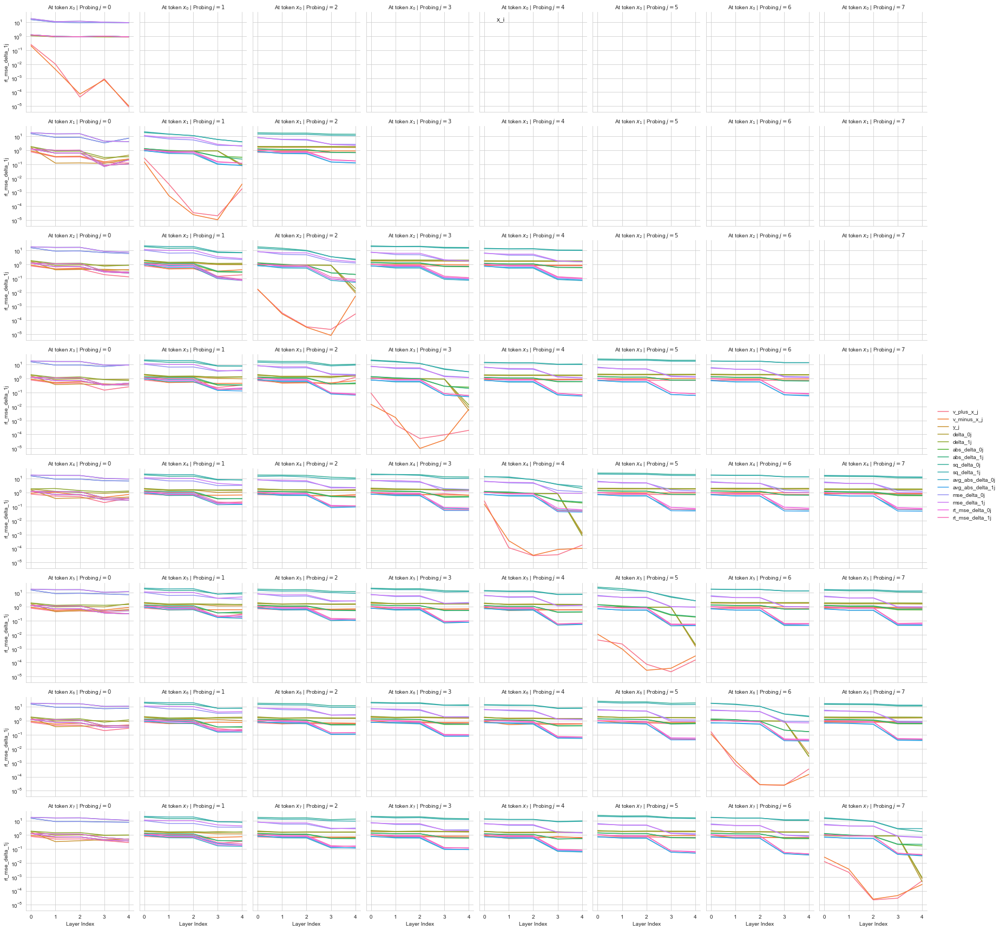

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.venv/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight

/Users/Jesse/Projects/icl/.

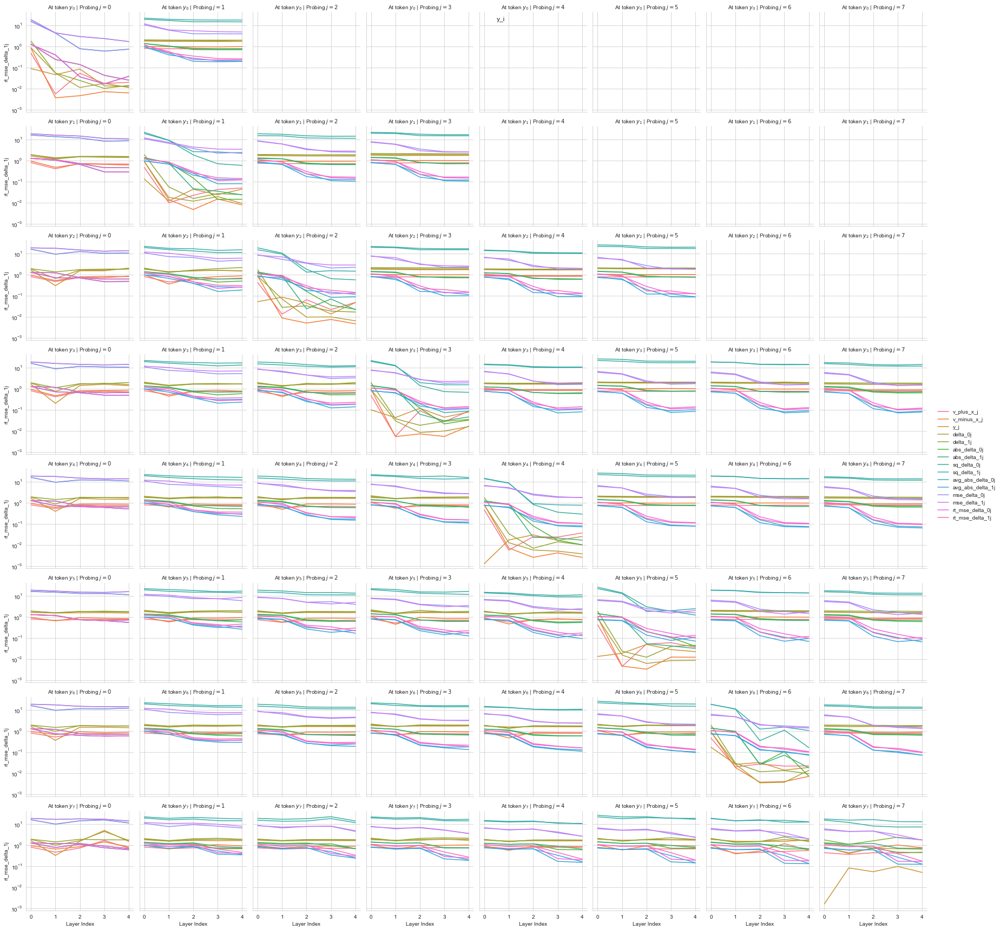

In [961]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

x_probes_normalized_df = probes_normalized_df[probes_normalized_df["token"] % 2 == 0]
y_probes_normalized_df = probes_normalized_df[probes_normalized_df["token"] % 2 == 1]

# Create a FacetGrid
g = sns.FacetGrid(x_probes_normalized_df, row="i", col="j", margin_titles=False, row_order=range(8), col_order=range(8)) #, sharey=False, sharex=False)


# Map line plots onto the FacetGrid
palette = sns.color_palette("husl", len(metrics))  
for i, metric in enumerate(metrics):
    g.map_dataframe(sns.lineplot, x="layer_idx", y=metric, label=metric, color=palette[i])

# Add legend and titles
g.set_axis_labels("Layer Index")
g.set_titles(col_template="Probing $j={col_name}$", row_template="At token $x_{row_name}$")
g.set(xticks=probes_normalized_df.layer_idx.unique())
g.tight_layout()
g.add_legend()  
g.fig.set_facecolor('white')
g.fig.suptitle("x_i")
g.set(yscale="log")

plt.savefig("../figures/M2L2H4_x_probes_normalized@t_final.png",)
plt.show()

# Create a FacetGrid
g = sns.FacetGrid(y_probes_normalized_df, row="i", col="j", margin_titles=False, row_order=range(8), col_order=range(8)) #, sharey=False, sharex=False)

# Map line plots onto the FacetGrid
for i, metric in enumerate(metrics):
    g.map_dataframe(sns.lineplot, x="layer_idx", y=metric, label=metric, color=palette[i])

# Add legend and titles
g.set_axis_labels("Layer Index")
g.set_titles(col_template="Probing $j={col_name}$", row_template="At token $y_{row_name}$")
g.set(xticks=probes_normalized_df.layer_idx.unique())
g.tight_layout()
g.add_legend()
g.fig.set_facecolor('white')
g.fig.suptitle("y_i")
g.set(yscale="log")

plt.savefig("../figures/M2L2H4_y_probes_normalized@t_final.png")
plt.show()


In [962]:
def probe_resid_stream(activations):
    probes_normalized = defaultdict(dict)

    # print(delta_0s[0])
    # print(avg_abs_delta_0s[0])

    def train_probe(activations: TensorType["B", "E"], target: TensorType["B"]):
        assert activations.shape[0] == target.shape[0] and len(activations.shape) == 2 and len(target.shape) == 1, f"Activations shape {activations.shape} and target shape {target.shape} are not compatible"
        X = torch.cat([activations, torch.ones(activations.shape[0], 1, device=DEVICE, dtype=torch.float32)], dim=1)

        # Calculate the pseudo-inverse of X
        X_pseudo_inv = torch.pinverse((X.t().mm(X)).to("cpu")).to(DEVICE).mm(X.t())

        # Calculate optimal weights
        w_optimal = X_pseudo_inv.mm(target.unsqueeze(1))

        # Extract the learned weights and bias
        learned_weights = w_optimal[:-1, :]
        learned_bias = w_optimal[-1, :]
        
        loss = nn.MSELoss()(activations.mm(learned_weights) + learned_bias, target.unsqueeze(1))

        return {"probe": w_optimal, "loss": loss.item()}


    for layer in tqdm(resid_stream_layers, desc=f"Iterating over layers"):
        print("=" * 20 + f" Layer {layer} " + "=" * 20)
        activation = activations[layer].detach()

        layer_probes_normalized = []

        for i in tqdm(range(2 * 8), desc=f"Layer {layer}"):
            # Train a separate linear probe for each token position, both xs and ys
            local_activation = activation[:, i, :]
            i_probes_normalized = []

            for j in tqdm(range(min(i+1, 8)), desc=f"Token position {i}"):
                ij_probes_normalized = {}

                # Some of these combinations won't make sense (e.g., trying to predict y_1 from x_1). I'm too lazy to customize this. 
                ij_probes_normalized["v_plus_x_j"] = train_probe(local_activation, v_plus_x_ks[:, j])
                ij_probes_normalized["v_minus_x_j"] = train_probe(local_activation, v_minus_x_ks[:, j])
                ij_probes_normalized["y_j"] = train_probe(local_activation, train_ys[:, j].squeeze(-1))
                ij_probes_normalized["delta_0j"] = train_probe(local_activation, delta_0s[:, j])
                ij_probes_normalized["delta_1j"] = train_probe(local_activation, delta_1s[:, j])
                ij_probes_normalized["abs_delta_0j"] = train_probe(local_activation, abs_delta_0s[:, j])
                ij_probes_normalized["abs_delta_1j"] = train_probe(local_activation, abs_delta_1s[:, j])
                ij_probes_normalized["avg_abs_delta_0j"] = train_probe(local_activation, avg_abs_delta_0s[:, j])

                i_probes_normalized.append(ij_probes_normalized)

                print(yaml.dump({('x' if i % 2 == 0 else 'y') + str(i//2) + ":" + k[:-1] + str(j): v["loss"] for k, v in ij_probes_normalized.items()}))
            layer_probes_normalized.append(i_probes_normalized)
        probes_normalized[layer] = layer_probes_normalized

    probes_normalized_flattened = [{"layer": name, "layer_idx": l, "token": i, "i": i // 2, "j": j, **{k: v["loss"] for k, v in pij.items()}} for l, (name, p) in enumerate(probes_normalized.items()) for i, pi in enumerate(p) for j, pij in enumerate(pi)]
    probes_normalized_df = pd.DataFrame(probes_normalized_flattened)
    probes_normalized_df

    return probes_normalized_df


In [934]:
probes_over_time = [
    probe_resid_stream(activations) for activations in tqdm(normalized_activations_over_time, desc="Probing over time")
]


Probing over time:   0%|          | 0/96 [00:00<?, ?it/s]

==================== Layer token_sequence_transformer.token_embedding ====================





Token position 0: 100%|██████████| 1/1 [00:00<00:00, 12.79it/s]


x0:abs_delta_00: 1.076561450958252
x0:abs_delta_10: 1.1321091651916504
x0:avg_abs_delta_00: 1.076561450958252
x0:delta_00: 1.237276554107666
x0:delta_10: 1.255040168762207
x0:v_minus_x_0: 0.1968073844909668
x0:v_plus_x_0: 0.004189602565020323
x0:y_0: 1.0535677671432495





Token position 1: 100%|██████████| 2/2 [00:00<00:00, 46.75it/s]



y0:abs_delta_00: 1.06394624710083
y0:abs_delta_10: 1.130798578262329
y0:avg_abs_delta_00: 1.06394624710083
y0:delta_00: 0.9135915040969849
y0:delta_10: 1.8342161178588867
y0:v_minus_x_0: 0.842812716960907
y0:v_plus_x_0: 0.5017983913421631
y0:y_0: 0.1581287384033203

y0:abs_delta_01: 1.2264407873153687
y0:abs_delta_11: 1.2316946983337402
y0:avg_abs_delta_01: 0.7994887828826904
y0:delta_01: 2.063877582550049
y0:delta_11: 2.132620334625244
y0:v_minus_x_1: 0.9859774112701416
y0:v_plus_x_1: 0.7971993684768677
y0:y_1: 1.9023276567459106





Token position 2: 100%|██████████| 3/3 [00:00<00:00, 48.90it/s]


x1:abs_delta_00: 1.0737688541412354
x1:abs_delta_10: 1.1270478963851929
x1:avg_abs_delta_00: 1.0737688541412354
x1:delta_00: 1.9423606395721436
x1:delta_10: 2.0007388591766357
x1:v_minus_x_0: 0.9274808168411255
x1:v_plus_x_0: 0.7862218618392944
x1:y_0: 1.7463343143463135

x1:abs_delta_01: 1.2133572101593018
x1:abs_delta_11: 1.2194552421569824
x1:avg_abs_delta_01: 0.7974567413330078
x1:delta_01: 1.2421939373016357
x1:delta_11: 1.1911308765411377
x1:v_minus_x_1: 0.10263949632644653
x1:v_plus_x_1: 0.07174399495124817
x1:y_1: 1.1865644454956055

x1:abs_delta_02: 1.1331433057785034
x1:abs_delta_12: 1.0971994400024414
x1:avg_abs_delta_02: 0.6815736293792725
x1:delta_02: 2.0040359497070312
x1:delta_12: 1.9675168991088867
x1:v_minus_x_2: 0.9383649230003357
x1:v_plus_x_2: 0.7264852523803711
x1:y_2: 1.8033385276794434





Token position 3: 100%|██████████| 4/4 [00:00<00:00, 54.06it/s]



y1:abs_delta_00: 1.0833494663238525
y1:abs_delta_10: 1.1283175945281982
y1:avg_abs_delta_00: 1.0833494663238525
y1:delta_00: 1.9447567462921143
y1:delta_10: 2.0176405906677246
y1:v_minus_x_0: 0.928498387336731
y1:v_plus_x_0: 0.7917050123214722
y1:y_0: 1.7479802370071411

y1:abs_delta_01: 1.223036527633667
y1:abs_delta_11: 1.2261097431182861
y1:avg_abs_delta_01: 0.8065900802612305
y1:delta_01: 1.2381470203399658
y1:delta_11: 1.9736852645874023
y1:v_minus_x_1: 0.9213677048683167
y1:v_plus_x_1: 0.5714238882064819
y1:y_1: 0.6271048784255981

y1:abs_delta_02: 1.1441729068756104
y1:abs_delta_12: 1.09588623046875
y1:avg_abs_delta_02: 0.6911339163780212
y1:delta_02: 2.0078094005584717
y1:delta_12: 1.9753704071044922
y1:v_minus_x_2: 0.9447139501571655
y1:v_plus_x_2: 0.7298992872238159
y1:y_2: 1.809504508972168

y1:abs_delta_03: 1.1927870512008667
y1:abs_delta_13: 1.240018367767334
y1:avg_abs_delta_03: 0.6313057541847229
y1:delta_03: 2.0758936405181885
y1:delta_13: 2.2357356548309326
y1:v_minus_

x2:abs_delta_00: 1.0833230018615723
x2:abs_delta_10: 1.133264183998108
x2:avg_abs_delta_00: 1.0833230018615723
x2:delta_00: 1.9394550323486328
x2:delta_10: 2.0128743648529053
x2:v_minus_x_0: 0.9272922873497009
x2:v_plus_x_0: 0.7891330718994141
x2:y_0: 1.7444936037063599

x2:abs_delta_01: 1.2298959493637085
x2:abs_delta_11: 1.230789065361023
x2:avg_abs_delta_01: 0.8098028898239136
x2:delta_01: 2.0581068992614746
x2:delta_11: 2.1274447441101074
x2:v_minus_x_1: 0.9804077744483948
x2:v_plus_x_1: 0.7949256896972656
x2:y_1: 1.900329828262329

x2:abs_delta_02: 1.1451683044433594
x2:abs_delta_12: 1.0921094417572021
x2:avg_abs_delta_02: 0.6938449144363403
x2:delta_02: 1.1164381504058838
x2:delta_12: 1.1117029190063477
x2:v_minus_x_2: 0.0680685043334961
x2:v_plus_x_2: 0.08216981589794159
x2:y_2: 1.1394622325897217





Token position 4: 100%|██████████| 5/5 [00:00<00:00, 46.48it/s]


x2:abs_delta_03: 1.1931157112121582
x2:abs_delta_13: 1.2412049770355225
x2:avg_abs_delta_03: 0.6334750652313232
x2:delta_03: 2.069638729095459
x2:delta_13: 2.2334558963775635
x2:v_minus_x_3: 1.0165815353393555
x2:v_plus_x_3: 0.7908598184585571
x2:y_3: 1.8645116090774536

x2:abs_delta_04: 1.1091150045394897
x2:abs_delta_14: 1.1208099126815796
x2:avg_abs_delta_04: 0.5958651304244995
x2:delta_04: 1.9445912837982178
x2:delta_14: 2.0211353302001953
x2:v_minus_x_4: 0.9098675847053528
x2:v_plus_x_4: 0.8476839065551758
x2:y_4: 1.8713582754135132



y2:abs_delta_00: 1.0829821825027466
y2:abs_delta_10: 1.1330695152282715
y2:avg_abs_delta_00: 1.0829821825027466
y2:delta_00: 1.944056749343872
y2:delta_10: 2.017857313156128
y2:v_minus_x_0: 0.9284868240356445
y2:v_plus_x_0: 0.7915615439414978
y2:y_0: 1.7468785047531128



y2:abs_delta_01: 1.2288134098052979
y2:abs_delta_11: 1.2316908836364746
y2:avg_abs_delta_01: 0.8086899518966675
y2:delta_01: 2.063779354095459
y2:delta_11: 2.1292099952697754
y2:v_minus_x_1: 0.9859588146209717
y2:v_plus_x_1: 0.7971892952919006
y2:y_1: 1.9009921550750732

y2:abs_delta_02: 1.1424415111541748
y2:abs_delta_12: 1.094107985496521
y2:avg_abs_delta_02: 0.6921789646148682
y2:delta_02: 0.8727843761444092
y2:delta_12: 1.7488094568252563
y2:v_minus_x_2: 0.8579745292663574
y2:v_plus_x_2: 0.43441933393478394
y2:y_2: 0.08094259351491928

y2:abs_delta_03: 1.1899865865707397
y2:abs_delta_13: 1.2434463500976562
y2:avg_abs_delta_03: 0.6313546895980835
y2:delta_03: 2.0782151222229004
y2:delta_13: 2.2348415851593018
y2:v_minus_x_3: 1.0203166007995605
y2:v_plus_x_3: 0.7914717793464661
y2:y_3: 1.8672336339950562

y2:abs_delta_04: 1.1083794832229614
y2:abs_delta_14: 1.120269536972046
y2:avg_abs_delta_04: 0.5931030511856079
y2:delta_04: 1.9583113193511963
y2:delta_14: 2.024001121520996
y2:v_mi

Token position 5: 100%|██████████| 6/6 [00:00<00:00, 47.49it/s]



y2:abs_delta_05: 1.2668298482894897
y2:abs_delta_15: 1.256239652633667
y2:avg_abs_delta_05: 0.5794504880905151
y2:delta_05: 2.159407615661621
y2:delta_15: 2.1968371868133545
y2:v_minus_x_5: 1.0236518383026123
y2:v_plus_x_5: 0.773373544216156
y2:y_5: 2.0440573692321777



x3:abs_delta_00: 1.0841622352600098
x3:abs_delta_10: 1.131673812866211
x3:avg_abs_delta_00: 1.0841622352600098
x3:delta_00: 1.9381275177001953
x3:delta_10: 2.0137815475463867
x3:v_minus_x_0: 0.9287554025650024
x3:v_plus_x_0: 0.790228545665741
x3:y_0: 1.7376445531845093

x3:abs_delta_01: 1.2257499694824219
x3:abs_delta_11: 1.2327839136123657
x3:avg_abs_delta_01: 0.8078832626342773
x3:delta_01: 2.0637898445129395
x3:delta_11: 2.1278276443481445
x3:v_minus_x_1: 0.9862222671508789
x3:v_plus_x_1: 0.7936309576034546
x3:y_1: 1.8980203866958618

x3:abs_delta_02: 1.1407549381256104
x3:abs_delta_12: 1.0945676565170288
x3:avg_abs_delta_02: 0.6914608478546143
x3:delta_02: 2.009824275970459
x3:delta_12: 1.965658187866211
x3:v_minus_x_2: 0.9424165487289429
x3:v_plus_x_2: 0.7269662618637085
x3:y_2: 1.8066452741622925

x3:abs_delta_03: 1.1902904510498047
x3:abs_delta_13: 1.2408876419067383
x3:avg_abs_delta_03: 0.6319164037704468
x3:delta_03: 1.3167802095413208
x3:delta_13: 1.3103373050689697
x3:v_minu

x3:abs_delta_05: 1.2681307792663574
x3:abs_delta_15: 1.2565181255340576
x3:avg_abs_delta_05: 0.5802769660949707
x3:delta_05: 2.153768539428711
x3:delta_15: 2.197066307067871
x3:v_minus_x_5: 1.0230257511138916
x3:v_plus_x_5: 0.7740427851676941
x3:y_5: 2.0416784286499023



Token position 6: 100%|██████████| 7/7 [00:00<00:00, 42.82it/s]


x3:abs_delta_06: 1.2729613780975342
x3:abs_delta_16: 1.2043384313583374
x3:avg_abs_delta_06: 0.566562294960022
x3:delta_06: 2.175917148590088
x3:delta_16: 2.134265422821045
x3:v_minus_x_6: 1.009737253189087
x3:v_plus_x_6: 0.7799290418624878
x3:y_6: 2.0270729064941406



y3:abs_delta_00: 1.0836050510406494
y3:abs_delta_10: 1.1311218738555908
y3:avg_abs_delta_00: 1.0836050510406494
y3:delta_00: 1.9457505941390991
y3:delta_10: 2.016796350479126
y3:v_minus_x_0: 0.9290432333946228
y3:v_plus_x_0: 0.7915024757385254
y3:y_0: 1.7475733757019043

y3:abs_delta_01: 1.229550838470459
y3:abs_delta_11: 1.2299859523773193
y3:avg_abs_delta_01: 0.8090857863426208
y3:delta_01: 2.061603546142578
y3:delta_11: 2.1329779624938965
y3:v_minus_x_1: 0.985592246055603
y3:v_plus_x_1: 0.7957166433334351
y3:y_1: 1.8983955383300781



y3:abs_delta_02: 1.1423392295837402
y3:abs_delta_12: 1.0963921546936035
y3:avg_abs_delta_02: 0.6921671628952026
y3:delta_02: 2.0106329917907715
y3:delta_12: 1.9739758968353271
y3:v_minus_x_2: 0.9443058967590332
y3:v_plus_x_2: 0.729531466960907
y3:y_2: 1.810744047164917

y3:abs_delta_03: 1.1877214908599854
y3:abs_delta_13: 1.2437829971313477
y3:avg_abs_delta_03: 0.6309521198272705
y3:delta_03: 1.3451898097991943
y3:delta_13: 2.0863068103790283
y3:v_minus_x_3: 0.9664826989173889
y3:v_plus_x_3: 0.6119368672370911
y3:y_3: 0.773510217666626

y3:abs_delta_04: 1.10982346534729
y3:abs_delta_14: 1.1215875148773193
y3:avg_abs_delta_04: 0.5926145315170288
y3:delta_04: 1.9585869312286377
y3:delta_14: 2.0242695808410645
y3:v_minus_x_4: 0.9117780923843384
y3:v_plus_x_4: 0.8487409353256226
y3:y_4: 1.877649188041687

y3:abs_delta_05: 1.2698614597320557
y3:abs_delta_15: 1.257184386253357
y3:avg_abs_delta_05: 0.5792891383171082
y3:delta_05: 2.1595358848571777
y3:delta_15: 2.197042942047119
y3:v_minus_x_



Token position 7: 100%|██████████| 8/8 [00:00<00:00, 38.86it/s]



y3:abs_delta_07: 1.092383861541748
y3:abs_delta_17: 1.1796594858169556
y3:avg_abs_delta_07: 0.5504931211471558
y3:delta_07: 1.84931218624115
y3:delta_17: 2.0760695934295654
y3:v_minus_x_7: 0.9037628173828125
y3:v_plus_x_7: 0.8034352660179138
y3:y_7: 1.822290062904358



x4:abs_delta_00: 1.0818207263946533
x4:abs_delta_10: 1.1319175958633423
x4:avg_abs_delta_00: 1.0818207263946533
x4:delta_00: 1.9425462484359741
x4:delta_10: 2.0081140995025635
x4:v_minus_x_0: 0.9282422065734863
x4:v_plus_x_0: 0.7901791930198669
x4:y_0: 1.7383486032485962

x4:abs_delta_01: 1.2285689115524292
x4:abs_delta_11: 1.2309019565582275
x4:avg_abs_delta_01: 0.8089038133621216
x4:delta_01: 2.0539684295654297
x4:delta_11: 2.1317644119262695
x4:v_minus_x_1: 0.9847654104232788
x4:v_plus_x_1: 0.7972373962402344
x4:y_1: 1.8975505828857422

x4:abs_delta_02: 1.1455786228179932
x4:abs_delta_12: 1.0908076763153076
x4:avg_abs_delta_02: 0.6930273771286011
x4:delta_02: 2.006640911102295
x4:delta_12: 1.9663114547729492
x4:v_minus_x_2: 0.9413560032844543
x4:v_plus_x_2: 0.7274514436721802
x4:y_2: 1.8096325397491455

x4:abs_delta_03: 1.1920735836029053
x4:abs_delta_13: 1.2385218143463135
x4:avg_abs_delta_03: 0.6329092979431152
x4:delta_03: 2.0772922039031982
x4:delta_13: 2.2311525344848633
x4:v_m

x4:abs_delta_04: 1.1067646741867065
x4:abs_delta_14: 1.1200610399246216
x4:avg_abs_delta_04: 0.594316303730011
x4:delta_04: 1.1357841491699219
x4:delta_14: 1.1476951837539673
x4:v_minus_x_4: 0.06199473887681961
x4:v_plus_x_4: 0.09186100959777832
x4:y_4: 1.1588380336761475

x4:abs_delta_05: 1.265141487121582
x4:abs_delta_15: 1.2549540996551514
x4:avg_abs_delta_05: 0.5803130269050598
x4:delta_05: 2.141031265258789
x4:delta_15: 2.182109832763672
x4:v_minus_x_5: 1.015192985534668
x4:v_plus_x_5: 0.7738147974014282
x4:y_5: 2.033925771713257

x4:abs_delta_06: 1.2724261283874512
x4:abs_delta_16: 1.2003988027572632
x4:avg_abs_delta_06: 0.5667251348495483
x4:delta_06: 2.174013137817383
x4:delta_16: 2.1451940536499023
x4:v_minus_x_6: 1.0104824304580688
x4:v_plus_x_6: 0.7815425992012024
x4:y_6: 2.0283215045928955



Token position 8: 100%|██████████| 8/8 [00:00<00:00, 48.55it/s]



x4:abs_delta_07: 1.0858573913574219
x4:abs_delta_17: 1.1779483556747437
x4:avg_abs_delta_07: 0.5511258840560913
x4:delta_07: 1.8483569622039795
x4:delta_17: 2.0759265422821045
x4:v_minus_x_7: 0.9028757810592651
x4:v_plus_x_7: 0.8019275665283203
x4:y_7: 1.8201671838760376



y4:abs_delta_00: 1.0823640823364258
y4:abs_delta_10: 1.132743000984192
y4:avg_abs_delta_00: 1.0823640823364258
y4:delta_00: 1.9459302425384521
y4:delta_10: 2.017848014831543
y4:v_minus_x_0: 0.929121732711792
y4:v_plus_x_0: 0.7893921732902527
y4:y_0: 1.7448768615722656

y4:abs_delta_01: 1.2295362949371338
y4:abs_delta_11: 1.2316292524337769
y4:avg_abs_delta_01: 0.8086402416229248
y4:delta_01: 2.0640745162963867
y4:delta_11: 2.1325244903564453
y4:v_minus_x_1: 0.9865160584449768
y4:v_plus_x_1: 0.7971857786178589
y4:y_1: 1.901589274406433

y4:abs_delta_02: 1.1431684494018555
y4:abs_delta_12: 1.0947253704071045
y4:avg_abs_delta_02: 0.6919734477996826
y4:delta_02: 2.0105788707733154
y4:delta_12: 1.974982738494873
y4:v_minus_x_2: 0.9446405172348022
y4:v_plus_x_2: 0.729820728302002
y4:y_2: 1.8105223178863525

y4:abs_delta_03: 1.1917376518249512
y4:abs_delta_13: 1.243762493133545
y4:avg_abs_delta_03: 0.6312851905822754
y4:delta_03: 2.0767080783843994
y4:delta_13: 2.2338242530822754
y4:v_minus_x

y4:abs_delta_04: 1.1021127700805664
y4:abs_delta_14: 1.1217848062515259
y4:avg_abs_delta_04: 0.5923474431037903
y4:delta_04: 1.080348014831543
y4:delta_14: 1.86952805519104
y4:v_minus_x_4: 0.8379982709884644
y4:v_plus_x_4: 0.5796972513198853
y4:y_4: 0.47554802894592285

y4:abs_delta_05: 1.2670055627822876
y4:abs_delta_15: 1.2566726207733154
y4:avg_abs_delta_05: 0.5785901546478271
y4:delta_05: 2.137976884841919
y4:delta_15: 2.196678638458252
y4:v_minus_x_5: 1.0169882774353027
y4:v_plus_x_5: 0.7734249830245972
y4:y_5: 2.0357422828674316

y4:abs_delta_06: 1.2727898359298706
y4:abs_delta_16: 1.2060788869857788
y4:avg_abs_delta_06: 0.5649487972259521
y4:delta_06: 2.17638897895813
y4:delta_16: 2.1446480751037598
y4:v_minus_x_6: 1.0115526914596558
y4:v_plus_x_6: 0.782971978187561
y4:y_6: 2.0293898582458496



Token position 9: 100%|██████████| 8/8 [00:00<00:00, 51.62it/s]



y4:abs_delta_07: 1.0841162204742432
y4:abs_delta_17: 1.1815212965011597
y4:avg_abs_delta_07: 0.5489664673805237
y4:delta_07: 1.848074197769165
y4:delta_17: 2.075167179107666
y4:v_minus_x_7: 0.9027277231216431
y4:v_plus_x_7: 0.8015166521072388
y4:y_7: 1.8196370601654053



x5:abs_delta_00: 1.0821847915649414
x5:abs_delta_10: 1.1296722888946533
x5:avg_abs_delta_00: 1.0821847915649414
x5:delta_00: 1.941224217414856
x5:delta_10: 2.019458770751953
x5:v_minus_x_0: 0.9289566278457642
x5:v_plus_x_0: 0.7914797067642212
x5:y_0: 1.7465558052062988

x5:abs_delta_01: 1.2268052101135254
x5:abs_delta_11: 1.2333353757858276
x5:avg_abs_delta_01: 0.807732343673706
x5:delta_01: 2.0564332008361816
x5:delta_11: 2.131904363632202
x5:v_minus_x_1: 0.9828692078590393
x5:v_plus_x_1: 0.793300211429596
x5:y_1: 1.895536184310913

x5:abs_delta_02: 1.1366817951202393
x5:abs_delta_12: 1.0959324836730957
x5:avg_abs_delta_02: 0.689805269241333
x5:delta_02: 2.0044631958007812
x5:delta_12: 1.9718858003616333
x5:v_minus_x_2: 0.9448177814483643
x5:v_plus_x_2: 0.7290318608283997
x5:y_2: 1.80415940284729

x5:abs_delta_03: 1.1867151260375977
x5:abs_delta_13: 1.2423112392425537
x5:avg_abs_delta_03: 0.6289812326431274
x5:delta_03: 2.0696699619293213
x5:delta_13: 2.2359025478363037
x5:v_minus_x_3

x5:abs_delta_04: 1.1092642545700073
x5:abs_delta_14: 1.1142280101776123
x5:avg_abs_delta_04: 0.5911391377449036
x5:delta_04: 1.947906494140625
x5:delta_14: 2.0192599296569824
x5:v_minus_x_4: 0.9083082675933838
x5:v_plus_x_4: 0.8444970846176147
x5:y_4: 1.865502119064331

x5:abs_delta_05: 1.2697687149047852
x5:abs_delta_15: 1.2571158409118652
x5:avg_abs_delta_05: 0.5780974626541138
x5:delta_05: 1.466928482055664
x5:delta_15: 1.483583688735962
x5:v_minus_x_5: 0.3290420174598694
x5:v_plus_x_5: 0.012469056062400341
x5:y_5: 1.1621603965759277



Token position 10: 100%|██████████| 8/8 [00:00<00:00, 49.64it/s]



x5:abs_delta_06: 1.2718325853347778
x5:abs_delta_16: 1.2057685852050781
x5:avg_abs_delta_06: 0.5644917488098145
x5:delta_06: 2.1707611083984375
x5:delta_16: 2.1427855491638184
x5:v_minus_x_6: 1.0096486806869507
x5:v_plus_x_6: 0.7783014178276062
x5:y_6: 2.0194509029388428

x5:abs_delta_07: 1.0907745361328125
x5:abs_delta_17: 1.1800312995910645
x5:avg_abs_delta_07: 0.5493617057800293
x5:delta_07: 1.8444805145263672
x5:delta_17: 2.069631576538086
x5:v_minus_x_7: 0.8982356190681458
x5:v_plus_x_7: 0.8013944625854492
x5:y_7: 1.8203222751617432



y5:abs_delta_00: 1.0829973220825195
y5:abs_delta_10: 1.1324604749679565
y5:avg_abs_delta_00: 1.0829973220825195
y5:delta_00: 1.9457544088363647
y5:delta_10: 2.017406940460205
y5:v_minus_x_0: 0.9287922382354736
y5:v_plus_x_0: 0.7906993627548218
y5:y_0: 1.746819019317627

y5:abs_delta_01: 1.2283796072006226
y5:abs_delta_11: 1.2306290864944458
y5:avg_abs_delta_01: 0.8084567785263062
y5:delta_01: 2.0581846237182617
y5:delta_11: 2.1329236030578613
y5:v_minus_x_1: 0.985004186630249
y5:v_plus_x_1: 0.7972020506858826
y5:y_1: 1.9015920162200928

y5:abs_delta_02: 1.1430885791778564
y5:abs_delta_12: 1.096205472946167
y5:avg_abs_delta_02: 0.6917983293533325
y5:delta_02: 2.008340358734131
y5:delta_12: 1.9754743576049805
y5:v_minus_x_2: 0.9448049068450928
y5:v_plus_x_2: 0.7298933267593384
y5:y_2: 1.809455394744873

y5:abs_delta_03: 1.190176248550415
y5:abs_delta_13: 1.2436230182647705
y5:avg_abs_delta_03: 0.6308698654174805
y5:delta_03: 2.0793111324310303
y5:delta_13: 2.235409736633301
y5:v_minus_x_

y5:abs_delta_04: 1.1101018190383911
y5:abs_delta_14: 1.121067762374878
y5:avg_abs_delta_04: 0.5926568508148193
y5:delta_04: 1.9415206909179688
y5:delta_14: 2.0236945152282715
y5:v_minus_x_4: 0.9089794158935547
y5:v_plus_x_4: 0.8476559519767761
y5:y_4: 1.8654062747955322

y5:abs_delta_05: 1.2676459550857544
y5:abs_delta_15: 1.257558822631836
y5:avg_abs_delta_05: 0.5789298415184021
y5:delta_05: 0.8634136915206909
y5:delta_15: 1.891179084777832
y5:v_minus_x_5: 0.938343346118927
y5:v_plus_x_5: 0.43674132227897644
y5:y_5: 0.008700894191861153



Token position 11: 100%|██████████| 8/8 [00:00<00:00, 47.18it/s]



y5:abs_delta_06: 1.2722885608673096
y5:abs_delta_16: 1.2049208879470825
y5:avg_abs_delta_06: 0.5652418732643127
y5:delta_06: 2.1659810543060303
y5:delta_16: 2.1444783210754395
y5:v_minus_x_6: 1.008170247077942
y5:v_plus_x_6: 0.7755931615829468
y5:y_6: 2.0125808715820312

y5:abs_delta_07: 1.0924534797668457
y5:abs_delta_17: 1.181915521621704
y5:avg_abs_delta_07: 0.5499087572097778
y5:delta_07: 1.8405187129974365
y5:delta_17: 2.0754172801971436
y5:v_minus_x_7: 0.9002963304519653
y5:v_plus_x_7: 0.8014670610427856
y5:y_7: 1.815403938293457



x6:abs_delta_00: 1.0811222791671753
x6:abs_delta_10: 1.131212592124939
x6:avg_abs_delta_00: 1.0811222791671753
x6:delta_00: 1.9422969818115234
x6:delta_10: 2.0174436569213867
x6:v_minus_x_0: 0.9275294542312622
x6:v_plus_x_0: 0.7903326153755188
x6:y_0: 1.7443203926086426

x6:abs_delta_01: 1.2267309427261353
x6:abs_delta_11: 1.2296817302703857
x6:avg_abs_delta_01: 0.8076963424682617
x6:delta_01: 2.054619789123535
x6:delta_11: 2.126499652862549
x6:v_minus_x_1: 0.9852787256240845
x6:v_plus_x_1: 0.79616379737854
x6:y_1: 1.8925395011901855

x6:abs_delta_02: 1.1423320770263672
x6:abs_delta_12: 1.0965321063995361
x6:avg_abs_delta_02: 0.6911048889160156
x6:delta_02: 2.0053932666778564
x6:delta_12: 1.9687871932983398
x6:v_minus_x_2: 0.9420627951622009
x6:v_plus_x_2: 0.7285456657409668
x6:y_2: 1.8042134046554565

x6:abs_delta_03: 1.1846998929977417
x6:abs_delta_13: 1.2407593727111816
x6:avg_abs_delta_03: 0.6297260522842407
x6:delta_03: 2.075493335723877
x6:delta_13: 2.21748423576355
x6:v_minus_x_

x6:abs_delta_05: 1.2649654150009155
x6:abs_delta_15: 1.2499537467956543
x6:avg_abs_delta_05: 0.5779024958610535
x6:delta_05: 2.1441056728363037
x6:delta_15: 2.196587085723877
x6:v_minus_x_5: 1.0208357572555542
x6:v_plus_x_5: 0.7685072422027588
x6:y_5: 2.0258941650390625

x6:abs_delta_06: 1.268265724182129
x6:abs_delta_16: 1.1998947858810425
x6:avg_abs_delta_06: 0.5642879009246826
x6:delta_06: 1.2059794664382935
x6:delta_16: 1.2105696201324463
x6:v_minus_x_6: 0.0646907314658165
x6:v_plus_x_6: 0.06965480744838715
x6:y_6: 1.208756446838379



Token position 12: 100%|██████████| 8/8 [00:00<00:00, 52.03it/s]



x6:abs_delta_07: 1.0907506942749023
x6:abs_delta_17: 1.1794922351837158
x6:avg_abs_delta_07: 0.5488595962524414
x6:delta_07: 1.8428875207901
x6:delta_17: 2.07476806640625
x6:v_minus_x_7: 0.9015393853187561
x6:v_plus_x_7: 0.7993003129959106
x6:y_7: 1.811268925666809



y6:abs_delta_00: 1.0830714702606201
y6:abs_delta_10: 1.133079171180725
y6:avg_abs_delta_00: 1.0830714702606201
y6:delta_00: 1.9401177167892456
y6:delta_10: 2.017444133758545
y6:v_minus_x_0: 0.9283427000045776
y6:v_plus_x_0: 0.7913651466369629
y6:y_0: 1.7431403398513794

y6:abs_delta_01: 1.2307853698730469
y6:abs_delta_11: 1.2315754890441895
y6:avg_abs_delta_01: 0.8094642162322998
y6:delta_01: 2.054630756378174
y6:delta_11: 2.132668972015381
y6:v_minus_x_1: 0.9830116033554077
y6:v_plus_x_1: 0.7963409423828125
y6:y_1: 1.8974324464797974

y6:abs_delta_02: 1.1428639888763428
y6:abs_delta_12: 1.0950626134872437
y6:avg_abs_delta_02: 0.6924997568130493
y6:delta_02: 2.010838270187378
y6:delta_12: 1.974865436553955
y6:v_minus_x_2: 0.9448074102401733
y6:v_plus_x_2: 0.7296415567398071
y6:y_2: 1.8100707530975342

y6:abs_delta_03: 1.1891593933105469
y6:abs_delta_13: 1.2431321144104004
y6:avg_abs_delta_03: 0.6314302682876587
y6:delta_03: 2.0786960124969482
y6:delta_13: 2.2300660610198975
y6:v_minus_

y6:abs_delta_05: 1.2697099447250366
y6:abs_delta_15: 1.2572753429412842
y6:avg_abs_delta_05: 0.5795364379882812
y6:delta_05: 2.1452648639678955
y6:delta_15: 2.1969428062438965
y6:v_minus_x_5: 1.0211524963378906
y6:v_plus_x_5: 0.7710977792739868
y6:y_5: 2.029280185699463

y6:abs_delta_06: 1.2653425931930542
y6:abs_delta_16: 1.2062103748321533
y6:avg_abs_delta_06: 0.5655441284179688
y6:delta_06: 0.8497381210327148
y6:delta_16: 1.9051234722137451
y6:v_minus_x_6: 0.9019486904144287
y6:v_plus_x_6: 0.45538732409477234
y6:y_6: 0.08867530524730682



Token position 13: 100%|██████████| 8/8 [00:00<00:00, 51.91it/s]



y6:abs_delta_07: 1.091813325881958
y6:abs_delta_17: 1.1795748472213745
y6:avg_abs_delta_07: 0.5500413179397583
y6:delta_07: 1.8487416505813599
y6:delta_17: 2.075460910797119
y6:v_minus_x_7: 0.9040601253509521
y6:v_plus_x_7: 0.8032761812210083
y6:y_7: 1.8225219249725342



x7:abs_delta_00: 1.0846635103225708
x7:abs_delta_10: 1.1279491186141968
x7:avg_abs_delta_00: 1.0846635103225708
x7:delta_00: 1.9360840320587158
x7:delta_10: 2.0112552642822266
x7:v_minus_x_0: 0.9226533770561218
x7:v_plus_x_0: 0.7847192883491516
x7:y_0: 1.7345467805862427

x7:abs_delta_01: 1.2297254800796509
x7:abs_delta_11: 1.2260172367095947
x7:avg_abs_delta_01: 0.8109331130981445
x7:delta_01: 2.0549848079681396
x7:delta_11: 2.1291565895080566
x7:v_minus_x_1: 0.9828987121582031
x7:v_plus_x_1: 0.7944485545158386
x7:y_1: 1.8931543827056885

x7:abs_delta_02: 1.1343035697937012
x7:abs_delta_12: 1.09761381149292
x7:avg_abs_delta_02: 0.6921266317367554
x7:delta_02: 2.0040340423583984
x7:delta_12: 1.9677932262420654
x7:v_minus_x_2: 0.9401385188102722
x7:v_plus_x_2: 0.7294597029685974
x7:y_2: 1.8079943656921387

x7:abs_delta_03: 1.192470669746399
x7:abs_delta_13: 1.2427196502685547
x7:avg_abs_delta_03: 0.6321253180503845
x7:delta_03: 2.0760116577148438
x7:delta_13: 2.2153844833374023
x7:v_min

x7:abs_delta_04: 1.0990042686462402
x7:abs_delta_14: 1.1231043338775635
x7:avg_abs_delta_04: 0.5922533273696899
x7:delta_04: 1.9542622566223145
x7:delta_14: 2.023838758468628
x7:v_minus_x_4: 0.9107904434204102
x7:v_plus_x_4: 0.8454203009605408
x7:y_4: 1.8700129985809326

x7:abs_delta_05: 1.2674278020858765
x7:abs_delta_15: 1.2582199573516846
x7:avg_abs_delta_05: 0.5789607167243958
x7:delta_05: 2.1450412273406982
x7:delta_15: 2.18512225151062
x7:v_minus_x_5: 1.0134550333023071
x7:v_plus_x_5: 0.7654436826705933
x7:y_5: 2.035458564758301

x7:abs_delta_06: 1.2727043628692627
x7:abs_delta_16: 1.1988837718963623
x7:avg_abs_delta_06: 0.5661481618881226
x7:delta_06: 2.1764354705810547
x7:delta_16: 2.139451026916504
x7:v_minus_x_6: 1.009812831878662
x7:v_plus_x_6: 0.776766300201416
x7:y_6: 2.0260229110717773



Token position 14: 100%|██████████| 8/8 [00:00<00:00, 36.21it/s]

x7:abs_delta_07: 1.0891636610031128
x7:abs_delta_17: 1.1818132400512695
x7:avg_abs_delta_07: 0.5508104562759399
x7:delta_07: 1.1290006637573242
x7:delta_17: 1.1606910228729248
x7:v_minus_x_7: 0.09084810316562653
x7:v_plus_x_7: 0.036128971725702286
x7:y_7: 1.0795667171478271



y7:abs_delta_00: 1.0782670974731445
y7:abs_delta_10: 1.1270062923431396
y7:avg_abs_delta_00: 1.0782670974731445
y7:delta_00: 1.9456696510314941
y7:delta_10: 2.017625331878662
y7:v_minus_x_0: 0.9291111826896667
y7:v_plus_x_0: 0.7915533185005188
y7:y_0: 1.7476487159729004

y7:abs_delta_01: 1.2293258905410767
y7:abs_delta_11: 1.230232834815979
y7:avg_abs_delta_01: 0.8066816329956055
y7:delta_01: 2.0627856254577637
y7:delta_11: 2.1329548358917236
y7:v_minus_x_1: 0.986035168170929
y7:v_plus_x_1: 0.797217845916748
y7:y_1: 1.9020607471466064

y7:abs_delta_02: 1.1427884101867676
y7:abs_delta_12: 1.0942845344543457
y7:avg_abs_delta_02: 0.6905980110168457
y7:delta_02: 2.009650230407715
y7:delta_12: 1.9748281240463257
y7:v_minus_x_2: 0.9450654983520508
y7:v_plus_x_2: 0.7293754816055298
y7:y_2: 1.8106467723846436

y7:abs_delta_03: 1.1920709609985352
y7:abs_delta_13: 1.2387253046035767
y7:avg_abs_delta_03: 0.6304644346237183
y7:delta_03: 2.077256202697754
y7:delta_13: 2.231865406036377
y7:v_minus_x

y7:abs_delta_04: 1.105486512184143
y7:abs_delta_14: 1.1163508892059326
y7:avg_abs_delta_04: 0.5915367007255554
y7:delta_04: 1.955532193183899
y7:delta_14: 2.0236635208129883
y7:v_minus_x_4: 0.9116050004959106
y7:v_plus_x_4: 0.8485990166664124
y7:y_4: 1.8748654127120972

y7:abs_delta_05: 1.267862319946289
y7:abs_delta_15: 1.2568585872650146
y7:avg_abs_delta_05: 0.5779591798782349
y7:delta_05: 2.1529059410095215
y7:delta_15: 2.1963257789611816
y7:v_minus_x_5: 1.0232293605804443
y7:v_plus_x_5: 0.774065375328064
y7:y_5: 2.0389797687530518



Token position 15: 100%|██████████| 8/8 [00:00<00:00, 52.49it/s]

Layer token_sequence_transformer.token_embedding: 100%|██████████| 16/16 [00:02<00:00,  7.16it/s]


y7:abs_delta_06: 1.2754818201065063
y7:abs_delta_16: 1.1930701732635498
y7:avg_abs_delta_06: 0.5651894211769104
y7:delta_06: 2.1734659671783447
y7:delta_16: 2.144064426422119
y7:v_minus_x_6: 1.0113916397094727
y7:v_plus_x_6: 0.7823090553283691
y7:y_6: 2.029283285140991

y7:abs_delta_07: 1.0825071334838867
y7:abs_delta_17: 1.1746017932891846
y7:avg_abs_delta_07: 0.5491095781326294
y7:delta_07: 0.947140634059906
y7:delta_17: 1.862015724182129
y7:v_minus_x_7: 0.8447320461273193
y7:v_plus_x_7: 0.5142447352409363
y7:y_7: 0.27367323637008667

==================== Layer token_sequence_transformer.blocks.0.resid_after_attn ====================







Token position 0: 100%|██████████| 1/1 [00:00<00:00,  2.75it/s]



x0:abs_delta_00: 1.0315561294555664
x0:abs_delta_10: 1.1055667400360107
x0:avg_abs_delta_00: 1.0315561294555664
x0:delta_00: 1.0783708095550537
x0:delta_10: 1.0834075212478638
x0:v_minus_x_0: 0.035885751247406006
x0:v_plus_x_0: 0.021314013749361038
x0:y_0: 1.063990831375122





Token position 1: 100%|██████████| 2/2 [00:00<00:00, 46.89it/s]


y0:abs_delta_00: 0.5555260181427002
y0:abs_delta_10: 0.6346670389175415
y0:avg_abs_delta_00: 0.5555260181427002
y0:delta_00: 0.14718525111675262
y0:delta_10: 0.19453993439674377
y0:v_minus_x_0: 0.09244262427091599
y0:v_plus_x_0: 0.06650446355342865
y0:y_0: 0.09146187454462051

y0:abs_delta_01: 1.164747953414917
y0:abs_delta_11: 1.1724989414215088
y0:avg_abs_delta_01: 0.579563319683075
y0:delta_01: 1.9719070196151733
y0:delta_11: 2.0702261924743652
y0:v_minus_x_1: 0.945529580116272
y0:v_plus_x_1: 0.7689361572265625
y0:y_1: 1.8449921607971191





Token position 2: 100%|██████████| 3/3 [00:00<00:00, 46.17it/s]



x1:abs_delta_00: 0.7468138337135315
x1:abs_delta_10: 1.0438991785049438
x1:avg_abs_delta_00: 0.7468138337135315
x1:delta_00: 0.4270462095737457
x1:delta_10: 0.5098363161087036
x1:v_minus_x_0: 0.16316159069538116
x1:v_plus_x_0: 0.13031424582004547
x1:y_0: 0.3270692825317383

x1:abs_delta_01: 1.0534396171569824
x1:abs_delta_11: 1.048742413520813
x1:avg_abs_delta_01: 0.6303510665893555
x1:delta_01: 1.0247607231140137
x1:delta_11: 1.0208930969238281
x1:v_minus_x_1: 0.017551349475979805
x1:v_plus_x_1: 0.0121705811470747
x1:y_1: 1.018433690071106

x1:abs_delta_02: 1.0973825454711914
x1:abs_delta_12: 1.0464632511138916
x1:avg_abs_delta_02: 0.5790665745735168
x1:delta_02: 1.9567768573760986
x1:delta_12: 1.9292160272598267
x1:v_minus_x_2: 0.9196910858154297
x1:v_plus_x_2: 0.7000242471694946
x1:y_2: 1.746018648147583





Token position 3: 100%|██████████| 4/4 [00:00<00:00, 49.57it/s]


y1:abs_delta_00: 0.6235795021057129
y1:abs_delta_10: 0.8924220204353333
y1:avg_abs_delta_00: 0.6235795021057129
y1:delta_00: 0.5449947118759155
y1:delta_10: 0.7033834457397461
y1:v_minus_x_0: 0.28102633357048035
y1:v_plus_x_0: 0.27435773611068726
y1:y_0: 0.27075642347335815

y1:abs_delta_01: 0.7195320725440979
y1:abs_delta_11: 0.8524072170257568
y1:avg_abs_delta_01: 0.43891018629074097
y1:delta_01: 0.346782922744751
y1:delta_11: 0.709722638130188
y1:v_minus_x_1: 0.288193941116333
y1:v_plus_x_1: 0.22860319912433624
y1:y_1: 0.054059505462646484

y1:abs_delta_02: 0.9831922650337219
y1:abs_delta_12: 0.9527956247329712
y1:avg_abs_delta_02: 0.42060062289237976
y1:delta_02: 1.9591141939163208
y1:delta_12: 1.9196970462799072
y1:v_minus_x_2: 0.9170401692390442
y1:v_plus_x_2: 0.7010707259178162
y1:y_2: 1.763580083847046

y1:abs_delta_03: 1.0402123928070068
y1:abs_delta_13: 1.127629280090332
y1:avg_abs_delta_03: 0.40609705448150635
y1:delta_03: 1.9854094982147217
y1:delta_13: 2.1693081855773926
y

x2:abs_delta_00: 0.7575415372848511
x2:abs_delta_10: 1.0168488025665283
x2:avg_abs_delta_00: 0.7575415372848511
x2:delta_00: 1.0147556066513062
x2:delta_10: 0.9813880920410156
x2:v_minus_x_0: 0.47294148802757263
x2:v_plus_x_0: 0.3639812171459198
x2:y_0: 0.7433951497077942

x2:abs_delta_01: 0.8161332607269287
x2:abs_delta_11: 1.0893034934997559
x2:avg_abs_delta_01: 0.5396087169647217
x2:delta_01: 1.0859239101409912
x2:delta_11: 1.1223905086517334
x2:v_minus_x_1: 0.5004283785820007
x2:v_plus_x_1: 0.36629122495651245
x2:y_1: 0.7965128421783447

x2:abs_delta_02: 0.9632110595703125
x2:abs_delta_12: 0.8821032643318176
x2:avg_abs_delta_02: 0.49588680267333984
x2:delta_02: 0.946997344493866
x2:delta_12: 0.949093222618103
x2:v_minus_x_2: 0.008964134380221367
x2:v_plus_x_2: 0.005144106224179268
x2:y_2: 0.9449553489685059



Token position 4: 100%|██████████| 5/5 [00:00<00:00, 50.25it/s]



x2:abs_delta_03: 1.0918272733688354
x2:abs_delta_13: 1.1409379243850708
x2:avg_abs_delta_03: 0.4762665629386902
x2:delta_03: 1.9803990125656128
x2:delta_13: 2.146467685699463
x2:v_minus_x_3: 0.9686022400856018
x2:v_plus_x_3: 0.7500309944152832
x2:y_3: 1.7945600748062134

x2:abs_delta_04: 0.9634042978286743
x2:abs_delta_14: 1.038496971130371
x2:avg_abs_delta_04: 0.45002925395965576
x2:delta_04: 1.8951551914215088
x2:delta_14: 1.9296622276306152
x2:v_minus_x_4: 0.8710774183273315
x2:v_plus_x_4: 0.7968544960021973
x2:y_4: 1.8156068325042725



y2:abs_delta_00: 0.662710428237915
y2:abs_delta_10: 0.9534786343574524
y2:avg_abs_delta_00: 0.662710428237915
y2:delta_00: 0.9474325776100159
y2:delta_10: 0.9711730480194092
y2:v_minus_x_0: 0.4486282467842102
y2:v_plus_x_0: 0.3621561527252197
y2:y_0: 0.5856483578681946



y2:abs_delta_01: 0.725220799446106
y2:abs_delta_11: 0.9956812262535095
y2:avg_abs_delta_01: 0.45584309101104736
y2:delta_01: 1.0755691528320312
y2:delta_11: 1.0738176107406616
y2:v_minus_x_1: 0.5153906345367432
y2:v_plus_x_1: 0.37388551235198975
y2:y_1: 0.6506518125534058

y2:abs_delta_02: 0.6181693077087402
y2:abs_delta_12: 0.8473495244979858
y2:avg_abs_delta_02: 0.35291653871536255
y2:delta_02: 0.4620842933654785
y2:delta_12: 1.0795423984527588
y2:v_minus_x_2: 0.47603556513786316
y2:v_plus_x_2: 0.29295840859413147
y2:y_2: 0.010746380314230919

y2:abs_delta_03: 1.0046566724777222
y2:abs_delta_13: 1.0891644954681396
y2:avg_abs_delta_03: 0.3517726957798004
y2:delta_03: 1.984776496887207
y2:delta_13: 2.1683096885681152
y2:v_minus_x_3: 0.974875807762146
y2:v_plus_x_3: 0.7371665239334106
y2:y_3: 1.8022173643112183

y2:abs_delta_04: 0.9312248229980469
y2:abs_delta_14: 0.9692153930664062
y2:avg_abs_delta_04: 0.34506362676620483
y2:delta_04: 1.8783233165740967
y2:delta_14: 1.939056158065796
y

Token position 5: 100%|██████████| 6/6 [00:00<00:00, 47.81it/s]


y2:abs_delta_05: 1.0705935955047607
y2:abs_delta_15: 1.0993622541427612
y2:avg_abs_delta_05: 0.34865790605545044
y2:delta_05: 2.047142744064331
y2:delta_15: 2.091217279434204
y2:v_minus_x_5: 0.9811376333236694
y2:v_plus_x_5: 0.7472748160362244
y2:y_5: 1.9596023559570312



x3:abs_delta_00: 0.7209593057632446
x3:abs_delta_10: 0.9790856838226318
x3:avg_abs_delta_00: 0.7209593057632446
x3:delta_00: 1.2349879741668701
x3:delta_10: 1.1449406147003174
x3:v_minus_x_0: 0.514883279800415
x3:v_plus_x_0: 0.4647543430328369
x3:y_0: 1.0658159255981445

x3:abs_delta_01: 0.8164786100387573
x3:abs_delta_11: 1.0239620208740234
x3:avg_abs_delta_01: 0.5201065540313721
x3:delta_01: 1.3327521085739136
x3:delta_11: 1.299957275390625
x3:v_minus_x_1: 0.5419021844863892
x3:v_plus_x_1: 0.4628279209136963
x3:y_1: 1.1402146816253662

x3:abs_delta_02: 0.7503007650375366
x3:abs_delta_12: 0.9501495361328125
x3:avg_abs_delta_02: 0.42835739254951477
x3:delta_02: 1.1901017427444458
x3:delta_12: 1.1814653873443604
x3:v_minus_x_2: 0.5129480361938477
x3:v_plus_x_2: 0.4309002161026001
x3:y_2: 1.0366852283477783



x3:abs_delta_03: 0.9209249019622803
x3:abs_delta_13: 0.9849376678466797
x3:avg_abs_delta_03: 0.40561234951019287
x3:delta_03: 0.9939969778060913
x3:delta_13: 0.9944258332252502
x3:v_minus_x_3: 0.008653131313621998
x3:v_plus_x_3: 0.006681053899228573
x3:y_3: 0.9922491908073425



Token position 6: 100%|██████████| 7/7 [00:00<00:00, 40.08it/s]



x3:abs_delta_04: 0.9553649425506592
x3:abs_delta_14: 0.9758036732673645
x3:avg_abs_delta_04: 0.3950936794281006
x3:delta_04: 1.8715174198150635
x3:delta_14: 1.924558162689209
x3:v_minus_x_4: 0.8813589215278625
x3:v_plus_x_4: 0.8067742586135864
x3:y_4: 1.7883365154266357

x3:abs_delta_05: 1.1335749626159668
x3:abs_delta_15: 1.1393158435821533
x3:avg_abs_delta_05: 0.39909249544143677
x3:delta_05: 2.0495033264160156
x3:delta_15: 2.0972390174865723
x3:v_minus_x_5: 0.9823037385940552
x3:v_plus_x_5: 0.7374997138977051
x3:y_5: 1.9560632705688477

x3:abs_delta_06: 1.120560884475708
x3:abs_delta_16: 1.0774152278900146
x3:avg_abs_delta_06: 0.3983563780784607
x3:delta_06: 2.0931994915008545
x3:delta_16: 2.021121025085449
x3:v_minus_x_6: 0.9578170776367188
x3:v_plus_x_6: 0.7430703639984131
x3:y_6: 1.9341142177581787



y3:abs_delta_00: 0.8292609453201294
y3:abs_delta_10: 1.0369824171066284
y3:avg_abs_delta_00: 0.8292609453201294
y3:delta_00: 1.1765538454055786
y3:delta_10: 1.4507360458374023
y3:v_minus_x_0: 0.6843096017837524
y3:v_plus_x_0: 0.4781457781791687
y3:y_0: 0.744520902633667

y3:abs_delta_01: 1.0361857414245605
y3:abs_delta_11: 1.023569941520691
y3:avg_abs_delta_01: 0.693330705165863
y3:delta_01: 1.3688894510269165
y3:delta_11: 1.2404069900512695
y3:v_minus_x_1: 0.5013161897659302
y3:v_plus_x_1: 0.4347260892391205
y3:y_1: 1.1195546388626099

y3:abs_delta_02: 0.7077152132987976
y3:abs_delta_12: 1.05056893825531
y3:avg_abs_delta_02: 0.49917536973953247
y3:delta_02: 1.3123184442520142
y3:delta_12: 1.0002909898757935
y3:v_minus_x_2: 0.5295661687850952
y3:v_plus_x_2: 0.4996087849140167
y3:y_2: 1.1310465335845947

y3:abs_delta_03: 1.116823673248291
y3:abs_delta_13: 0.9467405080795288
y3:avg_abs_delta_03: 0.5115803480148315
y3:delta_03: 0.5546838641166687
y3:delta_13: 2.292090892791748
y3:v_minus_

y3:abs_delta_04: 1.108879566192627
y3:abs_delta_14: 1.019726276397705
y3:avg_abs_delta_04: 0.5095135569572449
y3:delta_04: 1.963608980178833
y3:delta_14: 1.956068515777588
y3:v_minus_x_4: 0.8935307264328003
y3:v_plus_x_4: 0.8401554822921753
y3:y_4: 1.9201200008392334



Token position 7:  62%|██████▎   | 5/8 [00:00<00:00, 39.82it/s]

y3:abs_delta_05: 1.1106890439987183
y3:abs_delta_15: 1.141789197921753
y3:avg_abs_delta_05: 0.4829581081867218
y3:delta_05: 2.12221097946167
y3:delta_15: 2.1002893447875977
y3:v_minus_x_5: 0.9910510778427124
y3:v_plus_x_5: 0.7415673136711121
y3:y_5: 1.9542460441589355



Token position 7: 100%|██████████| 8/8 [00:00<00:00, 39.69it/s]



y3:abs_delta_06: 1.2391409873962402
y3:abs_delta_16: 1.2346163988113403
y3:avg_abs_delta_06: 0.4891000986099243
y3:delta_06: 2.0693459510803223
y3:delta_16: 2.0480639934539795
y3:v_minus_x_6: 0.9584936499595642
y3:v_plus_x_6: 0.7406140565872192
y3:y_6: 1.939443588256836

y3:abs_delta_07: 0.9602813720703125
y3:abs_delta_17: 1.033381700515747
y3:avg_abs_delta_07: 0.4712308943271637
y3:delta_07: 1.8146549463272095
y3:delta_17: 2.0697264671325684
y3:v_minus_x_7: 0.8727678060531616
y3:v_plus_x_7: 0.804004430770874
y3:y_7: 1.7573540210723877



x4:abs_delta_00: 0.7394458651542664
x4:abs_delta_10: 1.1953511238098145
x4:avg_abs_delta_00: 0.7394458651542664
x4:delta_00: 1.558050513267517
x4:delta_10: 1.4982335567474365
x4:v_minus_x_0: 0.7982245683670044
x4:v_plus_x_0: 0.6567562222480774
x4:y_0: 1.2512218952178955

x4:abs_delta_01: 0.8071489334106445
x4:abs_delta_11: 1.0636671781539917
x4:avg_abs_delta_01: 0.5220555067062378
x4:delta_01: 1.604162573814392
x4:delta_11: 1.633892297744751
x4:v_minus_x_1: 0.7908948659896851
x4:v_plus_x_1: 0.5238590240478516
x4:y_1: 1.2856454849243164

x4:abs_delta_02: 0.9676533937454224
x4:abs_delta_12: 1.0180929899215698
x4:avg_abs_delta_02: 0.4660538136959076
x4:delta_02: 1.4265129566192627
x4:delta_12: 1.400542974472046
x4:v_minus_x_2: 0.6599543690681458
x4:v_plus_x_2: 0.4970815181732178
x4:y_2: 1.1867773532867432



x4:abs_delta_03: 0.8567143678665161
x4:abs_delta_13: 1.0607125759124756
x4:avg_abs_delta_03: 0.3984163999557495
x4:delta_03: 1.4697927236557007
x4:delta_13: 1.8331208229064941
x4:v_minus_x_3: 0.7266680002212524
x4:v_plus_x_3: 0.8111546039581299
x4:y_3: 1.2777681350708008

x4:abs_delta_04: 0.8373249769210815
x4:abs_delta_14: 1.0222129821777344
x4:avg_abs_delta_04: 0.37564361095428467
x4:delta_04: 1.1480334997177124
x4:delta_14: 1.134135365486145
x4:v_minus_x_4: 0.0010051594581454992
x4:v_plus_x_4: 0.001318110735155642
x4:y_4: 1.14442777633667





Token position 8: 100%|██████████| 8/8 [00:00<00:00, 35.08it/s]



x4:abs_delta_05: 1.1660715341567993
x4:abs_delta_15: 1.0980384349822998
x4:avg_abs_delta_05: 0.3904963731765747
x4:delta_05: 2.0333876609802246
x4:delta_15: 2.0661349296569824
x4:v_minus_x_5: 0.9648627638816833
x4:v_plus_x_5: 0.7715597152709961
x4:y_5: 1.9325509071350098

x4:abs_delta_06: 1.1325953006744385
x4:abs_delta_16: 1.0449544191360474
x4:avg_abs_delta_06: 0.38403943181037903
x4:delta_06: 2.058856725692749
x4:delta_16: 2.1459531784057617
x4:v_minus_x_6: 0.9929599761962891
x4:v_plus_x_6: 0.7431540489196777
x4:y_6: 1.9367655515670776

x4:abs_delta_07: 0.9070505499839783
x4:abs_delta_17: 1.066233515739441
x4:avg_abs_delta_07: 0.3746701180934906
x4:delta_07: 1.9848791360855103
x4:delta_17: 2.0518405437469482
x4:v_minus_x_7: 0.8702189922332764
x4:v_plus_x_7: 0.7877824902534485
x4:y_7: 2.0461525917053223



y4:abs_delta_00: 0.6473108530044556
y4:abs_delta_10: 0.8963190913200378
y4:avg_abs_delta_00: 0.6473108530044556
y4:delta_00: 1.2264443635940552
y4:delta_10: 1.3032875061035156
y4:v_minus_x_0: 0.6392922401428223
y4:v_plus_x_0: 0.4717165231704712
y4:y_0: 0.7748900651931763

y4:abs_delta_01: 0.7093745470046997
y4:abs_delta_11: 0.9420527815818787
y4:avg_abs_delta_01: 0.43758201599121094
y4:delta_01: 1.483171820640564
y4:delta_11: 1.4227855205535889
y4:v_minus_x_1: 0.7231503129005432
y4:v_plus_x_1: 0.47934842109680176
y4:y_1: 0.9788745045661926



y4:abs_delta_02: 0.692611575126648
y4:abs_delta_12: 0.8723200559616089
y4:avg_abs_delta_02: 0.357719749212265
y4:delta_02: 1.3194999694824219
y4:delta_12: 1.2381587028503418
y4:v_minus_x_2: 0.6366233825683594
y4:v_plus_x_2: 0.4524703025817871
y4:y_2: 0.9290957450866699



y4:abs_delta_03: 0.7422182559967041
y4:abs_delta_13: 0.9106451869010925
y4:avg_abs_delta_03: 0.3190903663635254
y4:delta_03: 1.4019112586975098
y4:delta_13: 1.3379178047180176
y4:v_minus_x_3: 0.6804956197738647
y4:v_plus_x_3: 0.4808959364891052
y4:y_3: 0.9513416290283203

y4:abs_delta_04: 0.5487886667251587
y4:abs_delta_14: 0.8146102428436279
y4:avg_abs_delta_04: 0.2839907705783844
y4:delta_04: 0.49395960569381714
y4:delta_14: 1.1942481994628906
y4:v_minus_x_4: 0.5153424739837646
y4:v_plus_x_4: 0.3256304860115051
y4:y_4: 0.021015871316194534

y4:abs_delta_05: 1.0208351612091064
y4:abs_delta_15: 1.0713999271392822
y4:avg_abs_delta_05: 0.2931686341762543
y4:delta_05: 2.0056686401367188
y4:delta_15: 2.0944361686706543
y4:v_minus_x_5: 0.9632489681243896
y4:v_plus_x_5: 0.74250328540802
y4:y_5: 1.9413982629776

y4:abs_delta_06: 1.021176815032959
y4:abs_delta_16: 0.9773890376091003
y4:avg_abs_delta_06: 0.29493820667266846
y4:delta_06: 2.062535285949707
y4:delta_16: 2.0383667945861816
y4:v_min

Token position 9: 100%|██████████| 8/8 [00:00<00:00, 32.38it/s]



y4:abs_delta_07: 0.9043618440628052
y4:abs_delta_17: 0.982623279094696
y4:avg_abs_delta_07: 0.2967345714569092
y4:delta_07: 1.7815124988555908
y4:delta_17: 1.9785405397415161
y4:v_minus_x_7: 0.8648000955581665
y4:v_plus_x_7: 0.7601191997528076
y4:y_7: 1.7470579147338867



x5:abs_delta_00: 0.7169024348258972
x5:abs_delta_10: 0.9504847526550293
x5:avg_abs_delta_00: 0.7169024348258972
x5:delta_00: 1.4805169105529785
x5:delta_10: 1.4008450508117676
x5:v_minus_x_0: 0.6959279775619507
x5:v_plus_x_0: 0.5730597376823425
x5:y_0: 1.2424964904785156

x5:abs_delta_01: 0.7315971851348877
x5:abs_delta_11: 0.9955984950065613
x5:avg_abs_delta_01: 0.48021525144577026
x5:delta_01: 1.7082797288894653
x5:delta_11: 1.7079181671142578
x5:v_minus_x_1: 0.7917667627334595
x5:v_plus_x_1: 0.6094789505004883
x5:y_1: 1.5104022026062012



x5:abs_delta_02: 0.7162649631500244
x5:abs_delta_12: 0.9299359917640686
x5:avg_abs_delta_02: 0.3920097351074219
x5:delta_02: 1.5345873832702637
x5:delta_12: 1.5823208093643188
x5:v_minus_x_2: 0.7220273017883301
x5:v_plus_x_2: 0.5609259605407715
x5:y_2: 1.4044952392578125

x5:abs_delta_03: 0.7865017652511597
x5:abs_delta_13: 1.015089988708496
x5:avg_abs_delta_03: 0.3537564277648926
x5:delta_03: 1.6456679105758667
x5:delta_13: 1.6394814252853394
x5:v_minus_x_3: 0.7653218507766724
x5:v_plus_x_3: 0.5939610600471497
x5:y_3: 1.380244493484497

x5:abs_delta_04: 0.6862127780914307
x5:abs_delta_14: 0.9134891033172607
x5:avg_abs_delta_04: 0.32174474000930786
x5:delta_04: 1.4773536920547485
x5:delta_14: 1.5078587532043457
x5:v_minus_x_4: 0.6918909549713135
x5:v_plus_x_4: 0.6169588565826416
x5:y_4: 1.3701814413070679



Token position 10: 100%|██████████| 8/8 [00:00<00:00, 43.44it/s]



x5:abs_delta_05: 0.9701972603797913
x5:abs_delta_15: 0.9892532229423523
x5:avg_abs_delta_05: 0.32875949144363403
x5:delta_05: 0.9725507497787476
x5:delta_15: 0.9718288779258728
x5:v_minus_x_5: 0.00014796905452385545
x5:v_plus_x_5: 6.128478707978502e-05
x5:y_5: 0.9725704193115234

x5:abs_delta_06: 1.0882412195205688
x5:abs_delta_16: 1.0281416177749634
x5:avg_abs_delta_06: 0.3349095582962036
x5:delta_06: 2.0516622066497803
x5:delta_16: 1.9948238134384155
x5:v_minus_x_6: 0.9417234659194946
x5:v_plus_x_6: 0.7312284111976624
x5:y_6: 1.8962916135787964

x5:abs_delta_07: 0.9142875075340271
x5:abs_delta_17: 1.0060420036315918
x5:avg_abs_delta_07: 0.33306795358657837
x5:delta_07: 1.7543370723724365
x5:delta_17: 1.9632747173309326
x5:v_minus_x_7: 0.8562625646591187
x5:v_plus_x_7: 0.753684401512146
x5:y_7: 1.7509715557098389



y5:abs_delta_00: 0.6366481781005859
y5:abs_delta_10: 0.8934900760650635
y5:avg_abs_delta_00: 0.6366481781005859
y5:delta_00: 1.3015317916870117
y5:delta_10: 1.3487101793289185
y5:v_minus_x_0: 0.6500587463378906
y5:v_plus_x_0: 0.46341392397880554
y5:y_0: 0.9114348888397217

y5:abs_delta_01: 0.6937224268913269
y5:abs_delta_11: 0.9160561561584473
y5:avg_abs_delta_01: 0.4201832413673401
y5:delta_01: 1.5010827779769897
y5:delta_11: 1.452566385269165
y5:v_minus_x_1: 0.6901352405548096
y5:v_plus_x_1: 0.47622042894363403
y5:y_1: 1.0708158016204834

y5:abs_delta_02: 0.6844978928565979
y5:abs_delta_12: 0.8483620882034302
y5:avg_abs_delta_02: 0.34283682703971863
y5:delta_02: 1.3842227458953857
y5:delta_12: 1.2731770277023315
y5:v_minus_x_2: 0.637078046798706
y5:v_plus_x_2: 0.44004708528518677
y5:y_2: 0.9793148040771484



y5:abs_delta_03: 0.7566112279891968
y5:abs_delta_13: 0.9103801250457764
y5:avg_abs_delta_03: 0.31263554096221924
y5:delta_03: 1.4086875915527344
y5:delta_13: 1.403193473815918
y5:v_minus_x_3: 0.6879046559333801
y5:v_plus_x_3: 0.48324355483055115
y5:y_3: 1.0081921815872192

y5:abs_delta_04: 0.6457843780517578
y5:abs_delta_14: 0.8525024652481079
y5:avg_abs_delta_04: 0.279225617647171
y5:delta_04: 1.2957820892333984
y5:delta_14: 1.275254249572754
y5:v_minus_x_4: 0.5788417458534241
y5:v_plus_x_4: 0.5426338911056519
y5:y_4: 1.1274327039718628

y5:abs_delta_05: 0.5907773971557617
y5:abs_delta_15: 0.8671830892562866
y5:avg_abs_delta_05: 0.25645866990089417
y5:delta_05: 0.5834221839904785
y5:delta_15: 1.2384010553359985
y5:v_minus_x_5: 0.6053209900856018
y5:v_plus_x_5: 0.30551594495773315
y5:y_5: 0.0005584198515862226



Token position 11: 100%|██████████| 8/8 [00:00<00:00, 40.60it/s]



y5:abs_delta_06: 0.9974365234375
y5:abs_delta_16: 0.9942561984062195
y5:avg_abs_delta_06: 0.26221251487731934
y5:delta_06: 2.0404911041259766
y5:delta_16: 2.0291080474853516
y5:v_minus_x_6: 0.9528358578681946
y5:v_plus_x_6: 0.7302864789962769
y5:y_6: 1.8917162418365479

y5:abs_delta_07: 0.8350496292114258
y5:abs_delta_17: 0.9584311246871948
y5:avg_abs_delta_07: 0.26015156507492065
y5:delta_07: 1.7381633520126343
y5:delta_17: 1.9748520851135254
y5:v_minus_x_7: 0.8566044569015503
y5:v_plus_x_7: 0.7601193189620972
y5:y_7: 1.744448184967041



x6:abs_delta_00: 0.6989182233810425
x6:abs_delta_10: 0.9491003751754761
x6:avg_abs_delta_00: 0.6989182233810425
x6:delta_00: 1.5565768480300903
x6:delta_10: 1.510099172592163
x6:v_minus_x_0: 0.7000167369842529
x6:v_plus_x_0: 0.6013944149017334
x6:y_0: 1.3872096538543701

x6:abs_delta_01: 0.7557262182235718
x6:abs_delta_11: 0.9907317161560059
x6:avg_abs_delta_01: 0.4778490364551544
x6:delta_01: 1.719433069229126
x6:delta_11: 1.6892362833023071
x6:v_minus_x_1: 0.7792595624923706
x6:v_plus_x_1: 0.6102044582366943
x6:y_1: 1.5269160270690918

x6:abs_delta_02: 0.6930137872695923
x6:abs_delta_12: 0.9146435260772705
x6:avg_abs_delta_02: 0.38178834319114685
x6:delta_02: 1.6143362522125244
x6:delta_12: 1.6224706172943115
x6:v_minus_x_2: 0.7382203340530396
x6:v_plus_x_2: 0.5696626901626587
x6:y_2: 1.4532337188720703



x6:abs_delta_03: 0.7882546186447144
x6:abs_delta_13: 0.9823379516601562
x6:avg_abs_delta_03: 0.34527501463890076
x6:delta_03: 1.7202550172805786
x6:delta_13: 1.7313414812088013
x6:v_minus_x_3: 0.8002024292945862
x6:v_plus_x_3: 0.6344725489616394
x6:y_3: 1.5054666996002197

x6:abs_delta_04: 0.6844378709793091
x6:abs_delta_14: 0.9031516909599304
x6:avg_abs_delta_04: 0.3135227560997009
x6:delta_04: 1.4491945505142212
x6:delta_14: 1.5838027000427246
x6:v_minus_x_4: 0.6848194599151611
x6:v_plus_x_4: 0.6488173604011536
x6:y_4: 1.4143846035003662

x6:abs_delta_05: 0.8088778257369995
x6:abs_delta_15: 1.0165207386016846
x6:avg_abs_delta_05: 0.30453044176101685
x6:delta_05: 1.712724208831787
x6:delta_15: 1.7411783933639526
x6:v_minus_x_5: 0.7809135913848877
x6:v_plus_x_5: 0.5964064002037048
x6:y_5: 1.6030945777893066



Token position 12: 100%|██████████| 8/8 [00:00<00:00, 36.66it/s]



x6:abs_delta_06: 0.9188762903213501
x6:abs_delta_16: 0.9125667810440063
x6:avg_abs_delta_06: 0.3063555359840393
x6:delta_06: 0.9479038715362549
x6:delta_16: 0.9460563659667969
x6:v_minus_x_6: 3.7990128475939855e-05
x6:v_plus_x_6: 5.581898585660383e-05
x6:y_6: 0.9481647610664368

x6:abs_delta_07: 0.882712721824646
x6:abs_delta_17: 1.0019166469573975
x6:avg_abs_delta_07: 0.30451714992523193
x6:delta_07: 1.736119031906128
x6:delta_17: 1.9343444108963013
x6:v_minus_x_7: 0.8455079197883606
x6:v_plus_x_7: 0.746277928352356
x6:y_7: 1.6966218948364258



y6:abs_delta_00: 0.6422556042671204
y6:abs_delta_10: 0.8811702728271484
y6:avg_abs_delta_00: 0.6422556042671204
y6:delta_00: 1.4370571374893188
y6:delta_10: 1.4417308568954468
y6:v_minus_x_0: 0.6937224864959717
y6:v_plus_x_0: 0.5210747718811035
y6:y_0: 1.122697114944458

y6:abs_delta_01: 0.6735422015190125
y6:abs_delta_11: 0.9363462924957275
y6:avg_abs_delta_01: 0.4199616312980652
y6:delta_01: 1.5427725315093994
y6:delta_11: 1.5240912437438965
y6:v_minus_x_1: 0.7108734250068665
y6:v_plus_x_1: 0.5051007866859436
y6:y_1: 1.2585539817810059



y6:abs_delta_02: 0.6625862121582031
y6:abs_delta_12: 0.8247299194335938
y6:avg_abs_delta_02: 0.33953720331192017
y6:delta_02: 1.457381010055542
y6:delta_12: 1.4522640705108643
y6:v_minus_x_2: 0.6918823719024658
y6:v_plus_x_2: 0.49664559960365295
y6:y_2: 1.1518785953521729

y6:abs_delta_03: 0.7569825649261475
y6:abs_delta_13: 0.9148980975151062
y6:avg_abs_delta_03: 0.30830299854278564
y6:delta_03: 1.452836513519287
y6:delta_13: 1.5991036891937256
y6:v_minus_x_3: 0.7649859189987183
y6:v_plus_x_3: 0.5383904576301575
y6:y_3: 1.1559956073760986

y6:abs_delta_04: 0.647834300994873
y6:abs_delta_14: 0.8290671110153198
y6:avg_abs_delta_04: 0.27914005517959595
y6:delta_04: 1.3261208534240723
y6:delta_14: 1.4383749961853027
y6:v_minus_x_4: 0.6187448501586914
y6:v_plus_x_4: 0.54903244972229
y6:y_4: 1.1748805046081543

y6:abs_delta_05: 0.7408210635185242
y6:abs_delta_15: 0.9775252342224121
y6:avg_abs_delta_05: 0.2663935422897339
y6:delta_05: 1.4692468643188477
y6:delta_15: 1.4934039115905762
y6:v_m



Token position 13: 100%|██████████| 8/8 [00:00<00:00, 37.51it/s]



y6:abs_delta_06: 0.6890137791633606
y6:abs_delta_16: 0.8574631810188293
y6:avg_abs_delta_06: 0.252477765083313
y6:delta_06: 0.4393812417984009
y6:delta_16: 1.3389122486114502
y6:v_minus_x_6: 0.5771017074584961
y6:v_plus_x_6: 0.31165021657943726
y6:y_6: 0.0007177083753049374

y6:abs_delta_07: 0.8309556245803833
y6:abs_delta_17: 0.9696954488754272
y6:avg_abs_delta_07: 0.2508315443992615
y6:delta_07: 1.7520463466644287
y6:delta_17: 1.9712319374084473
y6:v_minus_x_7: 0.8610126972198486
y6:v_plus_x_7: 0.7740980982780457
y6:y_7: 1.7333488464355469



x7:abs_delta_00: 0.6769086718559265
x7:abs_delta_10: 0.9268834590911865
x7:avg_abs_delta_00: 0.6769086718559265
x7:delta_00: 1.5360658168792725
x7:delta_10: 1.529404878616333
x7:v_minus_x_0: 0.7010029554367065
x7:v_plus_x_0: 0.6039903163909912
x7:y_0: 1.3401625156402588

x7:abs_delta_01: 0.7580456137657166
x7:abs_delta_11: 1.0013244152069092
x7:avg_abs_delta_01: 0.462179958820343
x7:delta_01: 1.7467491626739502
x7:delta_11: 1.6506190299987793
x7:v_minus_x_1: 0.7823173403739929
x7:v_plus_x_1: 0.6353471279144287
x7:y_1: 1.543304443359375

x7:abs_delta_02: 0.6973041296005249
x7:abs_delta_12: 0.880892276763916
x7:avg_abs_delta_02: 0.3744809329509735
x7:delta_02: 1.5749621391296387
x7:delta_12: 1.6064523458480835
x7:v_minus_x_2: 0.7320923805236816
x7:v_plus_x_2: 0.5680619478225708
x7:y_2: 1.428184151649475



x7:abs_delta_03: 0.7881182432174683
x7:abs_delta_13: 0.9959133267402649
x7:avg_abs_delta_03: 0.3378579616546631
x7:delta_03: 1.7362358570098877
x7:delta_13: 1.7068431377410889
x7:v_minus_x_3: 0.7802512049674988
x7:v_plus_x_3: 0.6273875832557678
x7:y_3: 1.5019768476486206

x7:abs_delta_04: 0.7018132209777832
x7:abs_delta_14: 0.8857586979866028
x7:avg_abs_delta_04: 0.3104757070541382
x7:delta_04: 1.477306604385376
x7:delta_14: 1.6411949396133423
x7:v_minus_x_4: 0.6995289325714111
x7:v_plus_x_4: 0.6561314463615417
x7:y_4: 1.460466980934143

x7:abs_delta_05: 0.7940850853919983
x7:abs_delta_15: 1.0044078826904297
x7:avg_abs_delta_05: 0.29966801404953003
x7:delta_05: 1.765074372291565
x7:delta_15: 1.7709418535232544
x7:v_minus_x_5: 0.8163762092590332
x7:v_plus_x_5: 0.6181375980377197
x7:y_5: 1.6435086727142334

x7:abs_delta_06: 0.7704439163208008
x7:abs_delta_16: 0.9337378740310669
x7:avg_abs_delta_06: 0.29041871428489685
x7:delta_06: 1.770287036895752
x7:delta_16: 1.6443020105361938
x7:v_mi

Token position 14: 100%|██████████| 8/8 [00:00<00:00, 44.94it/s]



x7:abs_delta_07: 0.7718480229377747
x7:abs_delta_17: 0.9066153764724731
x7:avg_abs_delta_07: 0.2817119359970093
x7:delta_07: 0.8954651951789856
x7:delta_17: 0.8927321434020996
x7:v_minus_x_7: 3.630019273259677e-05
x7:v_plus_x_7: 6.31773509667255e-05
x7:y_7: 0.8959880471229553



y7:abs_delta_00: 0.6293873190879822
y7:abs_delta_10: 0.8748558759689331
y7:avg_abs_delta_00: 0.6293873190879822
y7:delta_00: 1.4380273818969727
y7:delta_10: 1.4383363723754883
y7:v_minus_x_0: 0.6877419948577881
y7:v_plus_x_0: 0.5800644159317017
y7:y_0: 1.1126701831817627

y7:abs_delta_01: 0.6851015686988831
y7:abs_delta_11: 0.94358229637146
y7:avg_abs_delta_01: 0.4175955057144165
y7:delta_01: 1.6390832662582397
y7:delta_11: 1.661932110786438
y7:v_minus_x_1: 0.7952499985694885
y7:v_plus_x_1: 0.5507393479347229
y7:y_1: 1.254414439201355



y7:abs_delta_02: 0.6488895416259766
y7:abs_delta_12: 0.8371785283088684
y7:avg_abs_delta_02: 0.3305332660675049
y7:delta_02: 1.4680343866348267
y7:delta_12: 1.4258538484573364
y7:v_minus_x_2: 0.6824871897697449
y7:v_plus_x_2: 0.5314165353775024
y7:y_2: 1.168210744857788

y7:abs_delta_03: 0.7270611524581909
y7:abs_delta_13: 0.8821016550064087
y7:avg_abs_delta_03: 0.2970835566520691
y7:delta_03: 1.4792001247406006
y7:delta_13: 1.5075061321258545
y7:v_minus_x_3: 0.720693826675415
y7:v_plus_x_3: 0.5729502439498901
y7:y_3: 1.1465976238250732

y7:abs_delta_04: 0.6185030937194824
y7:abs_delta_14: 0.839752197265625
y7:avg_abs_delta_04: 0.263274610042572
y7:delta_04: 1.353293538093567
y7:delta_14: 1.404374599456787
y7:v_minus_x_4: 0.6056411266326904
y7:v_plus_x_4: 0.5270931720733643
y7:y_4: 1.1383837461471558

y7:abs_delta_05: 0.7132242918014526
y7:abs_delta_15: 0.9623405933380127
y7:avg_abs_delta_05: 0.2501935362815857
y7:delta_05: 1.66015625
y7:delta_15: 1.6860120296478271
y7:v_minus_x_5: 0.8



Token position 15: 100%|██████████| 8/8 [00:00<00:00, 37.39it/s]

Layer token_sequence_transformer.blocks.0.resid_after_attn: 100%|██████████| 16/16 [00:02<00:00,  5.56it/s]


y7:abs_delta_07: 0.5830054879188538
y7:abs_delta_17: 0.8463327884674072
y7:avg_abs_delta_07: 0.22390472888946533
y7:delta_07: 0.4668996036052704
y7:delta_17: 1.4003028869628906
y7:v_minus_x_7: 0.5707718133926392
y7:v_plus_x_7: 0.36278235912323
y7:y_7: 4.557176725938916e-05

==================== Layer token_sequence_transformer.blocks.0 ====================





Token position 0: 100%|██████████| 1/1 [00:00<00:00, 36.92it/s]


x0:abs_delta_00: 0.8054016828536987
x0:abs_delta_10: 0.8172552585601807
x0:avg_abs_delta_00: 0.8054016828536987
x0:delta_00: 0.980292797088623
x0:delta_10: 0.9797025918960571
x0:v_minus_x_0: 2.2991185687715188e-05
x0:v_plus_x_0: 1.745314511936158e-05
x0:y_0: 0.9798401594161987



y0:abs_delta_00: 0.10941047966480255
y0:abs_delta_10: 0.2720966637134552
y0:avg_abs_delta_00: 0.10941047966480255
y0:delta_00: 0.04796076565980911
y0:delta_10: 0.14413943886756897
y0:v_minus_x_0: 0.059529706835746765
y0:v_plus_x_0: 0.0373440757393837
y0:y_0: 7.540630758740008e-05



Token position 1: 100%|██████████| 2/2 [00:00<00:00, 44.39it/s]


y0:abs_delta_01: 0.9176154136657715
y0:abs_delta_11: 0.9561128616333008
y0:avg_abs_delta_01: 0.27894842624664307
y0:delta_01: 1.9103717803955078
y0:delta_11: 2.0062806606292725
y0:v_minus_x_1: 0.9198174476623535
y0:v_plus_x_1: 0.7362921833992004
y0:y_1: 1.7679977416992188



x1:abs_delta_00: 0.5859125256538391
x1:abs_delta_10: 0.8669474124908447
x1:avg_abs_delta_00: 0.5859125256538391
x1:delta_00: 0.3629797101020813
x1:delta_10: 0.42791369557380676
x1:v_minus_x_0: 0.12210100889205933
x1:v_plus_x_0: 0.08289863914251328
x1:y_0: 0.2876805067062378

x1:abs_delta_01: 0.8660492300987244
x1:abs_delta_11: 0.8549890518188477
x1:avg_abs_delta_01: 0.49851250648498535
x1:delta_01: 0.953748345375061
x1:delta_11: 0.9467335939407349
x1:v_minus_x_1: 0.0006519407033920288
x1:v_plus_x_1: 0.00047705418546684086
x1:y_1: 0.9510307312011719





Token position 2: 100%|██████████| 3/3 [00:00<00:00, 24.12it/s]



x1:abs_delta_02: 0.9719589352607727
x1:abs_delta_12: 0.9508260488510132
x1:avg_abs_delta_02: 0.4600544571876526
x1:delta_02: 1.8864710330963135
x1:delta_12: 1.8725773096084595
x1:v_minus_x_2: 0.8957901000976562
x1:v_plus_x_2: 0.6689116954803467
x1:y_2: 1.6714650392532349



y1:abs_delta_00: 0.5229718685150146
y1:abs_delta_10: 0.6815270185470581
y1:avg_abs_delta_00: 0.5229718685150146
y1:delta_00: 0.5532346367835999
y1:delta_10: 0.7314834594726562
y1:v_minus_x_0: 0.2933063507080078
y1:v_plus_x_0: 0.257582426071167
y1:y_0: 0.23507094383239746

y1:abs_delta_01: 0.43975239992141724
y1:abs_delta_11: 0.5966344475746155
y1:avg_abs_delta_01: 0.3045792877674103
y1:delta_01: 0.29352882504463196
y1:delta_11: 0.7327073812484741
y1:v_minus_x_1: 0.29117605090141296
y1:v_plus_x_1: 0.22160877287387848
y1:y_1: 0.00025928847026079893





Token position 3: 100%|██████████| 4/4 [00:00<00:00, 39.05it/s]


y1:abs_delta_02: 0.8853051662445068
y1:abs_delta_12: 0.8637101650238037
y1:avg_abs_delta_02: 0.31132546067237854
y1:delta_02: 1.920089602470398
y1:delta_12: 1.8671879768371582
y1:v_minus_x_2: 0.8904979228973389
y1:v_plus_x_2: 0.6745823621749878
y1:y_2: 1.714959979057312

y1:abs_delta_03: 0.9197530746459961
y1:abs_delta_13: 1.0011723041534424
y1:avg_abs_delta_03: 0.2990199029445648
y1:delta_03: 1.9312376976013184
y1:delta_13: 2.117215871810913
y1:v_minus_x_3: 0.9633409976959229
y1:v_plus_x_3: 0.7190554141998291
y1:y_3: 1.708669662475586



x2:abs_delta_00: 0.722008228302002
x2:abs_delta_10: 0.9742628931999207
x2:avg_abs_delta_00: 0.722008228302002
x2:delta_00: 1.0788516998291016
x2:delta_10: 1.0438035726547241
x2:v_minus_x_0: 0.4672356843948364
x2:v_plus_x_0: 0.34186041355133057
x2:y_0: 0.8321577906608582

x2:abs_delta_01: 0.7996279001235962
x2:abs_delta_11: 1.0559192895889282
x2:avg_abs_delta_01: 0.5099912881851196
x2:delta_01: 1.0887691974639893
x2:delta_11: 1.1116163730621338
x2:v_minus_x_1: 0.5025428533554077
x2:v_plus_x_1: 0.3687117397785187
x2:y_1: 0.8220784068107605

x2:abs_delta_02: 0.8655529022216797
x2:abs_delta_12: 0.8044116497039795
x2:avg_abs_delta_02: 0.47051167488098145
x2:delta_02: 0.9511245489120483
x2:delta_12: 0.9521956443786621
x2:v_minus_x_2: 0.0009100555907934904
x2:v_plus_x_2: 0.000797697517555207
x2:y_2: 0.9497944116592407



x2:abs_delta_03: 1.049713373184204
x2:abs_delta_13: 1.0909754037857056
x2:avg_abs_delta_03: 0.45477426052093506
x2:delta_03: 1.9226943254470825
x2:delta_13: 2.098573684692383
x2:v_minus_x_3: 0.9478336572647095
x2:v_plus_x_3: 0.7364732027053833
x2:y_3: 1.737436056137085



Token position 4: 100%|██████████| 5/5 [00:00<00:00, 36.60it/s]



x2:abs_delta_04: 0.929868221282959
x2:abs_delta_14: 0.9992741346359253
x2:avg_abs_delta_04: 0.42859867215156555
x2:delta_04: 1.8506258726119995
x2:delta_14: 1.904813289642334
x2:v_minus_x_4: 0.8644413948059082
x2:v_plus_x_4: 0.7811029553413391
x2:y_4: 1.7611181735992432



y2:abs_delta_00: 0.5866795778274536
y2:abs_delta_10: 0.7957563400268555
y2:avg_abs_delta_00: 0.5866795778274536
y2:delta_00: 0.9837164878845215
y2:delta_10: 1.057345986366272
y2:v_minus_x_0: 0.48223716020584106
y2:v_plus_x_0: 0.37301260232925415
y2:y_0: 0.6341055631637573

y2:abs_delta_01: 0.6349765658378601
y2:abs_delta_11: 0.8621681928634644
y2:avg_abs_delta_01: 0.36750084161758423
y2:delta_01: 1.1457669734954834
y2:delta_11: 1.2037385702133179
y2:v_minus_x_1: 0.5865190029144287
y2:v_plus_x_1: 0.3724558651447296
y2:y_1: 0.6572352647781372



y2:abs_delta_02: 0.4688710570335388
y2:abs_delta_12: 0.7537736892700195
y2:avg_abs_delta_02: 0.25965628027915955
y2:delta_02: 0.45707184076309204
y2:delta_12: 1.0896857976913452
y2:v_minus_x_2: 0.4832940697669983
y2:v_plus_x_2: 0.2905866503715515
y2:y_2: 0.00016984340618364513

y2:abs_delta_03: 0.9424363374710083
y2:abs_delta_13: 0.9822644591331482
y2:avg_abs_delta_03: 0.26875191926956177
y2:delta_03: 1.9684479236602783
y2:delta_13: 2.1143641471862793
y2:v_minus_x_3: 0.9601823687553406
y2:v_plus_x_3: 0.7263036370277405
y2:y_3: 1.7659037113189697



Token position 5: 100%|██████████| 6/6 [00:00<00:00, 31.03it/s]


y2:abs_delta_04: 0.8387506008148193
y2:abs_delta_14: 0.879062294960022
y2:avg_abs_delta_04: 0.2623556852340698
y2:delta_04: 1.8792223930358887
y2:delta_14: 1.8885029554367065
y2:v_minus_x_4: 0.8558380603790283
y2:v_plus_x_4: 0.790950357913971
y2:y_4: 1.788493275642395

y2:abs_delta_05: 0.9832276701927185
y2:abs_delta_15: 1.022512674331665
y2:avg_abs_delta_05: 0.2661137580871582
y2:delta_05: 1.995187759399414
y2:delta_15: 2.0849204063415527
y2:v_minus_x_5: 0.9651756882667542
y2:v_plus_x_5: 0.7294553518295288
y2:y_5: 1.9192039966583252



x3:abs_delta_00: 0.7076563239097595
x3:abs_delta_10: 0.9772446155548096
x3:avg_abs_delta_00: 0.7076563239097595
x3:delta_00: 1.3015004396438599
x3:delta_10: 1.2571706771850586
x3:v_minus_x_0: 0.5824476480484009
x3:v_plus_x_0: 0.48924943804740906
x3:y_0: 1.102652907371521

x3:abs_delta_01: 0.8454228639602661
x3:abs_delta_11: 1.0435703992843628
x3:avg_abs_delta_01: 0.5192294716835022
x3:delta_01: 1.426633358001709
x3:delta_11: 1.401943325996399
x3:v_minus_x_1: 0.6453583240509033
x3:v_plus_x_1: 0.4726492762565613
x3:y_1: 1.140218734741211

x3:abs_delta_02: 0.7514090538024902
x3:abs_delta_12: 0.9377312660217285
x3:avg_abs_delta_02: 0.4270646274089813
x3:delta_02: 1.2542164325714111
x3:delta_12: 1.3047206401824951
x3:v_minus_x_2: 0.5897002220153809
x3:v_plus_x_2: 0.4597822427749634
x3:y_2: 1.0860120058059692

x3:abs_delta_03: 0.8633366823196411
x3:abs_delta_13: 0.8550872802734375
x3:avg_abs_delta_03: 0.4104359447956085
x3:delta_03: 1.0096924304962158
x3:delta_13: 1.0009509325027466
x3:v_min



Token position 6: 100%|██████████| 7/7 [00:00<00:00, 42.47it/s]



x3:abs_delta_04: 0.9401890635490417
x3:abs_delta_14: 0.9723705053329468
x3:avg_abs_delta_04: 0.3958776593208313
x3:delta_04: 1.8236727714538574
x3:delta_14: 1.8905798196792603
x3:v_minus_x_4: 0.8494905233383179
x3:v_plus_x_4: 0.7977659702301025
x3:y_4: 1.771892786026001

x3:abs_delta_05: 1.1134363412857056
x3:abs_delta_15: 1.1206358671188354
x3:avg_abs_delta_05: 0.39961954951286316
x3:delta_05: 2.0466203689575195
x3:delta_15: 2.047236919403076
x3:v_minus_x_5: 0.9732165932655334
x3:v_plus_x_5: 0.7316411137580872
x3:y_5: 1.931675672531128

x3:abs_delta_06: 1.1014028787612915
x3:abs_delta_16: 1.0477991104125977
x3:avg_abs_delta_06: 0.39699000120162964
x3:delta_06: 2.0838823318481445
x3:delta_16: 2.009519577026367
x3:v_minus_x_6: 0.9491332173347473
x3:v_plus_x_6: 0.7319107055664062
x3:y_6: 1.922826886177063



y3:abs_delta_00: 0.631126880645752
y3:abs_delta_10: 0.840109646320343
y3:avg_abs_delta_00: 0.631126880645752
y3:delta_00: 1.236734390258789
y3:delta_10: 1.2712657451629639
y3:v_minus_x_0: 0.5821148157119751
y3:v_plus_x_0: 0.48231568932533264
y3:y_0: 0.9606727361679077

y3:abs_delta_01: 0.6948541402816772
y3:abs_delta_11: 0.8699085712432861
y3:avg_abs_delta_01: 0.4172593057155609
y3:delta_01: 1.272104263305664
y3:delta_11: 1.3317008018493652
y3:v_minus_x_1: 0.6205763816833496
y3:v_plus_x_1: 0.44953233003616333
y3:y_1: 0.9179680943489075

y3:abs_delta_02: 0.6603806614875793
y3:abs_delta_12: 0.8602278232574463
y3:avg_abs_delta_02: 0.33626657724380493
y3:delta_02: 1.197659969329834
y3:delta_12: 1.19258451461792
y3:v_minus_x_2: 0.5539722442626953
y3:v_plus_x_2: 0.4239407479763031
y3:y_2: 0.9485070109367371

y3:abs_delta_03: 0.5524470806121826
y3:abs_delta_13: 0.8350173830986023
y3:avg_abs_delta_03: 0.2749984860420227
y3:delta_03: 0.5144541263580322
y3:delta_13: 1.255062460899353
y3:v_minus_

y3:abs_delta_04: 0.851513147354126
y3:abs_delta_14: 0.9072044491767883
y3:avg_abs_delta_04: 0.26864397525787354
y3:delta_04: 1.845414400100708
y3:delta_14: 1.8968281745910645
y3:v_minus_x_4: 0.869377613067627
y3:v_plus_x_4: 0.7998884916305542
y3:y_4: 1.7600886821746826

y3:abs_delta_05: 1.0207195281982422
y3:abs_delta_15: 1.0382318496704102
y3:avg_abs_delta_05: 0.27898821234703064
y3:delta_05: 2.0312070846557617
y3:delta_15: 2.0831050872802734
y3:v_minus_x_5: 0.9598609805107117
y3:v_plus_x_5: 0.7364271879196167
y3:y_5: 1.9455368518829346



Token position 7: 100%|██████████| 8/8 [00:00<00:00, 40.61it/s]



y3:abs_delta_06: 1.0150617361068726
y3:abs_delta_16: 0.9384072422981262
y3:avg_abs_delta_06: 0.2837647497653961
y3:delta_06: 2.0340776443481445
y3:delta_16: 2.0410208702087402
y3:v_minus_x_6: 0.9556722640991211
y3:v_plus_x_6: 0.7328255772590637
y3:y_6: 1.92311692237854

y3:abs_delta_07: 0.8449844717979431
y3:abs_delta_17: 0.955288827419281
y3:avg_abs_delta_07: 0.27930280566215515
y3:delta_07: 1.7440905570983887
y3:delta_17: 1.9469752311706543
y3:v_minus_x_7: 0.8610482215881348
y3:v_plus_x_7: 0.7697240114212036
y3:y_7: 1.7178223133087158



x4:abs_delta_00: 0.7326163649559021
x4:abs_delta_10: 0.9960348606109619
x4:avg_abs_delta_00: 0.7326163649559021
x4:delta_00: 1.4752870798110962
x4:delta_10: 1.4146124124526978
x4:v_minus_x_0: 0.6744426488876343
x4:v_plus_x_0: 0.5430949926376343
x4:y_0: 1.209766149520874

x4:abs_delta_01: 0.8205291032791138
x4:abs_delta_11: 1.0395638942718506
x4:avg_abs_delta_01: 0.5139515399932861
x4:delta_01: 1.5612562894821167
x4:delta_11: 1.5864512920379639
x4:v_minus_x_1: 0.7380625605583191
x4:v_plus_x_1: 0.5526764392852783
x4:y_1: 1.3198802471160889

x4:abs_delta_02: 0.7710403203964233
x4:abs_delta_12: 0.9525289535522461
x4:avg_abs_delta_02: 0.42503949999809265
x4:delta_02: 1.4860057830810547
x4:delta_12: 1.499682903289795
x4:v_minus_x_2: 0.6812062859535217
x4:v_plus_x_2: 0.5229716300964355
x4:y_2: 1.2976936101913452



x4:abs_delta_03: 0.8313819766044617
x4:abs_delta_13: 1.023606300354004
x4:avg_abs_delta_03: 0.3868195414543152
x4:delta_03: 1.5411863327026367
x4:delta_13: 1.585083246231079
x4:v_minus_x_3: 0.7243665456771851
x4:v_plus_x_3: 0.5735565423965454
x4:y_3: 1.3322317600250244

x4:abs_delta_04: 0.74648118019104
x4:abs_delta_14: 0.7576855421066284
x4:avg_abs_delta_04: 0.36733126640319824
x4:delta_04: 0.9731642007827759
x4:delta_14: 0.9632456302642822
x4:v_minus_x_4: 0.0008809532155282795
x4:v_plus_x_4: 0.0006751015316694975
x4:y_4: 0.9731292128562927



Token position 8:  62%|██████▎   | 5/8 [00:00<00:00, 41.02it/s]

x4:abs_delta_05: 1.1085104942321777
x4:abs_delta_15: 1.0933952331542969
x4:avg_abs_delta_05: 0.37695518136024475
x4:delta_05: 2.021639347076416
x4:delta_15: 2.0549466609954834
x4:v_minus_x_5: 0.960223913192749
x4:v_plus_x_5: 0.7211227416992188
x4:y_5: 1.903841257095337



Token position 8: 100%|██████████| 8/8 [00:00<00:00, 40.01it/s]



x4:abs_delta_06: 1.0934736728668213
x4:abs_delta_16: 1.0317625999450684
x4:avg_abs_delta_06: 0.37756139039993286
x4:delta_06: 2.0495285987854004
x4:delta_16: 1.9978351593017578
x4:v_minus_x_6: 0.9410166144371033
x4:v_plus_x_6: 0.7280356884002686
x4:y_6: 1.9293582439422607

x4:abs_delta_07: 0.8956575393676758
x4:abs_delta_17: 1.0203402042388916
x4:avg_abs_delta_07: 0.3673739731311798
x4:delta_07: 1.7519810199737549
x4:delta_17: 1.9574296474456787
x4:v_minus_x_7: 0.8662964105606079
x4:v_plus_x_7: 0.751871645450592
x4:y_7: 1.7065565586090088



y4:abs_delta_00: 0.6428155899047852
y4:abs_delta_10: 0.8486237525939941
y4:avg_abs_delta_00: 0.6428155899047852
y4:delta_00: 1.3386292457580566
y4:delta_10: 1.3589415550231934
y4:v_minus_x_0: 0.6712049841880798
y4:v_plus_x_0: 0.5207303762435913
y4:y_0: 0.9709270000457764

y4:abs_delta_01: 0.6808706521987915
y4:abs_delta_11: 0.9531793594360352
y4:avg_abs_delta_01: 0.4175310730934143
y4:delta_01: 1.5106703042984009
y4:delta_11: 1.4884215593338013
y4:v_minus_x_1: 0.7306919097900391
y4:v_plus_x_1: 0.5144090056419373
y4:y_1: 1.0913958549499512

y4:abs_delta_02: 0.6693081855773926
y4:abs_delta_12: 0.8706927299499512
y4:avg_abs_delta_02: 0.33780521154403687
y4:delta_02: 1.314455270767212
y4:delta_12: 1.3183650970458984
y4:v_minus_x_2: 0.6451880931854248
y4:v_plus_x_2: 0.47546401619911194
y4:y_2: 0.9932507276535034



y4:abs_delta_03: 0.7786603569984436
y4:abs_delta_13: 0.9065074920654297
y4:avg_abs_delta_03: 0.308390736579895
y4:delta_03: 1.4677250385284424
y4:delta_13: 1.4770116806030273
y4:v_minus_x_3: 0.753332257270813
y4:v_plus_x_3: 0.5168356895446777
y4:y_3: 1.0056705474853516

y4:abs_delta_04: 0.4907509684562683
y4:abs_delta_14: 0.7860119938850403
y4:avg_abs_delta_04: 0.26605045795440674
y4:delta_04: 0.5021814107894897
y4:delta_14: 1.239971399307251
y4:v_minus_x_4: 0.5281857252120972
y4:v_plus_x_4: 0.3416162133216858
y4:y_4: 0.00023404418607242405

y4:abs_delta_05: 0.992547333240509
y4:abs_delta_15: 1.0335426330566406
y4:avg_abs_delta_05: 0.27296513319015503
y4:delta_05: 2.0133204460144043
y4:delta_15: 2.0951056480407715
y4:v_minus_x_5: 0.9646545648574829
y4:v_plus_x_5: 0.7373865842819214
y4:y_5: 1.9446814060211182



Token position 9: 100%|██████████| 8/8 [00:00<00:00, 39.55it/s]



y4:abs_delta_06: 0.9978094696998596
y4:abs_delta_16: 0.9425463676452637
y4:avg_abs_delta_06: 0.2762184143066406
y4:delta_06: 2.0278234481811523
y4:delta_16: 2.0076746940612793
y4:v_minus_x_6: 0.9636451005935669
y4:v_plus_x_6: 0.7389325499534607
y4:y_6: 1.894672155380249

y4:abs_delta_07: 0.8658441305160522
y4:abs_delta_17: 0.9412246942520142
y4:avg_abs_delta_07: 0.27672475576400757
y4:delta_07: 1.7435487508773804
y4:delta_17: 1.953794002532959
y4:v_minus_x_7: 0.8481800556182861
y4:v_plus_x_7: 0.7567815780639648
y4:y_7: 1.7106237411499023



x5:abs_delta_00: 0.7230468988418579
x5:abs_delta_10: 0.9890809059143066
x5:avg_abs_delta_00: 0.7230468988418579
x5:delta_00: 1.473987102508545
x5:delta_10: 1.4614521265029907
x5:v_minus_x_0: 0.6857424974441528
x5:v_plus_x_0: 0.5821069478988647
x5:y_0: 1.306752324104309

x5:abs_delta_01: 0.8406060934066772
x5:abs_delta_11: 1.0259253978729248
x5:avg_abs_delta_01: 0.5158822536468506
x5:delta_01: 1.7376638650894165
x5:delta_11: 1.7123124599456787
x5:v_minus_x_1: 0.7995921969413757
x5:v_plus_x_1: 0.6216756105422974
x5:y_1: 1.5345031023025513

x5:abs_delta_02: 0.743819534778595
x5:abs_delta_12: 0.9621466994285583
x5:avg_abs_delta_02: 0.4165779948234558
x5:delta_02: 1.5434902906417847
x5:delta_12: 1.60542893409729
x5:v_minus_x_2: 0.7375197410583496
x5:v_plus_x_2: 0.5696003437042236
x5:y_2: 1.4032243490219116



x5:abs_delta_03: 0.8572095632553101
x5:abs_delta_13: 1.0304924249649048
x5:avg_abs_delta_03: 0.3800974488258362
x5:delta_03: 1.7230861186981201
x5:delta_13: 1.679510235786438
x5:v_minus_x_3: 0.7779001593589783
x5:v_plus_x_3: 0.6203824281692505
x5:y_3: 1.511803150177002

x5:abs_delta_04: 0.746987521648407
x5:abs_delta_14: 0.9518840312957764
x5:avg_abs_delta_04: 0.350189745426178
x5:delta_04: 1.4615026712417603
x5:delta_14: 1.5305566787719727
x5:v_minus_x_4: 0.6920241713523865
x5:v_plus_x_4: 0.635636568069458
x5:y_4: 1.3991323709487915

x5:abs_delta_05: 0.870932936668396
x5:abs_delta_15: 0.8587155938148499
x5:avg_abs_delta_05: 0.35339248180389404
x5:delta_05: 1.0241219997406006
x5:delta_15: 1.0190985202789307
x5:v_minus_x_5: 0.0010606565047055483
x5:v_plus_x_5: 0.0008091094205155969
x5:y_5: 1.0264008045196533

x5:abs_delta_06: 1.1030566692352295
x5:abs_delta_16: 1.023359775543213
x5:avg_abs_delta_06: 0.3571798801422119
x5:delta_06: 2.06687068939209
x5:delta_16: 2.022195339202881
x5:v_min

Token position 10: 100%|██████████| 8/8 [00:00<00:00, 34.69it/s]



x5:abs_delta_07: 0.9123679399490356
x5:abs_delta_17: 1.0237771272659302
x5:avg_abs_delta_07: 0.3518469035625458
x5:delta_07: 1.7482155561447144
x5:delta_17: 1.9456002712249756
x5:v_minus_x_7: 0.848940372467041
x5:v_plus_x_7: 0.7355976104736328
x5:y_7: 1.7211198806762695



y5:abs_delta_00: 0.6306077241897583
y5:abs_delta_10: 0.8896384239196777
y5:avg_abs_delta_00: 0.6306077241897583
y5:delta_00: 1.4876352548599243
y5:delta_10: 1.4364521503448486
y5:v_minus_x_0: 0.6974633932113647
y5:v_plus_x_0: 0.5469727516174316
y5:y_0: 1.2142094373703003

y5:abs_delta_01: 0.6654815673828125
y5:abs_delta_11: 0.9472335577011108
y5:avg_abs_delta_01: 0.4047167897224426
y5:delta_01: 1.6260541677474976
y5:delta_11: 1.593204140663147
y5:v_minus_x_1: 0.7648537158966064
y5:v_plus_x_1: 0.5414179563522339
y5:y_1: 1.297096848487854

y5:abs_delta_02: 0.641089677810669
y5:abs_delta_12: 0.8487825989723206
y5:avg_abs_delta_02: 0.3157915472984314
y5:delta_02: 1.4790823459625244
y5:delta_12: 1.4102500677108765
y5:v_minus_x_2: 0.6896741986274719
y5:v_plus_x_2: 0.5205284953117371
y5:y_2: 1.2012181282043457

y5:abs_delta_03: 0.7680854797363281
y5:abs_delta_13: 0.9134531617164612
y5:avg_abs_delta_03: 0.28646570444107056
y5:delta_03: 1.5545185804367065
y5:delta_13: 1.5604257583618164
y5:v_mi

y5:abs_delta_04: 0.6766617894172668
y5:abs_delta_14: 0.8650650978088379
y5:avg_abs_delta_04: 0.2636517286300659
y5:delta_04: 1.4118962287902832
y5:delta_14: 1.4192488193511963
y5:v_minus_x_4: 0.6589032411575317
y5:v_plus_x_4: 0.6153053045272827
y5:y_4: 1.2974417209625244

y5:abs_delta_05: 0.5768225789070129
y5:abs_delta_15: 0.867485523223877
y5:avg_abs_delta_05: 0.24148502945899963
y5:delta_05: 0.5964959859848022
y5:delta_15: 1.3905744552612305
y5:v_minus_x_5: 0.6451852321624756
y5:v_plus_x_5: 0.3489542007446289
y5:y_5: 0.0002245946816401556

y5:abs_delta_06: 0.9808176755905151
y5:abs_delta_16: 0.9542698264122009
y5:avg_abs_delta_06: 0.24634334444999695
y5:delta_06: 2.0246613025665283
y5:delta_16: 2.0195887088775635
y5:v_minus_x_6: 0.9450991153717041
y5:v_plus_x_6: 0.7275413870811462
y5:y_6: 1.8876529932022095



Token position 11: 100%|██████████| 8/8 [00:00<00:00, 44.81it/s]



y5:abs_delta_07: 0.823483943939209
y5:abs_delta_17: 0.9544731974601746
y5:avg_abs_delta_07: 0.2438991665840149
y5:delta_07: 1.7383766174316406
y5:delta_17: 1.9426240921020508
y5:v_minus_x_7: 0.8485122323036194
y5:v_plus_x_7: 0.7588942646980286
y5:y_7: 1.7331504821777344



x6:abs_delta_00: 0.7303274273872375
x6:abs_delta_10: 0.9765318036079407
x6:avg_abs_delta_00: 0.7303274273872375
x6:delta_00: 1.5727260112762451
x6:delta_10: 1.5320842266082764
x6:v_minus_x_0: 0.7160723805427551
x6:v_plus_x_0: 0.6116074919700623
x6:y_0: 1.3885116577148438

x6:abs_delta_01: 0.8146305084228516
x6:abs_delta_11: 1.0298402309417725
x6:avg_abs_delta_01: 0.4991852045059204
x6:delta_01: 1.782070279121399
x6:delta_11: 1.7516580820083618
x6:v_minus_x_1: 0.8178941011428833
x6:v_plus_x_1: 0.6286606788635254
x6:y_1: 1.5863933563232422



x6:abs_delta_02: 0.7646618485450745
x6:abs_delta_12: 0.9270176887512207
x6:avg_abs_delta_02: 0.4089507460594177
x6:delta_02: 1.6225013732910156
x6:delta_12: 1.6506407260894775
x6:v_minus_x_2: 0.7472656965255737
x6:v_plus_x_2: 0.5789576768875122
x6:y_2: 1.495793104171753

x6:abs_delta_03: 0.8447737097740173
x6:abs_delta_13: 1.0204565525054932
x6:avg_abs_delta_03: 0.37361449003219604
x6:delta_03: 1.7100145816802979
x6:delta_13: 1.7592451572418213
x6:v_minus_x_3: 0.7981804013252258
x6:v_plus_x_3: 0.6445574760437012
x6:y_3: 1.5289902687072754

x6:abs_delta_04: 0.7721288204193115
x6:abs_delta_14: 0.932805061340332
x6:avg_abs_delta_04: 0.35021448135375977
x6:delta_04: 1.4596072435379028
x6:delta_14: 1.6120479106903076
x6:v_minus_x_4: 0.6917423009872437
x6:v_plus_x_4: 0.6571019887924194
x6:y_4: 1.4373393058776855



Token position 12: 100%|██████████| 8/8 [00:00<00:00, 43.51it/s]



x6:abs_delta_05: 0.8395975828170776
x6:abs_delta_15: 1.0423997640609741
x6:avg_abs_delta_05: 0.33601266145706177
x6:delta_05: 1.7331504821777344
x6:delta_15: 1.755826711654663
x6:v_minus_x_5: 0.792900025844574
x6:v_plus_x_5: 0.6128836870193481
x6:y_5: 1.6272584199905396

x6:abs_delta_06: 0.8280069828033447
x6:abs_delta_16: 0.8548176288604736
x6:avg_abs_delta_06: 0.33450472354888916
x6:delta_06: 1.0166658163070679
x6:delta_16: 1.0090490579605103
x6:v_minus_x_6: 0.0008652491960674524
x6:v_plus_x_6: 0.0007975728367455304
x6:y_6: 1.0188360214233398

x6:abs_delta_07: 0.8941899538040161
x6:abs_delta_17: 1.0246531963348389
x6:avg_abs_delta_07: 0.3305985927581787
x6:delta_07: 1.734506607055664
x6:delta_17: 1.947007656097412
x6:v_minus_x_7: 0.8455713987350464
x6:v_plus_x_7: 0.7484954595565796
x6:y_7: 1.7073073387145996



y6:abs_delta_00: 0.6332414150238037
y6:abs_delta_10: 0.842174768447876
y6:avg_abs_delta_00: 0.6332414150238037
y6:delta_00: 1.5259060859680176
y6:delta_10: 1.479170560836792
y6:v_minus_x_0: 0.7046862840652466
y6:v_plus_x_0: 0.5888221263885498
y6:y_0: 1.2928588390350342

y6:abs_delta_01: 0.6930077075958252
y6:abs_delta_11: 0.9645726680755615
y6:avg_abs_delta_01: 0.4135187268257141
y6:delta_01: 1.6554917097091675
y6:delta_11: 1.5866978168487549
y6:v_minus_x_1: 0.7480280995368958
y6:v_plus_x_1: 0.5623387694358826
y6:y_1: 1.3880348205566406

y6:abs_delta_02: 0.645249605178833
y6:abs_delta_12: 0.8110947608947754
y6:avg_abs_delta_02: 0.32656240463256836
y6:delta_02: 1.5943530797958374
y6:delta_12: 1.530836820602417
y6:v_minus_x_2: 0.7421084046363831
y6:v_plus_x_2: 0.5447745323181152
y6:y_2: 1.3400368690490723



y6:abs_delta_03: 0.7622499465942383
y6:abs_delta_13: 0.9126179814338684
y6:avg_abs_delta_03: 0.29159387946128845
y6:delta_03: 1.6253315210342407
y6:delta_13: 1.6458265781402588
y6:v_minus_x_3: 0.8046319484710693
y6:v_plus_x_3: 0.6060508489608765
y6:y_3: 1.2589234113693237

y6:abs_delta_04: 0.6705717444419861
y6:abs_delta_14: 0.8402218818664551
y6:avg_abs_delta_04: 0.267748087644577
y6:delta_04: 1.4208076000213623
y6:delta_14: 1.5404525995254517
y6:v_minus_x_4: 0.6818920373916626
y6:v_plus_x_4: 0.6041686534881592
y6:y_4: 1.2959437370300293

y6:abs_delta_05: 0.7816712856292725
y6:abs_delta_15: 0.9599923491477966
y6:avg_abs_delta_05: 0.2591639459133148
y6:delta_05: 1.6311110258102417
y6:delta_15: 1.660766839981079
y6:v_minus_x_5: 0.7922732830047607
y6:v_plus_x_5: 0.5640590786933899
y6:y_5: 1.3723976612091064



Token position 13: 100%|██████████| 8/8 [00:00<00:00, 40.02it/s]



y6:abs_delta_06: 0.6028776168823242
y6:abs_delta_16: 0.9025478363037109
y6:avg_abs_delta_06: 0.24229291081428528
y6:delta_06: 0.5158928632736206
y6:delta_16: 1.3768534660339355
y6:v_minus_x_6: 0.5976274609565735
y6:v_plus_x_6: 0.34770333766937256
y6:y_6: 0.0002759798662737012

y6:abs_delta_07: 0.8268077373504639
y6:abs_delta_17: 0.9487534761428833
y6:avg_abs_delta_07: 0.24094834923744202
y6:delta_07: 1.7369142770767212
y6:delta_17: 1.9723334312438965
y6:v_minus_x_7: 0.8609610795974731
y6:v_plus_x_7: 0.7781857252120972
y6:y_7: 1.7293776273727417



x7:abs_delta_00: 0.7529249787330627
x7:abs_delta_10: 0.9860167503356934
x7:avg_abs_delta_00: 0.7529249787330627
x7:delta_00: 1.6158695220947266
x7:delta_10: 1.5836272239685059
x7:v_minus_x_0: 0.7442915439605713
x7:v_plus_x_0: 0.6294693946838379
x7:y_0: 1.4153404235839844

x7:abs_delta_01: 0.8686382174491882
x7:abs_delta_11: 1.0402590036392212
x7:avg_abs_delta_01: 0.5357188582420349
x7:delta_01: 1.7792820930480957
x7:delta_11: 1.7228727340698242
x7:v_minus_x_1: 0.816330075263977
x7:v_plus_x_1: 0.6510314345359802
x7:y_1: 1.5999023914337158

x7:abs_delta_02: 0.74881911277771
x7:abs_delta_12: 0.9217812418937683
x7:avg_abs_delta_02: 0.4313892126083374
x7:delta_02: 1.6063488721847534
x7:delta_12: 1.6640989780426025
x7:v_minus_x_2: 0.7625455856323242
x7:v_plus_x_2: 0.5899683237075806
x7:y_2: 1.4501975774765015



x7:abs_delta_03: 0.8726102113723755
x7:abs_delta_13: 1.065140724182129
x7:avg_abs_delta_03: 0.39111316204071045
x7:delta_03: 1.7742838859558105
x7:delta_13: 1.7407302856445312
x7:v_minus_x_3: 0.8208492398262024
x7:v_plus_x_3: 0.6661889553070068
x7:y_3: 1.5325983762741089

x7:abs_delta_04: 0.806734025478363
x7:abs_delta_14: 0.9269759654998779
x7:avg_abs_delta_04: 0.36855199933052063
x7:delta_04: 1.5021121501922607
x7:delta_14: 1.6221723556518555
x7:v_minus_x_4: 0.7016791105270386
x7:v_plus_x_4: 0.6622717380523682
x7:y_4: 1.4816288948059082

x7:abs_delta_05: 0.8424373865127563
x7:abs_delta_15: 1.0505528450012207
x7:avg_abs_delta_05: 0.35133475065231323
x7:delta_05: 1.7822437286376953
x7:delta_15: 1.836341381072998
x7:v_minus_x_5: 0.842751145362854
x7:v_plus_x_5: 0.618602991104126
x7:y_5: 1.6496117115020752



Token position 14: 100%|██████████| 8/8 [00:00<00:00, 39.57it/s]



x7:abs_delta_06: 0.8860836029052734
x7:abs_delta_16: 0.9921212196350098
x7:avg_abs_delta_06: 0.3425213694572449
x7:delta_06: 1.7949533462524414
x7:delta_16: 1.7031629085540771
x7:v_minus_x_6: 0.7905083298683167
x7:v_plus_x_6: 0.6393675804138184
x7:y_6: 1.7073917388916016

x7:abs_delta_07: 0.6997240781784058
x7:abs_delta_17: 0.762762725353241
x7:avg_abs_delta_07: 0.3324944078922272
x7:delta_07: 0.923397958278656
x7:delta_17: 0.9162479043006897
x7:v_minus_x_7: 0.0009004357270896435
x7:v_plus_x_7: 0.0007309709908440709
x7:y_7: 0.9244087338447571



y7:abs_delta_00: 0.665726900100708
y7:abs_delta_10: 0.8850703239440918
y7:avg_abs_delta_00: 0.665726900100708
y7:delta_00: 1.5795726776123047
y7:delta_10: 1.5326862335205078
y7:v_minus_x_0: 0.7272100448608398
y7:v_plus_x_0: 0.5989607572555542
y7:y_0: 1.2607132196426392

y7:abs_delta_01: 0.7245014905929565
y7:abs_delta_11: 0.9925985336303711
y7:avg_abs_delta_01: 0.4339698255062103
y7:delta_01: 1.7973027229309082
y7:delta_11: 1.7150487899780273
y7:v_minus_x_1: 0.8200907707214355
y7:v_plus_x_1: 0.6288881301879883
y7:y_1: 1.5321229696273804

y7:abs_delta_02: 0.6802566051483154
y7:abs_delta_12: 0.8562222719192505
y7:avg_abs_delta_02: 0.3417428135871887
y7:delta_02: 1.5817773342132568
y7:delta_12: 1.5820088386535645
y7:v_minus_x_2: 0.7533144950866699
y7:v_plus_x_2: 0.5446114540100098
y7:y_2: 1.3086004257202148



y7:abs_delta_03: 0.7947390079498291
y7:abs_delta_13: 0.8775953054428101
y7:avg_abs_delta_03: 0.3123234510421753
y7:delta_03: 1.6634331941604614
y7:delta_13: 1.6502004861831665
y7:v_minus_x_3: 0.7696154713630676
y7:v_plus_x_3: 0.6263042688369751
y7:y_3: 1.408786416053772

y7:abs_delta_04: 0.6940234899520874
y7:abs_delta_14: 0.8609001040458679
y7:avg_abs_delta_04: 0.28754234313964844
y7:delta_04: 1.44173002243042
y7:delta_14: 1.5707709789276123
y7:v_minus_x_4: 0.671078085899353
y7:v_plus_x_4: 0.5773154497146606
y7:y_4: 1.300218105316162

y7:abs_delta_05: 0.7824239134788513
y7:abs_delta_15: 0.9882397651672363
y7:avg_abs_delta_05: 0.2737107276916504
y7:delta_05: 1.8090198040008545
y7:delta_15: 1.7874308824539185
y7:v_minus_x_5: 0.8410657644271851
y7:v_plus_x_5: 0.5937548279762268
y7:y_5: 1.5924181938171387





Token position 15: 100%|██████████| 8/8 [00:00<00:00, 37.54it/s]

Layer token_sequence_transformer.blocks.0: 100%|██████████| 16/16 [00:02<00:00,  6.04it/s]


y7:abs_delta_06: 0.7285846471786499
y7:abs_delta_16: 0.9441148638725281
y7:avg_abs_delta_06: 0.2617603838443756
y7:delta_06: 1.7683395147323608
y7:delta_16: 1.6277549266815186
y7:v_minus_x_6: 0.8125677704811096
y7:v_plus_x_6: 0.5986121296882629
y7:y_6: 1.4478533267974854

y7:abs_delta_07: 0.48420363664627075
y7:abs_delta_17: 0.8872331380844116
y7:avg_abs_delta_07: 0.2358487993478775
y7:delta_07: 0.5039147138595581
y7:delta_17: 1.3792650699615479
y7:v_minus_x_7: 0.5668231248855591
y7:v_plus_x_7: 0.37446457147598267
y7:y_7: 0.00025708903558552265

==================== Layer token_sequence_transformer.blocks.1.resid_after_attn ====================







Token position 0: 100%|██████████| 1/1 [00:00<00:00,  2.92it/s]



x0:abs_delta_00: 0.7982631325721741
x0:abs_delta_10: 0.8232666254043579
x0:avg_abs_delta_00: 0.7982631325721741
x0:delta_00: 0.982040524482727
x0:delta_10: 0.9823538661003113
x0:v_minus_x_0: 2.051448609563522e-05
x0:v_plus_x_0: 1.844470352807548e-05
x0:y_0: 0.9819233417510986





Token position 1: 100%|██████████| 2/2 [00:00<00:00, 36.60it/s]


y0:abs_delta_00: 0.1496196985244751
y0:abs_delta_10: 0.3192558288574219
y0:avg_abs_delta_00: 0.1496196985244751
y0:delta_00: 0.011113053187727928
y0:delta_10: 0.033410023897886276
y0:v_minus_x_0: 0.013909945264458656
y0:v_plus_x_0: 0.008279571309685707
y0:y_0: 0.00010372437827754766

y0:abs_delta_01: 0.9385942816734314
y0:abs_delta_11: 0.9652856588363647
y0:avg_abs_delta_01: 0.30457431077957153
y0:delta_01: 1.9154114723205566
y0:delta_11: 2.0033884048461914
y0:v_minus_x_1: 0.9133931994438171
y0:v_plus_x_1: 0.7434366941452026
y0:y_1: 1.793910264968872



x1:abs_delta_00: 0.5791232585906982
x1:abs_delta_10: 0.8028401136398315
x1:avg_abs_delta_00: 0.5791232585906982
x1:delta_00: 0.13380560278892517
x1:delta_10: 0.2644830346107483
x1:v_minus_x_0: 0.08435982465744019
x1:v_plus_x_0: 0.06198308244347572
x1:y_0: 0.08083949983119965

x1:abs_delta_01: 0.8944802284240723
x1:abs_delta_11: 0.8819522857666016
x1:avg_abs_delta_01: 0.5083033442497253
x1:delta_01: 0.9630426168441772
x1:delta_11: 0.965182900428772
x1:v_minus_x_1: 0.0005784888635389507
x1:v_plus_x_1: 0.0002939559053629637
x1:y_1: 0.963499903678894



Token position 2: 100%|██████████| 3/3 [00:00<00:00, 19.92it/s]



x1:abs_delta_02: 0.9921488761901855
x1:abs_delta_12: 0.9441272616386414
x1:avg_abs_delta_02: 0.4754638671875
x1:delta_02: 1.905397653579712
x1:delta_12: 1.8707375526428223
x1:v_minus_x_2: 0.8905565738677979
x1:v_plus_x_2: 0.6708283424377441
x1:y_2: 1.6964823007583618







Token position 3: 100%|██████████| 4/4 [00:00<00:00, 38.50it/s]



y1:abs_delta_00: 0.5506411194801331
y1:abs_delta_10: 0.7098163366317749
y1:avg_abs_delta_00: 0.5506411194801331
y1:delta_00: 0.290333092212677
y1:delta_10: 0.36682137846946716
y1:v_minus_x_0: 0.15808679163455963
y1:v_plus_x_0: 0.10379531234502792
y1:y_0: 0.1358690857887268

y1:abs_delta_01: 0.4371296763420105
y1:abs_delta_11: 0.6812241077423096
y1:avg_abs_delta_01: 0.32354170083999634
y1:delta_01: 0.0858873575925827
y1:delta_11: 0.2514439821243286
y1:v_minus_x_1: 0.09818874299526215
y1:v_plus_x_1: 0.07001446187496185
y1:y_1: 0.00033665087539702654

y1:abs_delta_02: 0.8898980617523193
y1:abs_delta_12: 0.8717061281204224
y1:avg_abs_delta_02: 0.3270067572593689
y1:delta_02: 1.9236940145492554
y1:delta_12: 1.8511402606964111
y1:v_minus_x_2: 0.8897690773010254
y1:v_plus_x_2: 0.6773946285247803
y1:y_2: 1.712247371673584

y1:abs_delta_03: 0.926147997379303
y1:abs_delta_13: 1.0175913572311401
y1:avg_abs_delta_03: 0.31252437829971313
y1:delta_03: 1.9172744750976562
y1:delta_13: 2.15293216705322

x2:abs_delta_00: 0.6815515756607056
x2:abs_delta_10: 0.9127146601676941
x2:avg_abs_delta_00: 0.6815515756607056
x2:delta_00: 0.6363630890846252
x2:delta_10: 0.547074019908905
x2:v_minus_x_0: 0.2428065538406372
x2:v_plus_x_0: 0.18654870986938477
x2:y_0: 0.49791452288627625

x2:abs_delta_01: 0.7336422204971313
x2:abs_delta_11: 1.03067946434021
x2:avg_abs_delta_01: 0.4671139717102051
x2:delta_01: 0.4368617832660675
x2:delta_11: 0.6259702444076538
x2:v_minus_x_1: 0.22291043400764465
x2:v_plus_x_1: 0.17249220609664917
x2:y_1: 0.322757363319397

x2:abs_delta_02: 0.9206892848014832
x2:abs_delta_12: 0.8128131628036499
x2:avg_abs_delta_02: 0.4419671297073364
x2:delta_02: 0.9395760893821716
x2:delta_12: 0.9388631582260132
x2:v_minus_x_2: 0.0005223550833761692
x2:v_plus_x_2: 0.0003568765241652727
x2:y_2: 0.9403830766677856



x2:abs_delta_03: 1.0252025127410889
x2:abs_delta_13: 1.054182767868042
x2:avg_abs_delta_03: 0.42642757296562195
x2:delta_03: 1.9274488687515259
x2:delta_13: 2.134263038635254
x2:v_minus_x_3: 0.9544253945350647
x2:v_plus_x_3: 0.735312819480896
x2:y_3: 1.734659194946289



Token position 4: 100%|██████████| 5/5 [00:00<00:00, 34.90it/s]



x2:abs_delta_04: 0.9008671045303345
x2:abs_delta_14: 0.9825966954231262
x2:avg_abs_delta_04: 0.4012804627418518
x2:delta_04: 1.8534318208694458
x2:delta_14: 1.9001740217208862
x2:v_minus_x_4: 0.8573142886161804
x2:v_plus_x_4: 0.7803244590759277
x2:y_4: 1.7798826694488525



y2:abs_delta_00: 0.5666524171829224
y2:abs_delta_10: 0.8108728528022766
y2:avg_abs_delta_00: 0.5666524171829224
y2:delta_00: 0.6424290537834167
y2:delta_10: 0.5090175867080688
y2:v_minus_x_0: 0.22355404496192932
y2:v_plus_x_0: 0.18680226802825928
y2:y_0: 0.5351129174232483

y2:abs_delta_01: 0.6010241508483887
y2:abs_delta_11: 0.8546963930130005
y2:avg_abs_delta_01: 0.36276647448539734
y2:delta_01: 0.770051121711731
y2:delta_11: 1.1575443744659424
y2:v_minus_x_1: 0.5476192831993103
y2:v_plus_x_1: 0.33646172285079956
y2:y_1: 0.3630138039588928

y2:abs_delta_02: 0.4708130359649658
y2:abs_delta_12: 0.7439965009689331
y2:avg_abs_delta_02: 0.26252973079681396
y2:delta_02: 0.26580047607421875
y2:delta_12: 0.6563435792922974
y2:v_minus_x_2: 0.3026331961154938
y2:v_plus_x_2: 0.1587809920310974
y2:y_2: 0.00030259188497439027





Token position 5: 100%|██████████| 6/6 [00:00<00:00, 40.98it/s]



y2:abs_delta_03: 0.9476791024208069
y2:abs_delta_13: 0.942455530166626
y2:avg_abs_delta_03: 0.27243390679359436
y2:delta_03: 1.9655654430389404
y2:delta_13: 2.1315767765045166
y2:v_minus_x_3: 0.9703700542449951
y2:v_plus_x_3: 0.735878586769104
y2:y_3: 1.7672152519226074

y2:abs_delta_04: 0.812313437461853
y2:abs_delta_14: 0.8745118379592896
y2:avg_abs_delta_04: 0.26148277521133423
y2:delta_04: 1.8609607219696045
y2:delta_14: 1.8930103778839111
y2:v_minus_x_4: 0.8689634799957275
y2:v_plus_x_4: 0.8028867244720459
y2:y_4: 1.7765458822250366

y2:abs_delta_05: 0.9730837941169739
y2:abs_delta_15: 1.0131456851959229
y2:avg_abs_delta_05: 0.26431500911712646
y2:delta_05: 2.014477252960205
y2:delta_15: 2.0877039432525635
y2:v_minus_x_5: 0.9719228148460388
y2:v_plus_x_5: 0.7338616847991943
y2:y_5: 1.9291064739227295



x3:abs_delta_00: 0.6822186708450317
x3:abs_delta_10: 0.9033527374267578
x3:avg_abs_delta_00: 0.6822186708450317
x3:delta_00: 0.7658956050872803
x3:delta_10: 0.6758671998977661
x3:v_minus_x_0: 0.27553504705429077
x3:v_plus_x_0: 0.22108003497123718
x3:y_0: 0.6583725214004517

x3:abs_delta_01: 0.7593581676483154
x3:abs_delta_11: 0.9982464909553528
x3:avg_abs_delta_01: 0.47372910380363464
x3:delta_01: 1.3416993618011475
x3:delta_11: 1.378469705581665
x3:v_minus_x_1: 0.6300377249717712
x3:v_plus_x_1: 0.4589591324329376
x3:y_1: 1.0945196151733398

x3:abs_delta_02: 0.7501037120819092
x3:abs_delta_12: 0.9260436296463013
x3:avg_abs_delta_02: 0.40188562870025635
x3:delta_02: 0.7994370460510254
x3:delta_12: 0.9568058252334595
x3:v_minus_x_2: 0.4110071659088135
x3:v_plus_x_2: 0.31684648990631104
x3:y_2: 0.6567105054855347



x3:abs_delta_03: 0.8703231811523438
x3:abs_delta_13: 0.8754724264144897
x3:avg_abs_delta_03: 0.3886929750442505
x3:delta_03: 1.0029866695404053
x3:delta_13: 0.9940728545188904
x3:v_minus_x_3: 0.0005021397373639047
x3:v_plus_x_3: 0.0003492021933197975
x3:y_3: 1.0019135475158691

x3:abs_delta_04: 0.9115738272666931
x3:abs_delta_14: 0.9886684417724609
x3:avg_abs_delta_04: 0.3737608790397644
x3:delta_04: 1.811584234237671
x3:delta_14: 1.9060956239700317
x3:v_minus_x_4: 0.8627082705497742
x3:v_plus_x_4: 0.7959592342376709
x3:y_4: 1.753874659538269

x3:abs_delta_05: 1.0539448261260986
x3:abs_delta_15: 1.1016861200332642
x3:avg_abs_delta_05: 0.37040936946868896
x3:delta_05: 2.0478906631469727
x3:delta_15: 2.0597686767578125
x3:v_minus_x_5: 0.9762006998062134
x3:v_plus_x_5: 0.7369910478591919
x3:y_5: 1.9444401264190674



Token position 6: 100%|██████████| 7/7 [00:00<00:00, 43.25it/s]



x3:abs_delta_06: 1.0597898960113525
x3:abs_delta_16: 1.01059091091156
x3:avg_abs_delta_06: 0.36840927600860596
x3:delta_06: 2.071352481842041
x3:delta_16: 2.0135817527770996
x3:v_minus_x_6: 0.9439618587493896
x3:v_plus_x_6: 0.7373754978179932
x3:y_6: 1.9403759241104126



y3:abs_delta_00: 0.6071268916130066
y3:abs_delta_10: 0.8359810709953308
y3:avg_abs_delta_00: 0.6071268916130066
y3:delta_00: 0.7178649306297302
y3:delta_10: 0.6057131290435791
y3:v_minus_x_0: 0.2561783790588379
y3:v_plus_x_0: 0.21196821331977844
y3:y_0: 0.5898776054382324

y3:abs_delta_01: 0.6588858366012573
y3:abs_delta_11: 0.8692666292190552
y3:avg_abs_delta_01: 0.38686925172805786
y3:delta_01: 1.2243281602859497
y3:delta_11: 1.3260549306869507
y3:v_minus_x_1: 0.6290598511695862
y3:v_plus_x_1: 0.4150357246398926
y3:y_1: 0.8246706128120422

y3:abs_delta_02: 0.6523197293281555
y3:abs_delta_12: 0.8151578307151794
y3:avg_abs_delta_02: 0.3091421127319336
y3:delta_02: 0.9455262422561646
y3:delta_12: 1.0334787368774414
y3:v_minus_x_2: 0.5139690637588501
y3:v_plus_x_2: 0.33085551857948303
y3:y_2: 0.5306923389434814

y3:abs_delta_03: 0.5410035848617554
y3:abs_delta_13: 0.8572217226028442
y3:avg_abs_delta_03: 0.2525366544723511
y3:delta_03: 0.3933461904525757
y3:delta_13: 0.9523611068725586
y3

y3:abs_delta_04: 0.837037980556488
y3:abs_delta_14: 0.893916130065918
y3:avg_abs_delta_04: 0.24917259812355042
y3:delta_04: 1.8391985893249512
y3:delta_14: 1.9022544622421265
y3:v_minus_x_4: 0.8595675826072693
y3:v_plus_x_4: 0.799496591091156
y3:y_4: 1.7713673114776611



Token position 7: 100%|██████████| 8/8 [00:00<00:00, 47.11it/s]



y3:abs_delta_05: 1.0121936798095703
y3:abs_delta_15: 1.0325307846069336
y3:avg_abs_delta_05: 0.2608549892902374
y3:delta_05: 1.9871907234191895
y3:delta_15: 2.097370147705078
y3:v_minus_x_5: 0.9603967666625977
y3:v_plus_x_5: 0.7351772785186768
y3:y_5: 1.9155097007751465

y3:abs_delta_06: 0.9901052713394165
y3:abs_delta_16: 0.9535385370254517
y3:avg_abs_delta_06: 0.2666092813014984
y3:delta_06: 2.014415740966797
y3:delta_16: 2.032456636428833
y3:v_minus_x_6: 0.9453792572021484
y3:v_plus_x_6: 0.7276647686958313
y3:y_6: 1.9014568328857422

y3:abs_delta_07: 0.8494513034820557
y3:abs_delta_17: 0.9719363451004028
y3:avg_abs_delta_07: 0.26464512944221497
y3:delta_07: 1.7468814849853516
y3:delta_17: 1.9506471157073975
y3:v_minus_x_7: 0.8533707857131958
y3:v_plus_x_7: 0.7697373628616333
y3:y_7: 1.7385523319244385



x4:abs_delta_00: 0.6930797100067139
x4:abs_delta_10: 0.9066956639289856
x4:avg_abs_delta_00: 0.6930797100067139
x4:delta_00: 0.8853377103805542
x4:delta_10: 0.7310938835144043
x4:v_minus_x_0: 0.3212284743785858
x4:v_plus_x_0: 0.2573566734790802
x4:y_0: 0.7306888103485107

x4:abs_delta_01: 0.7839366793632507
x4:abs_delta_11: 0.9620583057403564
x4:avg_abs_delta_01: 0.4826124310493469
x4:delta_01: 1.5308008193969727
x4:delta_11: 1.4996492862701416
x4:v_minus_x_1: 0.733229398727417
x4:v_plus_x_1: 0.5393842458724976
x4:y_1: 1.2715020179748535

x4:abs_delta_02: 0.7569745779037476
x4:abs_delta_12: 0.9008269309997559
x4:avg_abs_delta_02: 0.40292197465896606
x4:delta_02: 1.3483648300170898
x4:delta_12: 1.342482566833496
x4:v_minus_x_2: 0.6121348142623901
x4:v_plus_x_2: 0.459660142660141
x4:y_2: 1.1297457218170166



x4:abs_delta_03: 0.8138458132743835
x4:abs_delta_13: 0.994344174861908
x4:avg_abs_delta_03: 0.36283278465270996
x4:delta_03: 1.0526206493377686
x4:delta_13: 1.1811914443969727
x4:v_minus_x_3: 0.5175249576568604
x4:v_plus_x_3: 0.40278035402297974
x4:y_3: 0.8767879009246826

x4:abs_delta_04: 0.7991077303886414
x4:abs_delta_14: 0.7536109089851379
x4:avg_abs_delta_04: 0.3498589098453522
x4:delta_04: 0.9786385893821716
x4:delta_14: 0.9769158363342285
x4:v_minus_x_4: 0.0005666963988915086
x4:v_plus_x_4: 0.0003890110529027879
x4:y_4: 0.9802687764167786

x4:abs_delta_05: 1.064399003982544
x4:abs_delta_15: 1.0612848997116089
x4:avg_abs_delta_05: 0.35493871569633484
x4:delta_05: 2.0021631717681885
x4:delta_15: 2.029674530029297
x4:v_minus_x_5: 0.949498176574707
x4:v_plus_x_5: 0.7257405519485474
x4:y_5: 1.904012680053711



Token position 8: 100%|██████████| 8/8 [00:00<00:00, 44.89it/s]



x4:abs_delta_06: 1.0446070432662964
x4:abs_delta_16: 0.9897782802581787
x4:avg_abs_delta_06: 0.3530008792877197
x4:delta_06: 2.0838356018066406
x4:delta_16: 2.017988681793213
x4:v_minus_x_6: 0.9559178352355957
x4:v_plus_x_6: 0.7371569871902466
x4:y_6: 1.9495160579681396

x4:abs_delta_07: 0.9115831851959229
x4:abs_delta_17: 1.003291368484497
x4:avg_abs_delta_07: 0.3479224145412445
x4:delta_07: 1.7638806104660034
x4:delta_17: 1.949089527130127
x4:v_minus_x_7: 0.8652886152267456
x4:v_plus_x_7: 0.7580153942108154
x4:y_7: 1.7327184677124023



y4:abs_delta_00: 0.5970830917358398
y4:abs_delta_10: 0.8385624885559082
y4:avg_abs_delta_00: 0.5970830917358398
y4:delta_00: 0.8129415512084961
y4:delta_10: 0.6661974191665649
y4:v_minus_x_0: 0.30426132678985596
y4:v_plus_x_0: 0.2256772816181183
y4:y_0: 0.6128000020980835

y4:abs_delta_01: 0.6576178669929504
y4:abs_delta_11: 0.9192812442779541
y4:avg_abs_delta_01: 0.38177376985549927
y4:delta_01: 1.4964346885681152
y4:delta_11: 1.4168415069580078
y4:v_minus_x_1: 0.7208713889122009
y4:v_plus_x_1: 0.49948352575302124
y4:y_1: 1.1036734580993652

y4:abs_delta_02: 0.6509798169136047
y4:abs_delta_12: 0.8414010405540466
y4:avg_abs_delta_02: 0.305417537689209
y4:delta_02: 1.2423980236053467
y4:delta_12: 1.295874834060669
y4:v_minus_x_2: 0.6102803349494934
y4:v_plus_x_2: 0.44232577085494995
y4:y_2: 0.9860612750053406

y4:abs_delta_03: 0.7751245498657227
y4:abs_delta_13: 0.8758052587509155
y4:avg_abs_delta_03: 0.28233858942985535
y4:delta_03: 1.1165608167648315
y4:delta_13: 1.3214960098266602
y4

y4:abs_delta_04: 0.45189034938812256
y4:abs_delta_14: 0.7304410934448242
y4:avg_abs_delta_04: 0.24061037600040436
y4:delta_04: 0.43033748865127563
y4:delta_14: 1.0398633480072021
y4:v_minus_x_4: 0.4601956903934479
y4:v_plus_x_4: 0.274070143699646
y4:y_4: 0.0002768952981568873

y4:abs_delta_05: 0.969620406627655
y4:abs_delta_15: 1.051257610321045
y4:avg_abs_delta_05: 0.24929115176200867
y4:delta_05: 2.0039401054382324
y4:delta_15: 2.0771076679229736
y4:v_minus_x_5: 0.9611592292785645
y4:v_plus_x_5: 0.7309817671775818
y4:y_5: 1.9400157928466797



Token position 9: 100%|██████████| 8/8 [00:00<00:00, 35.74it/s]



y4:abs_delta_06: 0.9970046877861023
y4:abs_delta_16: 0.9176185727119446
y4:avg_abs_delta_06: 0.2561219334602356
y4:delta_06: 2.0658133029937744
y4:delta_16: 2.0261380672454834
y4:v_minus_x_6: 0.9661340713500977
y4:v_plus_x_6: 0.7350397706031799
y4:y_6: 1.9017442464828491

y4:abs_delta_07: 0.8230904340744019
y4:abs_delta_17: 0.9423478841781616
y4:avg_abs_delta_07: 0.25424858927726746
y4:delta_07: 1.7488114833831787
y4:delta_17: 1.9709463119506836
y4:v_minus_x_7: 0.8580330610275269
y4:v_plus_x_7: 0.7601875066757202
y4:y_7: 1.7173503637313843



x5:abs_delta_00: 0.6941953301429749
x5:abs_delta_10: 0.8981749415397644
x5:avg_abs_delta_00: 0.6941953301429749
x5:delta_00: 0.906035304069519
x5:delta_10: 0.858302652835846
x5:v_minus_x_0: 0.3597743511199951
x5:v_plus_x_0: 0.27645623683929443
x5:y_0: 0.7457865476608276

x5:abs_delta_01: 0.7649741172790527
x5:abs_delta_11: 0.9783649444580078
x5:avg_abs_delta_01: 0.4655909538269043
x5:delta_01: 1.6520386934280396
x5:delta_11: 1.540977954864502
x5:v_minus_x_1: 0.7691770792007446
x5:v_plus_x_1: 0.5794993042945862
x5:y_1: 1.39267098903656

x5:abs_delta_02: 0.7258551120758057
x5:abs_delta_12: 0.9379539489746094
x5:avg_abs_delta_02: 0.377926230430603
x5:delta_02: 1.4687881469726562
x5:delta_12: 1.51771879196167
x5:v_minus_x_2: 0.710314929485321
x5:v_plus_x_2: 0.5346102714538574
x5:y_2: 1.293135643005371



x5:abs_delta_03: 0.7984484434127808
x5:abs_delta_13: 0.9785221815109253
x5:avg_abs_delta_03: 0.3373866677284241
x5:delta_03: 1.484279751777649
x5:delta_13: 1.4428000450134277
x5:v_minus_x_3: 0.6973719596862793
x5:v_plus_x_3: 0.5453580617904663
x5:y_3: 1.224937915802002

x5:abs_delta_04: 0.7153560519218445
x5:abs_delta_14: 0.8824063539505005
x5:avg_abs_delta_04: 0.31203693151474
x5:delta_04: 1.155890703201294
x5:delta_14: 1.2854804992675781
x5:v_minus_x_4: 0.5757224559783936
x5:v_plus_x_4: 0.49469223618507385
x5:y_4: 0.9762343168258667

x5:abs_delta_05: 0.8821805715560913
x5:abs_delta_15: 0.8703376054763794
x5:avg_abs_delta_05: 0.31833839416503906
x5:delta_05: 1.0118563175201416
x5:delta_15: 1.0123074054718018
x5:v_minus_x_5: 0.0005571116344071925
x5:v_plus_x_5: 0.00039749167626723647
x5:y_5: 1.0141552686691284

x5:abs_delta_06: 1.0458593368530273
x5:abs_delta_16: 0.9909119009971619
x5:avg_abs_delta_06: 0.32077163457870483
x5:delta_06: 2.0586960315704346
x5:delta_16: 2.0532617568969727


Token position 10: 100%|██████████| 8/8 [00:00<00:00, 45.31it/s]



x5:abs_delta_07: 0.9028761982917786
x5:abs_delta_17: 0.9936950206756592
x5:avg_abs_delta_07: 0.3182702362537384
x5:delta_07: 1.7432174682617188
x5:delta_17: 1.9453424215316772
x5:v_minus_x_7: 0.8480591773986816
x5:v_plus_x_7: 0.7379317283630371
x5:y_7: 1.7146884202957153



y5:abs_delta_00: 0.6212764978408813
y5:abs_delta_10: 0.8151187300682068
y5:avg_abs_delta_00: 0.6212764978408813
y5:delta_00: 0.9094059467315674
y5:delta_10: 0.7544946670532227
y5:v_minus_x_0: 0.3435623049736023
y5:v_plus_x_0: 0.2668190598487854
y5:y_0: 0.7350689768791199

y5:abs_delta_01: 0.6789062023162842
y5:abs_delta_11: 0.8870840668678284
y5:avg_abs_delta_01: 0.4004426598548889
y5:delta_01: 1.6038787364959717
y5:delta_11: 1.515576958656311
y5:v_minus_x_1: 0.7420326471328735
y5:v_plus_x_1: 0.5335193872451782
y5:y_1: 1.3178058862686157

y5:abs_delta_02: 0.6645128726959229
y5:abs_delta_12: 0.842460036277771
y5:avg_abs_delta_02: 0.31696817278862
y5:delta_02: 1.4374773502349854
y5:delta_12: 1.4330089092254639
y5:v_minus_x_2: 0.6755781769752502
y5:v_plus_x_2: 0.5044187903404236
y5:y_2: 1.1764886379241943

y5:abs_delta_03: 0.7777044177055359
y5:abs_delta_13: 0.8776755332946777
y5:avg_abs_delta_03: 0.2882906198501587
y5:delta_03: 1.4433879852294922
y5:delta_13: 1.494917631149292
y5:v_minus



Token position 11: 100%|██████████| 8/8 [00:00<00:00, 45.52it/s]



y5:abs_delta_04: 0.6583359241485596
y5:abs_delta_14: 0.8296480774879456
y5:avg_abs_delta_04: 0.2621719241142273
y5:delta_04: 1.2493610382080078
y5:delta_14: 1.365485668182373
y5:v_minus_x_4: 0.6104196906089783
y5:v_plus_x_4: 0.5212879180908203
y5:y_4: 1.0191051959991455

y5:abs_delta_05: 0.6247608661651611
y5:abs_delta_15: 0.8760824203491211
y5:avg_abs_delta_05: 0.2401280701160431
y5:delta_05: 0.4673864245414734
y5:delta_15: 1.225354790687561
y5:v_minus_x_5: 0.5499321818351746
y5:v_plus_x_5: 0.296825110912323
y5:y_5: 0.0002774853492155671

y5:abs_delta_06: 0.9544240236282349
y5:abs_delta_16: 0.9501616954803467
y5:avg_abs_delta_06: 0.24435955286026
y5:delta_06: 2.028630256652832
y5:delta_16: 2.0310821533203125
y5:v_minus_x_6: 0.9536609649658203
y5:v_plus_x_6: 0.7210378646850586
y5:y_6: 1.8907010555267334

y5:abs_delta_07: 0.8033506870269775
y5:abs_delta_17: 0.9522647857666016
y5:avg_abs_delta_07: 0.23992714285850525
y5:delta_07: 1.72947096824646
y5:delta_17: 1.9429268836975098
y5:v_minu

x6:abs_delta_00: 0.7148529291152954
x6:abs_delta_10: 0.9089497923851013
x6:avg_abs_delta_00: 0.7148529291152954
x6:delta_00: 0.9387650489807129
x6:delta_10: 0.8717745542526245
x6:v_minus_x_0: 0.3722562789916992
x6:v_plus_x_0: 0.2864917814731598
x6:y_0: 0.7703712582588196

x6:abs_delta_01: 0.8099460601806641
x6:abs_delta_11: 0.9927489757537842
x6:avg_abs_delta_01: 0.4885913133621216
x6:delta_01: 1.6370112895965576
x6:delta_11: 1.5697208642959595
x6:v_minus_x_1: 0.770846426486969
x6:v_plus_x_1: 0.5834346413612366
x6:y_1: 1.378648281097412

x6:abs_delta_02: 0.7775629758834839
x6:abs_delta_12: 0.9299348592758179
x6:avg_abs_delta_02: 0.4076596796512604
x6:delta_02: 1.58671236038208
x6:delta_12: 1.591834306716919
x6:v_minus_x_2: 0.7456798553466797
x6:v_plus_x_2: 0.5530006885528564
x6:y_2: 1.3768651485443115

x6:abs_delta_03: 0.8401433229446411
x6:abs_delta_13: 0.9938700795173645
x6:avg_abs_delta_03: 0.3654930591583252
x6:delta_03: 1.6165974140167236
x6:delta_13: 1.6664681434631348
x6:v_minus

x6:abs_delta_04: 0.7622860670089722
x6:abs_delta_14: 0.9118605852127075
x6:avg_abs_delta_04: 0.34064507484436035
x6:delta_04: 1.3135879039764404
x6:delta_14: 1.4551254510879517
x6:v_minus_x_4: 0.6430271863937378
x6:v_plus_x_4: 0.5821553468704224
x6:y_4: 1.1986258029937744

x6:abs_delta_05: 0.8450289964675903
x6:abs_delta_15: 1.0551578998565674
x6:avg_abs_delta_05: 0.3264042139053345
x6:delta_05: 1.3635908365249634
x6:delta_15: 1.5252794027328491
x6:v_minus_x_5: 0.6792296171188354
x6:v_plus_x_5: 0.511134922504425
x6:y_5: 1.2283380031585693



Token position 12: 100%|██████████| 8/8 [00:00<00:00, 44.30it/s]



x6:abs_delta_06: 0.8475528955459595
x6:abs_delta_16: 0.8553580045700073
x6:avg_abs_delta_06: 0.32460784912109375
x6:delta_06: 0.9990190267562866
x6:delta_16: 0.993819534778595
x6:v_minus_x_6: 0.0005426639690995216
x6:v_plus_x_6: 0.0003801478596869856
x6:y_6: 0.9992034435272217

x6:abs_delta_07: 0.8848367929458618
x6:abs_delta_17: 1.0307598114013672
x6:avg_abs_delta_07: 0.32072824239730835
x6:delta_07: 1.7355525493621826
x6:delta_17: 1.9732801914215088
x6:v_minus_x_7: 0.8465696573257446
x6:v_plus_x_7: 0.751143753528595
x6:y_7: 1.6959912776947021



y6:abs_delta_00: 0.6295831203460693
y6:abs_delta_10: 0.8113247752189636
y6:avg_abs_delta_00: 0.6295831203460693
y6:delta_00: 0.9316596388816833
y6:delta_10: 0.8071283102035522
y6:v_minus_x_0: 0.3517014980316162
y6:v_plus_x_0: 0.28525257110595703
y6:y_0: 0.7614778876304626

y6:abs_delta_01: 0.7105517387390137
y6:abs_delta_11: 0.9112840890884399
y6:avg_abs_delta_01: 0.4122122526168823
y6:delta_01: 1.5659258365631104
y6:delta_11: 1.482316493988037
y6:v_minus_x_1: 0.721328854560852
y6:v_plus_x_1: 0.553166389465332
y6:y_1: 1.2729641199111938

y6:abs_delta_02: 0.6809089183807373
y6:abs_delta_12: 0.8220886588096619
y6:avg_abs_delta_02: 0.32801878452301025
y6:delta_02: 1.5316646099090576
y6:delta_12: 1.458766222000122
y6:v_minus_x_2: 0.7137827277183533
y6:v_plus_x_2: 0.5291507244110107
y6:y_2: 1.2570216655731201

y6:abs_delta_03: 0.7751070261001587
y6:abs_delta_13: 0.8851532936096191
y6:avg_abs_delta_03: 0.2951056659221649
y6:delta_03: 1.5529770851135254
y6:delta_13: 1.6447601318359375
y6:v_mi

y6:abs_delta_04: 0.6545590758323669
y6:abs_delta_14: 0.829187273979187
y6:avg_abs_delta_04: 0.2654612064361572
y6:delta_04: 1.2962315082550049
y6:delta_14: 1.48411226272583
y6:v_minus_x_4: 0.6422350406646729
y6:v_plus_x_4: 0.5628440380096436
y6:y_4: 1.1283999681472778

y6:abs_delta_05: 0.7810753583908081
y6:abs_delta_15: 0.9501414895057678
y6:avg_abs_delta_05: 0.2560550570487976
y6:delta_05: 1.2908926010131836
y6:delta_15: 1.565270185470581
y6:v_minus_x_5: 0.6926518678665161
y6:v_plus_x_5: 0.5144321918487549
y6:y_5: 1.114512324333191

y6:abs_delta_06: 0.5798534750938416
y6:abs_delta_16: 0.891781210899353
y6:avg_abs_delta_06: 0.2364090085029602
y6:delta_06: 0.468513160943985
y6:delta_16: 1.1968947649002075
y6:v_minus_x_6: 0.5384494066238403
y6:v_plus_x_6: 0.2936210632324219
y6:y_6: 0.00025611318415030837



Token position 13: 100%|██████████| 8/8 [00:00<00:00, 43.81it/s]



y6:abs_delta_07: 0.8244820833206177
y6:abs_delta_17: 0.954157829284668
y6:avg_abs_delta_07: 0.23426108062267303
y6:delta_07: 1.7222942113876343
y6:delta_17: 1.984224557876587
y6:v_minus_x_7: 0.8558802604675293
y6:v_plus_x_7: 0.774406909942627
y6:y_7: 1.7281602621078491



x7:abs_delta_00: 0.7254723310470581
x7:abs_delta_10: 0.8876837491989136
x7:avg_abs_delta_00: 0.7254723310470581
x7:delta_00: 0.9938689470291138
x7:delta_10: 0.8944675922393799
x7:v_minus_x_0: 0.40539517998695374
x7:v_plus_x_0: 0.3282007575035095
x7:y_0: 0.826833963394165

x7:abs_delta_01: 0.7669345140457153
x7:abs_delta_11: 1.0123772621154785
x7:avg_abs_delta_01: 0.48143360018730164
x7:delta_01: 1.6648390293121338
x7:delta_11: 1.5505728721618652
x7:v_minus_x_1: 0.7670006155967712
x7:v_plus_x_1: 0.5907222032546997
x7:y_1: 1.4279496669769287

x7:abs_delta_02: 0.7235352993011475
x7:abs_delta_12: 0.9367220401763916
x7:avg_abs_delta_02: 0.3884342312812805
x7:delta_02: 1.6198818683624268
x7:delta_12: 1.6607338190078735
x7:v_minus_x_2: 0.7606191635131836
x7:v_plus_x_2: 0.585894763469696
x7:y_2: 1.4542332887649536

x7:abs_delta_03: 0.861743688583374
x7:abs_delta_13: 0.9878555536270142
x7:avg_abs_delta_03: 0.35021230578422546
x7:delta_03: 1.6999595165252686
x7:delta_13: 1.703718900680542
x7:v_m

x7:abs_delta_04: 0.7642085552215576
x7:abs_delta_14: 0.9077507257461548
x7:avg_abs_delta_04: 0.3276541233062744
x7:delta_04: 1.4341857433319092
x7:delta_14: 1.588716983795166
x7:v_minus_x_4: 0.7020598649978638
x7:v_plus_x_4: 0.6180790662765503
x7:y_4: 1.3369725942611694

x7:abs_delta_05: 0.8515300750732422
x7:abs_delta_15: 1.056360125541687
x7:avg_abs_delta_05: 0.3166241943836212
x7:delta_05: 1.6048386096954346
x7:delta_15: 1.7317352294921875
x7:v_minus_x_5: 0.7863675355911255
x7:v_plus_x_5: 0.5775998830795288
x7:y_5: 1.465338945388794



Token position 14: 100%|██████████| 8/8 [00:00<00:00, 46.16it/s]



x7:abs_delta_06: 0.8293555974960327
x7:abs_delta_16: 0.9700649380683899
x7:avg_abs_delta_06: 0.30499568581581116
x7:delta_06: 1.5737659931182861
x7:delta_16: 1.524280071258545
x7:v_minus_x_6: 0.7001649737358093
x7:v_plus_x_6: 0.5385401248931885
x7:y_6: 1.4368637800216675

x7:abs_delta_07: 0.7312014102935791
x7:abs_delta_17: 0.7926988005638123
x7:avg_abs_delta_07: 0.30242806673049927
x7:delta_07: 0.8969689011573792
x7:delta_17: 0.8919070959091187
x7:v_minus_x_7: 0.0004805000207852572
x7:v_plus_x_7: 0.0003341444826219231
x7:y_7: 0.8979869484901428



y7:abs_delta_00: 0.6648170948028564
y7:abs_delta_10: 0.8490889072418213
y7:avg_abs_delta_00: 0.6648170948028564
y7:delta_00: 0.9831036925315857
y7:delta_10: 0.8779572248458862
y7:v_minus_x_0: 0.387470543384552
y7:v_plus_x_0: 0.32906270027160645
y7:y_0: 0.8431114554405212

y7:abs_delta_01: 0.7272985577583313
y7:abs_delta_11: 0.9398766756057739
y7:avg_abs_delta_01: 0.430617094039917
y7:delta_01: 1.6461548805236816
y7:delta_11: 1.54498291015625
y7:v_minus_x_1: 0.7509365081787109
y7:v_plus_x_1: 0.5572507381439209
y7:y_1: 1.3711323738098145

y7:abs_delta_02: 0.6999354362487793
y7:abs_delta_12: 0.8368372917175293
y7:avg_abs_delta_02: 0.3441469073295593
y7:delta_02: 1.542353868484497
y7:delta_12: 1.5757012367248535
y7:v_minus_x_2: 0.7301312685012817
y7:v_plus_x_2: 0.5303514003753662
y7:y_2: 1.3555434942245483

y7:abs_delta_03: 0.8096215724945068
y7:abs_delta_13: 0.8948909044265747
y7:avg_abs_delta_03: 0.3147023618221283
y7:delta_03: 1.6109966039657593
y7:delta_13: 1.5855000019073486
y7:v_minu

y7:abs_delta_04: 0.6729249954223633
y7:abs_delta_14: 0.8137084245681763
y7:avg_abs_delta_04: 0.28203701972961426
y7:delta_04: 1.3439536094665527
y7:delta_14: 1.581413984298706
y7:v_minus_x_4: 0.6656524538993835
y7:v_plus_x_4: 0.5649600028991699
y7:y_4: 1.1969940662384033

y7:abs_delta_05: 0.7836431264877319
y7:abs_delta_15: 0.9977222681045532
y7:avg_abs_delta_05: 0.26766782999038696
y7:delta_05: 1.6124155521392822
y7:delta_15: 1.715836524963379
y7:v_minus_x_5: 0.7958558201789856
y7:v_plus_x_5: 0.5874373912811279
y7:y_5: 1.417487382888794



Token position 15: 100%|██████████| 8/8 [00:00<00:00, 36.19it/s]

y7:abs_delta_06: 0.7850852012634277
y7:abs_delta_16: 0.932668924331665
y7:avg_abs_delta_06: 0.25651317834854126
y7:delta_06: 1.5263819694519043
y7:delta_16: 1.5235705375671387
y7:v_minus_x_6: 0.7200420498847961
y7:v_plus_x_6: 0.4876943826675415
y7:y_6: 1.2144004106521606

y7:abs_delta_07: 0.5406135320663452
y7:abs_delta_17: 0.8625982403755188
y7:avg_abs_delta_07: 0.23556798696517944
y7:delta_07: 0.44211846590042114
y7:delta_17: 1.2491581439971924
y7:v_minus_x_7: 0.5182655453681946
y7:v_plus_x_7: 0.32633742690086365
y7:y_7: 0.000249285192694515





Layer token_sequence_transformer.blocks.1.resid_after_attn: 100%|██████████| 16/16 [00:02<00:00,  5.64it/s]


==================== Layer token_sequence_transformer.blocks.1 ====================





Token position 0: 100%|██████████| 1/1 [00:00<00:00, 19.42it/s]


x0:abs_delta_00: 0.7833013534545898
x0:abs_delta_10: 0.7981802225112915
x0:avg_abs_delta_00: 0.7833013534545898
x0:delta_00: 0.9997091293334961
x0:delta_10: 1.0001798868179321
x0:v_minus_x_0: 8.196040289476514e-05
x0:v_plus_x_0: 3.922299947589636e-05
x0:y_0: 0.9997116327285767



y0:abs_delta_00: 0.1455460488796234
y0:abs_delta_10: 0.31938186287879944
y0:avg_abs_delta_00: 0.1455460488796234
y0:delta_00: 0.01670851744711399
y0:delta_10: 0.0502215251326561
y0:v_minus_x_0: 0.02048622816801071
y0:v_plus_x_0: 0.012634707614779472
y0:y_0: 0.0001732164091663435



Token position 1: 100%|██████████| 2/2 [00:00<00:00, 48.19it/s]


y0:abs_delta_01: 0.9279133081436157
y0:abs_delta_11: 0.9771568775177002
y0:avg_abs_delta_01: 0.29953598976135254
y0:delta_01: 1.907489538192749
y0:delta_11: 1.9882893562316895
y0:v_minus_x_1: 0.9142647981643677
y0:v_plus_x_1: 0.7520748376846313
y0:y_1: 1.7961134910583496



x1:abs_delta_00: 0.5980542302131653
x1:abs_delta_10: 0.8894501328468323
x1:avg_abs_delta_00: 0.5980542302131653
x1:delta_00: 0.15233662724494934
x1:delta_10: 0.24778354167938232
x1:v_minus_x_0: 0.07945545017719269
x1:v_plus_x_0: 0.06175815686583519
x1:y_0: 0.09501150250434875



Token position 2: 100%|██████████| 3/3 [00:00<00:00, 44.67it/s]



x1:abs_delta_01: 0.8498163223266602
x1:abs_delta_11: 0.8486074209213257
x1:avg_abs_delta_01: 0.4970308840274811
x1:delta_01: 0.9721918702125549
x1:delta_11: 0.9749158620834351
x1:v_minus_x_1: 0.0008364257519133389
x1:v_plus_x_1: 0.00040724140126258135
x1:y_1: 0.974524736404419

x1:abs_delta_02: 1.0193002223968506
x1:abs_delta_12: 0.9611390829086304
x1:avg_abs_delta_02: 0.4799884557723999
x1:delta_02: 1.9001356363296509
x1:delta_12: 1.880211353302002
x1:v_minus_x_2: 0.8877688646316528
x1:v_plus_x_2: 0.6752826571464539
x1:y_2: 1.7107176780700684



y1:abs_delta_00: 0.5026019811630249
y1:abs_delta_10: 0.7156740427017212
y1:avg_abs_delta_00: 0.5026019811630249
y1:delta_00: 0.27568501234054565
y1:delta_10: 0.38986942172050476
y1:v_minus_x_0: 0.17416124045848846
y1:v_plus_x_0: 0.1101142093539238
y1:y_0: 0.12116039544343948

y1:abs_delta_01: 0.405256450176239
y1:abs_delta_11: 0.6749922633171082
y1:avg_abs_delta_01: 0.29231715202331543
y1:delta_01: 0.09861663728952408
y1:delta_11: 0.3088417053222656
y1:v_minus_x_1: 0.12398627400398254
y1:v_plus_x_1: 0.07967118918895721
y1:y_1: 0.0004123576218262315

y1:abs_delta_02: 0.8949456810951233
y1:abs_delta_12: 0.8543752431869507
y1:avg_abs_delta_02: 0.30931004881858826
y1:delta_02: 1.9130574464797974
y1:delta_12: 1.8589754104614258
y1:v_minus_x_2: 0.8959230184555054
y1:v_plus_x_2: 0.6767709255218506
y1:y_2: 1.7006152868270874



Token position 3: 100%|██████████| 4/4 [00:00<00:00, 45.67it/s]


y1:abs_delta_03: 0.9177135229110718
y1:abs_delta_13: 0.9980594515800476
y1:avg_abs_delta_03: 0.29732105135917664
y1:delta_03: 1.9260928630828857
y1:delta_13: 2.11141300201416
y1:v_minus_x_3: 0.9485988616943359
y1:v_plus_x_3: 0.730167031288147
y1:y_3: 1.7564475536346436



x2:abs_delta_00: 0.6661588549613953
x2:abs_delta_10: 0.9357960820198059
x2:avg_abs_delta_00: 0.6661588549613953
x2:delta_00: 0.6695436239242554
x2:delta_10: 0.6100417971611023
x2:v_minus_x_0: 0.261651873588562
x2:v_plus_x_0: 0.1987849324941635
x2:y_0: 0.5151517391204834

x2:abs_delta_01: 0.7555868625640869
x2:abs_delta_11: 1.0441612005233765
x2:avg_abs_delta_01: 0.46061480045318604
x2:delta_01: 0.5304759740829468
x2:delta_11: 0.6585692763328552
x2:v_minus_x_1: 0.2513032555580139
x2:v_plus_x_1: 0.1948624849319458
x2:y_1: 0.36391884088516235

x2:abs_delta_02: 0.8387770652770996
x2:abs_delta_12: 0.7585036754608154
x2:avg_abs_delta_02: 0.4243730306625366
x2:delta_02: 0.9529236555099487
x2:delta_12: 0.9587389826774597
x2:v_minus_x_2: 0.0008224807679653168
x2:v_plus_x_2: 0.0005555693060159683
x2:y_2: 0.9561622142791748

x2:abs_delta_03: 1.0292785167694092
x2:abs_delta_13: 1.056962251663208
x2:avg_abs_delta_03: 0.41515833139419556
x2:delta_03: 1.9243439435958862
x2:delta_13: 2.132070064544677

Token position 4: 100%|██████████| 5/5 [00:00<00:00, 50.22it/s]



x2:abs_delta_04: 0.9155849814414978
x2:abs_delta_14: 0.9893712997436523
x2:avg_abs_delta_04: 0.3958427906036377
x2:delta_04: 1.8421610593795776
x2:delta_14: 1.913792371749878
x2:v_minus_x_4: 0.8575234413146973
x2:v_plus_x_4: 0.7764158248901367
x2:y_4: 1.7695430517196655



y2:abs_delta_00: 0.5988000631332397
y2:abs_delta_10: 0.8394863605499268
y2:avg_abs_delta_00: 0.5988000631332397
y2:delta_00: 0.6687329411506653
y2:delta_10: 0.5629730224609375
y2:v_minus_x_0: 0.24052748084068298
y2:v_plus_x_0: 0.1868095099925995
y2:y_0: 0.5404340028762817

y2:abs_delta_01: 0.6851603984832764
y2:abs_delta_11: 0.8813477754592896
y2:avg_abs_delta_01: 0.4079844355583191
y2:delta_01: 0.7880831360816956
y2:delta_11: 1.1525434255599976
y2:v_minus_x_1: 0.5436859130859375
y2:v_plus_x_1: 0.3255922198295593
y2:y_1: 0.3764772415161133

y2:abs_delta_02: 0.4457462728023529
y2:abs_delta_12: 0.7872803211212158
y2:avg_abs_delta_02: 0.2819055914878845
y2:delta_02: 0.273919939994812
y2:delta_12: 0.7031235694885254
y2:v_minus_x_2: 0.3202289342880249
y2:v_plus_x_2: 0.16944250464439392
y2:y_2: 0.0003771341289393604

y2:abs_delta_03: 0.9443463087081909
y2:abs_delta_13: 0.9533307552337646
y2:avg_abs_delta_03: 0.2850973308086395
y2:delta_03: 1.9376885890960693
y2:delta_13: 2.131328582763672
y2

y2:abs_delta_04: 0.8283878564834595
y2:abs_delta_14: 0.8811398148536682
y2:avg_abs_delta_04: 0.2742048501968384
y2:delta_04: 1.8623402118682861
y2:delta_14: 1.8823981285095215
y2:v_minus_x_4: 0.8629624843597412
y2:v_plus_x_4: 0.8033307194709778
y2:y_4: 1.7765449285507202



Token position 5: 100%|██████████| 6/6 [00:00<00:00, 44.12it/s]


y2:abs_delta_05: 0.9918942451477051
y2:abs_delta_15: 1.0331346988677979
y2:avg_abs_delta_05: 0.27816832065582275
y2:delta_05: 2.020904541015625
y2:delta_15: 2.09195613861084
y2:v_minus_x_5: 0.9681787490844727
y2:v_plus_x_5: 0.7317883372306824
y2:y_5: 1.9305839538574219



x3:abs_delta_00: 0.7147958874702454
x3:abs_delta_10: 0.9122256636619568
x3:avg_abs_delta_00: 0.7147958874702454
x3:delta_00: 0.8083457350730896
x3:delta_10: 0.7337203621864319
x3:v_minus_x_0: 0.2956188917160034
x3:v_plus_x_0: 0.2360071837902069
x3:y_0: 0.6894049048423767

x3:abs_delta_01: 0.8354076147079468
x3:abs_delta_11: 1.010387897491455
x3:avg_abs_delta_01: 0.5163923501968384
x3:delta_01: 1.3650257587432861
x3:delta_11: 1.3773623704910278
x3:v_minus_x_1: 0.6395039558410645
x3:v_plus_x_1: 0.46461284160614014
x3:y_1: 1.1080422401428223

x3:abs_delta_02: 0.745417058467865
x3:abs_delta_12: 0.9410698413848877
x3:avg_abs_delta_02: 0.4211843013763428
x3:delta_02: 0.8713287115097046
x3:delta_12: 1.0171394348144531
x3:v_minus_x_2: 0.4673576056957245
x3:v_plus_x_2: 0.327039510011673
x3:y_2: 0.6859768033027649

x3:abs_delta_03: 0.814956784248352
x3:abs_delta_13: 0.8082658052444458
x3:avg_abs_delta_03: 0.3986959755420685
x3:delta_03: 1.000744342803955
x3:delta_13: 0.9945539236068726
x3:v_minu

x3:abs_delta_04: 0.9230881929397583
x3:abs_delta_14: 0.9805861711502075
x3:avg_abs_delta_04: 0.3836292624473572
x3:delta_04: 1.83003568649292
x3:delta_14: 1.9012476205825806
x3:v_minus_x_4: 0.8640210628509521
x3:v_plus_x_4: 0.7938854098320007
x3:y_4: 1.7443612813949585



Token position 6: 100%|██████████| 7/7 [00:00<00:00, 44.36it/s]



x3:abs_delta_05: 1.085360050201416
x3:abs_delta_15: 1.1225162744522095
x3:avg_abs_delta_05: 0.3836236894130707
x3:delta_05: 2.04380464553833
x3:delta_15: 2.046114444732666
x3:v_minus_x_5: 0.9665562510490417
x3:v_plus_x_5: 0.7372606992721558
x3:y_5: 1.9466032981872559

x3:abs_delta_06: 1.0650465488433838
x3:abs_delta_16: 1.007836937904358
x3:avg_abs_delta_06: 0.3793421685695648
x3:delta_06: 2.075265407562256
x3:delta_16: 2.0099470615386963
x3:v_minus_x_6: 0.9463881850242615
x3:v_plus_x_6: 0.7378627061843872
x3:y_6: 1.929603099822998



y3:abs_delta_00: 0.6209586262702942
y3:abs_delta_10: 0.8354238867759705
y3:avg_abs_delta_00: 0.6209586262702942
y3:delta_00: 0.7643003463745117
y3:delta_10: 0.6604834794998169
y3:v_minus_x_0: 0.272999107837677
y3:v_plus_x_0: 0.21515649557113647
y3:y_0: 0.6288002729415894

y3:abs_delta_01: 0.6920506358146667
y3:abs_delta_11: 0.8656396865844727
y3:avg_abs_delta_01: 0.4133034944534302
y3:delta_01: 1.2558199167251587
y3:delta_11: 1.377893328666687
y3:v_minus_x_1: 0.6417200565338135
y3:v_plus_x_1: 0.43704095482826233
y3:y_1: 0.9005498886108398

y3:abs_delta_02: 0.6729937791824341
y3:abs_delta_12: 0.8409820199012756
y3:avg_abs_delta_02: 0.33068299293518066
y3:delta_02: 0.9702023267745972
y3:delta_12: 1.1107686758041382
y3:v_minus_x_2: 0.5290288329124451
y3:v_plus_x_2: 0.34231072664260864
y3:y_2: 0.5793821811676025

y3:abs_delta_03: 0.5609411001205444
y3:abs_delta_13: 0.8723611235618591
y3:avg_abs_delta_03: 0.27617138624191284
y3:delta_03: 0.4105986952781677
y3:delta_13: 0.9803157448768616
y3

y3:abs_delta_04: 0.8262161016464233
y3:abs_delta_14: 0.891382098197937
y3:avg_abs_delta_04: 0.2664192020893097
y3:delta_04: 1.8427839279174805
y3:delta_14: 1.9051954746246338
y3:v_minus_x_4: 0.8564716577529907
y3:v_plus_x_4: 0.8019659519195557
y3:y_4: 1.788696527481079

y3:abs_delta_05: 1.0232925415039062
y3:abs_delta_15: 1.0314319133758545
y3:avg_abs_delta_05: 0.2780168056488037
y3:delta_05: 1.9862289428710938
y3:delta_15: 2.103154182434082
y3:v_minus_x_5: 0.9552791118621826
y3:v_plus_x_5: 0.7395402193069458
y3:y_5: 1.9310190677642822



Token position 7: 100%|██████████| 8/8 [00:00<00:00, 36.82it/s]


y3:abs_delta_06: 0.9797634482383728
y3:abs_delta_16: 0.9631800055503845
y3:avg_abs_delta_06: 0.2796163856983185
y3:delta_06: 2.0263638496398926
y3:delta_16: 2.046931266784668
y3:v_minus_x_6: 0.9562177658081055
y3:v_plus_x_6: 0.7382389903068542
y3:y_6: 1.9146260023117065

y3:abs_delta_07: 0.855812668800354
y3:abs_delta_17: 0.9641417264938354
y3:avg_abs_delta_07: 0.2766569256782532
y3:delta_07: 1.7462233304977417
y3:delta_17: 1.9381439685821533
y3:v_minus_x_7: 0.847105085849762
y3:v_plus_x_7: 0.770176887512207
y3:y_7: 1.7334861755371094



x4:abs_delta_00: 0.7223568558692932
x4:abs_delta_10: 0.9521113634109497
x4:avg_abs_delta_00: 0.7223568558692932
x4:delta_00: 0.9043059349060059
x4:delta_10: 0.7622987031936646
x4:v_minus_x_0: 0.32900726795196533
x4:v_plus_x_0: 0.265089213848114
x4:y_0: 0.7422019243240356

x4:abs_delta_01: 0.8286019563674927
x4:abs_delta_11: 1.014346718788147
x4:avg_abs_delta_01: 0.5131709575653076
x4:delta_01: 1.5445921421051025
x4:delta_11: 1.5259515047073364
x4:v_minus_x_1: 0.7362861633300781
x4:v_plus_x_1: 0.5443398356437683
x4:y_1: 1.2938547134399414

x4:abs_delta_02: 0.7748309373855591
x4:abs_delta_12: 0.954399824142456
x4:avg_abs_delta_02: 0.42663076519966125
x4:delta_02: 1.4005649089813232
x4:delta_12: 1.3611359596252441
x4:v_minus_x_2: 0.6400089263916016
x4:v_plus_x_2: 0.47471651434898376
x4:y_2: 1.1622248888015747



x4:abs_delta_03: 0.8493735790252686
x4:abs_delta_13: 1.0257835388183594
x4:avg_abs_delta_03: 0.3869955539703369
x4:delta_03: 1.108315348625183
x4:delta_13: 1.2006359100341797
x4:v_minus_x_3: 0.5534287095069885
x4:v_plus_x_3: 0.4295375645160675
x4:y_3: 0.9196395874023438

x4:abs_delta_04: 0.7712665796279907
x4:abs_delta_14: 0.7297786474227905
x4:avg_abs_delta_04: 0.37618696689605713
x4:delta_04: 0.9625207185745239
x4:delta_14: 0.968556821346283
x4:v_minus_x_4: 0.0006643146043643355
x4:v_plus_x_4: 0.0005131505313329399
x4:y_4: 0.9667487740516663

x4:abs_delta_05: 1.0787930488586426
x4:abs_delta_15: 1.081702709197998
x4:avg_abs_delta_05: 0.380420982837677
x4:delta_05: 1.9957389831542969
x4:delta_15: 2.0256693363189697
x4:v_minus_x_5: 0.9479796886444092
x4:v_plus_x_5: 0.728744626045227
x4:y_5: 1.9007596969604492

x4:abs_delta_06: 1.0760133266448975
x4:abs_delta_16: 0.9925600290298462
x4:avg_abs_delta_06: 0.3775743246078491
x4:delta_06: 2.072249412536621
x4:delta_16: 2.0161983966827393
x4:v



Token position 8: 100%|██████████| 8/8 [00:00<00:00, 32.02it/s]



x4:abs_delta_07: 0.9099568128585815
x4:abs_delta_17: 1.0217280387878418
x4:avg_abs_delta_07: 0.3684312403202057
x4:delta_07: 1.769286870956421
x4:delta_17: 1.9444479942321777
x4:v_minus_x_7: 0.8633712530136108
x4:v_plus_x_7: 0.7642095685005188
x4:y_7: 1.7468358278274536



y4:abs_delta_00: 0.6263645887374878
y4:abs_delta_10: 0.8181523680686951
y4:avg_abs_delta_00: 0.6263645887374878
y4:delta_00: 0.8390648365020752
y4:delta_10: 0.6821151971817017
y4:v_minus_x_0: 0.3186261057853699
y4:v_plus_x_0: 0.24538345634937286
y4:y_0: 0.626423716545105

y4:abs_delta_01: 0.6773995161056519
y4:abs_delta_11: 0.9217613339424133
y4:avg_abs_delta_01: 0.3937784433364868
y4:delta_01: 1.4973224401474
y4:delta_11: 1.462510108947754
y4:v_minus_x_1: 0.7405008673667908
y4:v_plus_x_1: 0.5235517024993896
y4:y_1: 1.1209254264831543

y4:abs_delta_02: 0.6745624542236328
y4:abs_delta_12: 0.8449438810348511
y4:avg_abs_delta_02: 0.3183664381504059
y4:delta_02: 1.2873094081878662
y4:delta_12: 1.340072512626648
y4:v_minus_x_2: 0.6456239223480225
y4:v_plus_x_2: 0.4492166042327881
y4:y_2: 0.9910562038421631



y4:abs_delta_03: 0.7868950963020325
y4:abs_delta_13: 0.8764545917510986
y4:avg_abs_delta_03: 0.293024480342865
y4:delta_03: 1.1190056800842285
y4:delta_13: 1.3507636785507202
y4:v_minus_x_3: 0.6421195268630981
y4:v_plus_x_3: 0.45248374342918396
y4:y_3: 0.7550219297409058

y4:abs_delta_04: 0.45532986521720886
y4:abs_delta_14: 0.7613934278488159
y4:avg_abs_delta_04: 0.2520812749862671
y4:delta_04: 0.43991607427597046
y4:delta_14: 1.0759944915771484
y4:v_minus_x_4: 0.47557535767555237
y4:v_plus_x_4: 0.2816597819328308
y4:y_4: 0.0003277114301454276

y4:abs_delta_05: 0.9663548469543457
y4:abs_delta_15: 1.0541644096374512
y4:avg_abs_delta_05: 0.2571924924850464
y4:delta_05: 1.9775114059448242
y4:delta_15: 2.0779359340667725
y4:v_minus_x_5: 0.9414498209953308
y4:v_plus_x_5: 0.7240971326828003
y4:y_5: 1.9337549209594727

y4:abs_delta_06: 1.0087754726409912
y4:abs_delta_16: 0.9182512760162354
y4:avg_abs_delta_06: 0.2637713551521301
y4:delta_06: 2.0584166049957275
y4:delta_16: 2.033205509185791


Token position 9: 100%|██████████| 8/8 [00:00<00:00, 37.80it/s]



y4:abs_delta_07: 0.8265634179115295
y4:abs_delta_17: 0.9419872760772705
y4:avg_abs_delta_07: 0.2613982558250427
y4:delta_07: 1.7473394870758057
y4:delta_17: 1.9780396223068237
y4:v_minus_x_7: 0.8625956773757935
y4:v_plus_x_7: 0.7547519207000732
y4:y_7: 1.7093467712402344



x5:abs_delta_00: 0.7166093587875366
x5:abs_delta_10: 0.9057031869888306
x5:avg_abs_delta_00: 0.7166093587875366
x5:delta_00: 0.9311277270317078
x5:delta_10: 0.8921858668327332
x5:v_minus_x_0: 0.3774491548538208
x5:v_plus_x_0: 0.2981407344341278
x5:y_0: 0.7774868011474609

x5:abs_delta_01: 0.8250868916511536
x5:abs_delta_11: 1.0018519163131714
x5:avg_abs_delta_01: 0.5024756193161011
x5:delta_01: 1.6571358442306519
x5:delta_11: 1.565274953842163
x5:v_minus_x_1: 0.7712125182151794
x5:v_plus_x_1: 0.596315860748291
x5:y_1: 1.4271565675735474

x5:abs_delta_02: 0.7364721894264221
x5:abs_delta_12: 0.9645181894302368
x5:avg_abs_delta_02: 0.4056590795516968
x5:delta_02: 1.487123966217041
x5:delta_12: 1.5502736568450928
x5:v_minus_x_2: 0.7213855981826782
x5:v_plus_x_2: 0.5430930852890015
x5:y_2: 1.3231925964355469



x5:abs_delta_03: 0.8315653800964355
x5:abs_delta_13: 1.0131113529205322
x5:avg_abs_delta_03: 0.3648334741592407
x5:delta_03: 1.497800588607788
x5:delta_13: 1.4736961126327515
x5:v_minus_x_3: 0.7172809839248657
x5:v_plus_x_3: 0.5483043789863586
x5:y_3: 1.2571462392807007

x5:abs_delta_04: 0.7467537522315979
x5:abs_delta_14: 0.9292260408401489
x5:avg_abs_delta_04: 0.33693283796310425
x5:delta_04: 1.2008659839630127
x5:delta_14: 1.3027682304382324
x5:v_minus_x_4: 0.591689944267273
x5:v_plus_x_4: 0.5153666734695435
x5:y_4: 1.02445650100708

x5:abs_delta_05: 0.8599051833152771
x5:abs_delta_15: 0.8260375261306763
x5:avg_abs_delta_05: 0.34206441044807434
x5:delta_05: 1.019431471824646
x5:delta_15: 1.0240899324417114
x5:v_minus_x_5: 0.0007422477356158197
x5:v_plus_x_5: 0.0005667867953889072
x5:y_5: 1.023223638534546

x5:abs_delta_06: 1.0666030645370483
x5:abs_delta_16: 1.0132629871368408
x5:avg_abs_delta_06: 0.3451347053050995
x5:delta_06: 2.0731029510498047
x5:delta_16: 2.0400195121765137
x5:



Token position 10: 100%|██████████| 8/8 [00:00<00:00, 35.73it/s]



x5:abs_delta_07: 0.908787190914154
x5:abs_delta_17: 1.0101550817489624
x5:avg_abs_delta_07: 0.3398042619228363
x5:delta_07: 1.7443605661392212
x5:delta_17: 1.9597076177597046
x5:v_minus_x_7: 0.8460060358047485
x5:v_plus_x_7: 0.7411139011383057
x5:y_7: 1.7081451416015625



y5:abs_delta_00: 0.6368035078048706
y5:abs_delta_10: 0.8293247222900391
y5:avg_abs_delta_00: 0.6368035078048706
y5:delta_00: 0.9104450941085815
y5:delta_10: 0.7687100768089294
y5:v_minus_x_0: 0.3520374298095703
y5:v_plus_x_0: 0.28194111585617065
y5:y_0: 0.7541444301605225

y5:abs_delta_01: 0.698760986328125
y5:abs_delta_11: 0.8881205320358276
y5:avg_abs_delta_01: 0.41478461027145386
y5:delta_01: 1.606287956237793
y5:delta_11: 1.5507301092147827
y5:v_minus_x_1: 0.7493010759353638
y5:v_plus_x_1: 0.5499202013015747
y5:y_1: 1.3558506965637207

y5:abs_delta_02: 0.6624637246131897
y5:abs_delta_12: 0.8798787593841553
y5:avg_abs_delta_02: 0.3244319558143616
y5:delta_02: 1.4365452527999878
y5:delta_12: 1.4697787761688232
y5:v_minus_x_2: 0.6925511956214905
y5:v_plus_x_2: 0.5181153416633606
y5:y_2: 1.1869035959243774



y5:abs_delta_03: 0.8014575242996216
y5:abs_delta_13: 0.8966844081878662
y5:avg_abs_delta_03: 0.29661715030670166
y5:delta_03: 1.4755384922027588
y5:delta_13: 1.5247254371643066
y5:v_minus_x_3: 0.7379082441329956
y5:v_plus_x_3: 0.5697042346000671
y5:y_3: 1.1824262142181396

y5:abs_delta_04: 0.6729846596717834
y5:abs_delta_14: 0.8626824021339417
y5:avg_abs_delta_04: 0.2691834568977356
y5:delta_04: 1.2585253715515137
y5:delta_14: 1.3966362476348877
y5:v_minus_x_4: 0.6265084743499756
y5:v_plus_x_4: 0.5368497967720032
y5:y_4: 1.0292598009109497

y5:abs_delta_05: 0.5744192600250244
y5:abs_delta_15: 0.8722537159919739
y5:avg_abs_delta_05: 0.2431899756193161
y5:delta_05: 0.4688027501106262
y5:delta_15: 1.2773263454437256
y5:v_minus_x_5: 0.56349778175354
y5:v_plus_x_5: 0.3099673390388489
y5:y_5: 0.000335726304911077

y5:abs_delta_06: 0.9868820905685425
y5:abs_delta_16: 0.9661887288093567
y5:avg_abs_delta_06: 0.2501996159553528
y5:delta_06: 2.021935224533081
y5:delta_16: 2.0406527519226074
y5:v_



Token position 11: 100%|██████████| 8/8 [00:00<00:00, 37.15it/s]



y5:abs_delta_07: 0.8098653554916382
y5:abs_delta_17: 0.9718959331512451
y5:avg_abs_delta_07: 0.2462366670370102
y5:delta_07: 1.735555648803711
y5:delta_17: 1.9591532945632935
y5:v_minus_x_7: 0.8475645780563354
y5:v_plus_x_7: 0.7674094438552856
y5:y_7: 1.7301225662231445



x6:abs_delta_00: 0.7345317006111145
x6:abs_delta_10: 0.9374347925186157
x6:avg_abs_delta_00: 0.7345317006111145
x6:delta_00: 0.9875074028968811
x6:delta_10: 0.9162211418151855
x6:v_minus_x_0: 0.3897553086280823
x6:v_plus_x_0: 0.30532702803611755
x6:y_0: 0.8051015734672546

x6:abs_delta_01: 0.8451514840126038
x6:abs_delta_11: 1.0063483715057373
x6:avg_abs_delta_01: 0.5079262256622314
x6:delta_01: 1.6701242923736572
x6:delta_11: 1.61558198928833
x6:v_minus_x_1: 0.7865628600120544
x6:v_plus_x_1: 0.5870389342308044
x6:y_1: 1.4201855659484863

x6:abs_delta_02: 0.7831466794013977
x6:abs_delta_12: 0.9468571543693542
x6:avg_abs_delta_02: 0.4178352952003479
x6:delta_02: 1.569932460784912
x6:delta_12: 1.5985095500946045
x6:v_minus_x_2: 0.752042293548584
x6:v_plus_x_2: 0.5669628977775574
x6:y_2: 1.3789646625518799

x6:abs_delta_03: 0.8487858772277832
x6:abs_delta_13: 0.9973947405815125
x6:avg_abs_delta_03: 0.3768633306026459
x6:delta_03: 1.6004116535186768
x6:delta_13: 1.6428873538970947
x6:v_min

x6:abs_delta_04: 0.765055775642395
x6:abs_delta_14: 0.9401137828826904
x6:avg_abs_delta_04: 0.34890127182006836
x6:delta_04: 1.3429172039031982
x6:delta_14: 1.5086865425109863
x6:v_minus_x_4: 0.6513171195983887
x6:v_plus_x_4: 0.5994318723678589
x6:y_4: 1.2318923473358154

x6:abs_delta_05: 0.8493095636367798
x6:abs_delta_15: 1.0835100412368774
x6:avg_abs_delta_05: 0.3338688611984253
x6:delta_05: 1.4106158018112183
x6:delta_15: 1.5571693181991577
x6:v_minus_x_5: 0.7092406153678894
x6:v_plus_x_5: 0.5147935748100281
x6:y_5: 1.237569808959961



Token position 12: 100%|██████████| 8/8 [00:00<00:00, 31.10it/s]



x6:abs_delta_06: 0.7846353054046631
x6:abs_delta_16: 0.7675412893295288
x6:avg_abs_delta_06: 0.32993748784065247
x6:delta_06: 1.016280174255371
x6:delta_16: 1.0146969556808472
x6:v_minus_x_6: 0.0007049463456496596
x6:v_plus_x_6: 0.000510357553139329
x6:y_6: 1.0166280269622803

x6:abs_delta_07: 0.89736008644104
x6:abs_delta_17: 1.017452597618103
x6:avg_abs_delta_07: 0.3271474242210388
x6:delta_07: 1.7185571193695068
x6:delta_17: 1.977258324623108
x6:v_minus_x_7: 0.8480870127677917
x6:v_plus_x_7: 0.7502799034118652
x6:y_7: 1.6824703216552734



y6:abs_delta_00: 0.6458418369293213
y6:abs_delta_10: 0.812712550163269
y6:avg_abs_delta_00: 0.6458418369293213
y6:delta_00: 0.956298828125
y6:delta_10: 0.8153043389320374
y6:v_minus_x_0: 0.36007776856422424
y6:v_plus_x_0: 0.30332401394844055
y6:y_0: 0.7965407967567444



Iterating over layers:  80%|████████  | 4/5 [00:12<00:03,  3.18s/it]

y6:abs_delta_01: 0.7246191501617432
y6:abs_delta_11: 0.9091904759407043
y6:avg_abs_delta_01: 0.4283198118209839
y6:delta_01: 1.5677061080932617
y6:delta_11: 1.5184394121170044
y6:v_minus_x_1: 0.7203171253204346
y6:v_plus_x_1: 0.5647863745689392
y6:y_1: 1.3258557319641113



KeyboardInterrupt: 

In [910]:
evals_over_time_df.columns

Index(['pretrain/mse', 'pretrain/delta_dmmse', 'pretrain/delta_ridge',
       'pretrain/token/0', 'pretrain/token/1', 'pretrain/token/2',
       'pretrain/token/3', 'pretrain/token/4', 'pretrain/token/5',
       'pretrain/token/6', 'pretrain/token/7', 'true/mse', 'true/delta_dmmse',
       'true/delta_ridge', 'true/token/0', 'true/token/1', 'true/token/2',
       'true/token/3', 'true/token/4', 'true/token/5', 'true/token/6',
       'true/token/7'],
      dtype='object')

In [562]:
import seaborn as sns

milestones = [
    (70, 1000, 'Midpoint acquisition'),
    (1000, 5000, 'Task acquisition'),
    (20000, 40000, 'Collapse onto task subspace'),
    (60000, 100000, 'Collapse onto task difference'),
    (100000, 220000, 'Activation divergence'),
    # (220000, 280000, "Learning rate maximum"),
    # (280000, 500000, "Stabilization")
]
milestone_colors = sns.color_palette("deep", len(milestones))


metrics_to_plot = [
    ("Pretrain MSE", evals_over_time_df["pretrain/mse"], {"logy": True}),
    # ("True MSE", evals_over_time_df["true/mse"], {"logy": False}),
    ("$\hat \lambda$", llcs, {}),
    ("Weight norm", weight_norms, {}),
] 

metric_slopes = [
    d_dt(steps, v) for _, v, __ in metrics_to_plot
]

fig, axes = plt.subplots(2, len(metrics_to_plot), figsize=(18, 6))

for i, (metric_name, metric_values, kwargs) in enumerate(metrics_to_plot):
    axes[0, i].plot(steps[1:], metric_values[1:], label=metric_name, marker='.')
    axes[0, i].set_title(metric_name + " over Time")
    axes[0, i].set_xlabel('Time Steps')
    axes[0, i].set_ylabel(metric_name)

    ax_inset = inset_axes(axes[0, i], width='30%', height='30%', loc='upper right')
    ax_inset.plot(steps[30:], metric_values[30:], label=metric_name, marker='.')
    ax_inset.set_xscale('log')

    if kwargs.get("logy", False):
        axes[0, i].set_yscale('log')
        ax_inset.set_yscale('log')

    axes[1, i].plot(steps[1:], metric_slopes[i][1:], label=metric_name + " Slope", marker='.')
    axes[1, i].set_title(metric_name + " Slope over Time")
    axes[1, i].set_xlabel('Time Steps')
    axes[1, i].set_ylabel(metric_name + " Slope", color='tab:orange')

    # Change twinax to inset
    ax_inset_2 = inset_axes(axes[1, i], width='30%', height='30%', loc='upper right')
    ax_inset_2.plot(steps[30:], metric_slopes[i][30:], label=metric_name + " Slope", marker='.')
    ax_inset_2.set_xscale('log')


for ax in axes[0, :].flatten():
    for color, (start, end, label) in zip(milestone_colors, milestones):
        ax.axvspan(start, end, alpha=0.2, label=label, color=color)
    

for ax in axes[1, :].flatten():
    for color, (start, end, label) in zip(milestone_colors, milestones):
        if end < steps[30]:
            continue

        start = max(start, steps[30])
        ax.axvspan(start, end, alpha=0.2, label=label, color=color)
    

# Add milestone legend
patchList = []

for color, (start, end, label) in zip(milestone_colors, milestones):
    data_key = mpatches.Patch(color=color, alpha=0.2, label=label)
    patchList.append(data_key)

# plt.legend(handles=patchList, loc='lower left')

fig.set_facecolor("white")
fig.tight_layout()

<ipython-input-562-83f38ea41f25>:77: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



AttributeError: 'NoneType' object has no attribute '_get_renderer'

<Figure size 1296x432 with 12 Axes>

In [ ]:
fig, axes = plt.subplots(2, len(metrics_to_plot), figsize=(18, 6))

START_STEP_INDEX = 30

for i, (metric_name, metric_values, kwargs) in enumerate(metrics_to_plot):
    axes[0, i].plot(run.checkpointer.file_ids[START_STEP_INDEX:], metric_values[START_STEP_INDEX:], label=metric_name, marker='.')
    axes[0, i].set_title(metric_name + " over Time")
    axes[0, i].set_xlabel('Time Steps')
    axes[0, i].set_ylabel(metric_name)

    if kwargs.get("logy", False):
        axes[0, i].set_yscale('log')

    axes[1, i].plot(run.checkpointer.file_ids[START_STEP_INDEX:], metric_slopes[i][START_STEP_INDEX:], label=metric_name + " Slope", marker='.')
    axes[1, i].set_title(metric_name + " Slope over Time")
    axes[1, i].set_xlabel('Time Steps')
    axes[1, i].set_ylabel(metric_name + " Slope")

    # Plot vertical line at 250k steps
    axes[0, i].axvline(x=250000, color="grey", linestyle="--", linewidth=1)
    axes[1, i].axvline(x=250000, color="grey", linestyle="--", linewidth=1)

first_step = run.checkpointer.file_ids[START_STEP_INDEX]

add_milestones(axes)

fig.set_facecolor("white")
fig.tight_layout()

NameError: name 'metrics_to_plot' is not defined

In [1487]:
steps_to_models = dict(zip(run.checkpointer.file_ids, models))

def get_closest_step(step):
    closest_step = min(steps_to_models.keys(), key=lambda x: abs(x - step))
    return closest_step

milestones_closest_steps = [(get_closest_step(start), get_closest_step(end), label) for start, end, label in milestones]
milestone_models = [(steps_to_models[start], steps_to_models[end], label) for start, end, label in milestones_closest_steps]

print(milestones_closest_steps)

def get_loss(step):
    step_idx = run.checkpointer.file_ids.index(step)
    return evals_over_time_df.loc[step_idx]["pretrain/mse"].item()

def get_delta_loss(step0, step1):
    return get_loss(step1) - get_loss(step0)

def get_llc(step):
    step_idx = run.checkpointer.file_ids.index(step)
    return llcs[step_idx]

def get_delta_llc(step0, step1):
    return get_llc(step1) - get_llc(step0)

def get_weight_norm(step):
    step_idx = run.checkpointer.file_ids.index(step)
    return weight_norms[step_idx]

def get_delta_weight_norm(step0, step1):
    return get_weight_norm(step1) - get_weight_norm(step0)

def get_sq_weight_norm(step):
    return get_weight_norm(step) ** 2

def get_delta_sq_weight_norm(step0, step1):
    return get_sq_weight_norm(step1) - get_sq_weight_norm(step0)

def get_deltas(step0, step1):
    return {
        "delta_loss": get_delta_loss(step0, step1),
        "delta_llc": get_delta_llc(step0, step1),
        "delta_weight_norm": get_delta_weight_norm(step0, step1),
        "delta_sq_weight_norm": get_delta_sq_weight_norm(step0, step1)
    }

milestone_deltas = [(get_deltas(start, end), label) for start, end, label in milestones_closest_steps]
milestone_deltas

[(72, 1056, 'Midpoint acquisition'), (1056, 5269, 'Task acquisition'), (20104, 40816, 'Collapse onto task subspace'), (61224, 100262, 'Collapse onto task difference'), (100262, 275510, 'Activation divergence')]


[({'delta_loss': -1.3012292385101318,
   'delta_llc': 185.0336513519287,
   'delta_weight_norm': 0.20832443237304688,
   'delta_sq_weight_norm': 10.060208749826415},
  'Midpoint acquisition'),
 ({'delta_loss': -0.774547815322876,
   'delta_llc': 97.62294960021973,
   'delta_weight_norm': 2.1328601837158203,
   'delta_sq_weight_norm': 107.99150967895184},
  'Task acquisition'),
 ({'delta_loss': 0.00023573637008666992,
   'delta_llc': -49.21133041381836,
   'delta_weight_norm': 9.314271926879883,
   'delta_sq_weight_norm': 621.0118232560162},
  'Collapse onto task subspace'),
 ({'delta_loss': -0.0012711286544799805,
   'delta_llc': -14.795585632324219,
   'delta_weight_norm': 49.492462158203125,
   'delta_sq_weight_norm': 8217.911596857011},
  'Collapse onto task difference'),
 ({'delta_loss': 0.00667455792427063,
   'delta_llc': -7.800056457519531,
   'delta_weight_norm': 296.08067321777344,
   'delta_sq_weight_norm': 151479.85739463544},
  'Activation divergence')]

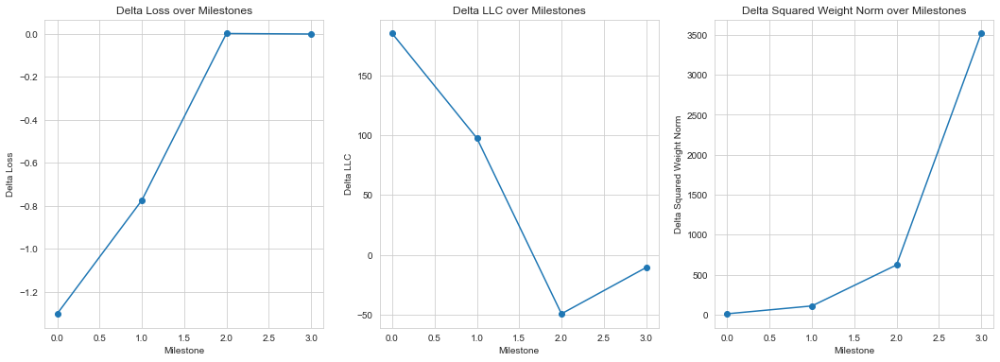

In [996]:
# Plot the deltas as a function of milestone
fig, axs = plt.subplots(1, 3, figsize=(18, 6))

delta_losses = [delta["delta_loss"] for delta, label in milestone_deltas]
delta_llcs = [delta["delta_llc"] for delta, label in milestone_deltas]
delta_weight_norms = [delta["delta_weight_norm"] for delta, label in milestone_deltas]
delta_sq_weight_norms = [delta["delta_sq_weight_norm"] for delta, label in milestone_deltas]

axs[0].plot(range(len(milestone_deltas)), delta_losses, label='Delta Loss', marker='o')
axs[0].set_title('Delta Loss over Milestones')
axs[0].set_xlabel('Milestone')
axs[0].set_ylabel('Delta Loss')

axs[1].plot(range(len(milestone_deltas)), delta_llcs, label='Delta LLC', marker='o')
axs[1].set_title('Delta LLC over Milestones')
axs[1].set_xlabel('Milestone')
axs[1].set_ylabel('Delta LLC')

# axs[2].plot(range(len(milestone_deltas)), delta_weight_norms, label='Delta Weight Norm', marker='o')
# axs[2].set_title('Delta Weight Norm over Milestones')
# axs[2].set_xlabel('Milestone')
# axs[2].set_ylabel('Delta Weight Norm')

axs[2].plot(range(len(milestone_deltas)), delta_sq_weight_norms, label='Delta Squared Weight Norm', marker='o')
axs[2].set_title('Delta Squared Weight Norm over Milestones')
axs[2].set_xlabel('Milestone')
axs[2].set_ylabel('Delta Squared Weight Norm')


fig.set_facecolor("white")

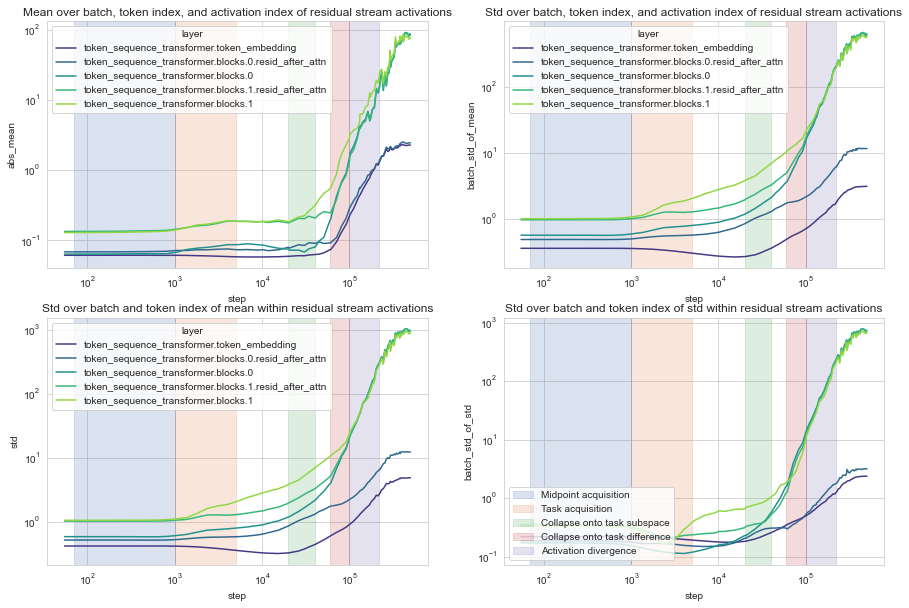

In [565]:
act_stats_over_time_starting_at = act_stats_over_time[act_stats_over_time["step"] >= 50]

# Plot the stats over time

fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# Mean over steps
sns.lineplot(ax=axes[0, 0], data=act_stats_over_time_starting_at, x='step', y='abs_mean', hue='layer', palette='viridis')

# Std over steps
sns.lineplot(ax=axes[1, 0], data=act_stats_over_time_starting_at, x='step', y='std', hue='layer', palette='viridis')

# Mean over layers
sns.lineplot(ax=axes[0, 1], data=act_stats_over_time_starting_at, x='step', y='batch_std_of_mean', hue='layer', palette='viridis')

# Std over layers
sns.lineplot(ax=axes[1, 1], data=act_stats_over_time_starting_at, x='step', y='batch_std_of_std', hue='layer', palette='viridis')

for ax in axes.flatten():
    ax.set_xscale('log')
    ax.set_yscale('log')

# Title and labels
axes[0, 0].set_title('Mean over batch, token index, and activation index of residual stream activations')
axes[0, 1].set_title('Std over batch, token index, and activation index of residual stream activations')
axes[1, 0].set_title('Std over batch and token index of mean within residual stream activations')
axes[1, 1].set_title('Std over batch and token index of std within residual stream activations')

fig.set_facecolor("white")

# Milestones
for ax in axes.flatten():
    for color, (start, end, label) in zip(milestone_colors, milestones):
        ax.axvspan(start, end, alpha=0.2, label=label, color=color)

# Add milestone legend
patchList = []
for color, (start, end, label) in zip(milestone_colors, milestones):
    data_key = mpatches.Patch(color=color, alpha=0.2, label=label)
    patchList.append(data_key)

plt.legend(handles=patchList, loc='lower left')

# Show the plots
plt.show()




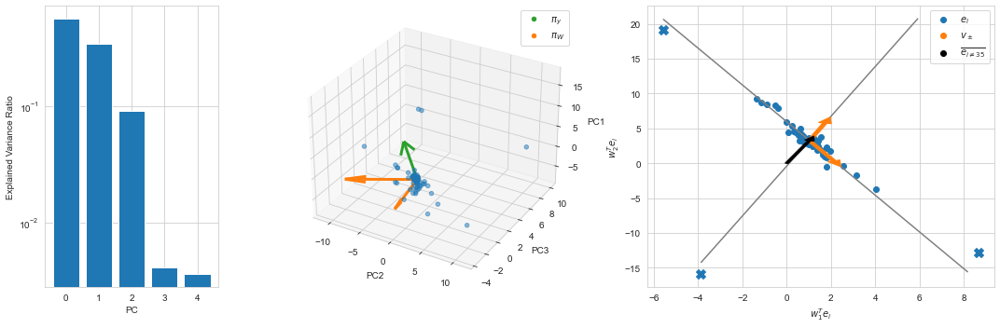

In [1208]:
embed_weights_np = embed_weights.detach().cpu().numpy()

all_indices_except_35 = [i for i in range(len(projected_embeds)) if i != 35 and i != 46 and i != 8] # [8, 46] #
embed_weights_normalized = embed_weights_np - np.mean(embed_weights_np[all_indices_except_35], axis=0)

# PCA Calculation (presuming x_embeds is your data)
pca = PCA(n_components=5)
pca_embeds = pca.fit_transform(embed_weights_normalized)
explained_variance = pca.explained_variance_ratio_

v_plus = (tasks[0] + tasks[1]) / 2
v_minus = (tasks[0] - tasks[1]) / 2

tasks_np = tasks.detach().cpu().numpy()

# Project `task_sum` onto first three pcs
v_plus_embed = np.zeros(5)
v_plus_embed[1:] = tasks_np[0] #v_plus.detach().cpu().numpy()

v_minus_embed = np.zeros(5)
v_minus_embed[1:] = tasks_np[1] # v_minus.detach().cpu().numpy()

y_vec = np.zeros(5)
y_vec[0] = 1.

v_plus_proj = pca.transform(v_plus_embed.reshape(1, -1))[0]
v_minus_proj = pca.transform(v_minus_embed.reshape(1, -1))[0]
y_proj = pca.transform(y_vec.reshape(1, -1))[0]

# First column with two rows
ax1 = fig.add_subplot(2, 3, 1)  # 2 rows, 3 columns, plot index 1
sns.histplot([1, 2, 3, 4, 5], ax=ax1)

ax2 = fig.add_subplot(1, 3, 2, projection='3d')  # 2 rows, 3 columns, plot index 4
x = np.linspace(-5, 5, 50)
y = np.linspace(-5, 5, 50)
X, Y = np.meshgrid(x, y)
Z = np.sin(np.sqrt(X**2 + Y**2))
# ax2.plot_surface(X, Y, Z, cmap='viridis')

# Create the figure object
fig = plt.figure(figsize=(15, 5))

# Create GridSpec object
gs = gridspec.GridSpec(2, 3, width_ratios=[1, 2, 2])

V_proj = np.vstack([v_plus_embed, v_minus_embed])
pca_components = pca.components_

pca1_reconstruction = pca.inverse_transform(np.array([y_vec @ pca_components[:, 0], 0, 0, 0, 0]).reshape((1, -1)))
pca2_reconstruction = pca.inverse_transform(np.array([0, *((V_proj @ pca_components[:, 1]).tolist()), 0, 0]).reshape((1, -1)))
pca3_reconstruction = pca.inverse_transform(np.array([0, *((V_proj @ pca_components[2]).tolist()), 0, 0]).reshape((1, -1)))

pca1_reconstruction_error = np.linalg.norm(pca1_reconstruction - pca_components[0])
pca2_reconstruction_error = np.linalg.norm(pca2_reconstruction - pca_components[1])
pca3_reconstruction_error = np.linalg.norm(pca3_reconstruction - pca_components[2])

# First column with two rows
# ax1 = plt.subplot(gs[0, 0])  # 2 rows, 3 columns, plot index 1
# ax1.bar(range(0, 3), [pca1_reconstruction_error, pca2_reconstruction_error, pca3_reconstruction_error], color=PRIMARY, label="$\pi_y$")
# ax1.set_xticks(range(3), [f"{i}" for i in range(1, 4)])
# ax1.set_xlabel("PC")
# ax1.set_ylabel("Reconstruction error")
# ax1.legend()

ax2 = plt.subplot(gs[:, 0])  # 2 rows, 3 columns, plot index 4
ax2.bar(range(5), pca.explained_variance_ratio_)
ax2.set_xlabel("PC")
ax2.set_ylabel("Explained Variance Ratio")
ax2.set_yscale('log')

# Second column with one row
ax3 = plt.subplot(gs[:, 1], projection='3d')  # 1 row, 3 columns, plot index 2
ax3.scatter(pca_embeds[:, 1], pca_embeds[:, 2], pca_embeds[:, 0], color=PRIMARY, alpha=0.5)
ax3.set_xlabel("PC2")
ax3.set_ylabel("PC3")
ax3.set_zlabel("PC1")

y_proj *= 10
v_plus_proj *= 5
v_minus_proj *= 5

ax3.quiver(0, 0, 0, y_proj[1], y_proj[2], y_proj[0], color=TERTIARY, linewidth=3)
ax3.quiver(0, 0, 0, v_plus_proj[1], v_plus_proj[2], v_plus_proj[0], color=SECONDARY, linewidth=3)
ax3.quiver(0, 0, 0, v_minus_proj[1], v_minus_proj[2], v_minus_proj[0], color=SECONDARY, linewidth=3)

# Legend
ax3.scatter([], [], [], color=TERTIARY, label="$\pi_y$")
ax3.scatter([], [], [], color=SECONDARY, label="$\pi_W$")
ax3.legend()

# Third column with one row
ax4 = plt.subplot(gs[:, 2])  # 1 row, 3 columns, plot index 3
ax4.scatter(x=projected_embeds[:, 0], y=projected_embeds[:, 1], label="$e_i$")
ax4.set_xlabel("$w_1^T e_i$")
ax4.set_ylabel("$w_2^T e_i$")
ax4.scatter(projected_embeds[[8, 35, 46], 0], projected_embeds[[8, 35, 46], 1], color=PRIMARY, marker="X", linestyle="None", s=100)
ax4.scatter([], [], color=SECONDARY, label="$v_\pm$")
ax4.scatter([], [], color="black", label=r"$\overline{{e}_{i\neq 35}}$")
 
# Draw an arrow pointing in the direction [0, 1] and [1, 0]
task0_norm = np.linalg.norm(tasks[0].detach().cpu().numpy())
task1_norm = np.linalg.norm(tasks[1].detach().cpu().numpy())
task0_dot_task1 = np.dot(tasks[0].detach().cpu().numpy(), tasks[1].detach().cpu().numpy())

w1origin = np.mean(projected_embeds[all_indices_except_35, 0])
w2origin = np.mean(projected_embeds[all_indices_except_35, 1])
worigin = np.array([w1origin, w2origin])

w1vplus = task0_norm**2 + task0_dot_task1
w2vplus = task1_norm ** 2  + task0_dot_task1

w1vminus = task0_norm**2 - task0_dot_task1
w2vminus = - task1_norm ** 2 + task0_dot_task1

ax4.plot([w1origin-w1vplus * 7, w1origin + w1vplus * 7,], [w2origin-w2vplus * 7, w2origin + w2vplus * 7], color="gray")
ax4.plot([w1origin-w1vminus * 6, w1origin + w1vminus * 6.5], [w2origin-w2vminus * 6, w2origin + w2vminus * 6.5], color="gray")
ax4.arrow(w1origin, w2origin, w1vplus, w2vplus, color=SECONDARY, width=0.2, zorder=10)
ax4.arrow(w1origin, w2origin, w1vminus, w2vminus, color=SECONDARY, width=0.2, zorder=10)
ax4.arrow(0, 0, w1origin, w2origin, color="black", width=0.15, zorder=11)

ax4.legend()

plt.tight_layout()  # Adjust layout to prevent overlap
fig.set_facecolor("white")
fig.savefig("../figures/m2-pca.pdf", bbox_inches='tight', pad_inches=0)
plt.show()


In [1053]:
v_minus / v_minus.norm(), v_plus / v_plus.norm(), v_plus_proj, v_minus_proj, v_plus_embed, v_minus_embed,

(tensor([0.5570, 0.2167, 0.7927, 0.1199], device='mps:0'),
 tensor([ 0.1172,  0.0564, -0.8174,  0.5611], device='mps:0'),
 array([ 2.65906058,  0.87400472,  1.14901872, -0.28763011, -0.15721013]),
 array([ 2.56743108,  2.42842073,  1.6702207 , -0.29492689, -0.16118968]),
 array([ 0.        ,  0.1047231 ,  0.05039694, -0.73054564,  0.50150061]),
 array([0.        , 0.55662906, 0.21652716, 0.79222286, 0.11981671]))

In [1057]:
sweep = api.sweep("icl/zmurwlvt")
runs = sweep.runs

In [1061]:
llc_run.config

{'task_config': {'mlp_size': 64,
  'num_heads': 4,
  'num_tasks': 2,
  'task_size': 4,
  'true_seed': 2,
  'embed_size': 64,
  'model_seed': 0,
  'num_layers': 2,
  'max_examples': 8,
  'pretrain_seed': 1,
  'sampling_seed': 3,
  'noise_variance': 0.125},
 'analysis_config': {'lr': 0.0001,
  'gamma': 1,
  'num_draws': 1000,
  'num_chains': 25},
 'eval_batch_size': 1024,
 'optimizer_config': {'lr': 0.01}}

In [1076]:
from icl.experiments.sweep_over_time import iter_models

def plot_run(r):
    history_df = r.history()
    steps = history_df["_step"]
    llcs = history_df["llc/mean"]
    llcs_std = history_df["llc/std"]

    slope = np.zeros(len(steps))
    curvature = np.zeros(len(steps))

    run = get_unique_run(
        "../experiments/L2H4-covariances.yaml", 
        **r.config
    ) 

    evals_over_time = []

    for m in tqdm(iter_models(run.model, run.checkpointer), desc="Loading models"):
        evals_over_time.append(run.evaluator(m))

    evals_over_time_df = pd.DataFrame(evals_over_time)
    evals_over_time_df.to_csv(f"../analysis/llc-with-diffs-{run.config.to_slug()}.csv")

    # Compute Slope and Curvature
    for i in range(1, len(steps) - 1):
        dx1 = steps[i+1] - steps[i]
        dx0 = steps[i] - steps[i-1]
        
        dy1 = llcs[i+1] - llcs[i]
        dy0 = llcs[i] - llcs[i-1]
        
        slope[i] = (dy1 / dx1 + dy0 / dx0) / 2
        curvature[i] = 2 * ((dy1 / dx1 - dy0 / dx0) / (dx1 + dx0))
      

    # Main plot
    fig, axs = plt.subplots(2, 2, figsize=(18, 12))

    axs[0, 0].plot(run.checkpointer.file_ids[10:], evals_over_time_df["pretrain/mse"][10:], label='Pretrain', marker='o')
    axs[0, 0].set_title('Pretrain MSE over Time')
    axs[0, 0].set_xlabel('Time Steps')
    axs[0, 0].set_ylabel('Pretrain MSE')

    axs[0, 1].plot(run.checkpointer.file_ids[10:], evals_over_time_df["true/mse"][10:], label='True', marker='o')
    axs[0, 1].set_title('True MSE over Time')
    axs[0, 1].set_xlabel('Time Steps')
    axs[0, 1].set_ylabel('True MSE')

    # Plot llc/mean
    axs[1, 0].plot(steps[10:], llcs[10:], label='llc/mean', marker='o')
    axs[1, 0].set_title('$\hat\lambda$ over Time')
    axs[1, 0].set_xlabel('Time Steps')
    axs[1, 0].set_ylabel('$\hat\lambda$')

    # Plot Slope
    axs[1, 1].plot(steps[10:], slope[10:], label='Slope', marker='o')
    axs[1, 1].set_title('$\delta\hat\lambda/\delta t$ over Time')
    axs[1, 1].set_xlabel('Time Steps')
    axs[1, 1].set_ylabel('$\delta\hat\lambda/\delta t$')

    plt.legend(handles=patchList, loc='lower left')

    # Set log scale
    for ax in axs.flatten():
        ax.set_xscale('log')

    fig.set_facecolor("white")

    plt.draw()  # Force drawing to initialize renderer

    # Create Insets
    # Add inset axes
    for i, (ax, metrics) in enumerate(zip([axs[0, 0], axs[1,1]], [evals_over_time_df["pretrain/mse"], slope])): 
        inset_pos = [[0.505, 0.55, 0.515, 0.4], [0.71, 0.42, 0.515, 0.4]][i]
        ax_w = ax.get_position().width
        ax_h = ax.get_position().height

        axins = fig.add_axes([ax.get_position().x0 + inset_pos[0] * ax_w,
                                ax.get_position().y0 + inset_pos[1] * ax_h,
                                ax_w * inset_pos[2],
                                ax_h * inset_pos[3]])
        STARTING_STEP = 32  # Replace with the step index you want to start from
        axins.plot(steps[STARTING_STEP:], metrics[STARTING_STEP:], marker='o')
        axins.set_xscale('log')

    # Draw a box in the second axis to indicate the zoom region.
    for ax in axs:
        # ax.indicate_inset_zoom(axins, edgecolor="black")
        # Manually draw box
        x0 = steps[STARTING_STEP]
        x1 = steps.max()

        y0 = -0.005
        y1 = 0.005

        axs[1, 1].plot([x0, x1, x1, x0, x0], [y0, y0, y1, y1, y0], color="grey", linestyle="--", linewidth=1)


    plt.suptitle(f"LLCs over time\n{run.config.to_latex()}")

    plt.tight_layout()
    
    file_name = f"../figures/llc-with-diffs-{run.config.to_slug()}.png"
    if not os.path.exists(os.path.dirname(file_name)):
        os.makedirs(os.path.dirname(file_name))
    
    plt.savefig(file_name)
    plt.close()


for r in sweep.runs:
    plot_run(r)


/Users/Jesse/Projects/devinfra/devinfra/utils/iterables.py:29: UserWarning:

Number of steps in int_logspace is not 100, got 91.

/Users/Jesse/Projects/devinfra/devinfra/utils/iterables.py:29: UserWarning:

Number of steps in int_logspace is not 50, got 47.

Loading models: 96it [01:48,  1.13s/it]
<ipython-input-1076-3ebe5a89409d>:102: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.

/Users/Jesse/Projects/devinfra/devinfra/utils/iterables.py:29: UserWarning:

Number of steps in int_logspace is not 100, got 91.

/Users/Jesse/Projects/devinfra/devinfra/utils/iterables.py:29: UserWarning:

Number of steps in int_logspace is not 50, got 47.

Loading models: 96it [01:42,  1.07s/it]
<ipython-input-1076-3ebe5a89409d>:102: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.

/Users/Jesse/Projects/devinfra/devinfra/utils/iterables.py:29: UserWarning:

Number of steps i

In [1215]:
# I only want the diagonals nows

probes_normalized = defaultdict(dict)

for layer in tqdm(resid_stream_layers, desc=f"Iterating over layers"):
    print("=" * 20 + f" Layer {layer} " + "=" * 20)
    activation = normalized_activations_over_time[-1][layer].detach()
    layer_probes_normalized = []

    for i in tqdm(range(2 * 8), desc=f"Layer {layer}"):
        # Train a separate linear probe for each token position, both xs and ys
        local_activation = activation[:, i, :]

        j = i // 2
        x_or_y = i % 2

        ij_probes = {}

        # Some of these combinations won't make sense (e.g., trying to predict y_1 from x_1). I'm too lazy to customize this. 
        ij_probes["v_plus_x_j"] = train_probe(local_activation, v_plus_x_ks[:, j])
        ij_probes["v_minus_x_j"] = train_probe(local_activation, v_minus_x_ks[:, j])
        ij_probes["y_j"] = train_probe(local_activation, train_ys[:, j].squeeze(-1))
        ij_probes["delta_0j"] = train_probe(local_activation, delta_0s[:, j])
        ij_probes["delta_1j"] = train_probe(local_activation, delta_1s[:, j])
        ij_probes["abs_delta_0j"] = train_probe(local_activation, abs_delta_0s[:, j])
        ij_probes["abs_delta_1j"] = train_probe(local_activation, abs_delta_1s[:, j])
        # ij_probes["sq_delta_0j"] = train_probe(local_activation, sq_delta_0s[:, j])
        # ij_probes["sq_delta_1j"] = train_probe(local_activation, sq_delta_1s[:, j])
        ij_probes["avg_abs_delta_0j"] = train_probe(local_activation, avg_abs_delta_0s[:, j - 1 + x_or_y])
        ij_probes["avg_abs_delta_1j"] = train_probe(local_activation, avg_abs_delta_1s[:, j - 1 + x_or_y])
        # ij_probes["mse_delta_0j"] = train_probe(local_activation, mse_delta_0s[:, j])
        # ij_probes["mse_delta_1j"] = train_probe(local_activation, mse_delta_1s[:, j])
        # ij_probes["rt_mse_delta_0j"] = train_probe(local_activation, rt_mse_delta_0s[:, j])
        # ij_probes["rt_mse_delta_1j"] = train_probe(local_activation, rt_mse_delta_1s[:, j])

        layer_probes_normalized.append(ij_probes)
    probes_normalized[layer] = layer_probes_normalized

probes_normalized_flattened = [{"layer": name, "layer_idx": l, "token": i, "i": i, "j": i // 2, "x_or_y": i % 2, **{k: v["loss"] for k, v in pi.items()}} for l, (name, p) in enumerate(probes_normalized.items()) for i, pi in enumerate(p)]
probes_normalized_df = pd.DataFrame(probes_normalized_flattened)
probes_normalized_df

Iterating over layers:   0%|          | 0/5 [00:00<?, ?it/s]

==================== Layer token_sequence_transformer.token_embedding ====================


Iterating over layers:  20%|██        | 1/5 [00:00<00:01,  2.70it/s]

==================== Layer token_sequence_transformer.blocks.0.resid_after_attn ====================


Layer token_sequence_transformer.blocks.0.resid_after_attn: 100%|██████████| 16/16 [00:00<00:00, 36.73it/s]
Iterating over layers:  40%|████      | 2/5 [00:00<00:01,  2.44it/s]

==================== Layer token_sequence_transformer.blocks.0 ====================


Iterating over layers:  60%|██████    | 3/5 [00:01<00:00,  2.47it/s]

==================== Layer token_sequence_transformer.blocks.1.resid_after_attn ====================


Layer token_sequence_transformer.blocks.1.resid_after_attn: 100%|██████████| 16/16 [00:00<00:00, 39.21it/s]
Iterating over layers:  80%|████████  | 4/5 [00:01<00:00,  2.46it/s]

==================== Layer token_sequence_transformer.blocks.1 ====================


Iterating over layers: 100%|██████████| 5/5 [00:01<00:00,  2.50it/s]


,layer,layer_idx,token,i,j,x_or_y,v_plus_x_j,v_minus_x_j,y_j,delta_0j,delta_1j,abs_delta_0j,abs_delta_1j,avg_abs_delta_0j,avg_abs_delta_1j
0,token_sequence_transformer.token_embedding,0,0,0,0,0,0.256323,0.208244,1.148889,1.104725,1.172246,1.247662,1.276005,0.730652,0.687994
1,token_sequence_transformer.token_embedding,0,1,1,0,1,0.473557,0.829660,0.088060,0.856943,1.762265,1.225324,1.273185,1.225324,1.273185
2,token_sequence_transformer.token_embedding,0,2,2,1,0,0.277785,0.147456,1.252998,1.123319,1.132494,1.314318,1.344655,1.242558,1.271111
3,token_sequence_transformer.token_embedding,0,3,3,1,1,0.466046,0.888962,0.131187,0.884619,1.855870,1.318970,1.349166,0.966062,0.935872
4,token_sequence_transformer.token_embedding,0,4,4,2,0,0.016159,0.016997,0.958737,0.961936,0.958437,1.319360,1.225811,0.972713,0.943472
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75,token_sequence_transformer.blocks.1,4,11,11,5,1,0.036137,0.012162,0.022421,0.008605,0.044719,0.039892,0.031642,0.069936,0.108180
76,token_sequence_transformer.blocks.1,4,12,12,6,0,0.000352,0.000146,0.004519,0.002823,0.002972,0.170923,0.168314,0.049483,0.043699
77,token_sequence_transformer.blocks.1,4,13,13,6,1,0.021927,0.007003,0.018558,0.013386,0.009437,0.007176,0.017855,0.070188,0.075674
78,token_sequence_transformer.blocks.1,4,14,14,7,0,0.000520,0.000288,0.000746,0.000456,0.000903,0.164668,0.214590,0.036615,0.038533


In [1252]:
probes =  [{"layer": name, "layer_idx": l, "token": i, "i": i, "j": i // 2, "x_or_y": i % 2, **{k: v["probe"] for k, v in pi.items()}} for l, (name, p) in enumerate(probes_normalized.items()) for i, pi in enumerate(p)]

KeyError: 'probe'

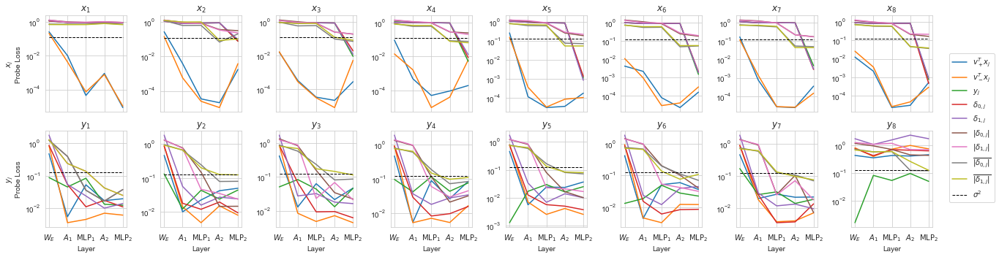

In [1250]:
import matplotlib.pyplot as plt
import pandas as pd

# Assuming probes_normalized_df is your DataFrame

colors = sns.color_palette()

fig, axes = plt.subplots(2, 8, figsize=(20, 5))  # 2 rows for x and y, 8 columns for each j

metrics = ["v_plus_x_j", "v_minus_x_j", "y_j", "delta_0j", "delta_1j", "abs_delta_0j", "abs_delta_1j","avg_abs_delta_0j", "avg_abs_delta_1j"]
labels = ["$v_+^T x_j$", "$v_-^T x_j$", "$y_j$", "$\delta_{0,j}$", "$\delta_{1,j}$", "$|\delta_{0,j}|$", "$|\delta_{1,j}|$", "$\overline{|\delta_{0,j}|}$", "$\overline{|\delta_{1,j}|}$"]

for x_or_y in range(2):
    for j in range(8):
        # Get the appropriate subplot
        ax = axes[x_or_y, j]
        rows = probes_normalized_df[(probes_normalized_df["x_or_y"] == x_or_y) & (probes_normalized_df["j"] == j)]
        # Extract your values from row dictionary and plot them.
        # For example, if you're plotting 'loss' against 'layer':
        for color, metric in zip(colors, metrics):
            ax.plot(rows['layer_idx'], rows[metric], color=color)
    
        ax.set_title(f"${'x' if x_or_y == 0 else 'y'}_{j + 1}$")

for ax in axes.flatten():
    ax.set_xticks(range(0, 5), [""] * 5)
    ax.hlines(0.125, 0, 4, color="black", linestyle="--", linewidth=1)
    ax.set_yscale('log')
    # ax.legend()

axes[0, 0].set_ylabel("$x_j$\nProbe Loss")
axes[1, 0].set_ylabel("$y_j$\nProbe Loss")

for label, metric, color in zip(labels, metrics, colors):
    axes[0, 0].plot([], [], label=label, color=color)

axes[0, 0].plot([], [], label="$\sigma^2$", color="black", linestyle="--", linewidth=1)

for ax in axes[1,:]:
    ax.set_xticks(range(0, 5), ["$W_E$", "$A_1$", "$\mathrm{MLP}_1$", "$A_2$", "$\mathrm{MLP}_2$"])
    ax.set_xlabel("Layer")
    # Add more plotting details if necessary

fig.legend(loc="upper left", bbox_to_anchor=(0.9,0.8))
plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for the legend
fig.set_facecolor("white")
fig.savefig("../figures/m2-linear-probes.pdf", bbox_inches='tight', pad_inches=0)
plt.show()



In [1256]:
{k: v.shape for k, v in activations[-1].items() if v is not None}

{'token_sequence_transformer': torch.Size([1, 4, 5]),
 'token_sequence_transformer.token_embedding': torch.Size([1, 4, 64]),
 'token_sequence_transformer.blocks.0': torch.Size([1, 4, 64]),
 'token_sequence_transformer.blocks.0.attention': torch.Size([1, 4, 64]),
 'token_sequence_transformer.blocks.0.attention.attention': torch.Size([1, 4, 192]),
 'token_sequence_transformer.blocks.0.attention.attention_softmax': torch.Size([1, 4, 4, 4]),
 'token_sequence_transformer.blocks.0.compute.0': torch.Size([1, 4, 64]),
 'token_sequence_transformer.blocks.0.compute.1': torch.Size([1, 4, 64]),
 'token_sequence_transformer.blocks.0.compute.2': torch.Size([1, 4, 64]),
 'token_sequence_transformer.blocks.0.layer_norms.0': torch.Size([1, 4, 64]),
 'token_sequence_transformer.blocks.0.layer_norms.1': torch.Size([1, 4, 64]),
 'token_sequence_transformer.blocks.0.resid_after_attn': torch.Size([1, 4, 64]),
 'token_sequence_transformer.blocks.1': torch.Size([1, 4, 64]),
 'token_sequence_transformer.blocks

In [1447]:
from icl.dtransformer import MultiHeadedCausalSelfAttention

class Bottleneck(nn.Module):
    def __init__(
        self,
        embed_size,
        bottleneck_size,
        device='cpu',
    ):
        super().__init__()
        self.bottleneck_size = bottleneck_size
        self.bottleneck = nn.Linear(embed_size, bottleneck_size, device=device)
        self.unbottleneck = nn.Linear(bottleneck_size, embed_size, device=device)
        self.mask = torch.ones(bottleneck_size, device=device)
        self.active = False

    def forward(self, x):
        if not self.active:
            return x

        x = self.bottleneck(x)
        x = x * self.mask.view(1, -1)
        return self.unbottleneck(x)

    def run_with_groundtruth(self, x, features):
        if not self.active:
            return x

        x = features.to(x.device) * self.mask.view(1, -1)
        return self.unbottleneck(x)

    def fit(self, x: TensorType["B", "E"], features: TensorType["B", "F"]):
        # Do a classic linear regression fit of x onto features
        x_with_bias = torch.cat([x, torch.ones(x.shape[0], 1, device=x.device)], dim=-1)
        regression = torch.linalg.lstsq(x_with_bias, features)
        W = regression.solution
        W, b = W.T[:, :-1], W.T[:, -1]
        self.bottleneck.weight[:, :], self.bottleneck.bias[:] = W, b

        print(regression.residuals.mean())
        # Learn the inverse transformation
        W_pseudo_inv = torch.linalg.pinv(W.to('cpu')).to(x.device)
        self.unbottleneck.weight[:, :] = W_pseudo_inv
        self.unbottleneck.bias[:] = -b @ W_pseudo_inv.T[:, :]


class BottleneckedMultiHeadedCausalSelfAttentionTransformerBlock(nn.Module):
    def __init__(
        self,
        embed_size,
        mlp_size,
        max_tokens,
        num_heads,
        device='cpu',
        bottleneck_size: int = 1,
    ):
        super().__init__()
        self.attention = MultiHeadedCausalSelfAttention(
            embed_size=embed_size,
            max_tokens=max_tokens,
            num_heads=num_heads,
            device=device,
        )
        self.compute = nn.Sequential(
            nn.Linear(embed_size, mlp_size, device=device),
            nn.ReLU(),
            nn.Linear(mlp_size, embed_size, device=device),
        )
        self.layer_norms = nn.ModuleList([
            nn.LayerNorm(normalized_shape=embed_size, device=device)
            for _ in ('before-attention', 'before-compute')
        ])
        self.resid_after_attn = nn.Identity()

        self.bottlenecks = nn.ModuleList([
            nn.ModuleList([Bottleneck(embed_size, bottleneck_size, device=device) for _ in range(16)])
            for _ in range(2)
        ])
        self.bottleneck_size = bottleneck_size

    def forward(self, x):
        # B, T, C = x.shape
        ln0_x = self.layer_norms[0](x)
        x = x + self.attention(ln0_x)
        self.resid_after_attn(x)
        ln1_x = self.layer_norms[1](x)
        x = x + self.compute(ln1_x)
        return x

    def run_with_bottleneck(self, x, features: Optional[torch.Tensor]):
        ln0_x = self.layer_norms[0](x)

        if features is None:
            def run_bottleneck(bottleneck, x, features, i):
                return bottleneck(x)
        else:
            def run_bottleneck(bottleneck, x, features, i):
                return bottleneck.run_with_groundtruth(x, features[:, i, :])

        for i in range(16):
            ln0_x[:, i, :] = run_bottleneck(self.bottlenecks[0][i], ln0_x[:, i, :], features, i)

        x = x + self.attention(ln0_x)
        self.resid_after_attn(x)
        ln1_x = self.layer_norms[1](x)

        for i in range(16):
            ln1_x[:, i, :] = run_bottleneck(self.bottlenecks[1][i], ln1_x[:, i, :], features, i)

        x = x + self.compute(ln1_x)
        return x


    def fit_bottlenecks(self, x, features):
        ln0_x = self.layer_norms[0](x)

        with torch.no_grad():
            for i in range(16):
                self.bottlenecks[0][i].fit(ln0_x[:,i,:], features[:, i, :])

        x = x + self.attention(ln0_x)
        self.resid_after_attn(x)

        ln1_x = self.layer_norms[1](x)

        with torch.no_grad():
            for i in range(16):
                self.bottlenecks[1][i].fit(ln1_x[:,i,:], features[:, i, :])

    def set_bottleneck_masks(self, masks):
        for i in range(16):
            self.bottlenecks[0][i].mask[:] = masks[0, :]
            self.bottlenecks[1][i].mask[:] = masks[1, :]

    def set_bottlenecks_active(self, active: bool=True):
        for i in range(16):
            self.bottlenecks[0][i].active = active
            self.bottlenecks[1][i].active = active


class BottleneckedDTransformer(nn.Module):
    def __init__(
        self,
        token_size,
        max_tokens,
        embed_size,
        mlp_size,
        num_heads,
        num_layers,
        device='cpu',
        bottleneck_size: int = 1,
    ):
        super().__init__()
        self.token_embedding = nn.Linear(
            in_features=token_size,
            out_features=embed_size,
            bias=False,
            device=device,
        )
        self.postn_embedding = nn.Linear(
            in_features=max_tokens,
            out_features=embed_size,
            bias=False,
            device=device,
        )
        self.blocks = nn.ModuleList([
            BottleneckedMultiHeadedCausalSelfAttentionTransformerBlock(
                embed_size=embed_size,
                mlp_size=mlp_size,
                max_tokens=max_tokens,
                num_heads=num_heads,
                device=device,
                bottleneck_size=bottleneck_size
            )
            for _ in range(num_layers)
        ])
        # unembedding
        self.unembedding = nn.Sequential(
            nn.LayerNorm(
                normalized_shape=embed_size,
                device=device,
            ),
            nn.Linear(
                in_features=embed_size,
                out_features=token_size,
                device=device,
            ),
        )
        self.max_tokens = max_tokens

    def forward(self, toks):
        # if mechinterp=True, write attention patterns on forward pass to CSV
        # all other forward passes inherit mechinterp from this initial one

        _B, T, _V = toks.shape
        assert T <= self.max_tokens, f"too many tokens! {T} > {self.max_tokens}"

        # semantic and positional token embeddings
        x_positions = self.postn_embedding.weight.T[:T, :] # Tmax C ->   T C
        x_semantics = self.token_embedding(toks)    # B T V @ . V C -> B T C
        x = x_semantics + x_positions               # B T C + . T C -> B T C

        # apply the num_layers layers / attention blocks in sequence
        for block in self.blocks:
            x = x + block(x) # B T C + B T C -> B T C

        # unembedding: transform back to predicted next tokens
        y = self.unembedding(x)                     # B T C @ . C V -> B T V
        
        return y

    def fit_bottlenecks(self, toks, features):
        _B, T, _V = toks.shape
        assert T <= self.max_tokens, f"too many tokens! {T} > {self.max_tokens}"

        # semantic and positional token embeddings
        x_positions = self.postn_embedding.weight.T[:T, :] # Tmax C ->   T C
        x_semantics = self.token_embedding(toks)    # B T V @ . V C -> B T C
        x = x_semantics + x_positions               # B T C + . T C -> B T C

        # apply the num_layers layers / attention blocks in sequence
        for block in self.blocks:
            block.fit_bottlenecks(x, features)
            x = x + block(x) # B T C + B T C -> B T C

    def run_with_bottleneck(self, toks, features: Optional[torch.Tensor]):
        _B, T, _V = toks.shape
        assert T <= self.max_tokens, f"too many tokens! {T} > {self.max_tokens}"

        # semantic and positional token embeddings
        x_positions = self.postn_embedding.weight.T[:T, :] # Tmax C ->   T C
        x_semantics = self.token_embedding(toks)    # B T V @ . V C -> B T C
        x = x_semantics + x_positions               # B T C + . T C -> B T C

        # apply the num_layers layers / attention blocks in sequence
        for block in self.blocks:
            x = x + block.run_with_bottleneck(x, features) # B T C + B T C -> B T C

        # unembedding: transform back to predicted next tokens
        y = self.unembedding(x)                     # B T C @ . C V -> B T V
        
        return y


class BottleneckedModel(nn.Module):
    def __init__(
        self,
        task_size,
        max_examples,
        embed_size,
        mlp_size,
        num_heads,
        num_layers,
        device='cpu',
        bottleneck_size: int = 1,
    ):
        super().__init__()
        self.token_sequence_transformer = BottleneckedDTransformer(
            token_size=1 + task_size,    # task_size for x + 1 for y
            max_tokens=2 * max_examples, # one x + one y per example
            embed_size=embed_size,
            mlp_size=mlp_size,
            num_heads=num_heads,
            num_layers=num_layers,
            device=device,
            bottleneck_size=bottleneck_size,
        )
        self.task_size = task_size
        self.max_examples = max_examples
        self.device = device

        # TODO: Where else is this information stored on a given run? Is it bad juju for it 
        # to hang around with the transformer all the time? 
        self.embed_size = embed_size
        self.mlp_size = mlp_size
        self.num_heads = num_heads
        self.num_layers = num_layers
 
    def forward(self, xs, ys):
        # input validation
        B, K, D = xs.shape
        assert K <= self.max_examples, \
            f"too many examples for model {K} > {self.max_examples}"
        assert D == self.task_size, \
            f"incorrect input size for model {D} != {self.task_size}"
        B_, K_, _1 = ys.shape
        assert B == B_, f"batch size mismatch b/w xs:{B} and ys:{B_}"
        assert K == K_, f"num_examples mismatch b/w xs:{K} and ys:{K_}"
        assert _1 == 1, "ys should be scalars"

        # encode examples as token sequence
        toks = to_token_sequence(xs, ys)

        # run dtransformer to predict next tokens
        toks_pred = self.token_sequence_transformer(toks)
        # decode y predictions from next-token-prediction
        ys_pred = from_predicted_token_sequence(toks_pred)
        return ys_pred
    
    def run_with_bottleneck(self, xs, ys, features=None):
        B, K, D = xs.shape
        assert K <= self.max_examples, \
            f"too many examples for model {K} > {self.max_examples}"
        assert D == self.task_size, \
            f"incorrect input size for model {D} != {self.task_size}"
        B_, K_, _1 = ys.shape
        assert B == B_, f"batch size mismatch b/w xs:{B} and ys:{B_}"
        assert K == K_, f"num_examples mismatch b/w xs:{K} and ys:{K_}"
        assert _1 == 1, "ys should be scalars"

        # encode examples as token sequence
        toks = to_token_sequence(xs, ys)

        # run dtransformer to predict next tokens
        toks_pred = self.token_sequence_transformer.run_with_bottleneck(toks, features)
        # decode y predictions from next-token-prediction
        ys_pred = from_predicted_token_sequence(toks_pred)
        return ys_pred

    def to(self, *args, **kwargs):
        self.device = args[0]
        return super().to(*args, **kwargs)
    
    def fit_bottlenecks(self, xs, ys, features):
        # input validation
        B, K, D = xs.shape
        assert K <= self.max_examples, \
            f"too many examples for model {K} > {self.max_examples}"
        assert D == self.task_size, \
            f"incorrect input size for model {D} != {self.task_size}"
        B_, K_, _1 = ys.shape
        assert B == B_, f"batch size mismatch b/w xs:{B} and ys:{B_}"
        assert K == K_, f"num_examples mismatch b/w xs:{K} and ys:{K_}"
        assert _1 == 1, "ys should be scalars"

        # encode examples as token sequence
        toks = to_token_sequence(xs, ys)

        # run dtransformer to predict next tokens
        self.token_sequence_transformer.fit_bottlenecks(toks, features)


bottlenecked_model = BottleneckedModel(
    task_size=4,
    max_examples=8,
    embed_size=64,
    mlp_size=64,
    num_heads=4,
    num_layers=2,
    device='mps',
    bottleneck_size=8,
)

bottlenecked_model.load_state_dict(model.state_dict(), strict=False)
run.evaluator(bottlenecked_model)

{'pretrain/mse': 0.27757197618484497,
 'pretrain/delta_dmmse': tensor(8.3019e-05, device='mps:0'),
 'pretrain/delta_ridge': tensor(0.6137, device='mps:0'),
 'pretrain/token/0': 1.0527323484420776,
 'pretrain/token/1': 0.3330206871032715,
 'pretrain/token/2': 0.18409666419029236,
 'pretrain/token/3': 0.15190571546554565,
 'pretrain/token/4': 0.12716269493103027,
 'pretrain/token/5': 0.12925924360752106,
 'pretrain/token/6': 0.12176783382892609,
 'pretrain/token/7': 0.12063079327344894,
 'true/mse': 4.8879547119140625,
 'true/delta_dmmse': tensor(0.2906, device='mps:0'),
 'true/delta_ridge': tensor(3.1793, device='mps:0'),
 'true/token/0': 5.0864057540893555,
 'true/token/1': 5.614630699157715,
 'true/token/2': 4.819472789764404,
 'true/token/3': 5.081650733947754,
 'true/token/4': 4.821893215179443,
 'true/token/5': 4.452449321746826,
 'true/token/6': 4.760993003845215,
 'true/token/7': 4.466144561767578}

In [1448]:
print([p.shape for p in [v_plus_x_ks, v_minus_x_ks, train_ys.squeeze(-1), delta_0s, delta_1s, abs_delta_0s, abs_delta_1s, avg_abs_delta_0s]])
_features = torch.stack([v_plus_x_ks, v_minus_x_ks, train_ys.squeeze(-1), delta_0s, delta_1s, abs_delta_0s, abs_delta_1s, avg_abs_delta_0s], dim=1)

features = torch.zeros(1024, 16, 8)

for i in range(8):
    features[:, 2 * i, :] = _features[:, i, :]
    features[:, 2 * i + 1, :] = _features[:, i, :]

features.shape

#  ij_probes_normalized["v_plus_x_j"] = train_probe(local_activation, v_plus_x_ks[:, j])
#         ij_probes_normalized["v_minus_x_j"] = train_probe(local_activation, v_minus_x_ks[:, j])
#         ij_probes_normalized["y_j"] = train_probe(local_activation, train_ys[:, j].squeeze(-1))
#         ij_probes_normalized["delta_0j"] = train_probe(local_activation, delta_0s[:, j])
#         ij_probes_normalized["delta_1j"] = train_probe(local_activation, delta_1s[:, j])
#         ij_probes_normalized["abs_delta_0j"] = train_probe(local_activation, abs_delta_0s[:, j])
#         ij_probes_normalized["abs_delta_1j"] = train_probe(local_activation, abs_delta_1s[:, j])
#         ij_probes_normalized["avg_abs_delta_0j"] = train_probe(local_activation, avg_abs_delta_0s[:, j])

[torch.Size([1024, 8]), torch.Size([1024, 8]), torch.Size([1024, 8]), torch.Size([1024, 8]), torch.Size([1024, 8]), torch.Size([1024, 8]), torch.Size([1024, 8]), torch.Size([1024, 8])]


torch.Size([1024, 16, 8])

In [1449]:
# Let's start by checking the first mlp. This should read a delta_0j and delta_1j and output their absolute value. 

bottlenecked_model.fit_bottlenecks(train_xs, train_ys, features)

tensor(3.1793, device='mps:0')
tensor(-0.0640, device='mps:0')
tensor(0.0545, device='mps:0')
tensor(0.1441, device='mps:0')
tensor(-0.0743, device='mps:0')
tensor(0.2056, device='mps:0')
tensor(1.6661, device='mps:0')
tensor(-0.5911, device='mps:0')
tensor(0.7023, device='mps:0')
tensor(-4.1098, device='mps:0')
tensor(-0.5729, device='mps:0')
tensor(0.0930, device='mps:0')
tensor(-0.0130, device='mps:0')
tensor(-0.1181, device='mps:0')
tensor(0.0443, device='mps:0')
tensor(-0.3382, device='mps:0')
tensor(0.5816, device='mps:0')
tensor(0.0932, device='mps:0')
tensor(0.0050, device='mps:0')
tensor(-0.0001, device='mps:0')
tensor(-0.0004, device='mps:0')
tensor(0.0005, device='mps:0')
tensor(-2.1823e-05, device='mps:0')
tensor(0.0006, device='mps:0')
tensor(-0.0003, device='mps:0')
tensor(-0.0004, device='mps:0')
tensor(0.0012, device='mps:0')
tensor(-0.0021, device='mps:0')
tensor(-0.0106, device='mps:0')
tensor(-0.0024, device='mps:0')
tensor(-0.0097, device='mps:0')
tensor(-0.0010, de

In [1471]:
from pprint import pp

mask = torch.zeros(2, 8, device="mps")
mask[1, :] = 1


class Bottlenecked(nn.Module):
    def __init__(
        self,
        model: BottleneckedModel,
        features: Optional[torch.Tensor],
        device='cpu',
    ):
        super().__init__()
        self.model = model
        self.features = features

    def forward(self, x, y):
        return self.model.run_with_bottleneck(x, y, self.features)


# bottlenecked_model.token_sequence_transformer.blocks[0].activate_bottlenecks()
# for i in range(2):
#     bottlenecked_model.token_sequence_transformer.blocks[i].set_bottleneck_masks(torch.ones(2, 8, device="mps"))

preevals = run.evaluator(run.model)    

for j in range(16):
    for jprime in range(16):
        for i in range(2):
            for k in range(2):
                bottlenecked_model.token_sequence_transformer.blocks[i].bottlenecks[k][jprime].active = False
                bottlenecked_model.token_sequence_transformer.blocks[i].bottlenecks[k][jprime].mask[:] = 1. 

    bottlenecked_model.token_sequence_transformer.blocks[0].bottlenecks[1][j].active = True
    # bottlenecked_model.token_sequence_transformer.blocks[0].bottlenecks[1][j].mask[:] = mask[1, :]
    m = Bottlenecked(bottlenecked_model, features)
    pp({k: v - preevals[k] for k, v in run.evaluator(m).items() if k in ["pretrain/mse", *[f"pretrain/token/{i}" for i in range(8)]]})

{'pretrain/mse': 0.162857323884964,
 'pretrain/token/0': 0.855603814125061,
 'pretrain/token/1': 0.20747017860412598,
 'pretrain/token/2': 0.0971933901309967,
 'pretrain/token/3': 0.08169887959957123,
 'pretrain/token/4': 0.018770679831504822,
 'pretrain/token/5': 0.023721471428871155,
 'pretrain/token/6': 0.010945752263069153,
 'pretrain/token/7': 0.007454283535480499}
{'pretrain/mse': 0.28350579738616943,
 'pretrain/token/0': 0.0,
 'pretrain/token/1': 1.041538953781128,
 'pretrain/token/2': 0.497360497713089,
 'pretrain/token/3': 0.26010996103286743,
 'pretrain/token/4': 0.1647607386112213,
 'pretrain/token/5': 0.1375834196805954,
 'pretrain/token/6': 0.10125906765460968,
 'pretrain/token/7': 0.06543377786874771}
{'pretrain/mse': 0.4526732563972473,
 'pretrain/token/0': 0.0,
 'pretrain/token/1': 2.0923638343811035,
 'pretrain/token/2': 0.3679790794849396,
 'pretrain/token/3': 0.33735400438308716,
 'pretrain/token/4': 0.2538415491580963,
 'pretrain/token/5': 0.26557557284832,
 'pretra

[0.66135216 0.2669241  0.06167726 0.6213173 ]
[-0.45190597 -0.16613023 -1.5227685   0.38168392]


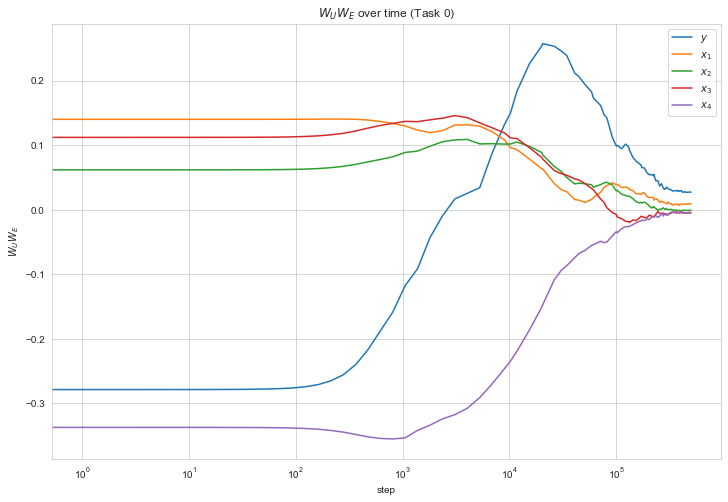

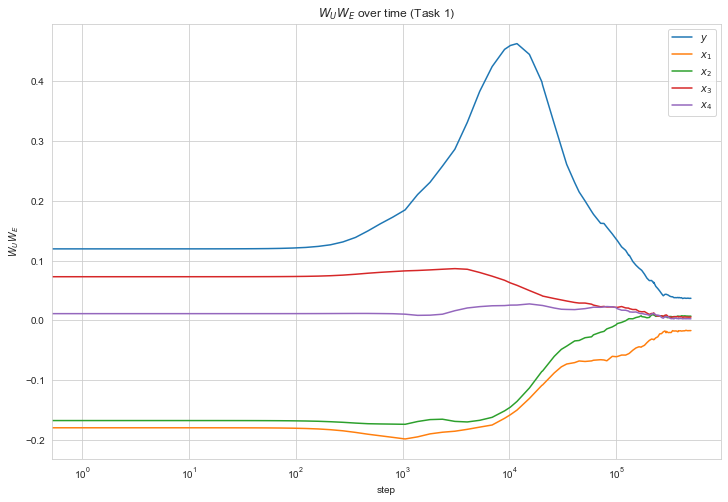

In [1559]:
for i, task in enumerate(tasks):
    # I want to see if the intermediate layers are doing anything besides scaling. 
    # I should check how the unembedding multiplied by the embedding (ignoring the layer norm) looks over time (measure cossim with task).
    # I should look how the model ran on basis vectors performs (when you let it use the entire model)
    # I should try this at different token indices to see if somehow any information is conveyed between tokens.

    task_np = task.detach().cpu().numpy()
    task_embed = np.zeros(5)
    task_embed[1:] = task_np
    print(task_np)

    embed_unembed = [
        model.token_sequence_transformer.unembedding[1].weight.detach().cpu().numpy() @ model.token_sequence_transformer.token_embedding.weight.detach().cpu().numpy()
        for model in models
    ]

    cossims = [
        (v @ task_embed) / (np.linalg.norm(v) ** 2 * np.linalg.norm(task_embed) ** 2) for v in embed_unembed
    ]


    fig = plt.figure(figsize=(12, 8))
    plt.plot(run.checkpointer.file_ids, cossims, label=["$y$", "$x_1$", "$x_2$", "$x_3$", "$x_4$"])
    plt.xscale("log")
    plt.xlabel("step")
    plt.ylabel("$W_U W_E$")
    plt.title(f"$W_U W_E$ over time (Task {i})")
    plt.legend()

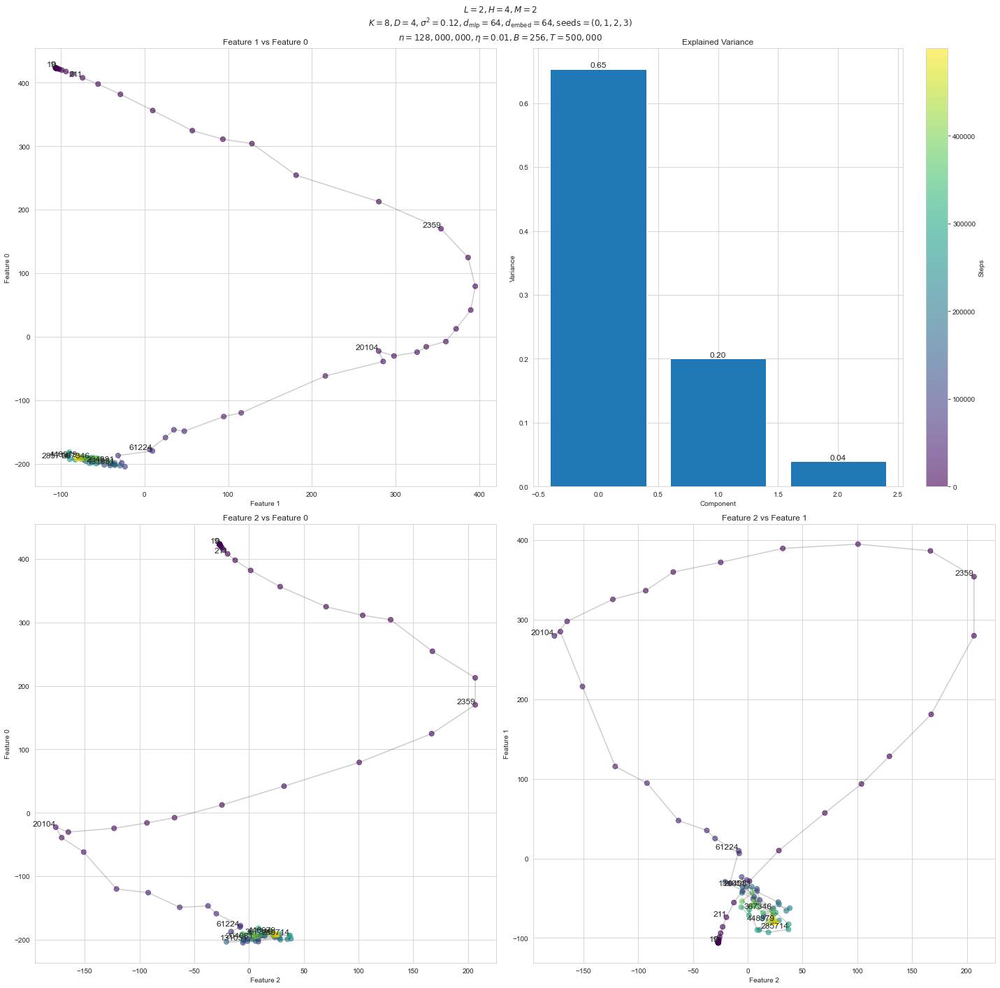

In [27]:
# Do the PCAs again. 

from typing import Dict, Iterable, Tuple
from sklearn.decomposition import PCA
from collections import defaultdict
from devinterp.mechinterp.hooks import hook
import numpy as np
from icl.analysis.utils import map_evals_over_checkpoints, get_unique_run
from icl.train import Run
from devinfra.utils.tensors import convert_tensor, ReturnTensor


def extract_activations_over_checkpoints(models: Iterable[nn.Module], xs, ys, *paths, return_type: ReturnTensor="np"):
    def eval_activations(model):
        hooked_model = hook(model, *paths)
        return {k: convert_tensor(v, return_type) for k, v in hooked_model.run_with_cache(xs, ys)[1].items() if k in paths and v is not None}
    
    for model in models:
        yield eval_activations(model)


def get_vectorized_activations_trace(models: Iterable[nn.Module], xs, ys, *paths):
    evals: Dict[str, list] = defaultdict(list)
    
    for activations in extract_activations_over_checkpoints(models, xs, ys, *paths):
        for path, activation in activations.items():
            evals[path].append(activation)

    return {
        k: np.array(v).reshape(len(v), -1) for k, v in evals.items()
    }


def get_pca_activations_trace(models: Iterable[nn.Module], xs, ys, *paths, num_components=3) -> Dict[str, Tuple[PCA, np.ndarray]]:
    results = {}

    for path, activations in get_vectorized_activations_trace(models, xs, ys, *paths).items():
        pca = PCA(n_components=num_components)
        activations_reduced = pca.fit_transform(activations)
        results[path] = pca, activations_reduced

    return results

from typing import Optional

def plot_sample_evolution(steps, samples, title="Sample Evolution in 2D Plane", num_points_to_label=10, save: Optional[str] = None, ax: Optional = None, connect_dots=False):
    if ax is None:
        fig, ax = plt.subplots(figsize=(15, 8))
    
    # Main plot
    sc = ax.scatter(samples[:, 0], samples[:, 1], c=steps, cmap='viridis', s=50, alpha=0.6)

    if connect_dots:
        ax.plot(samples[:, 0], samples[:, 1], c='black', alpha=0.2)

    plt.colorbar(sc, ax=ax, label='Steps')
    
    # Label some points
    total_samples = len(samples)
    step = total_samples // num_points_to_label
    for i in range(0, total_samples, step):
        sample_step = steps[i]
        ax.text(samples[i, 0], samples[i, 1], str(sample_step), fontsize=12, ha='right', va='bottom')
        
    ax.set_xlabel('Feature 1')
    ax.set_ylabel('Feature 2')
    ax.set_title(title)
    
    # Inset for explained variance at the bottom right corner with slight transparency
    if save:
        parent_dir = os.path.dirname(save)

        if not os.path.exists(parent_dir):
            os.makedirs(parent_dir)

        plt.savefig(save)


def plot_explained_variance(pca, title="Explained Variance", ax: Optional[plt.Axes] = None):
    if ax is None:
        fig, ax = plt.subplots(figsize=(15, 8))

    ax.bar(range(len(pca.explained_variance_ratio_)), pca.explained_variance_ratio_)

    for i, ratio in enumerate(pca.explained_variance_ratio_):
        ax.text(i, ratio, f"{ratio:.2f}", fontsize=12, ha='center', va='bottom')

    ax.set_title(title)
    ax.set_xlabel('Component')
    ax.set_ylabel('Variance')


def plot_sample_evolution_with_inset(steps, samples, pca, title="Sample Evolution in 2D Plane", num_points_to_label=10, save: Optional[str] = None, ax: Optional = None, connect_dots=False):
    if ax is None:
        fig, ax = plt.subplots(figsize=(15, 8))
    
    plot_sample_evolution(steps, samples, title=title, num_points_to_label=num_points_to_label, ax=ax, connect_dots=connect_dots)

    axins = ax.inset_axes([0.7, 0.05, 0.25, 0.25])  # x, y, width, height
    axins.patch.set_alpha(0.5)
    plot_explained_variance(pca, ax=axins)
    
    # Inset for explained variance at the bottom right corner with slight transparency
    if save:
        parent_dir = os.path.dirname(save)

        if not os.path.exists(parent_dir):
            os.makedirs(parent_dir)

        plt.savefig(save)

    
def plot_multiple_slices(steps, samples, pca, title="Sample Evolution in 2D Plane", num_points_to_label=10, save: Optional[str] = None, ax: Optional = None, connect_dots=False):
    num_pca_components = samples.shape[-1]
    num_rows = num_pca_components - 1
    fig, ax = plt.subplots(num_rows, num_rows, figsize=(20, 20))

    fig.suptitle(title)

    for i in range(num_pca_components):
        for j in range(i):
            sc = ax[i-1, j].scatter(samples[:, i], samples[:, j], c=steps, cmap='viridis', s=50, alpha=0.6)
            ax[i-1, j].set_xlabel(f'Feature {i}')
            ax[i-1, j].set_ylabel(f'Feature {j}')
            ax[i-1, j].set_title(f'Feature {i} vs Feature {j}')

            if connect_dots:
                ax[i-1, j].plot(samples[:, i], samples[:, j], c='black', alpha=0.2)

            # Label some points
            total_samples = len(samples)
            step = total_samples // num_points_to_label
            for k in range(0, total_samples, step):
                sample_step = steps[k]
                ax[i-1, j].text(samples[k, i], samples[k, j], str(sample_step), fontsize=12, ha='right', va='bottom')

        for j in range(i + 1, num_rows):
            ax[i, j].axis('off')


    ax[0, -1].axis('on')
    plot_explained_variance(pca, ax=ax[0, -1])

    plt.colorbar(sc, ax=ax[0, -1], label='Steps')
    plt.tight_layout()

    if save:
        parent_dir = os.path.dirname(save)

        if not os.path.exists(parent_dir):
            os.makedirs(parent_dir)

        plt.savefig(save)

# plot_multiple_slices(steps, demo_logits_reduced_3, demo_logits_pca_3, title=demo.config.to_latex(), connect_dots=True)
train_xs_1, train_ys_1 = pretrain_dist_noiseless.get_batch(8, 8196)


pca, logits_reduced = get_pca_activations_trace(
    models,
    train_xs_1, 
    train_ys_1, 
    "token_sequence_transformer",
    num_components=3
)['token_sequence_transformer']

plot_multiple_slices(
    steps, 
    logits_reduced, 
    pca, 
    connect_dots=True, 
    title=run.config.to_latex(), 
    save=None
)

In [44]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Assuming `logits_reduced` is the PCA-transformed data with shape (N, 3)
# where N is the number of checkpoints, and `pca` is the fitted PCA object

# Set up subplot for 3D scatter and 2D bar chart
fig = make_subplots(
    rows=1, cols=2,
    column_widths=[0.7, 0.3],
    specs=[[{'type': 'scatter3d'}, {'type': 'bar'}]],
    subplot_titles=('PCA Trajectory', 'Explained Variance Ratio')
)

# Initial state of the plot with full PCA trajectory
full_trajectory = go.Scatter3d(
    x=logits_reduced[:, 0],
    y=logits_reduced[:, 1],
    z=logits_reduced[:, 2],
    mode='markers+lines',
    marker=dict(size=4, color='blue'),
    line=dict(color='blue', width=2),
    name='Full PCA Trajectory'
)

# Add the initial state to the 3D scatter plot
fig.add_trace(full_trajectory, row=1, col=1)

# Set up the bar chart for the explained variance
fig.add_trace(
    go.Bar(
        x=[f'PC{i+1}' for i in range(len(pca.explained_variance_ratio_))],
        y=pca.explained_variance_ratio_,
        name='Explained Variance'
    ),
    row=1, col=2
)

# Prepare the slider frame_steps and frames for the animation of the focused dot
frame_steps = []
frames = []

for step, k in zip(steps, range(logits_reduced.shape[0])):
    frame = go.Frame(
        data=[
            go.Scatter3d(
                x=logits_reduced[:, 0],
                y=logits_reduced[:, 1],
                z=logits_reduced[:, 2],
                mode='markers+lines',
                marker=dict(size=4, color='blue'),
                line=dict(color='blue', width=2),
                name='Full PCA Trajectory'
            ),
            go.Scatter3d(
                x=[logits_reduced[k, 0]],
                y=[logits_reduced[k, 1]],
                z=[logits_reduced[k, 2]],
                mode='markers',
                marker=dict(size=6, color='red'),
                name='Focused Dot'
            )
        ],
        name=str(k)
    )
    frames.append(frame)
    
    step = dict(
        method='animate',
        args=[[str(k)], dict(mode='immediate', frame=dict(duration=100, redraw=True), transition=dict(duration=0))],
        label=str(step)
    )
    frame_steps.append(step)

# Add the frames to the figure
fig.frames = frames

# Create and add slider
sliders = [dict(
    steps=frame_steps,
    currentvalue={'prefix': 'Step: '},
    len=0.9,
    x=0.1,
    y=0,
    xanchor='left',
    yanchor='bottom'
)]

updatemenus = [{
    'buttons': [{
        'args': [None, {'frame': {'duration': 100, 'redraw': True}, 'fromcurrent': True, 'transition': {'duration': 0}}],
        'label': 'Play',
        'method': 'animate'
    }],
    'direction': 'left',
    'pad': {'r': 10, 't': 87},
    'showactive': False,
    'type': 'buttons',
    'x': 0.1,
    'xanchor': 'right',
    'y': 0,
    'yanchor': 'top'
}]


fig.update_layout(
    sliders=sliders,
    updatemenus=updatemenus
)

# Configure the layout for the subplot
fig.update_layout(
    scene=dict(
        xaxis_title='PC1',
        yaxis_title='PC2',
        zaxis_title='PC3'
    ),
    yaxis2=dict(title='Explained Variance Ratio'),
    title_text='PCA Trajectory and Explained Variance'
)

# Show the figure
fig.show()


In [ ]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Assuming `logits_reduced` is the PCA-transformed data with shape (N, 3)
# where N is the number of checkpoints, and `pca` is the fitted PCA object

# Set up subplot for 3D scatter and 2D bar chart
fig = make_subplots(
    rows=1, cols=2,
    column_widths=[0.7, 0.3],
    specs=[[{'type': 'scatter3d'}, {'type': 'bar'}]],
    subplot_titles=('PCA Trajectory', 'Explained Variance Ratio')
)

# Initial state of the plot with full PCA trajectory
full_trajectory = go.Scatter3d(
    x=logits_reduced[:, 0],
    y=logits_reduced[:, 1],
    z=logits_reduced[:, 2],
    mode='markers+lines',
    marker=dict(size=4, color='blue'),
    line=dict(color='blue', width=2),
    name='Full PCA Trajectory'
)

# Add the initial state to the 3D scatter plot
fig.add_trace(full_trajectory, row=1, col=1)

# Set up the bar chart for the explained variance
fig.add_trace(
    go.Bar(
        x=[f'PC{i+1}' for i in range(len(pca.explained_variance_ratio_))],
        y=pca.explained_variance_ratio_,
        name='Explained Variance'
    ),
    row=1, col=2
)

# Prepare the slider frame_steps and frames for the animation of the focused dot
frame_steps = []
frames = []

for step, k in zip(steps, range(logits_reduced.shape[0])):
    frame = go.Frame(
        data=[
            go.Scatter3d(
                x=logits_reduced[:, 0],
                y=logits_reduced[:, 1],
                z=logits_reduced[:, 2],
                mode='markers+lines',
                marker=dict(size=4, color='blue'),
                line=dict(color='blue', width=2),
                name='Full PCA Trajectory'
            ),
            go.Scatter3d(
                x=[logits_reduced[k, 0]],
                y=[logits_reduced[k, 1]],
                z=[logits_reduced[k, 2]],
                mode='markers',
                marker=dict(size=6, color='red'),
                name='Focused Dot'
            )
        ],
        name=str(k)
    )
    frames.append(frame)
    
    step = dict(
        method='animate',
        args=[[str(k)], dict(mode='immediate', frame=dict(duration=100, redraw=True), transition=dict(duration=0))],
        label=str(step)
    )
    frame_steps.append(step)

# Add the frames to the figure
fig.frames = frames

# Create and add slider
sliders = [dict(
    steps=frame_steps,
    currentvalue={'prefix': 'Step: '},
    len=0.9,
    x=0.1,
    y=0,
    xanchor='left',
    yanchor='bottom'
)]

updatemenus = [{
    'buttons': [{
        'args': [None, {'frame': {'duration': 100, 'redraw': True}, 'fromcurrent': True, 'transition': {'duration': 0}}],
        'label': 'Play',
        'method': 'animate'
    }],
    'direction': 'left',
    'pad': {'r': 10, 't': 87},
    'showactive': False,
    'type': 'buttons',
    'x': 0.1,
    'xanchor': 'right',
    'y': 0,
    'yanchor': 'top'
}]


fig.update_layout(
    sliders=sliders,
    updatemenus=updatemenus
)

# Configure the layout for the subplot
fig.update_layout(
    scene=dict(
        xaxis_title='PC1',
        yaxis_title='PC2',
        zaxis_title='PC3'
    ),
    yaxis2=dict(title='Explained Variance Ratio'),
    title_text='PCA Trajectory and Explained Variance'
)

# Show the figure
fig.show()


---

frames = []

for step, embed in zip(steps, embedding_matrices):
    _x_embeds = embed[:, 1:].to("mps")
    projection_matrix = torch.stack([tasks[0], tasks[1]], dim=1)
    projected_embeds = torch.matmul(_x_embeds, projection_matrix)
    reembedded_projections = torch.matmul(torch.tensor(projected_embeds), projection_matrix.T)
    projected_embeds = projected_embeds.detach().cpu().numpy()
    dist_from_proj = np.linalg.norm(_x_embeds.detach().cpu().numpy() - reembedded_projections.detach().cpu().numpy(), axis=1)
    
    frame = go.Frame(
        data=[
            go.Scatter(
                x=projected_embeds[:, 0],
                y=projected_embeds[:, 1],
                mode='markers',
                marker=dict(
                    color=dist_from_proj, 
                    colorscale='Viridis', 
                    colorbar=dict(title="Distance from Projection"),
                    opacity=0.8
                )
            )
        ],
        name=str(step)
    )
    frames.append(frame)
    
# Calculate differences between successive steps for timing
diff_steps = [steps[i+1] - steps[i] for i in range(len(steps)-1)]
diff_steps.append(diff_steps[-1])  # Append the last difference for the last step

# Create steps for the slider
slider_steps = []
for i, step in enumerate(steps):
    step_duration = diff_steps[i] * 10  # Convert to milliseconds
    step_dict = {
        "args": [
            [str(step)],
            {
                "frame": {"duration": step_duration, "redraw": True},
                "mode": "immediate",
                "transition": {"duration": 10},
            },
        ],
        "label": str(step),
        "method": "animate",
    }
    slider_steps.append(step_dict)

fig = go.Figure(
    data=frames[0]['data'],
    layout=go.Layout(
        title="Projected Embeddings",
        updatemenus=[dict(type='buttons', showactive=True, buttons=[dict(label='Play', method='animate', args=[None, dict(frame=dict(duration=1000, redraw=True), fromcurrent=True)])])],
        sliders=[{"active": 0, "yanchor": "top", "xanchor": "left", "currentvalue": {"font": {"size": 20}, "prefix": "Step:", "visible": True, "xanchor": "right"}, "pad": {"b": 10, "t": 50}, "len": 0.9, "x": 0.1, "y": 0, "steps": slider_steps}],
        xaxis_title="Task 0",
        yaxis_title="Task 1",
        xaxis=dict(range=[-25, 25]),
        yaxis=dict(range=[-25, 25]),
        width=1200,  
        height=1200   
    ),
    frames=frames
)

fig.show()

In [116]:
# Assuming `logits_reduced` is your PCA-transformed data with shape (N, 3)
# and `steps` is a list of time steps corresponding to each frame

# Compute the intervals as the log of the step size
log_intervals = np.diff(np.log([s + 1 for s in steps]))

# Normalize the intervals to get the number of frames to stay at each point
og_frame_intervals = log_intervals / (log_intervals.min() * 2)
frame_intervals = np.array([min(ivl, 10) for ivl in og_frame_intervals])

# Create a list of indices where each point index is repeated according to its interval
frame_sequence = []
logits_interpolated = []
embeddings_interpolated = []
steps_interpolated = []

for i, interval in enumerate(frame_intervals.astype(int)):
    frame_sequence.extend([i] * interval)

    for j in range(interval):
        logits_interpolated.append(
            logits_reduced[i] + (logits_reduced[i + 1] - logits_reduced[i]) * (j + 1) / interval
        )
        embeddings_interpolated.append(
            (embedding_matrices[i] + (embedding_matrices[i + 1] - embedding_matrices[i]) * (j + 1) / interval).detach().cpu().numpy()
        )
        steps_interpolated.append(
            steps[i] + (steps[i + 1] - steps[i]) * (j + 1) / interval
        )

logits_interpolated = np.array(logits_interpolated)
embeddings_interpolated = np.array(embeddings_interpolated)
steps_interpolated = np.array(steps_interpolated)

print(steps)
print(frame_intervals)
print(len(logits_interpolated))
print(sum(frame_intervals.astype(int)))

0          0
1          1
2          2
3          3
4          4
       ...  
91    459183
92    469387
93    479591
94    489795
95    499999
Name: _step, Length: 96, dtype: int64
[10.         10.         10.         10.         10.         10.
 10.         10.         10.         10.         10.         10.
 10.         10.         10.         10.         10.         10.
 10.         10.         10.         10.         10.         10.
 10.         10.         10.         10.         10.         10.
 10.         10.         10.         10.         10.         10.
  2.8513483  10.         10.         10.         10.         10.
 10.         10.          8.05039042 10.         10.         10.
 10.         10.          3.33973594 10.         10.         10.
  2.30845548 10.         10.         10.          9.12323397  2.39504373
 10.         10.          9.74540497  9.26983044  8.33852015  0.5
  8.44556806  8.08607427  7.75668422  7.45167907  7.17041869  6.90962042
  4.56177308  2.105356

<ipython-input-81-10f24855b822>:25: MatplotlibDeprecationWarning:

Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later

<ipython-input-81-10f24855b822>:25: MatplotlibDeprecationWarning:

Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later



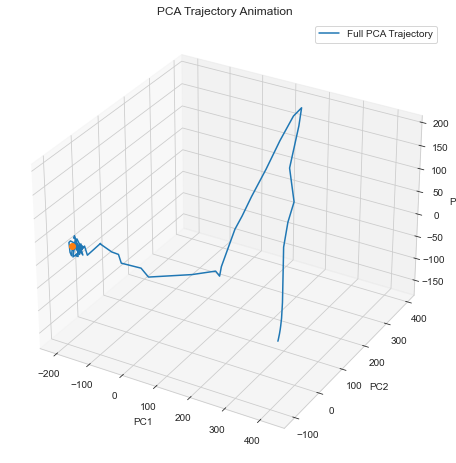

In [81]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d import Axes3D


# Setup the figure and the 3D axis
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Set the labels of the axes
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')

# Initial plot elements: full PCA trajectory
ax.plot(logits_interpolated[:, 0], logits_interpolated[:, 1], logits_interpolated[:, 2], color=PRIMARY, label='Full PCA Trajectory')

# Starting point
point, = ax.plot([logits_interpolated[0, 0]], [logits_interpolated[0, 1]], [logits_interpolated[0, 2]], color=SECONDARY, marker='o')

# Animation update function
def update(num, logits_interpolated, point):
    # idx = frame_sequence[num]
    point.set_data(logits_interpolated[num, 0], logits_interpolated[num, 1])
    point.set_3d_properties(logits_interpolated[num, 2])
    return point,

# Creating the animation
ani = FuncAnimation(fig, update, frames=len(frame_sequence), fargs=(logits_interpolated, point), interval=25, blit=True)
ani.save('../figures/pca_trajectory.mp4', fps=30)

# Set the title
ax.set_title('PCA Trajectory Animation')

# Show plot
plt.legend()
plt.show()


<ipython-input-65-a7c34ab09d92>:26: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.

<ipython-input-65-a7c34ab09d92>:40: MatplotlibDeprecationWarning:

Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later

<ipython-input-65-a7c34ab09d92>:48: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).



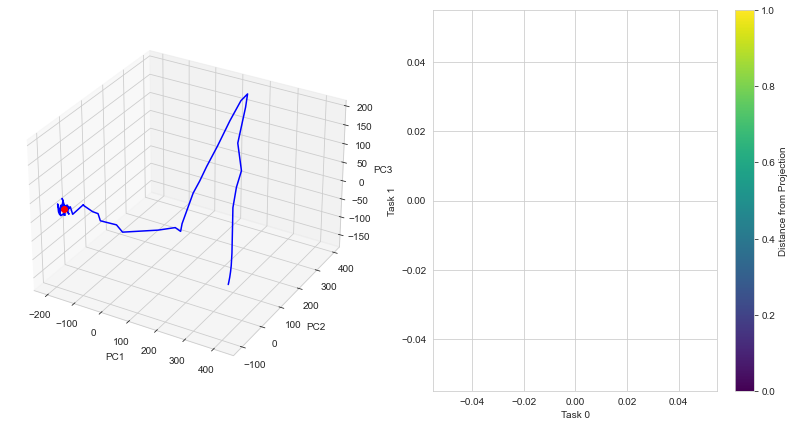

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
import torch  # Ensure that PyTorch is installed

# Assuming 'embeddings_interpolated', 'steps', 'tasks' are already defined as in your snippet

# Create figure and axes
fig = plt.figure(figsize=(14, 7))
ax1 = fig.add_subplot(121, projection='3d')
ax2 = fig.add_subplot(122)

# Set labels for axes
ax1.set_xlabel('PC1')
ax1.set_ylabel('PC2')
ax1.set_zlabel('PC3')
ax2.set_xlabel('Task 0')
ax2.set_ylabel('Task 1')

# Initial plots
scat3d = ax1.plot(logits_interpolated[:, 0], logits_interpolated[:, 1], logits_interpolated[:, 2], color=PRIMARY)[0]
point3d, = ax1.plot([logits_interpolated[0, 0]], [logits_interpolated[0, 1]], [logits_interpolated[0, 2]], SECONDARY, marker="o")

cmap = cm.get_cmap('viridis')

# Placeholder for 2D scatter plot
scat2d = ax2.scatter([], [], c=[], cmap=cmap)

# Initialize colorbar
norm = plt.Normalize(0, 1)  # Assuming your distance values are normalized between 0 and 1
sm = cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])  # Set the array for the colormap
fig.colorbar(sm, ax=ax2, label="Distance from Projection")

# Animation update function
def update(num):
    # Update 3D scatter plot
    point3d.set_data(logits_interpolated[num, 0], logits_interpolated[num, 1])
    point3d.set_3d_properties(logits_interpolated[num, 2])

    # Update 2D scatter plot
    embed = embeddings_interpolated[num]
    _x_embeds = torch.tensor(embed[:, 1:]).to("mps")
    projection_matrix = torch.stack([tasks[0], tasks[1]], dim=1)
    projected_embeds = torch.matmul(_x_embeds, projection_matrix)
    reembedded_projections = torch.matmul(torch.tensor(projected_embeds), projection_matrix.T)
    projected_embeds = projected_embeds.detach().cpu().numpy()
    dist_from_proj = np.linalg.norm(_x_embeds.detach().cpu().numpy() - reembedded_projections.detach().cpu().numpy(), axis=1)

    scat2d.set_offsets(projected_embeds[:, :2])
    scat2d.set_array(dist_from_proj)

    return point3d, scat2d

# Creating the animation
ani = FuncAnimation(fig, update, frames=len(frame_sequence), interval=25, blit=False)
ani.save('../figures/combined_animation.mp4', fps=30, extra_args=['-vcodec', 'libx264'])

plt.show()


<ipython-input-82-def096226865>:40: MatplotlibDeprecationWarning:

Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later



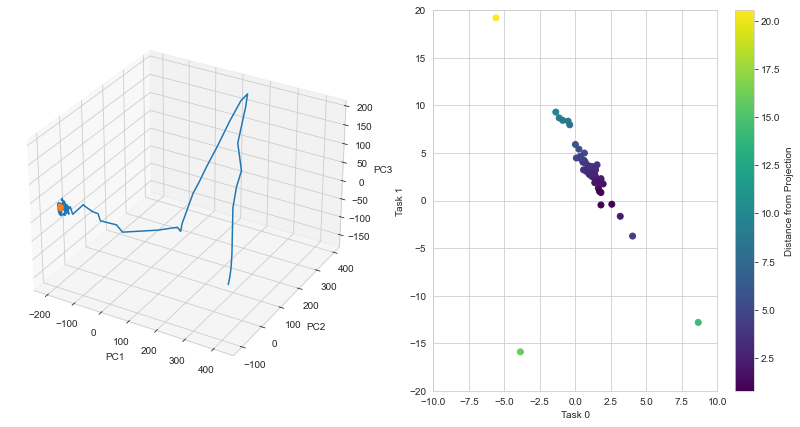

In [82]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
import torch  # Ensure that PyTorch is installed

# ... [Assuming 'embeddings_interpolated', 'steps', 'tasks' are already defined] ...

# Create figure and axes
fig = plt.figure(figsize=(14, 7))
ax1 = fig.add_subplot(121, projection='3d')
ax2 = fig.add_subplot(122)

# Set labels for axes
ax1.set_xlabel('PC1')
ax1.set_ylabel('PC2')
ax1.set_zlabel('PC3')
ax2.set_xlabel('Task 0')
ax2.set_ylabel('Task 1')

# Set limits for 3D scatter plot
ax2.set_xlim(-10, 10)
ax2.set_ylim(-20, 20)

# Initial plots
scat3d = ax1.plot(logits_interpolated[:, 0], logits_interpolated[:, 1], logits_interpolated[:, 2], color=PRIMARY)[0]
point3d, = ax1.plot([logits_interpolated[0, 0]], [logits_interpolated[0, 1]], [logits_interpolated[0, 2]], color=SECONDARY, marker="o")

# Initialize 2D scatter plot without data
scat2d = ax2.scatter([], [], c=[], cmap='viridis')

# Placeholder for the colorbar
sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=0, vmax=1))  # Adjust vmin and vmax appropriately
cbar = fig.colorbar(sm, ax=ax2, label="Distance from Projection")

# Animation update function
def update(num):
    # Update 3D scatter plot
    point3d.set_data(logits_interpolated[num, 0], logits_interpolated[num, 1])
    point3d.set_3d_properties(logits_interpolated[num, 2])

    # Update 2D scatter plot
    embed = embeddings_interpolated[num]
    _x_embeds = torch.tensor(embed[:, 1:]).to("mps")
    projection_matrix = torch.stack([tasks[0], tasks[1]], dim=1)
    projected_embeds = torch.matmul(_x_embeds, projection_matrix)
    reembedded_projections = torch.matmul(projected_embeds, projection_matrix.T)
    projected_embeds = projected_embeds.detach().cpu().numpy()
    dist_from_proj = np.linalg.norm(_x_embeds.detach().cpu().numpy() - reembedded_projections.detach().cpu().numpy(), axis=1)

    scat2d.set_offsets(projected_embeds[:, :2])
    scat2d.set_array(dist_from_proj)
    
    # Update colorbar
    scat2d.set_clim([dist_from_proj.min(), dist_from_proj.max()])
    cbar.update_normal(scat2d)

    return point3d, scat2d

# Creating the animation
ani = FuncAnimation(fig, update, frames=len(frame_sequence), interval=25, blit=False)
ani.save('../figures/combined_animation.mp4', fps=30, extra_args=['-vcodec', 'libx264'])

plt.show()


In [472]:
from matplotlib.animation import FuncAnimation

milestones = [
    (70, 1_000, 'Midpoint acquisition'),
    (1_000, 5_000, 'Task acquisition'),
    (20_000, 280_000, 'Input generalization'),
    # (60000, 100000, 'Collapse onto task difference'),
    # (100000, 220000, 'Activation divergence'),
    # (220000, 280000, "Learning rate maximum"),
    # (280000, 500000, "Stabilization")
]
milestone_colors = sns.color_palette("deep", len(milestones))


# Create subplots
fig, axes = plt.subplots(2, len(metrics_to_plot), figsize=(18, 6))

START_STEP_INDEX = 0
time_steps = run.checkpointer.file_ids[START_STEP_INDEX:]
first_step = time_steps[0]
end_step = time_steps[-1]

# Create the plots
for i, (metric_name, metric_values, kwargs) in enumerate(metrics_to_plot):
    axes[0, i].plot(run.checkpointer.file_ids[START_STEP_INDEX:], metric_values[START_STEP_INDEX:], label=metric_name, marker='.')
    axes[0, i].set_title(metric_name + " over Time")
    axes[0, i].set_xlabel('Time Steps')
    axes[0, i].set_ylabel(metric_name)

    if kwargs.get("logy", False):
        axes[0, i].set_yscale('log')

    axes[1, i].plot(run.checkpointer.file_ids[START_STEP_INDEX:], metric_slopes[i][START_STEP_INDEX:], label=metric_name + " Slope", marker='.')
    axes[1, i].set_title(metric_name + " Slope over Time")
    axes[1, i].set_xlabel('Time Steps')
    axes[1, i].set_ylabel(metric_name + " Slope")

    # Plot vertical line at 250k steps
    axes[0, i].axvline(x=0, color="grey", linestyle="--", linewidth=1)
    axes[1, i].axvline(x=0, color="grey", linestyle="--", linewidth=1)


# Create inset axes
# axins = axes[1, 1].inset_axes([0.7, 0.15, 0.25, 0.25])  # x, y, width, height
# axins.plot(run.checkpointer.file_ids[30:], metric_slopes[1][30:], label=metric_name + " Slope", marker='.')

all_axes = [*axes.flatten()] # axins]

for ax in axes.flatten():
    for color, (start, end, label) in zip(milestone_colors, milestones):
        ax.axvspan(start, end, alpha=0.2, label=label, color=color)

for ax in all_axes:
    ax.set_xscale('log')

# for color, (start, end, label) in zip(milestone_colors[2:], milestones[2:]):
#     ax.axvspan(start, end, alpha=0.2, label=label, color=color)

# Add milestone legend
patchList = []

for color, (start, end, label) in zip(milestone_colors, milestones):
    data_key = mpatches.Patch(color=color, alpha=0.2, label=label)
    patchList.append(data_key)

# Create a line object on each subplot for the cursor
cursors = [ax.axvline(x=first_step, color=SECONDARY, linewidth=2) for ax in axes.flatten()]

# cursors.append(
#     axins.axvline(x=first_step, color=SECONDARY, linewidth=2)
# )

total_frames = len(frame_sequence)
frame_multiplier = np.log(500_000) / total_frames

pbar = tqdm.tqdm(total=total_frames)
plt.tight_layout()

plt.show()
break

# Update function for the animation
def update_cursor(num):
    step = steps_interpolated[num]
    # Update the cursor position on each plot
    for cursor in cursors:
        cursor.set_xdata(step)

    pbar.update(1)
    pbar.desc = f"Step {step:.2f}"

    return cursors

# Number of frames is equal to the number of time steps you have
num_frames = len(frame_sequence)

# Create the animation
ani = FuncAnimation(fig, update_cursor, frames=num_frames, interval=25, blit=True)

# Save the animation
ani.save('../figures/metrics_animation.mp4', fps=30, extra_args=['-vcodec', 'libx264'])

plt.show()


NameError: name 'metrics_to_plot' is not defined

In [6]:
gradnorms_over_time = []

for checkpoint in run.checkpointer:
    optimizer_statedict = checkpoint["optimizer"]
    # print(optimizer_statedict)
    grads = [p for p in optimizer_statedict["state"].values() if p is not None]
    #print(grads)
    gradnorms = [torch.norm(g).item() for g in grads]
    gradnorms_over_time.append(sum(gradnorms))


# for model in models:
#     grads = [p.grad for p in model.parameters()]
#     gradnorms = [torch.norm(g).item() for g in grads if g is not None]
#     gradnorms_over_time.append(sum(gradnorms))

plt.figure(figsize=(10, 6))
plt.plot(steps, gradnorms_over_time)

AttributeError: 'dict' object has no attribute 'layout'